In [41]:
import os
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt  # Import Matplotlib for plotting
from scipy.io import wavfile
from python_speech_features import mfcc, logfbank
import librosa

from tensorflow.keras.layers import (
    Conv2D,
    MaxPool2D,
    Flatten,
    LSTM,
    TimeDistributed,
    LayerNormalization,
    Dense,
    Dropout,
)
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model
from sklearn.metrics import accuracy_score
import pickle
import tensorflow as tf


In [2]:
pwd

'C:\\Users\\KIIT\\projects\\ml\\Knee Sounds Signals Experiment\\DATASET\\unprocessed\\wav\\using kapre'

In [145]:
class Config:
    def __init__(self , mode = 'conv' , nfilt = 26 , nfeat = 13 , nfft = 512 , rate = 16000 ):
        self.mode = mode
        self.nfilt = nfilt
        self.nfeat = nfeat
        self.nfft  =  nfft
        self.rate  =  rate
        self.step = int(rate/10)##how much data we compute when the window size is created
config = Config()


In [146]:
training = pd.read_csv('training.csv')
test = pd.read_csv('test.csv')

In [147]:
x = training['fname'].values
y = training['label'].values

In [148]:
from sklearn.model_selection import train_test_split
x_train, x_test , y_train , y_test = train_test_split(x , y ,test_size = 0.2 ,random_state  =  0)

In [149]:

        
def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T

def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = extract_mfcc_features(audio, sr, n_mfcc)
    return mfccs.reshape(mfccs.shape[0], mfccs.shape[1], 1)

def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')

# truncating or adding 0

In [150]:
classes = list(np.unique(training.label))

classes

['grade1', 'grade2', 'grade3', 'grade4']

In [151]:
ls


 Volume in drive C is Windows-SSD
 Volume Serial Number is 2CD7-88B3

 Directory of C:\Users\KIIT\projects\ml\Knee Sounds Signals Experiment\DATASET\unprocessed\wav\using kapre

07-02-2024  13:10    <DIR>          .
05-02-2024  21:31    <DIR>          ..
06-02-2024  23:36    <DIR>          .ipynb_checkpoints
07-02-2024  13:10        27,692,468 arthritis_sound_signal_classification_CNN.ipynb
06-02-2024  01:27               462 cfg.py
06-02-2024  23:32    <DIR>          model_1
06-02-2024  14:51            63,766 new_model_conv.ipynb
06-02-2024  14:10         2,042,687 pdf.pdf
06-02-2024  23:40    <DIR>          test
05-02-2024  17:42               300 test.csv
07-02-2024  13:07             3,371 traing_audio_validation.csv
03-02-2024  21:54             3,822 training.csv
05-02-2024  21:31    <DIR>          wavfiles
               7 File(s)     29,806,876 bytes
               6 Dir(s)  144,905,203,712 bytes free


In [152]:
X = []  # Store MFCC features
Y = []  # Store class labels


for index, row in training.iterrows():
        audio_path = row['fname']
        class_label = row['label']
        audio_path = 'wavfiles/' + audio_path
        mfccs = preprocess_audio(audio_path)
        mfccs = pad_or_truncate_mfccs(mfccs, target_length=141)  # Adjust target_length as needed
        X.append(mfccs)
        Y.append(class_label)
    

X = np.array(X)
Y = np.array(Y)
print(Y)

['grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grade3'
 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grad

In [153]:

#convering grade to numbers 0 1 2 3 
class_mapping = {'grade1': 0, 'grade2': 1, 'grade3': 2 ,'grade4': 3 }
Y = [class_mapping[label] for label in Y]


In [154]:

Y = to_categorical(Y)  # One-hot encode labels

Y
# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.2, random_state=42)
Y.shape

(141, 4)

In [155]:
Y.shape

(141, 4)

In [156]:
print("x train",X_train)
print("x_val",X_val)
print("y_train",y_train)
print("y_val",y_val)

x train [[[[-3.44916779e+02]
   [ 1.20849670e+02]
   [ 2.90913849e+01]
   ...
   [ 3.10516310e+00]
   [ 3.68634081e+00]
   [ 2.54430771e+00]]

  [[-3.85543488e+02]
   [ 1.14219116e+02]
   [ 5.64424591e+01]
   ...
   [-1.47866935e-01]
   [ 2.62742788e-01]
   [ 2.44927675e-01]]

  [[-4.32303894e+02]
   [ 8.13811646e+01]
   [ 7.53269653e+01]
   ...
   [ 1.67679477e+00]
   [ 9.62981105e-01]
   [-3.70560586e-02]]

  ...

  [[-4.42522552e+02]
   [ 6.73203201e+01]
   [ 6.23916168e+01]
   ...
   [-1.09672689e+00]
   [-1.63001943e+00]
   [-2.23483348e+00]]

  [[-4.40304688e+02]
   [ 7.03260345e+01]
   [ 6.50312958e+01]
   ...
   [-1.45806265e+00]
   [-2.49330235e+00]
   [-3.40490913e+00]]

  [[-4.34181946e+02]
   [ 7.83649750e+01]
   [ 7.13147278e+01]
   ...
   [ 5.07690489e-01]
   [-1.40260863e+00]
   [-3.31492567e+00]]]


 [[[-1.58709869e+02]
   [ 1.23619171e+02]
   [ 1.54281950e+01]
   ...
   [ 2.82466888e+00]
   [ 2.00706363e+00]
   [ 4.71622610e+00]]

  [[-2.19769257e+02]
   [ 1.33043259e+

In [157]:
print(y_train.shape)
print(y_val.shape)
print(X_train.shape)

(112, 4)
(29, 4)
(112, 141, 20, 1)


In [ ]:
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

In [173]:
from tensorflow.keras import regularizers

num_classes = 4
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(mfccs.shape[0], mfccs.shape[1], 1)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(64, activation='relu' , kernel_regularizer=regularizers.l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))
model.summary()
# Output layer for 4 classes



Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_22 (Conv2D)          (None, 139, 18, 32)       320       
                                                                 
 batch_normalization_24 (Ba  (None, 139, 18, 32)       128       
 tchNormalization)                                               
                                                                 
 dropout_24 (Dropout)        (None, 139, 18, 32)       0         
                                                                 
 max_pooling2d_22 (MaxPooli  (None, 69, 9, 32)         0         
 ng2D)                                                           
                                                                 
 conv2d_23 (Conv2D)          (None, 67, 7, 64)         18496     
                                                                 
 batch_normalization_25 (Ba  (None, 67, 7, 64)       

In [174]:
model.save('model_1\conv.h')

INFO:tensorflow:Assets written to: model_1\conv.h\assets


INFO:tensorflow:Assets written to: model_1\conv.h\assets


In [69]:
pwd

'C:\\Users\\KIIT\\projects\\ml\\Knee Sounds Signals Experiment\\DATASET\\unprocessed\\wav\\using kapre'

In [175]:
model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_22 (Conv2D)          (None, 139, 18, 32)       320       
                                                                 
 batch_normalization_24 (Ba  (None, 139, 18, 32)       128       
 tchNormalization)                                               
                                                                 
 dropout_24 (Dropout)        (None, 139, 18, 32)       0         
                                                                 
 max_pooling2d_22 (MaxPooli  (None, 69, 9, 32)         0         
 ng2D)                                                           
                                                                 
 conv2d_23 (Conv2D)          (None, 67, 7, 64)         18496     
                                                                 
 batch_normalization_25 (Ba  (None, 67, 7, 64)       

In [158]:
last_layer_output_shape = model.layers[-1].output_shape
print("Last layer output shape:", last_layer_output_shape)

Last layer output shape: (None, 4)


In [176]:
model.compile(loss='categorical_crossentropy', optimizer = 'adam', metrics=['accuracy'])

model.fit(X_train, y_train, epochs=200, batch_size=32, validation_data=(X_val, y_val))



Epoch 1/200
4/4 [==============================] - 1s 109ms/step - loss: 3.1330 - accuracy: 0.4107 - val_loss: 13.3050 - val_accuracy: 0.2069
Epoch 2/200
4/4 [==============================] - 0s 57ms/step - loss: 2.2069 - accuracy: 0.5714 - val_loss: 12.7273 - val_accuracy: 0.2759
Epoch 3/200
4/4 [==============================] - 0s 57ms/step - loss: 2.0120 - accuracy: 0.6875 - val_loss: 13.6248 - val_accuracy: 0.1724
Epoch 4/200
4/4 [==============================] - 0s 60ms/step - loss: 1.9168 - accuracy: 0.7589 - val_loss: 13.0856 - val_accuracy: 0.2414
Epoch 5/200
4/4 [==============================] - 0s 63ms/step - loss: 1.7551 - accuracy: 0.8304 - val_loss: 11.3962 - val_accuracy: 0.2759
Epoch 6/200
4/4 [==============================] - 0s 59ms/step - loss: 1.5703 - accuracy: 0.8750 - val_loss: 9.8026 - val_accuracy: 0.3103
Epoch 7/200
4/4 [==============================] - 0s 59ms/step - loss: 1.4527 - accuracy: 0.8839 - val_loss: 8.2900 - val_accuracy: 0.3103
Epoch 8/200
4/

Epoch 59/200
4/4 [==============================] - 1s 138ms/step - loss: 0.3947 - accuracy: 0.9732 - val_loss: 1.2602 - val_accuracy: 0.6552
Epoch 60/200
4/4 [==============================] - 1s 141ms/step - loss: 0.3850 - accuracy: 0.9643 - val_loss: 1.4598 - val_accuracy: 0.6207
Epoch 61/200
4/4 [==============================] - 1s 145ms/step - loss: 0.5058 - accuracy: 0.9464 - val_loss: 1.5642 - val_accuracy: 0.6207
Epoch 62/200
4/4 [==============================] - 0s 125ms/step - loss: 0.3680 - accuracy: 0.9643 - val_loss: 1.4214 - val_accuracy: 0.6552
Epoch 63/200
4/4 [==============================] - 1s 127ms/step - loss: 0.3645 - accuracy: 0.9554 - val_loss: 1.2632 - val_accuracy: 0.6552
Epoch 64/200
4/4 [==============================] - 1s 138ms/step - loss: 0.4095 - accuracy: 0.9643 - val_loss: 1.1800 - val_accuracy: 0.6552
Epoch 65/200
4/4 [==============================] - 1s 133ms/step - loss: 0.3905 - accuracy: 0.9554 - val_loss: 1.2265 - val_accuracy: 0.6552
Epoch 

4/4 [==============================] - 1s 133ms/step - loss: 0.2815 - accuracy: 0.9554 - val_loss: 1.2319 - val_accuracy: 0.7241
Epoch 117/200
4/4 [==============================] - 0s 119ms/step - loss: 0.2758 - accuracy: 0.9464 - val_loss: 1.1619 - val_accuracy: 0.6897
Epoch 118/200
4/4 [==============================] - 1s 142ms/step - loss: 0.2758 - accuracy: 0.9464 - val_loss: 1.1528 - val_accuracy: 0.6897
Epoch 119/200
4/4 [==============================] - 1s 135ms/step - loss: 0.2571 - accuracy: 0.9554 - val_loss: 1.2325 - val_accuracy: 0.6897
Epoch 120/200
4/4 [==============================] - 1s 134ms/step - loss: 0.2439 - accuracy: 0.9643 - val_loss: 1.2731 - val_accuracy: 0.6897
Epoch 121/200
4/4 [==============================] - 0s 129ms/step - loss: 0.2240 - accuracy: 0.9554 - val_loss: 1.3549 - val_accuracy: 0.6897
Epoch 122/200
4/4 [==============================] - 1s 132ms/step - loss: 0.2466 - accuracy: 0.9464 - val_loss: 1.3914 - val_accuracy: 0.6897
Epoch 123/200

4/4 [==============================] - 1s 157ms/step - loss: 0.2071 - accuracy: 0.9732 - val_loss: 1.1322 - val_accuracy: 0.7586
Epoch 174/200
4/4 [==============================] - 1s 147ms/step - loss: 0.1815 - accuracy: 0.9732 - val_loss: 1.0251 - val_accuracy: 0.7931
Epoch 175/200
4/4 [==============================] - 1s 194ms/step - loss: 0.1846 - accuracy: 0.9554 - val_loss: 0.9719 - val_accuracy: 0.8276
Epoch 176/200
4/4 [==============================] - 1s 158ms/step - loss: 0.2228 - accuracy: 0.9554 - val_loss: 0.9363 - val_accuracy: 0.7931
Epoch 177/200
4/4 [==============================] - 1s 173ms/step - loss: 0.2144 - accuracy: 0.9643 - val_loss: 0.9443 - val_accuracy: 0.7931
Epoch 178/200
4/4 [==============================] - 1s 145ms/step - loss: 0.1862 - accuracy: 0.9911 - val_loss: 8.1075 - val_accuracy: 0.3103
Epoch 179/200
4/4 [==============================] - 1s 138ms/step - loss: 0.2231 - accuracy: 0.9464 - val_loss: 2.5847 - val_accuracy: 0.3103
Epoch 180/200

In [177]:
model.save('model_1\conv.h')

INFO:tensorflow:Assets written to: model_1\conv.h\assets


INFO:tensorflow:Assets written to: model_1\conv.h\assets


In [178]:
history = tf.keras.models.load_model('model_1\conv.h')

In [179]:
history = history.fit(X_train, y_train, epochs=400, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/400
4/4 [==============================] - 1s 105ms/step - loss: 0.3010 - accuracy: 0.9554 - val_loss: 23.8992 - val_accuracy: 0.3793
Epoch 2/400
4/4 [==============================] - 0s 61ms/step - loss: 0.2315 - accuracy: 0.9554 - val_loss: 14.2142 - val_accuracy: 0.3793
Epoch 3/400
4/4 [==============================] - 0s 58ms/step - loss: 0.2427 - accuracy: 0.9643 - val_loss: 11.0323 - val_accuracy: 0.3793
Epoch 4/400
4/4 [==============================] - 0s 56ms/step - loss: 0.3041 - accuracy: 0.9554 - val_loss: 7.8191 - val_accuracy: 0.3793
Epoch 5/400
4/4 [==============================] - 0s 53ms/step - loss: 0.2417 - accuracy: 0.9464 - val_loss: 6.4401 - val_accuracy: 0.4828
Epoch 6/400
4/4 [==============================] - 0s 56ms/step - loss: 0.2257 - accuracy: 0.9643 - val_loss: 3.7528 - val_accuracy: 0.4483
Epoch 7/400
4/4 [==============================] - 0s 57ms/step - loss: 0.3448 - accuracy: 0.9286 - val_loss: 2.0357 - val_accuracy: 0.5517
Epoch 8/400
4/4 

KeyboardInterrupt: 

In [180]:
file = str(input("enter the file name :"))

enter the file name :test (13)


In [181]:
def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T
def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio, sr = librosa.load(audio_path, sr=target_sr)  # Load audio and sample rate
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=20).T
    mfccs = pad_or_truncate_mfccs(mfccs, target_length=141)  # Adjust target_length to match the expected input shape
    return mfccs.reshape(1, mfccs.shape[0], mfccs.shape[1], 1)  # Reshape for prediction
  # Reshape for prediction




# Predict the class
audio_path = 'test/'+file+'.wav'  # Replace with the actual path
mfccs_test = preprocess_audio(audio_path)

mfccs_test.shape

(1, 141, 20, 1)

In [182]:
prediction = model.predict(mfccs_test)
predicted_class = np.argmax(prediction)  # Get the index of the predicted class

# Map the index back to the class label (if applicable)
class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
predicted_label = class_mapping[predicted_class]

print("Predicted class:", predicted_class)
print("Predicted label:", predicted_label)

1/1 [==============================] - 0s 86ms/step
Predicted class: 0
Predicted label: grade1


22050


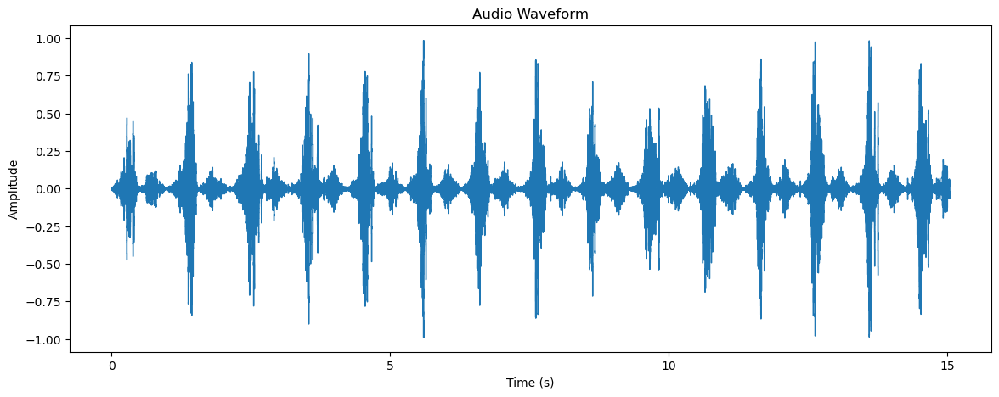

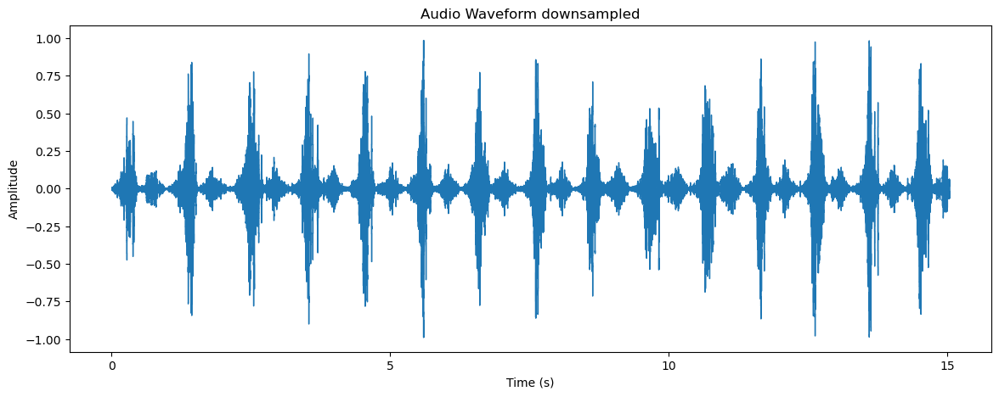

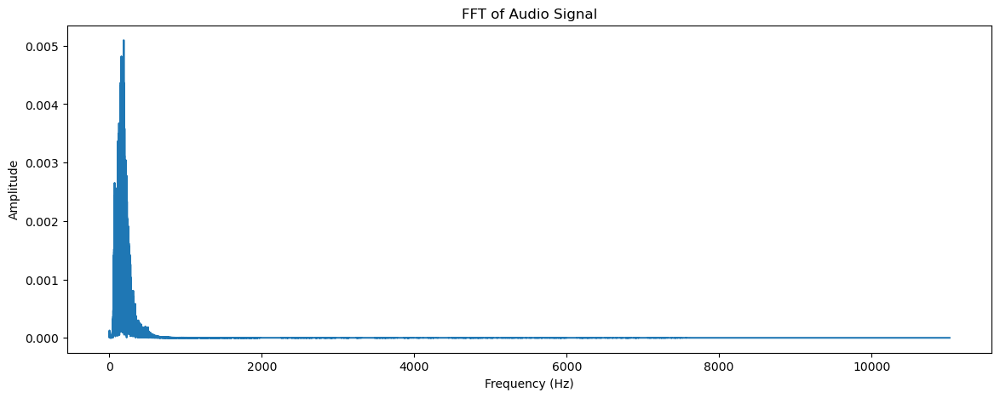

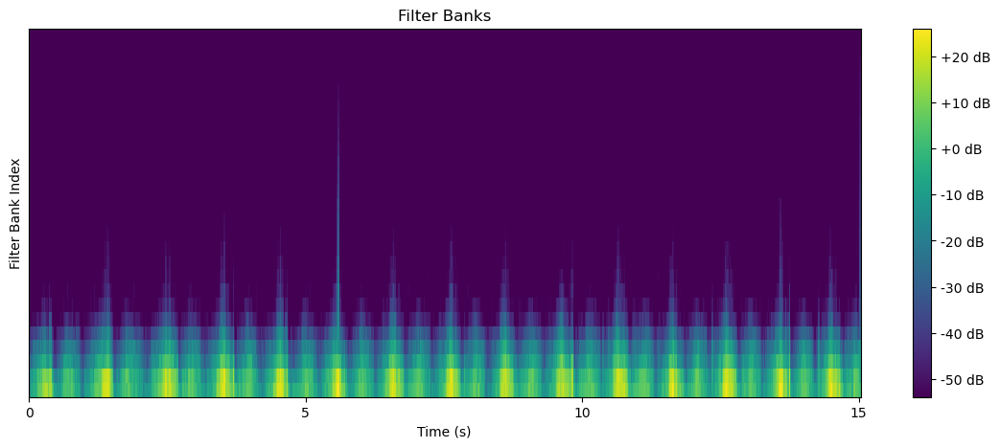

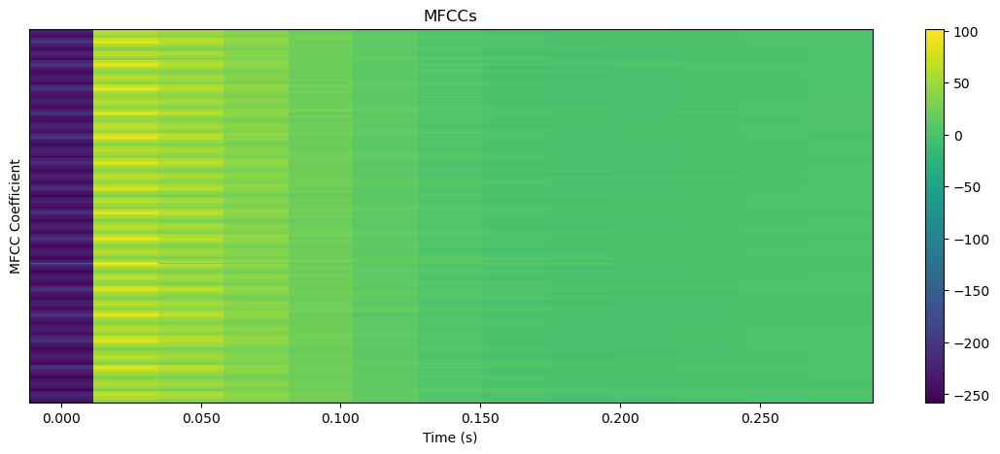

In [183]:

audio, sr = librosa.load('test/'+file+'.wav', sr=22050)
target_sr=22050
librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
print(sr)

def calc_fft(y , rate):
    n = len(y)
    
    freq = np.fft.rfftfreq( n , d = 1/rate )## calculates the frequencies corresponding to each bin in a Real-valued Fast Fourier Transform (RFFT).
    Y = abs(np.fft.rfft(y)/n)  ##magnitude (of a complex number) , /n is done to scale/normalise the length
    return (Y , freq)
Y , freq = calc_fft(audio , sr)

# Calculate filter banks
filter_banks = librosa.feature.melspectrogram(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mels=26)

# Convert filter banks to log scale
log_filter_banks = librosa.power_to_db(filter_banks)

mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mfcc=13, n_mels=26)

# Transpose for better visualization
mfccs = mfccs.T
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
plt.title('Audio Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
plt.title('Audio Waveform downsampled')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

plt.figure(figsize=(14, 5))
plt.plot(freq, Y)
plt.title('FFT of Audio Signal')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()


plt.figure(figsize=(14, 5))
librosa.display.specshow(log_filter_banks, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Filter Banks')
plt.xlabel('Time (s)')
plt.ylabel('Filter Bank Index')
plt.show()


# Plot MFCCs
plt.figure(figsize=(14, 5))
librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
plt.colorbar()
plt.title('MFCCs')
plt.xlabel('Time (s)')
plt.ylabel('MFCC Coefficient')
plt.show()


22050


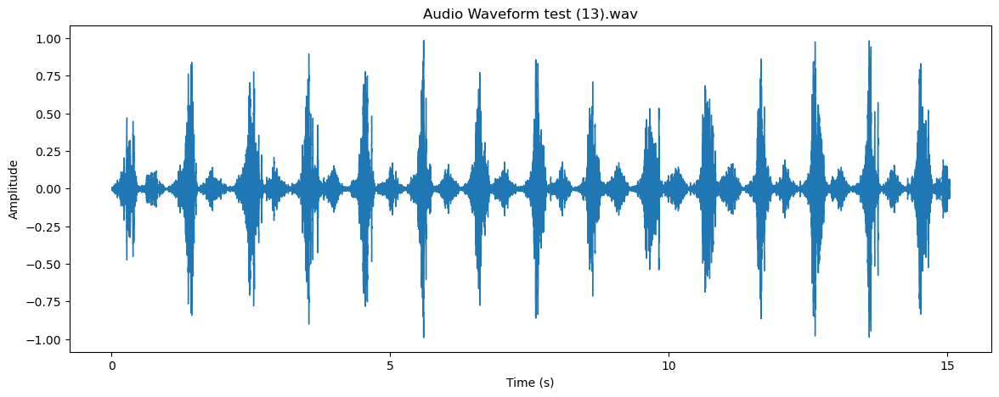

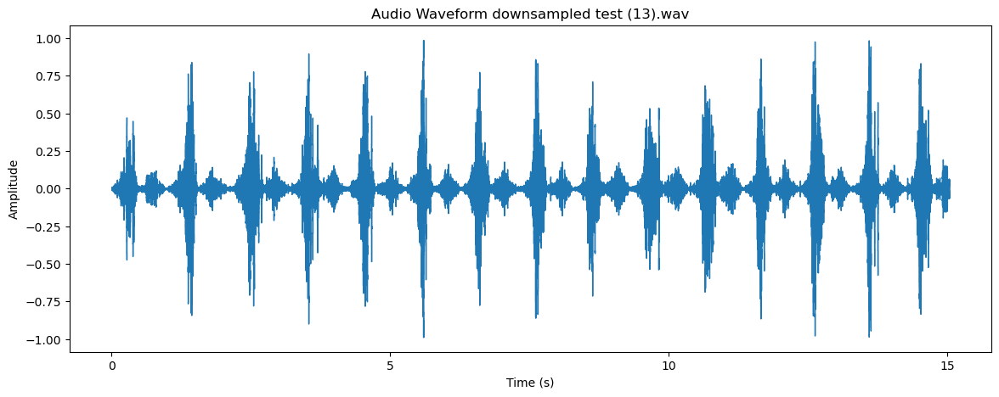

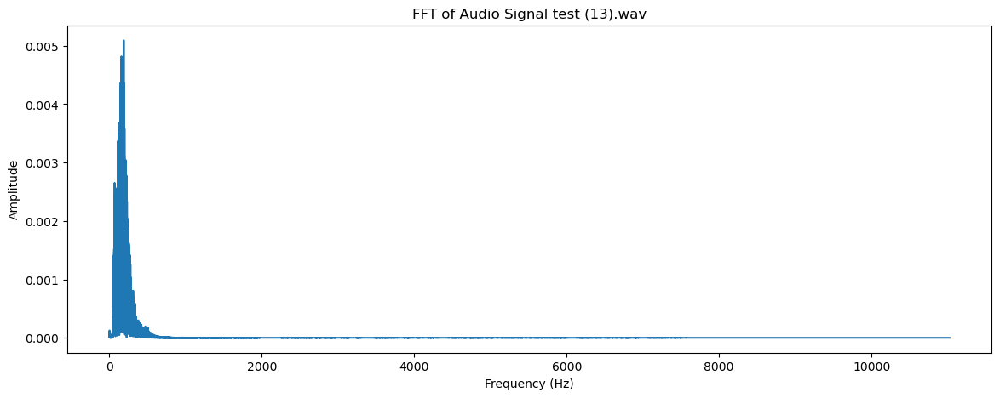

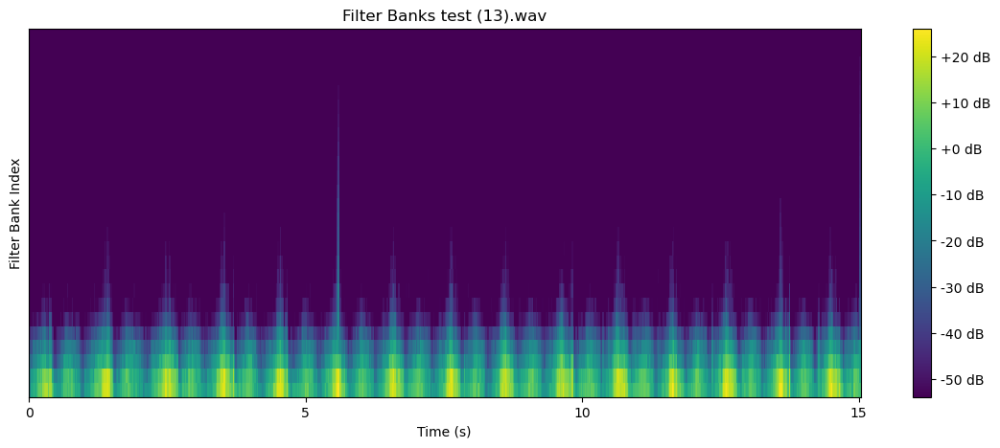

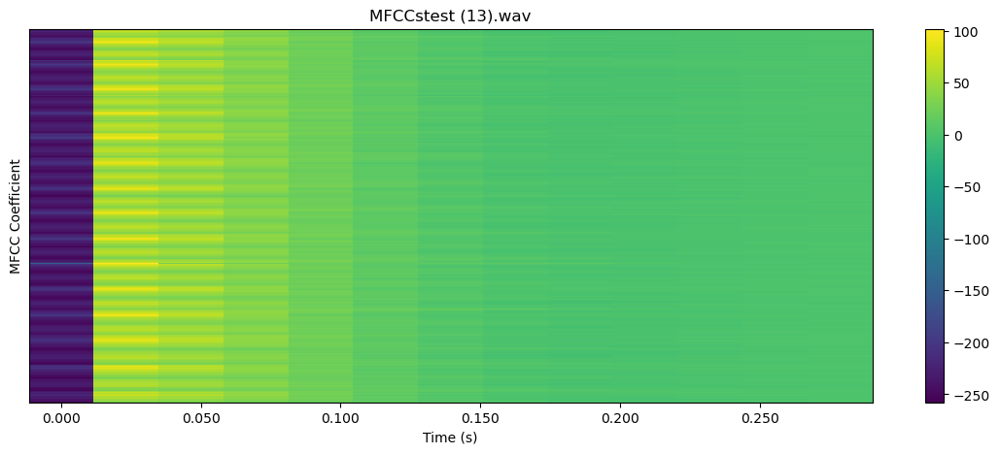

In [26]:

audio, sr = librosa.load('test/'+file+'.wav', sr=22050)
target_sr=22050
librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
print(sr)

def calc_fft(y , rate):
    n = len(y)
    
    freq = np.fft.rfftfreq( n , d = 1/rate )## calculates the frequencies corresponding to each bin in a Real-valued Fast Fourier Transform (RFFT).
    Y = abs(np.fft.rfft(y)/n)  ##magnitude (of a complex number) , /n is done to scale/normalise the length
    return (Y , freq)
Y , freq = calc_fft(audio , sr)

# Calculate filter banks
filter_banks = librosa.feature.melspectrogram(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mels=26)

# Convert filter banks to log scale
log_filter_banks = librosa.power_to_db(filter_banks)

mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mfcc=13, n_mels=26)

# Transpose for better visualization
mfccs = mfccs.T
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
plt.title('Audio Waveform '+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
plt.title('Audio Waveform downsampled '+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

plt.figure(figsize=(14, 5))
plt.plot(freq, Y)
plt.title('FFT of Audio Signal '+file+'.wav')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()


plt.figure(figsize=(14, 5))
librosa.display.specshow(log_filter_banks, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Filter Banks '+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('Filter Bank Index')
plt.show()


# Plot MFCCs
plt.figure(figsize=(14, 5))
librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
plt.colorbar()
plt.title('MFCCs'+file+'.wav')
plt.xlabel('Time (s)')
plt.ylabel('MFCC Coefficient')
plt.show()


  0%|          | 0/19 [00:00<?, ?it/s]

22050


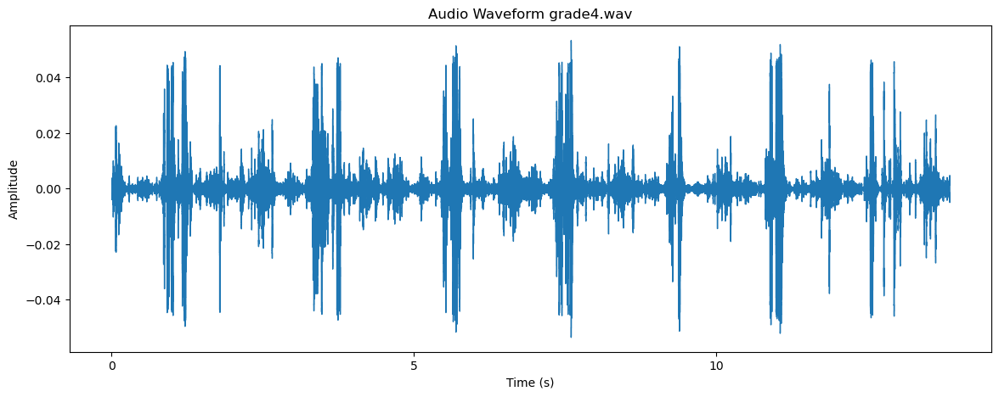

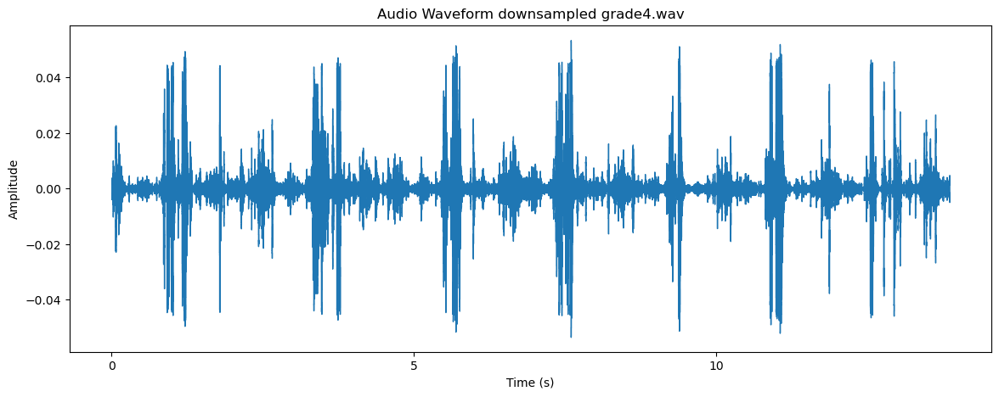

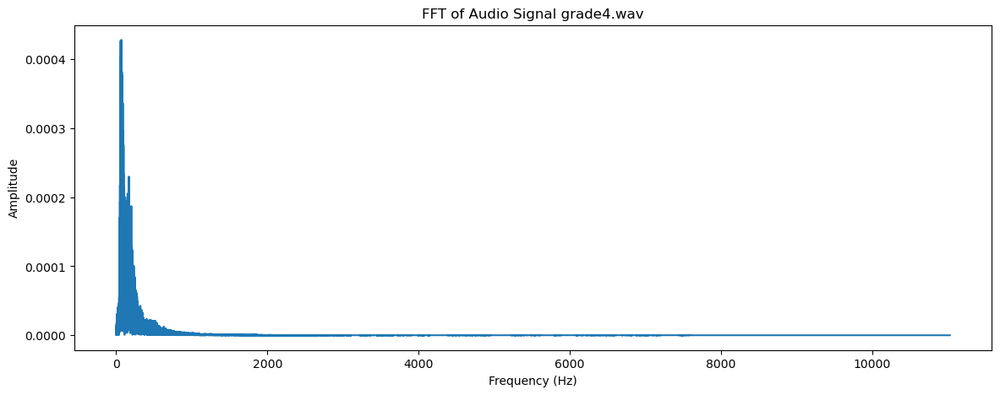

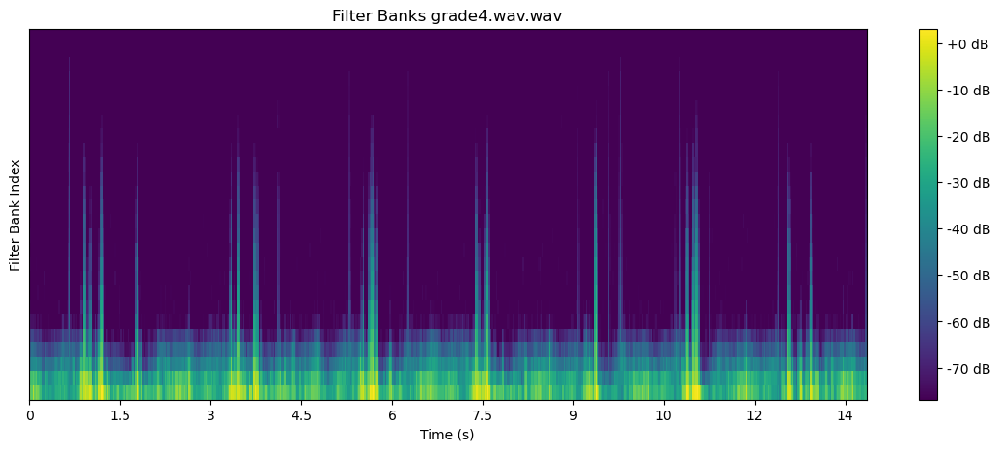

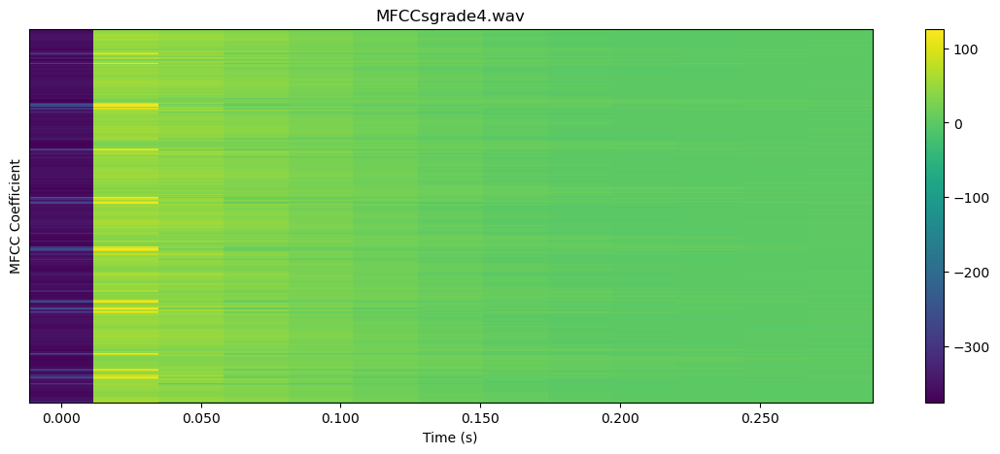

  5%|▌         | 1/19 [00:03<01:02,  3.48s/it]

22050


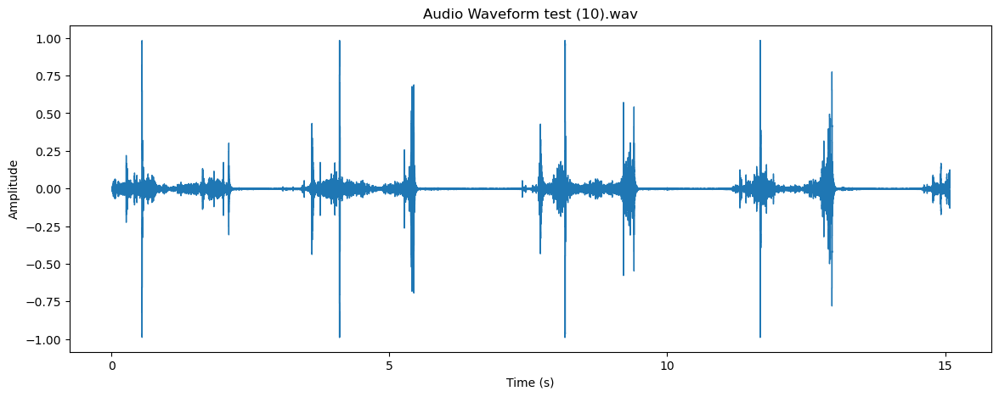

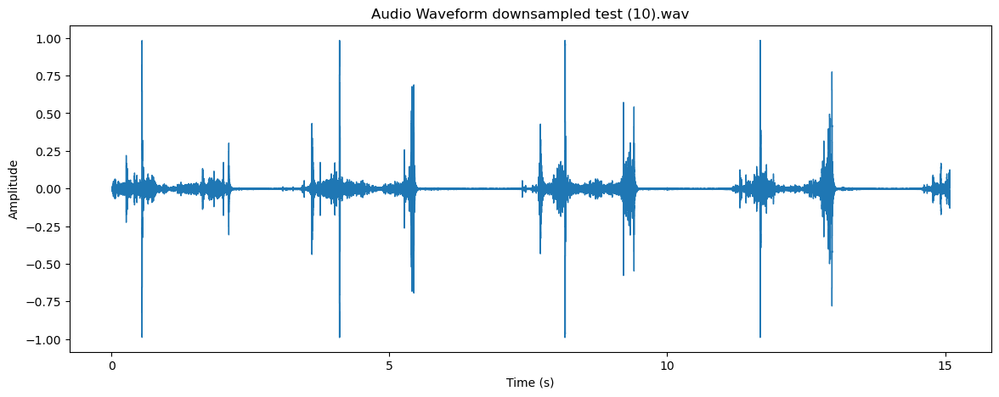

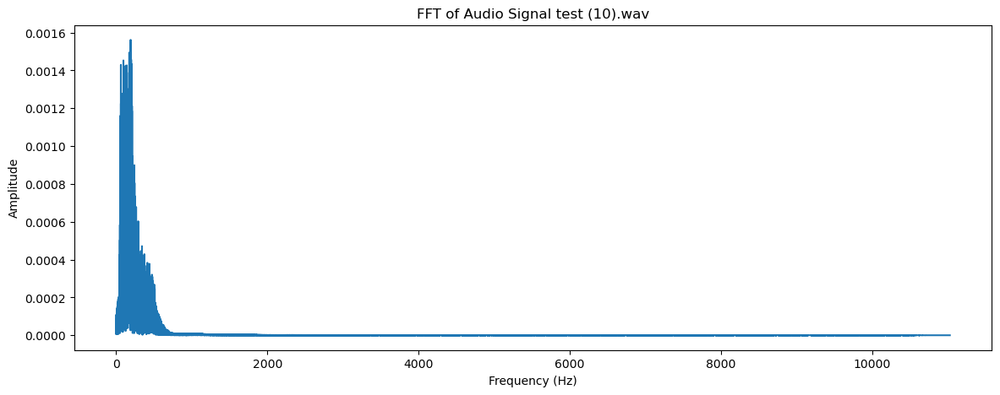

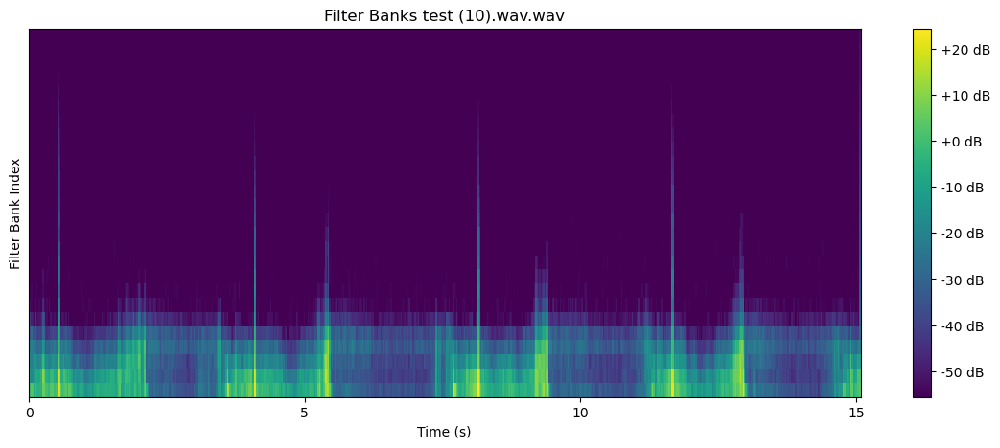

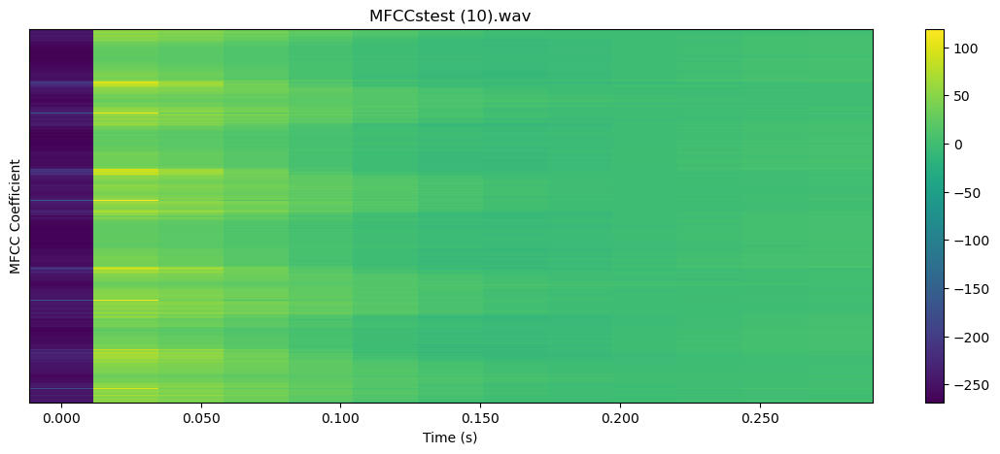

 11%|█         | 2/19 [00:07<00:59,  3.51s/it]

22050


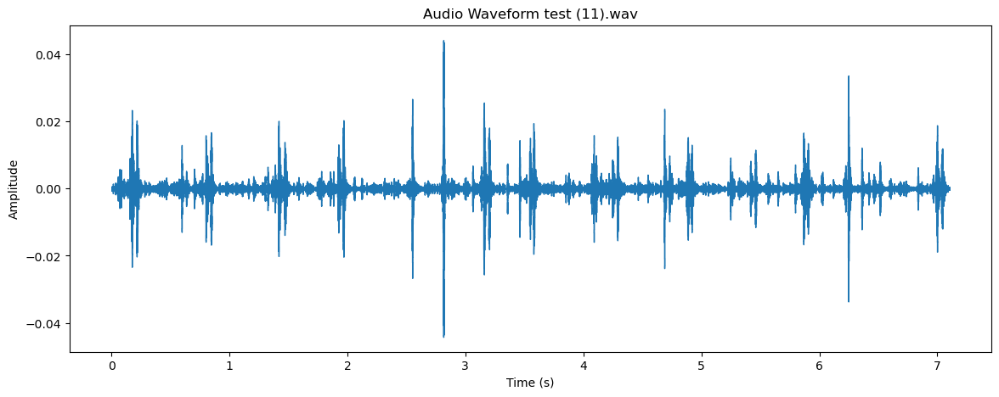

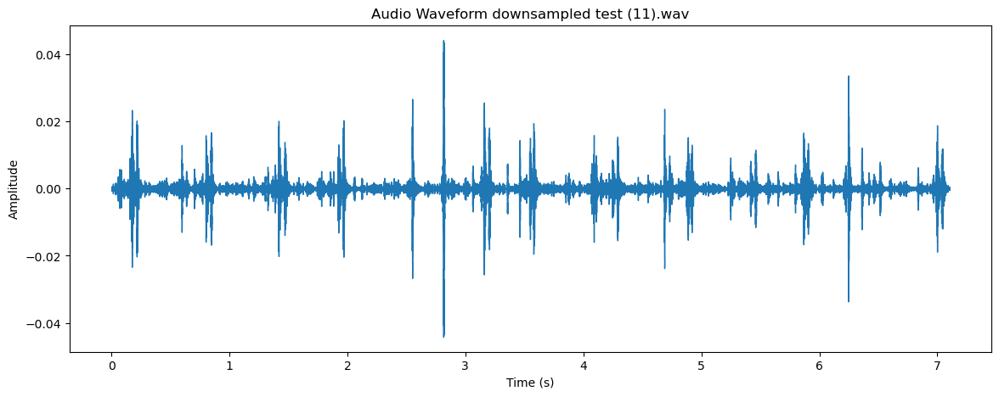

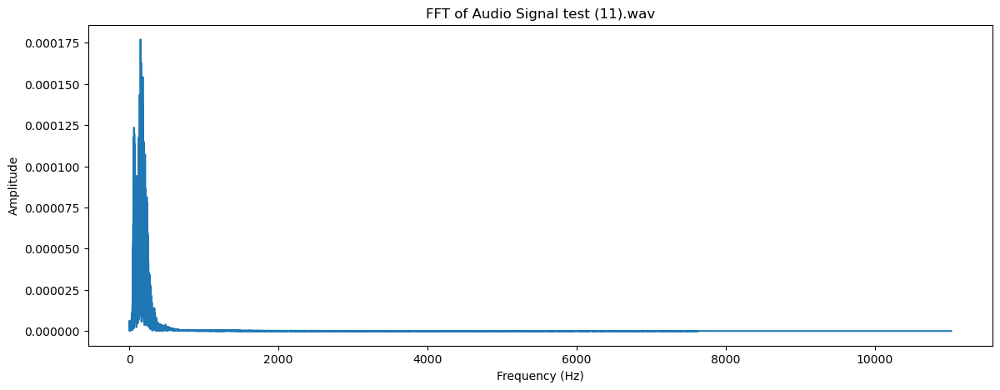

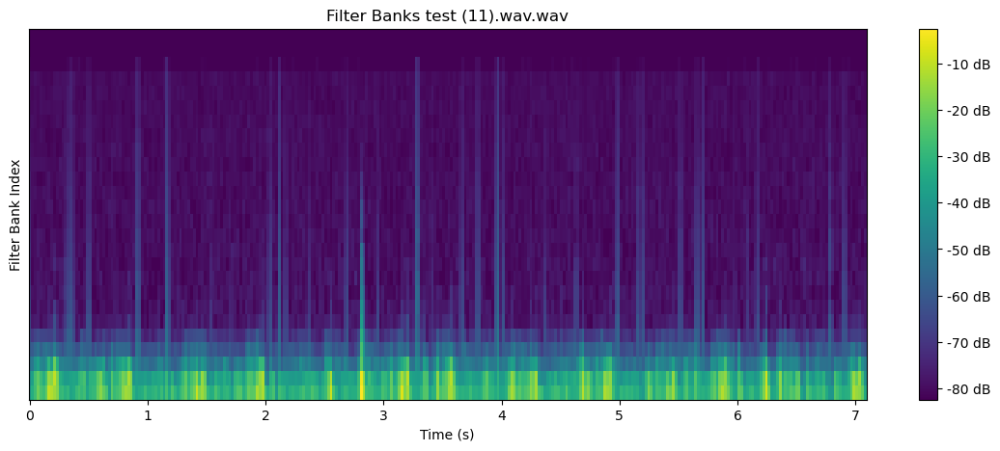

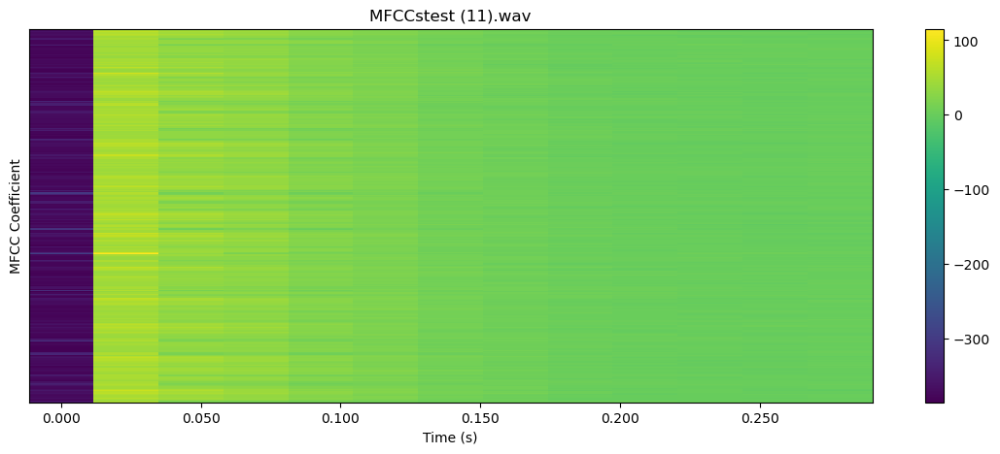

 16%|█▌        | 3/19 [00:10<00:54,  3.38s/it]

22050


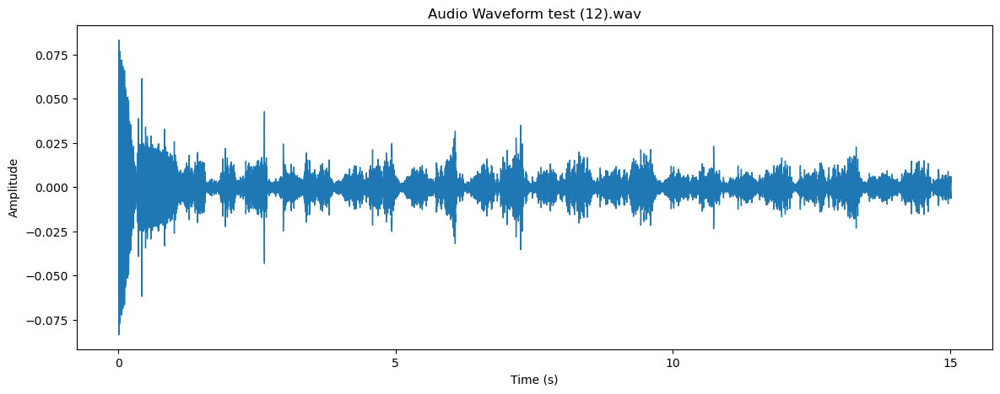

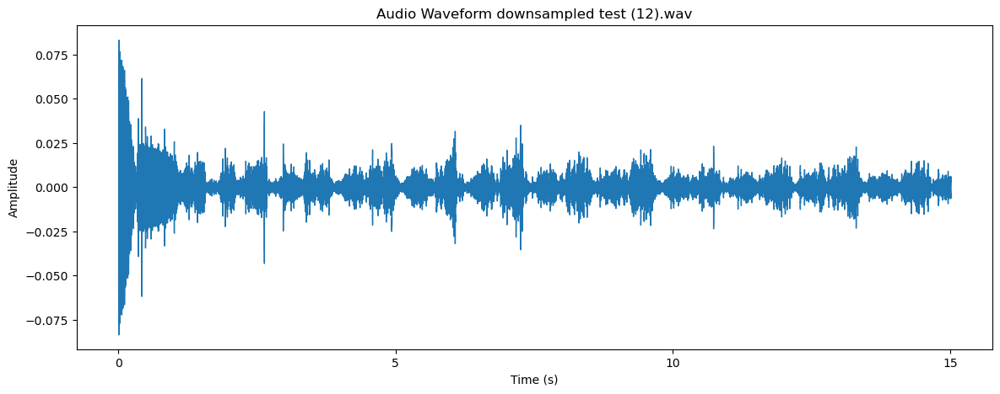

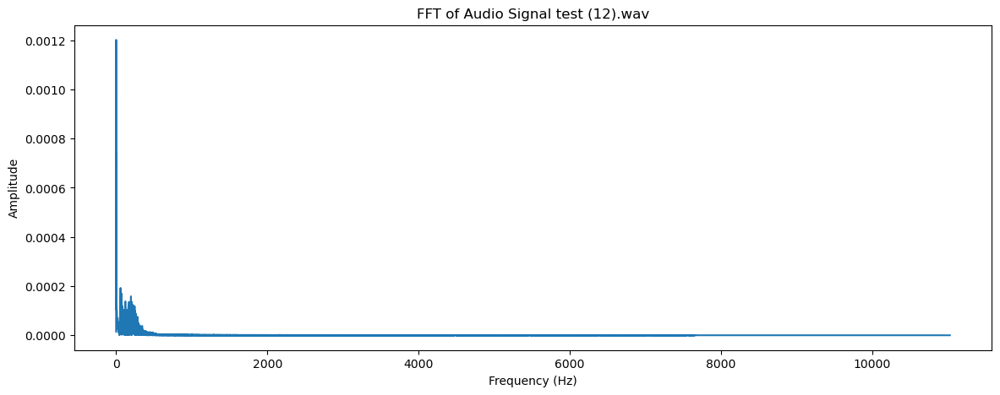

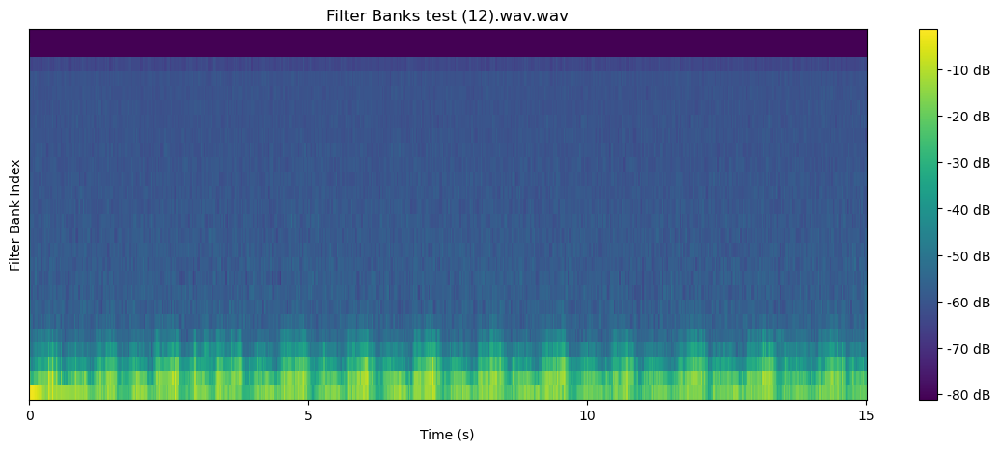

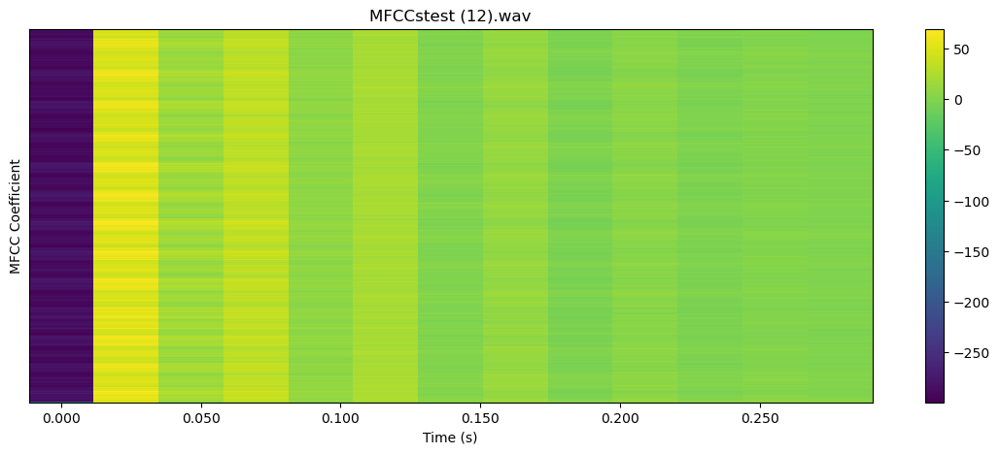

 21%|██        | 4/19 [00:14<00:54,  3.64s/it]

22050


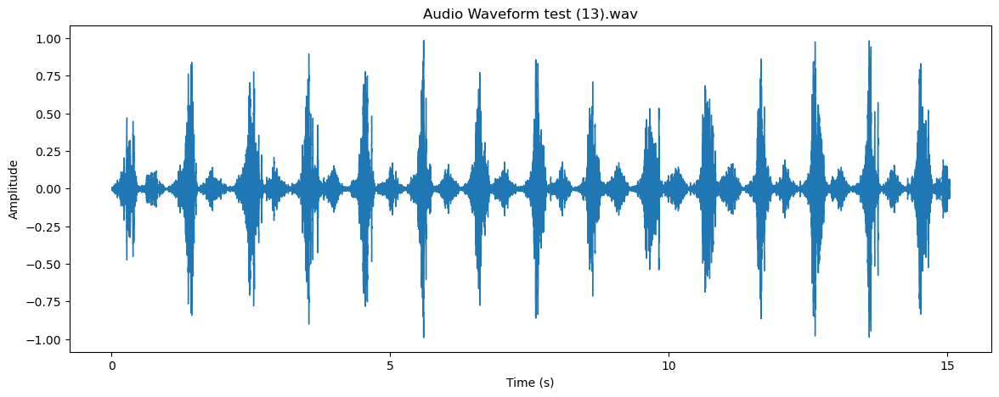

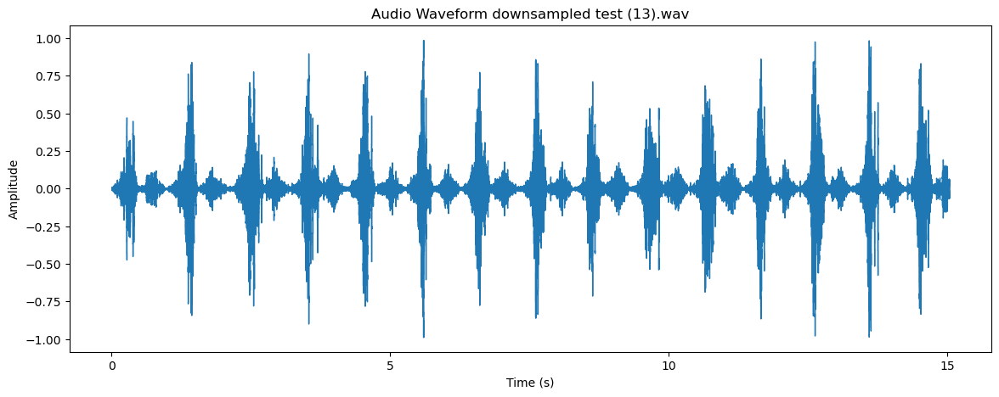

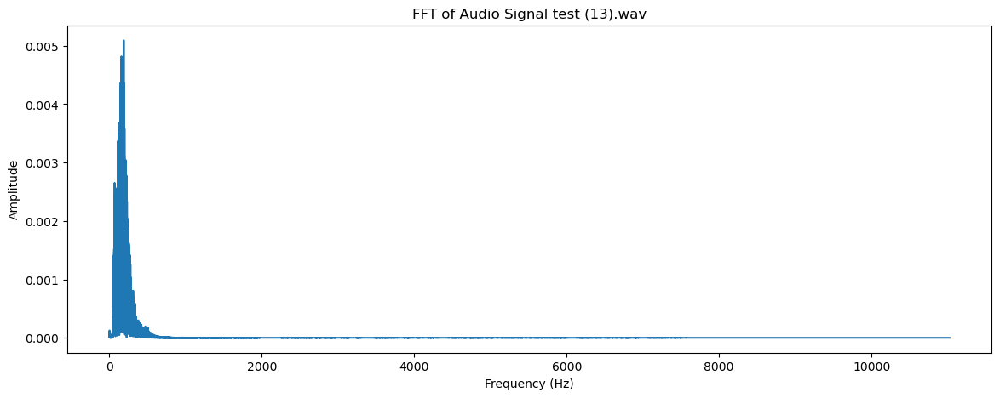

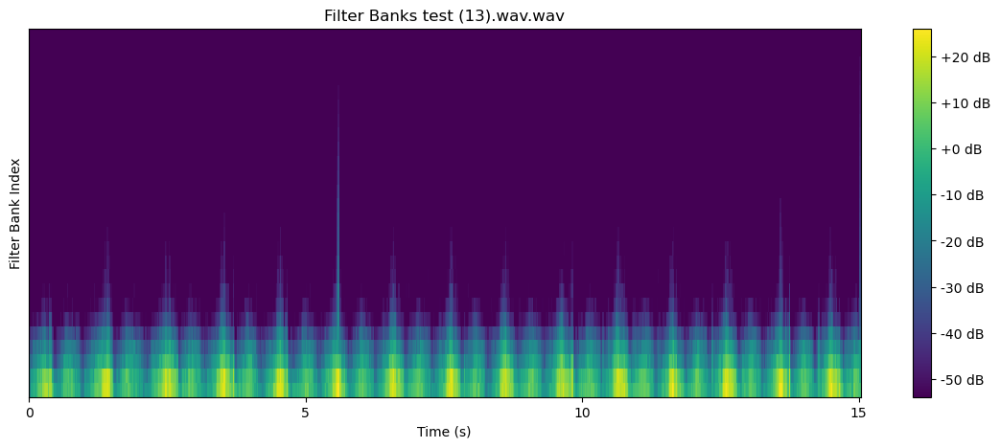

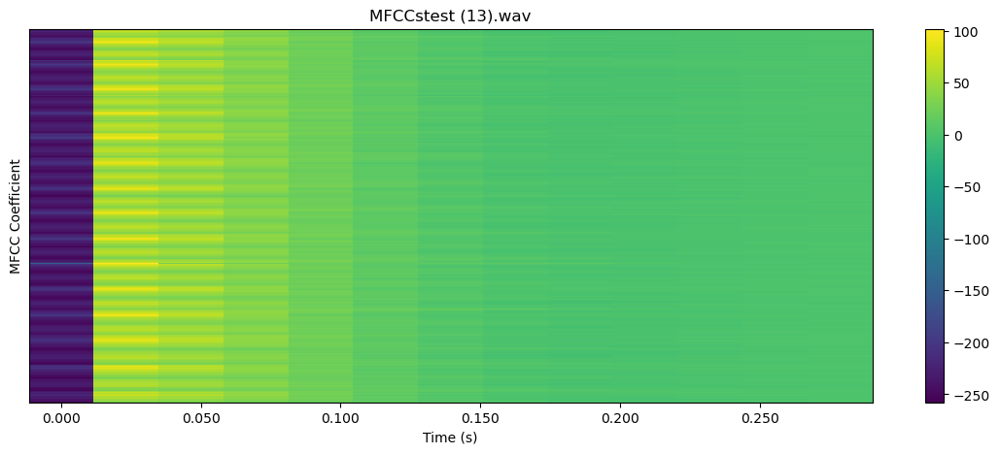

 26%|██▋       | 5/19 [00:16<00:44,  3.15s/it]

22050


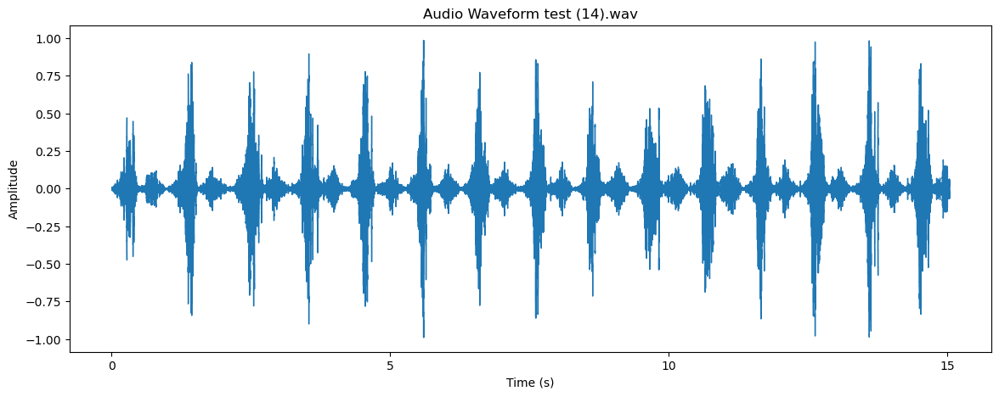

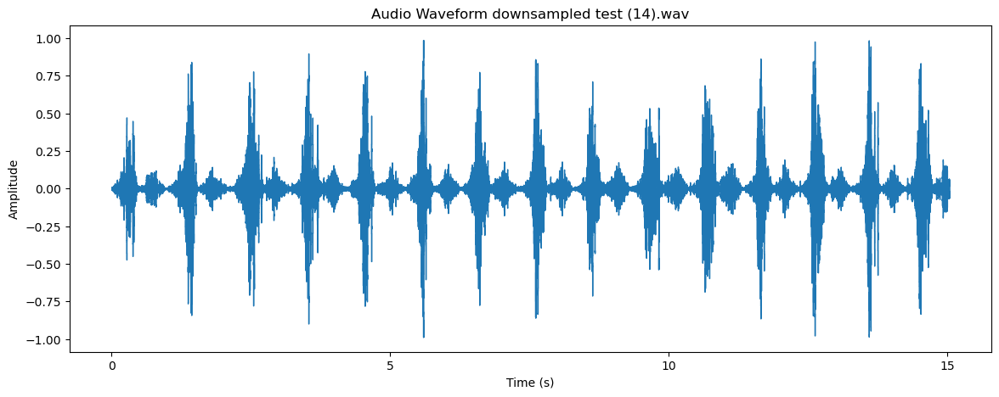

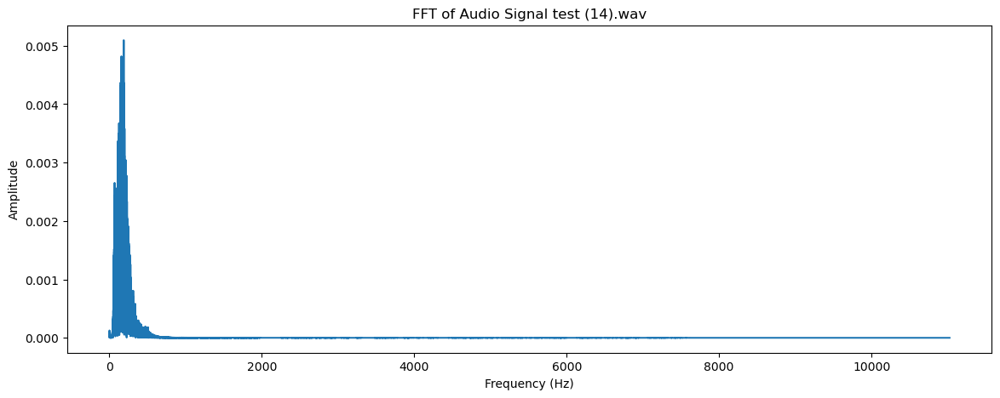

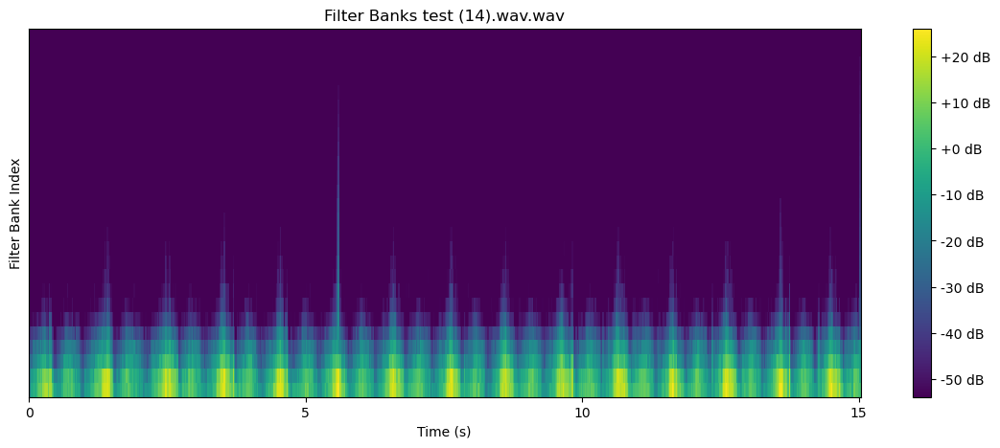

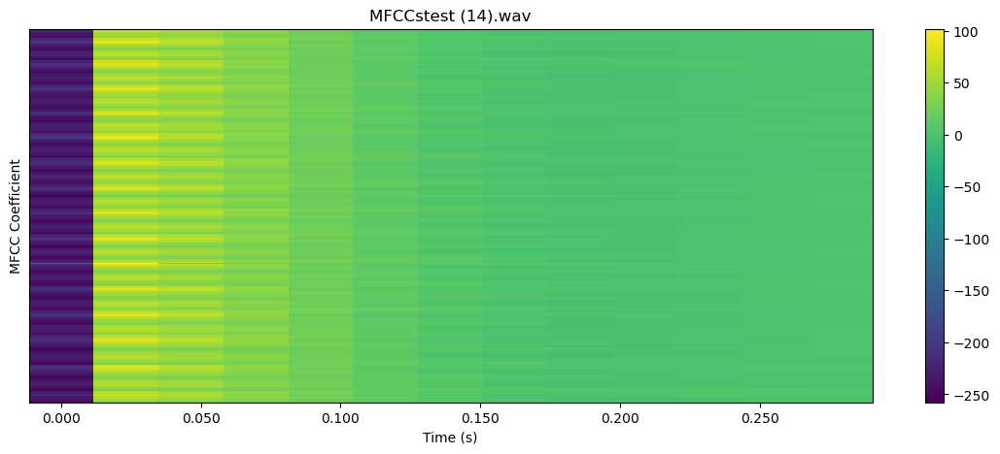

 32%|███▏      | 6/19 [00:19<00:38,  2.96s/it]

22050


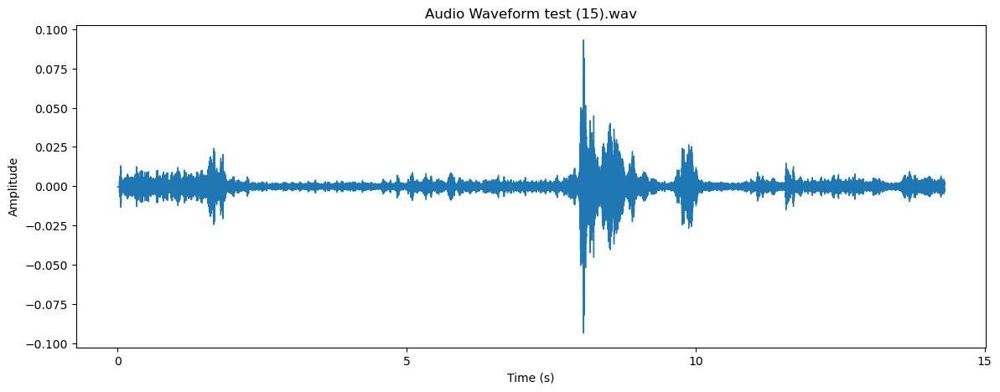

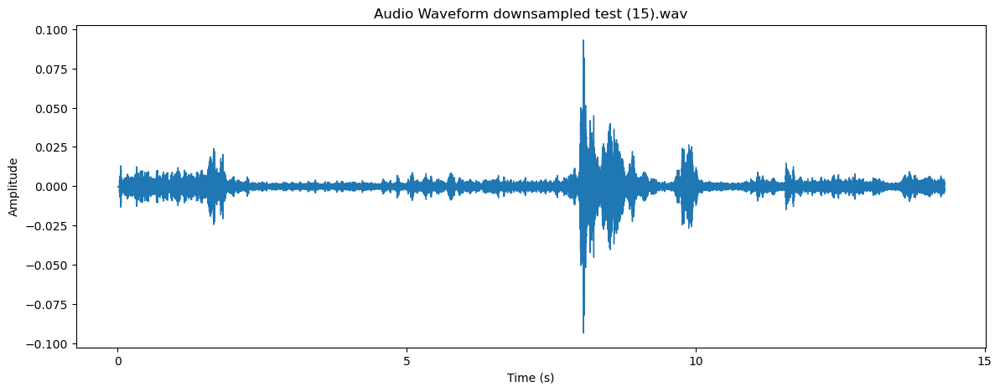

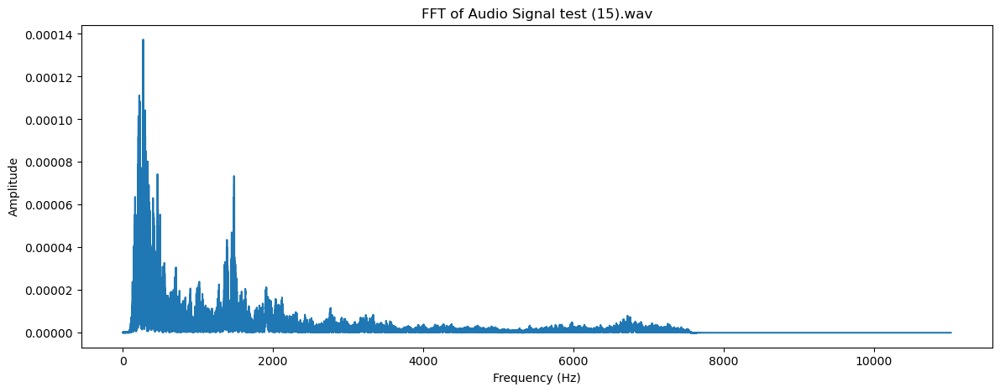

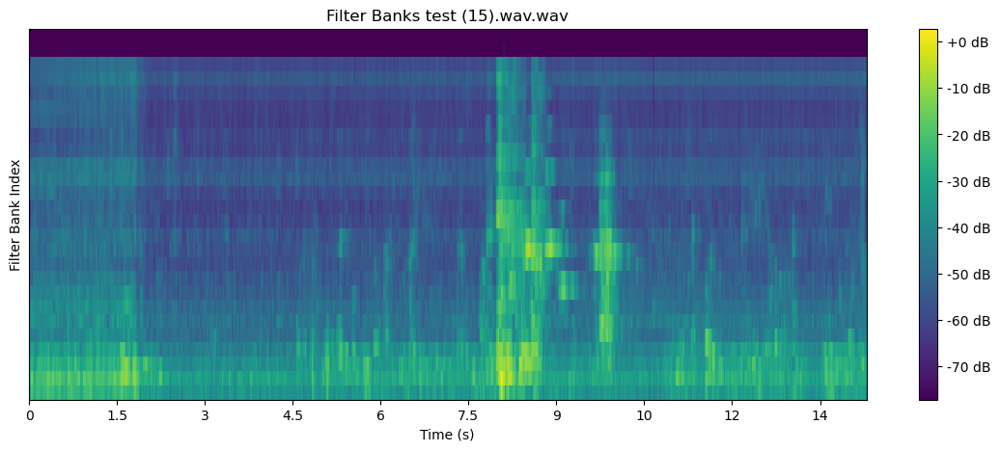

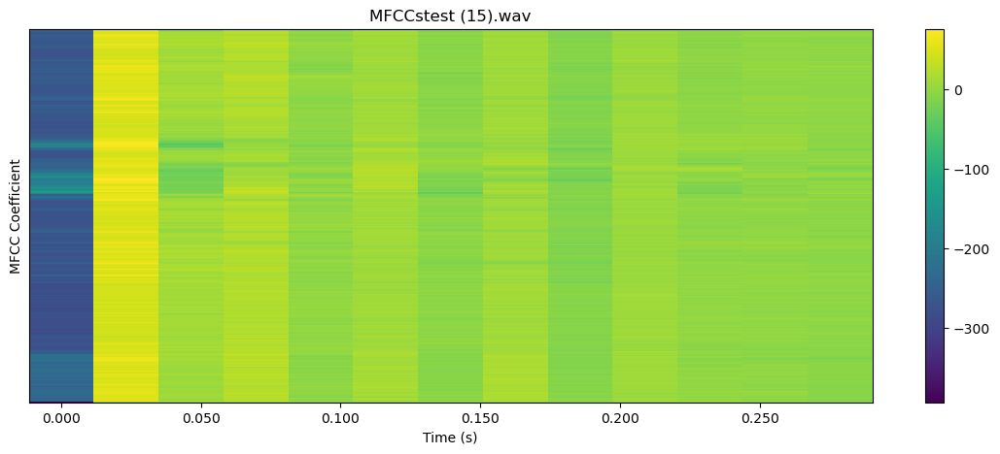

 37%|███▋      | 7/19 [00:24<00:43,  3.65s/it]

22050


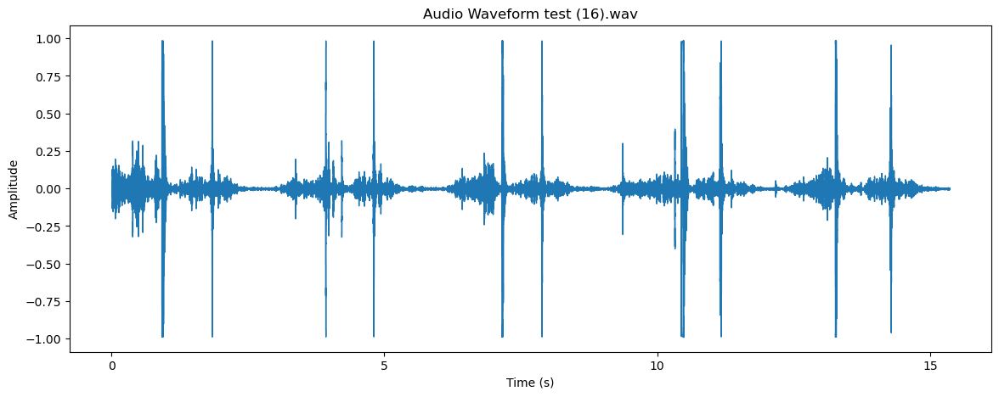

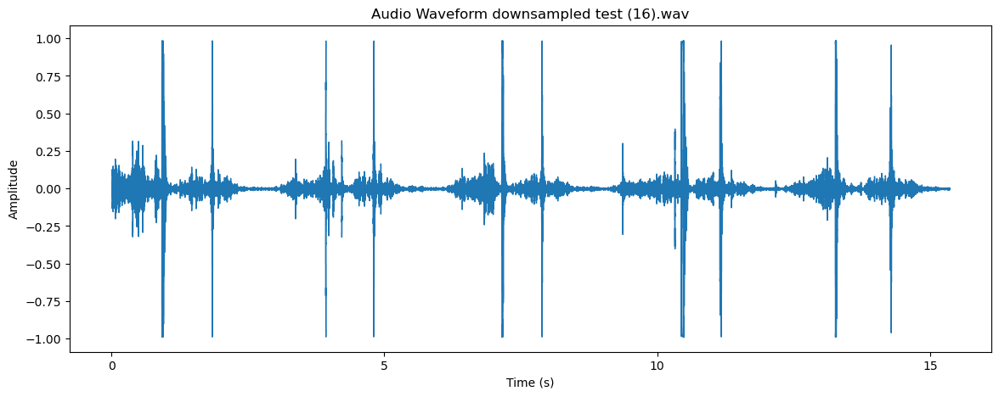

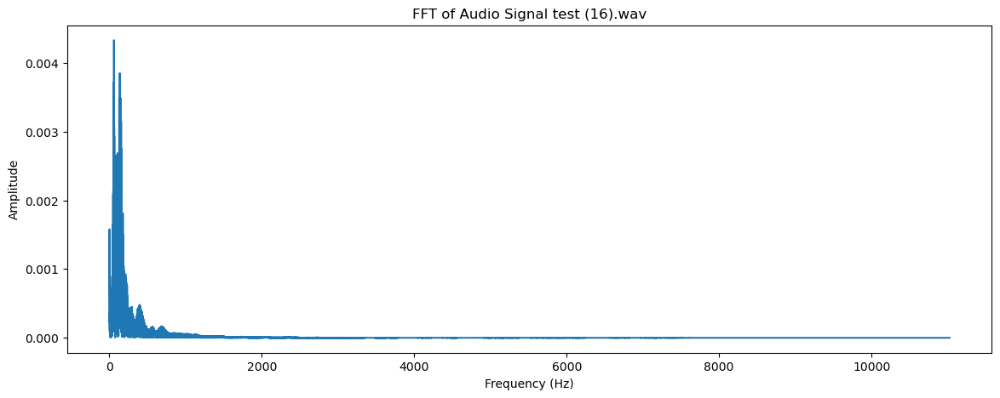

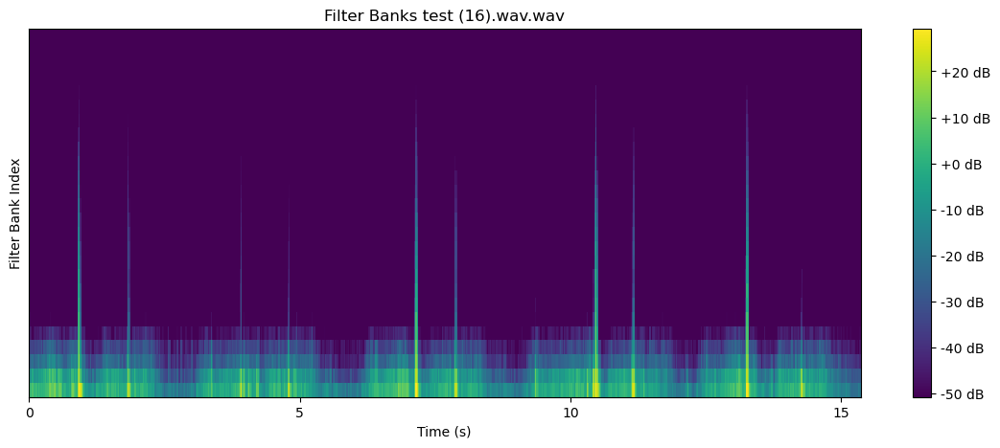

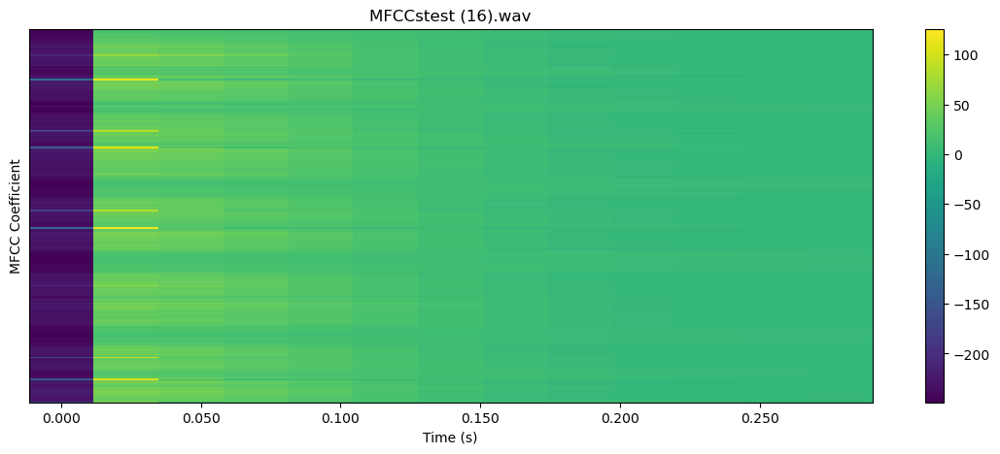

 42%|████▏     | 8/19 [00:29<00:47,  4.27s/it]

22050


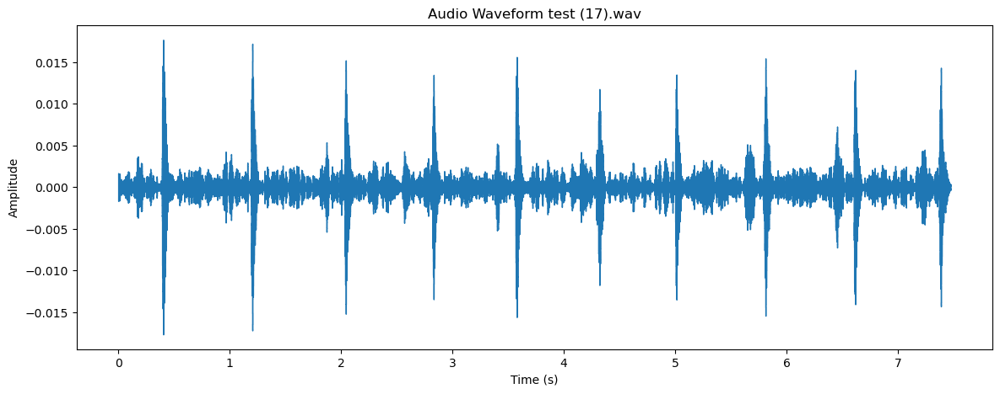

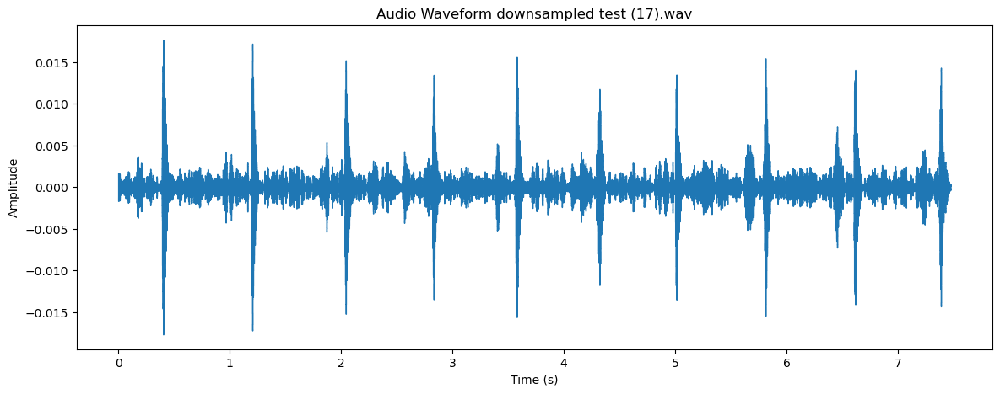

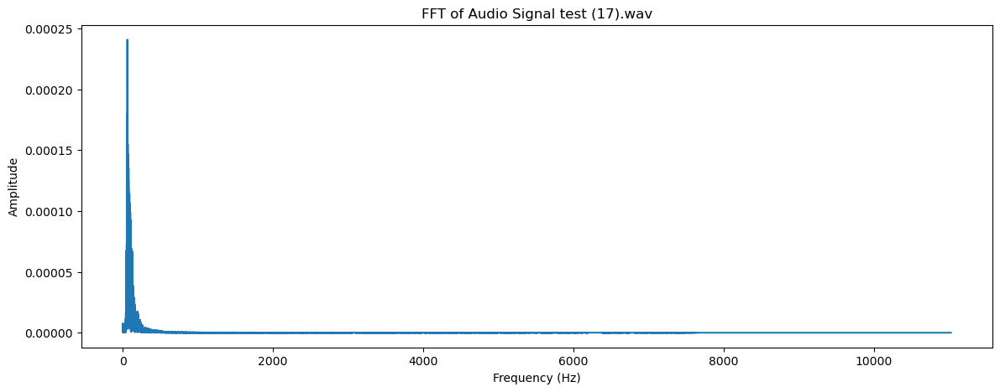

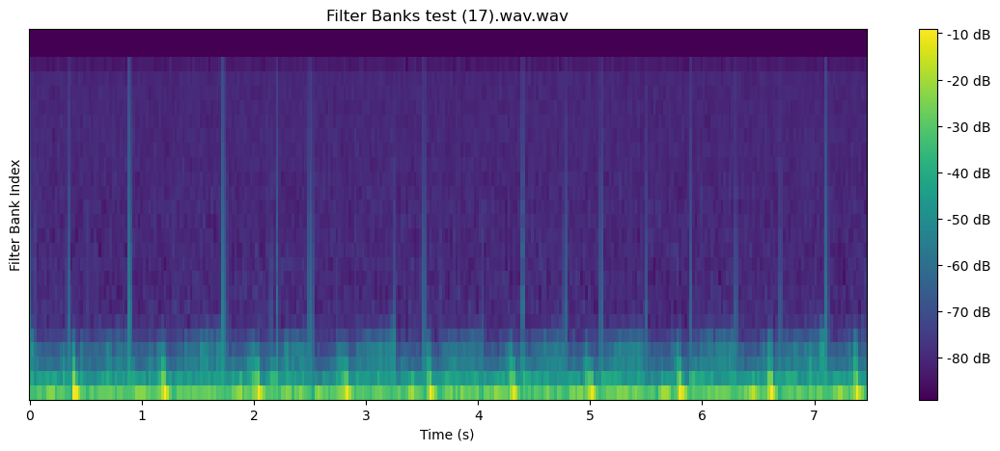

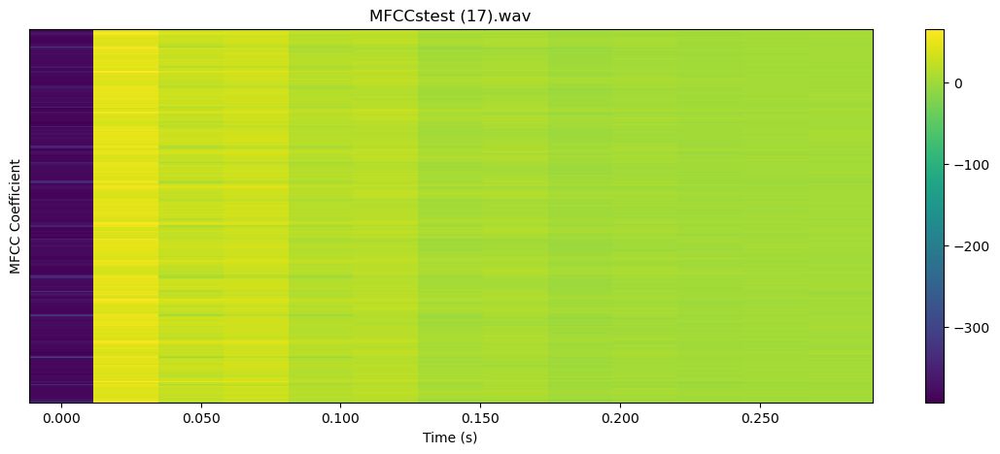

 47%|████▋     | 9/19 [00:35<00:48,  4.80s/it]

22050


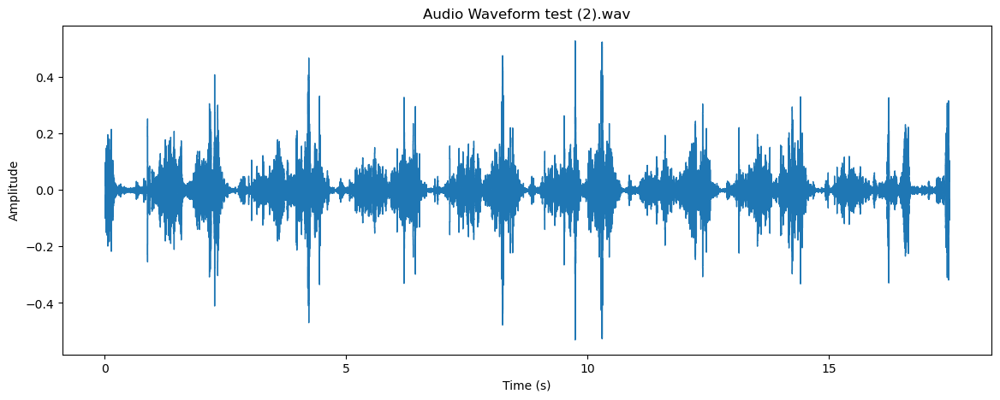

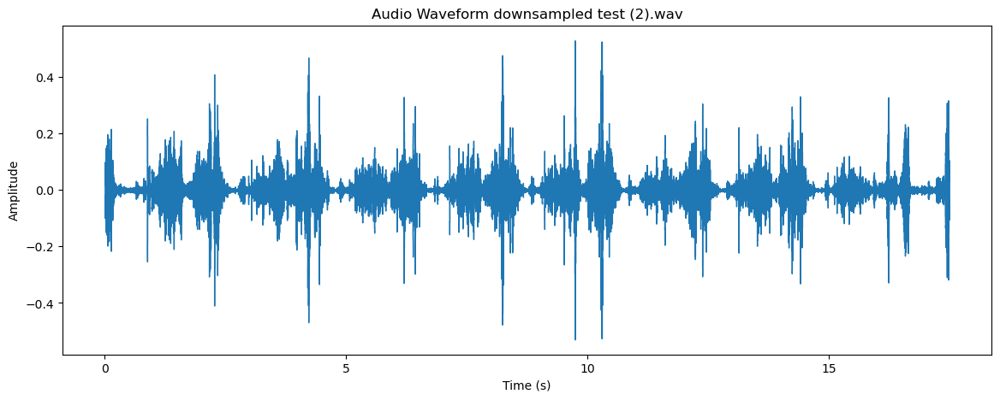

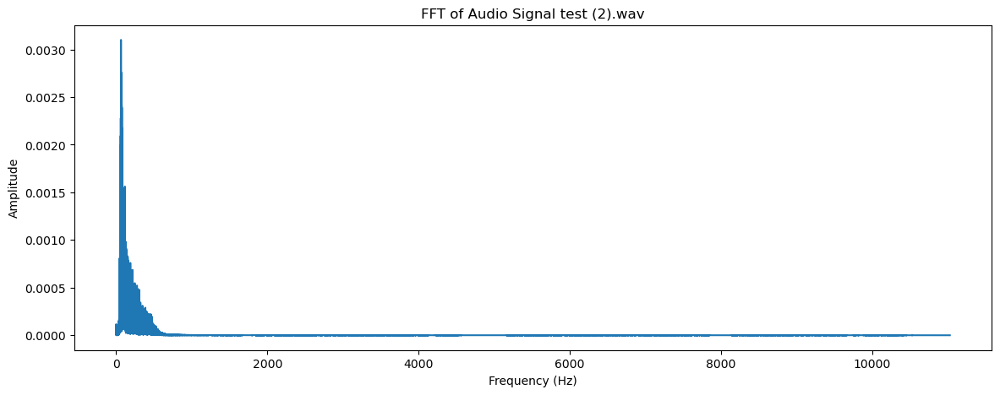

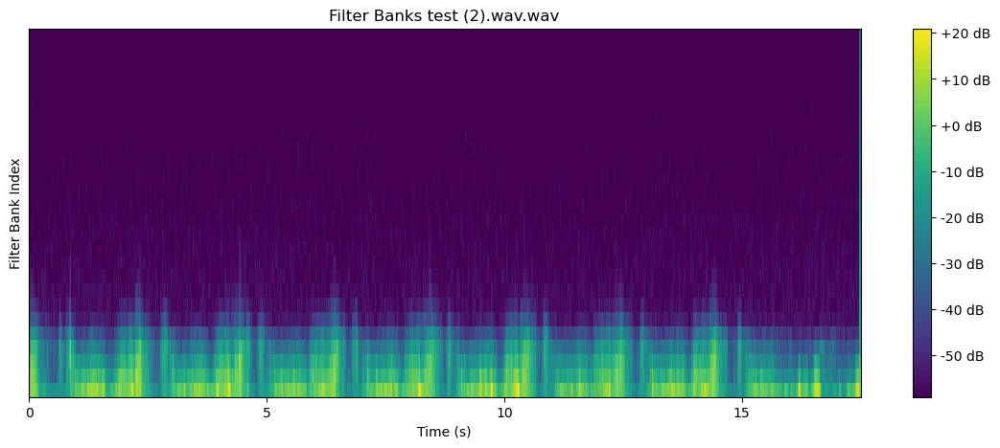

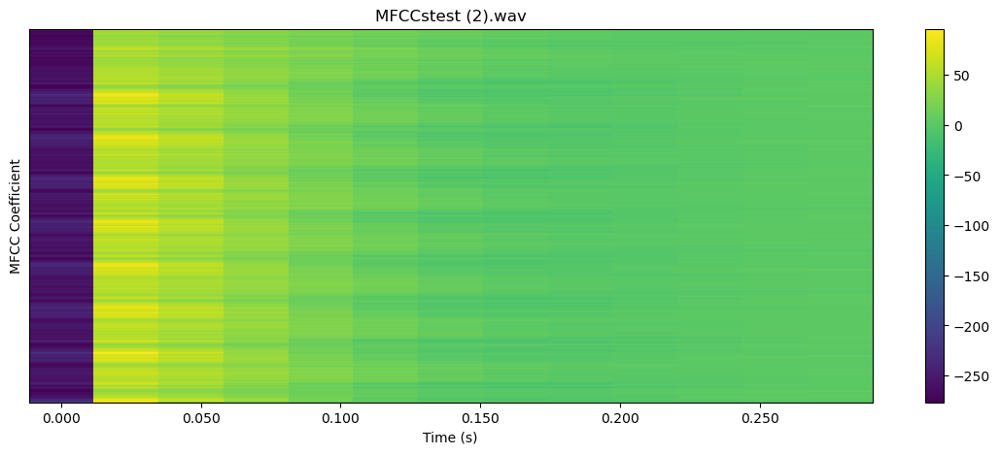

 53%|█████▎    | 10/19 [00:42<00:48,  5.37s/it]

22050


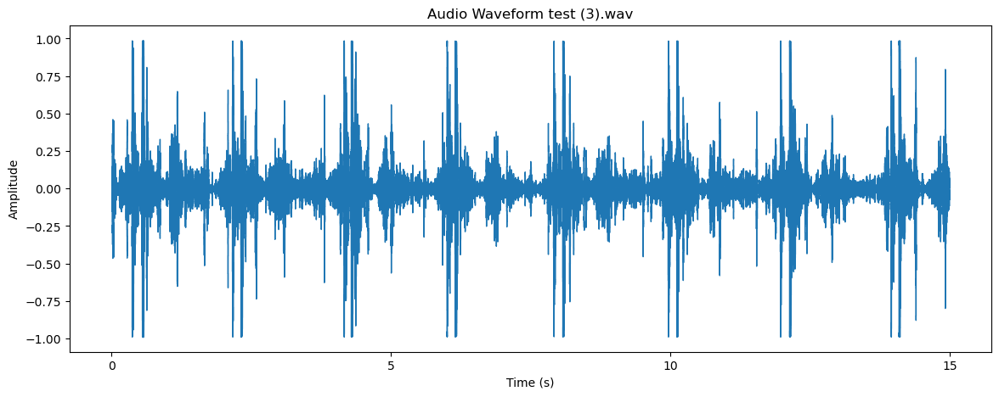

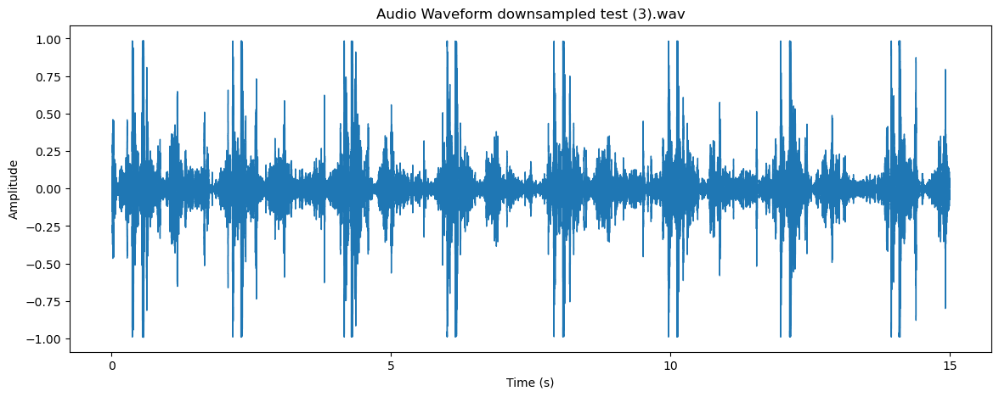

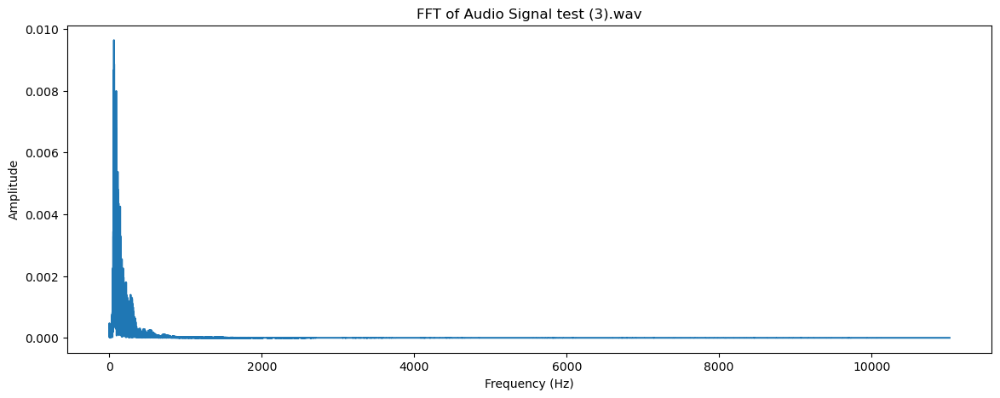

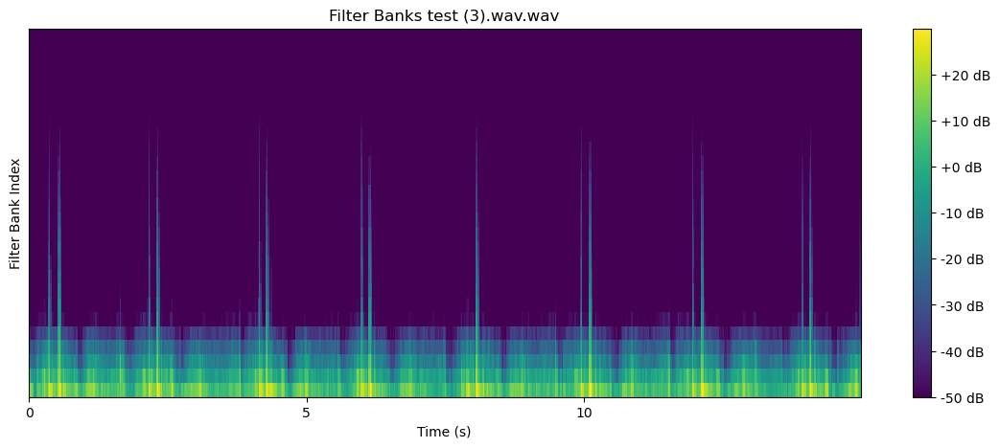

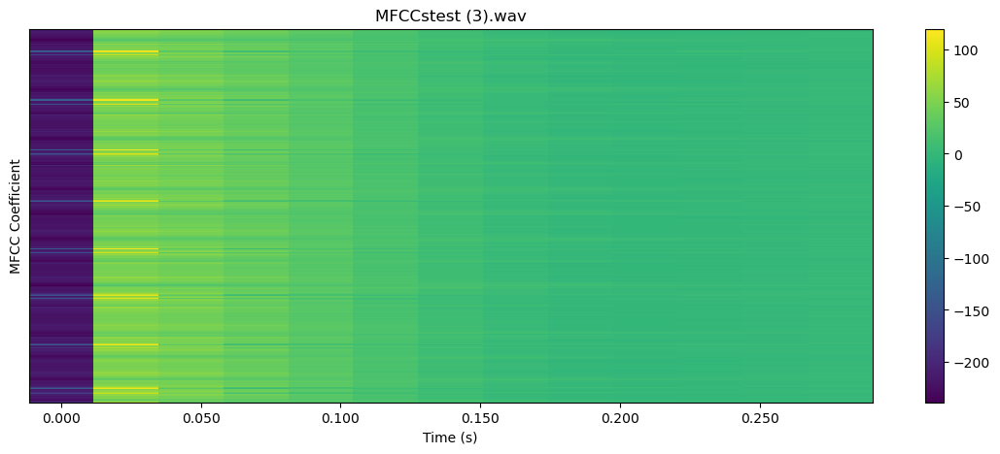

 58%|█████▊    | 11/19 [00:50<00:50,  6.34s/it]

22050


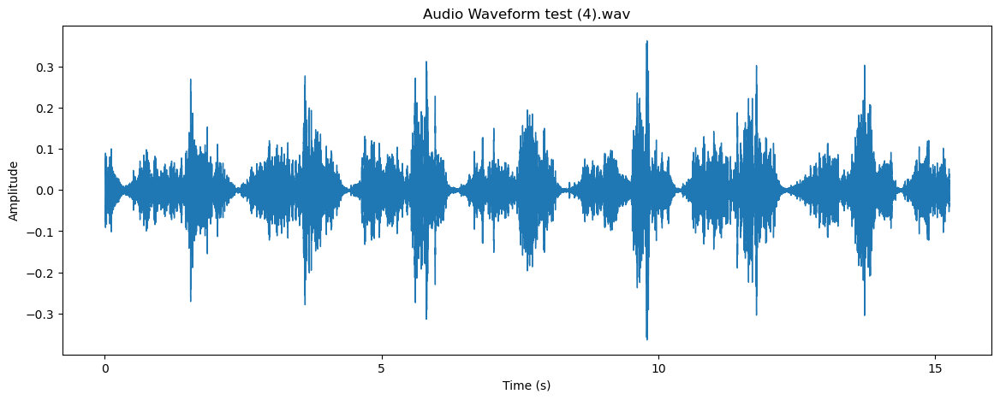

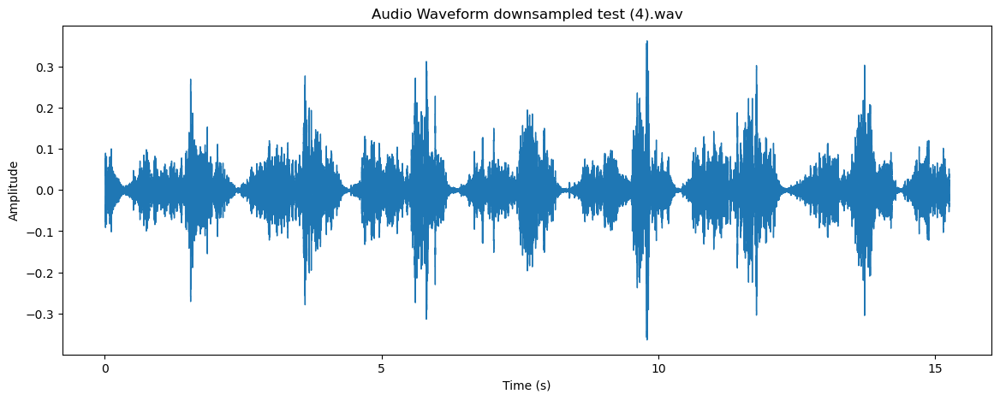

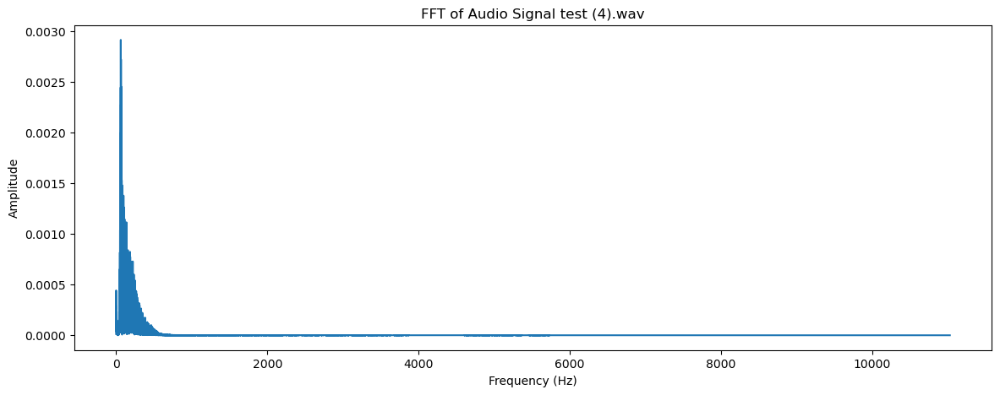

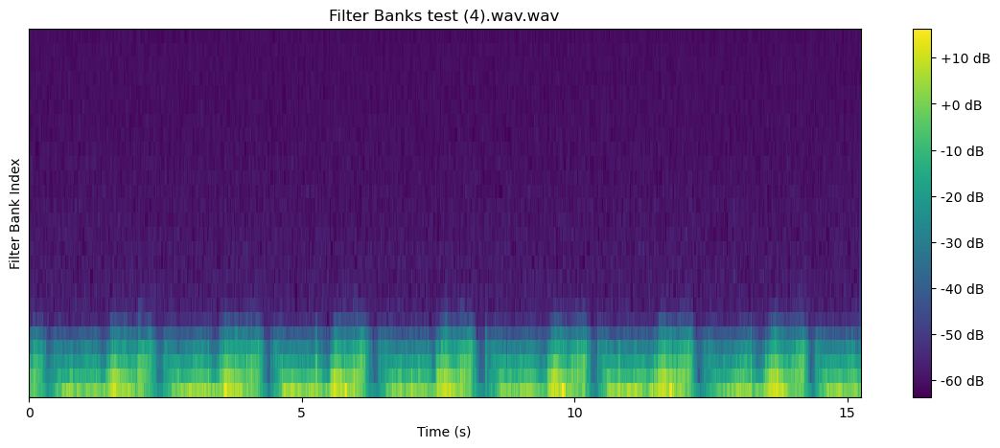

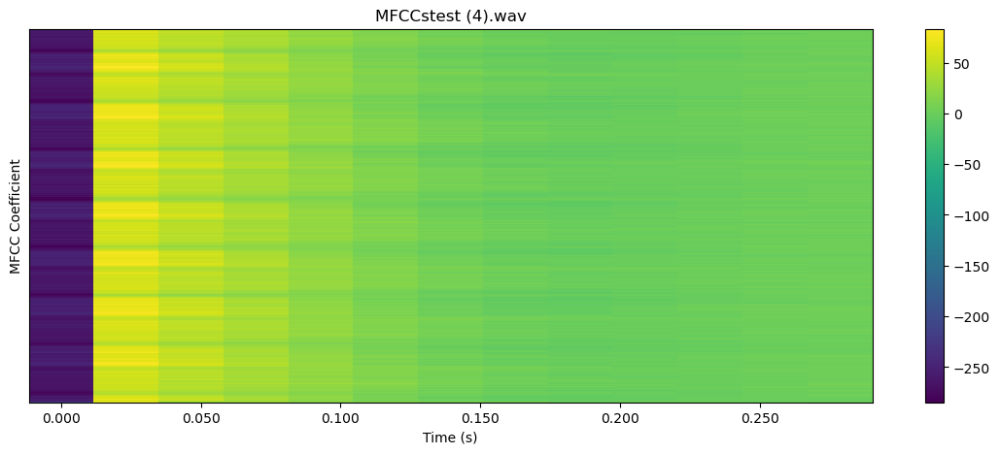

 63%|██████▎   | 12/19 [00:57<00:44,  6.35s/it]

22050


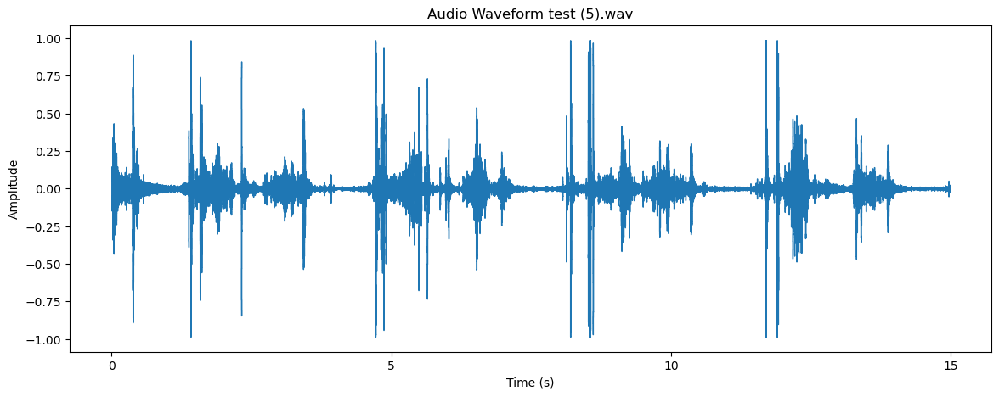

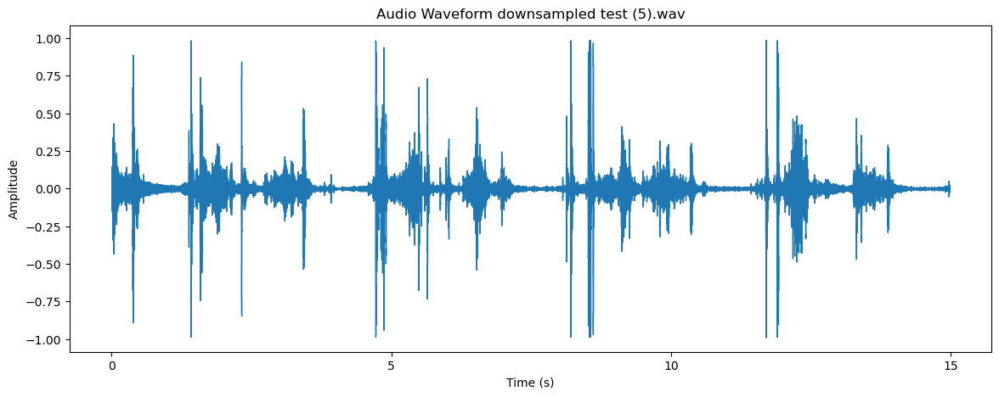

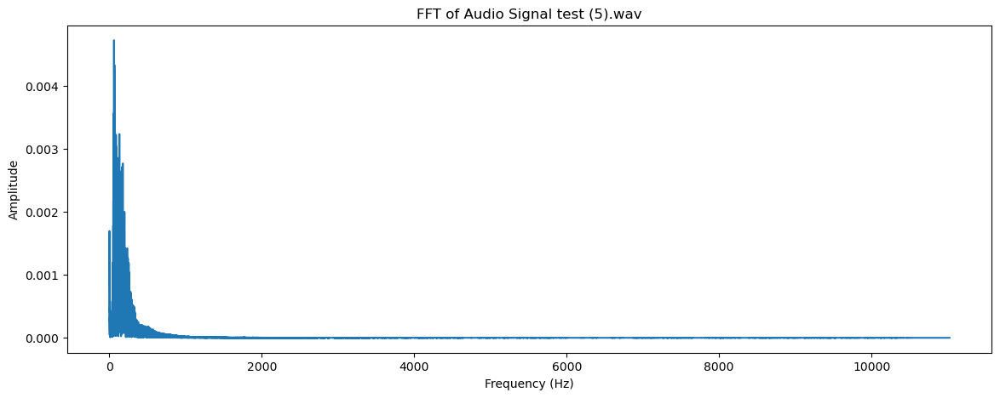

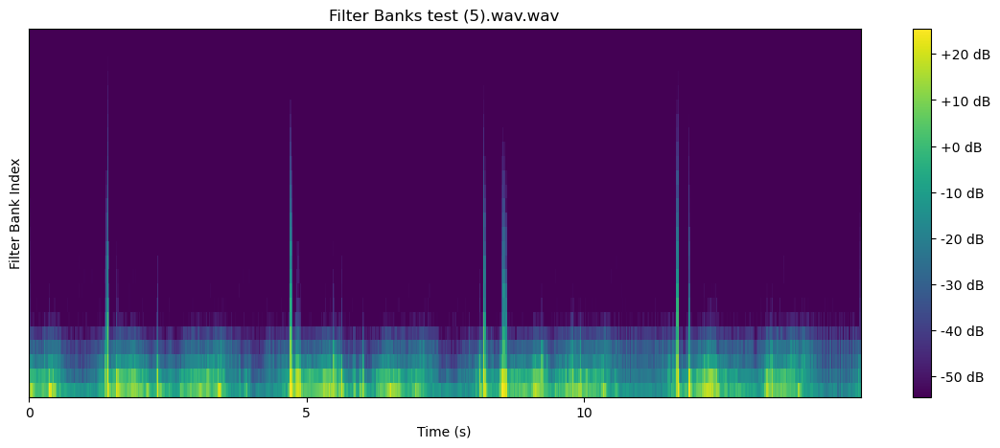

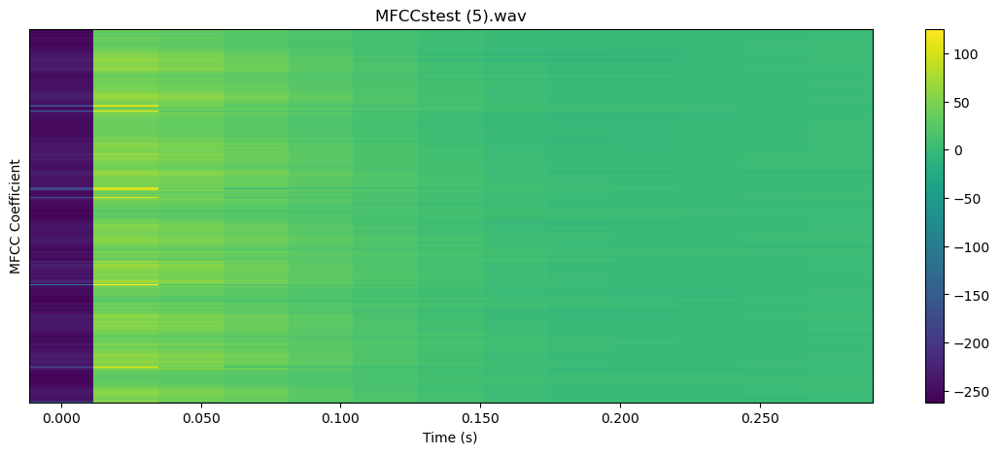

 68%|██████▊   | 13/19 [01:04<00:38,  6.47s/it]

22050


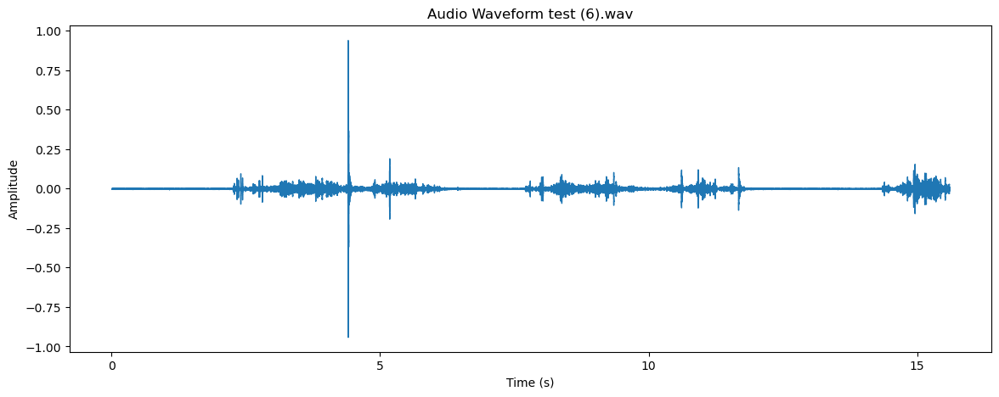

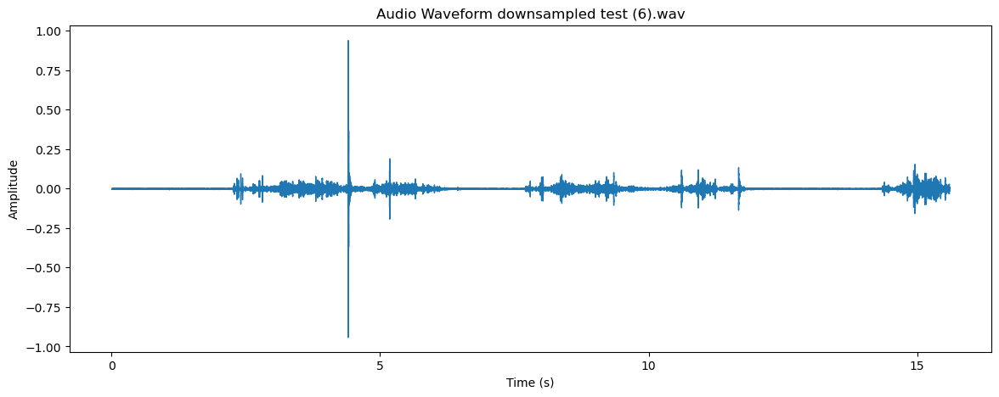

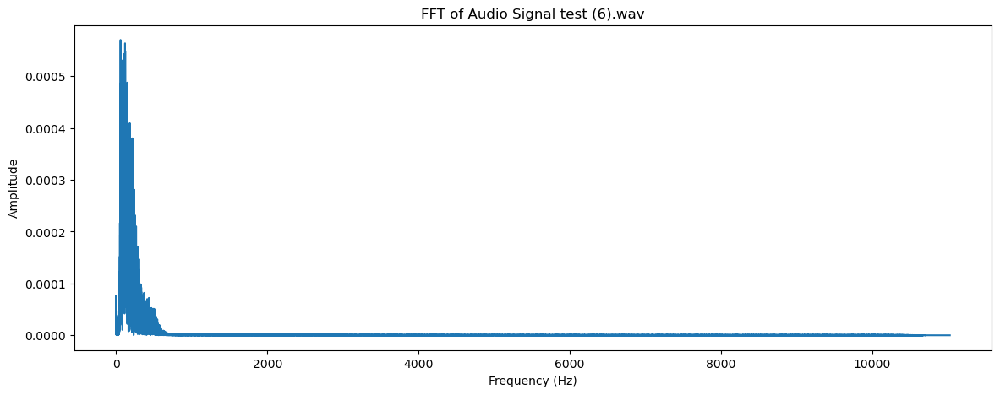

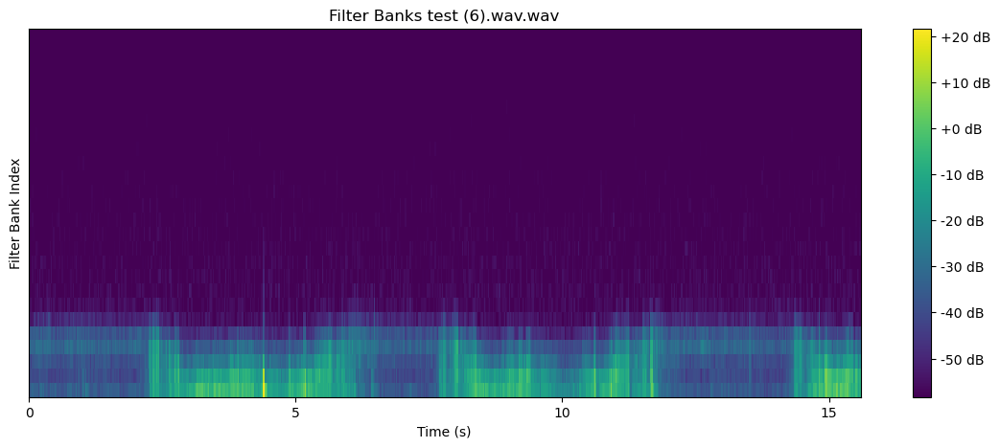

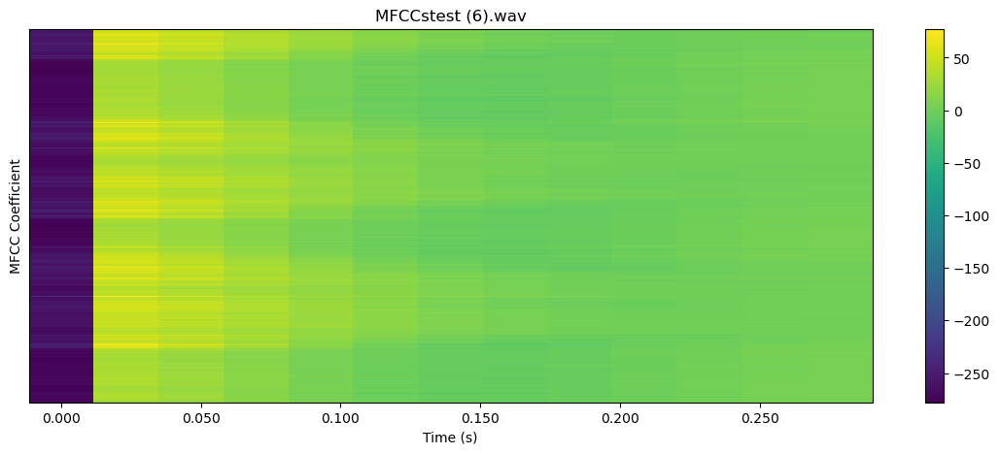

 74%|███████▎  | 14/19 [01:10<00:32,  6.57s/it]

22050


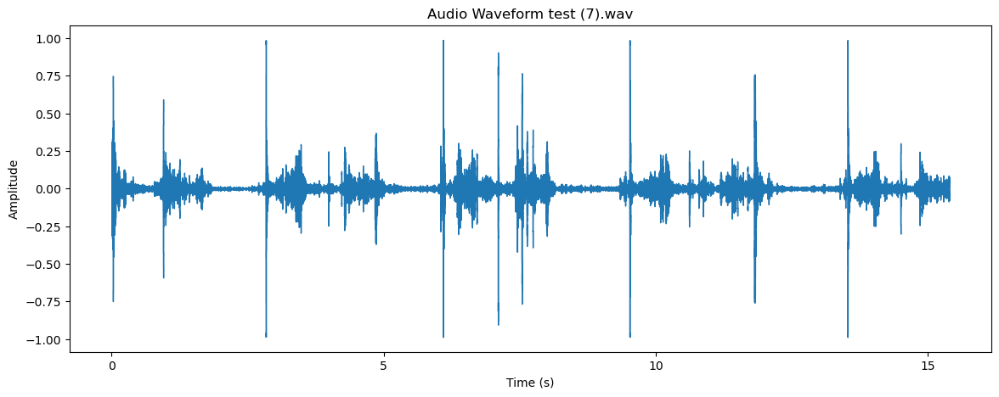

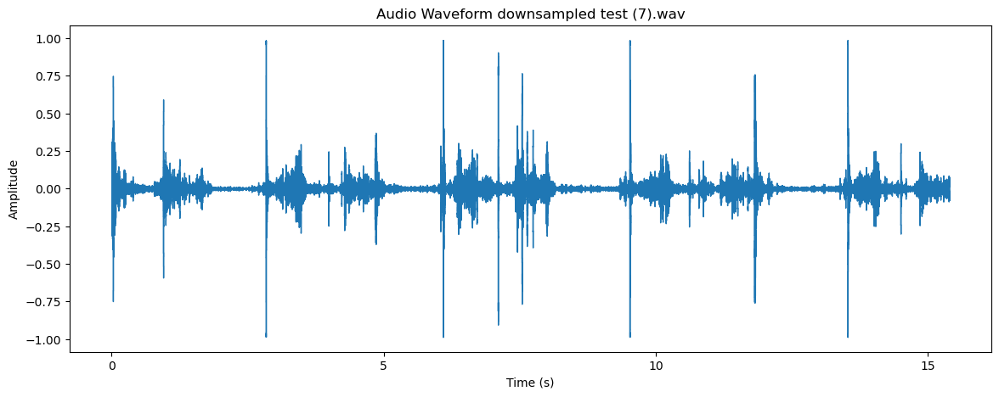

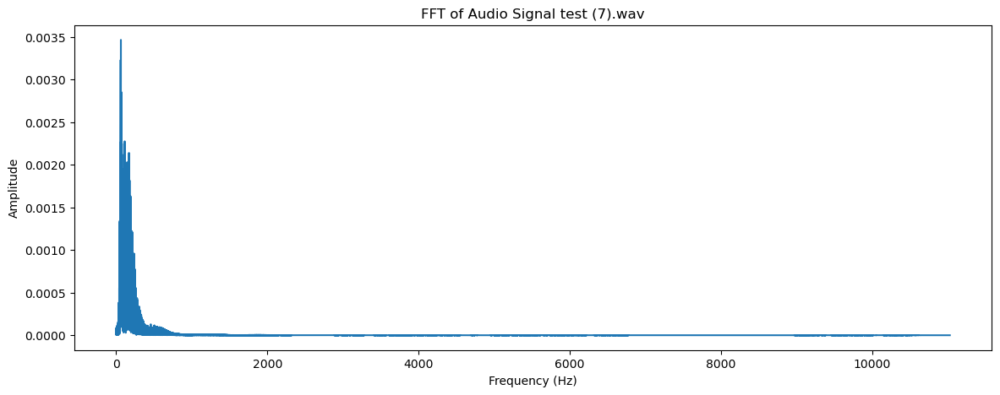

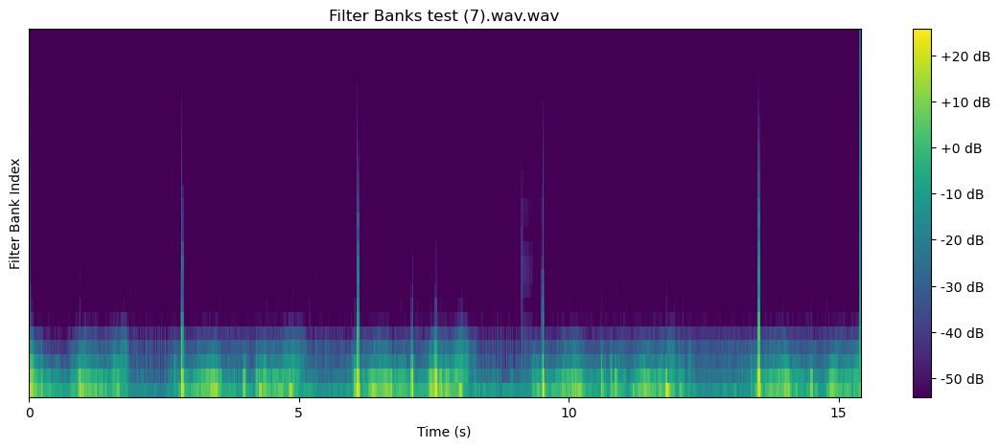

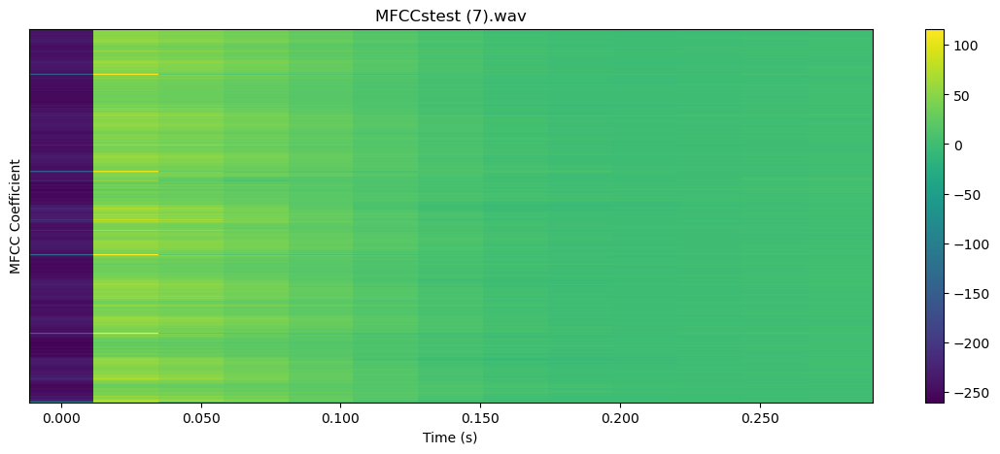

 79%|███████▉  | 15/19 [01:16<00:25,  6.28s/it]

22050


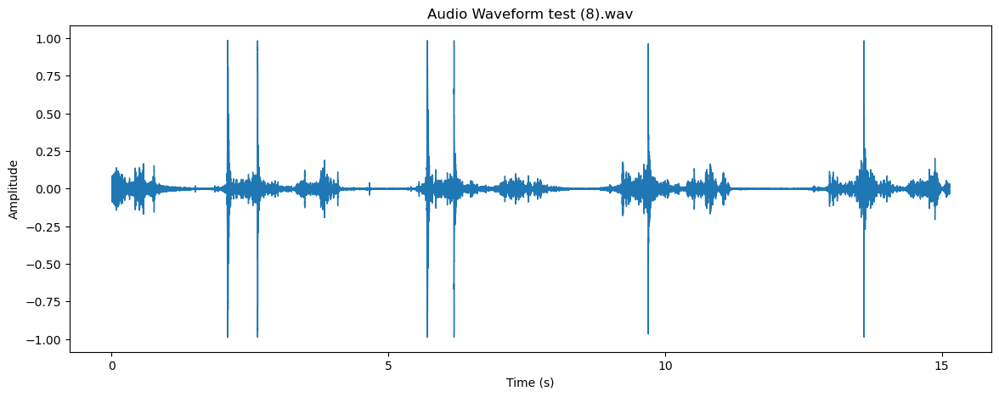

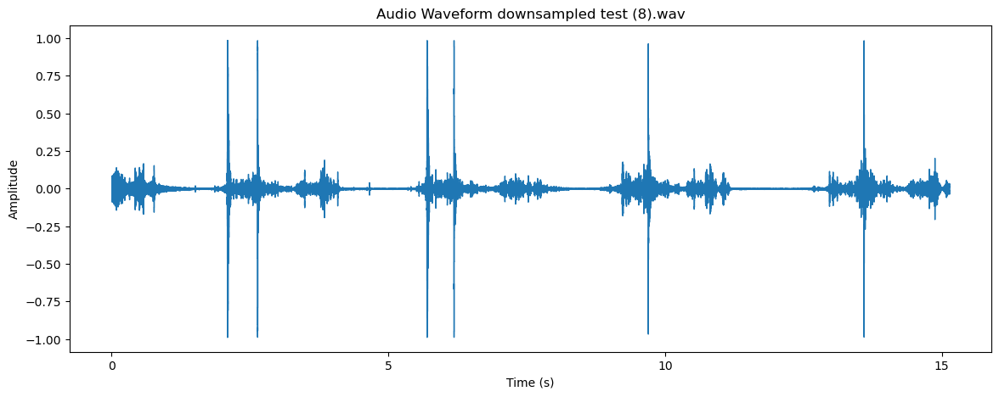

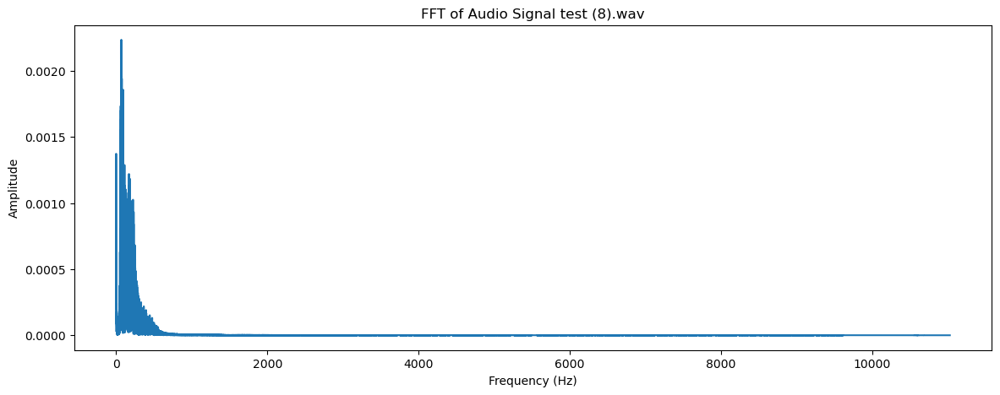

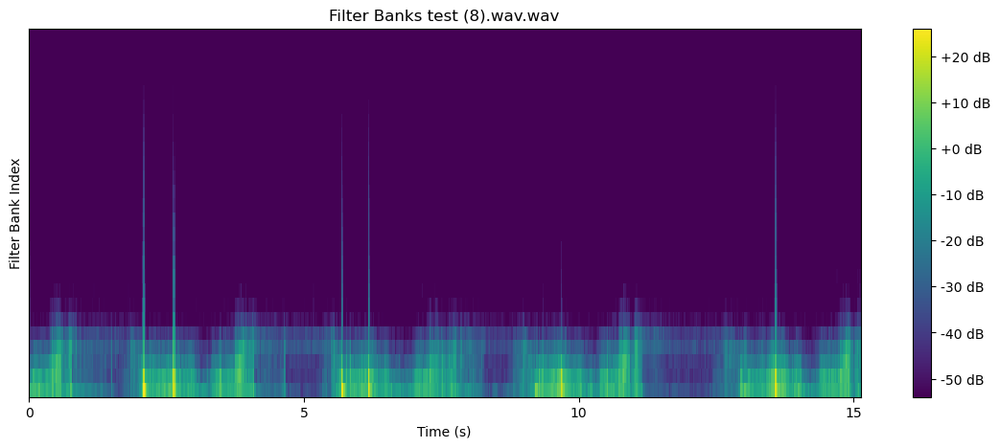

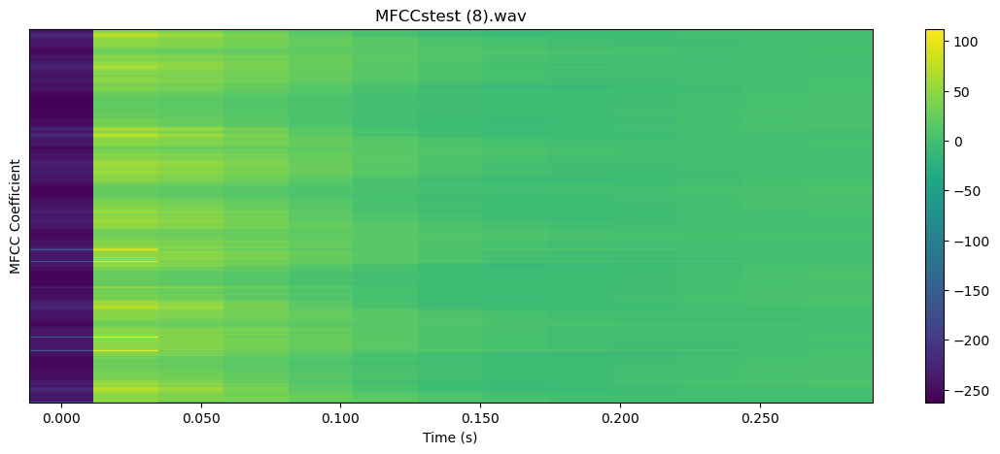

 84%|████████▍ | 16/19 [01:21<00:17,  6.00s/it]

22050


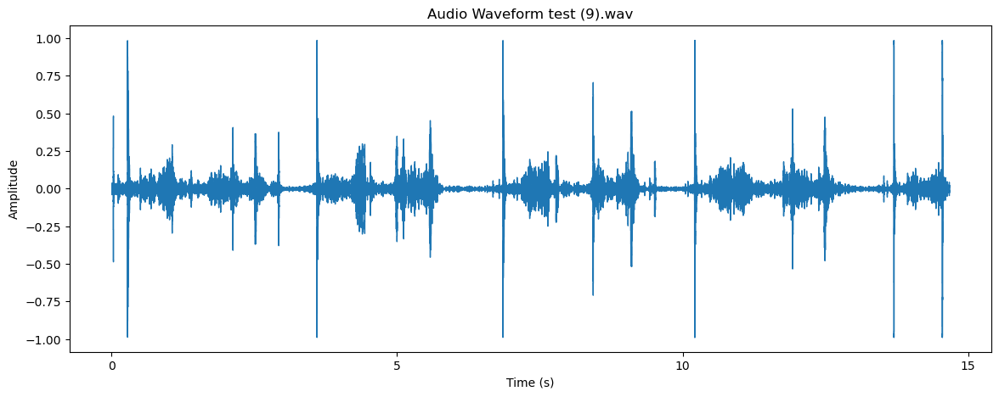

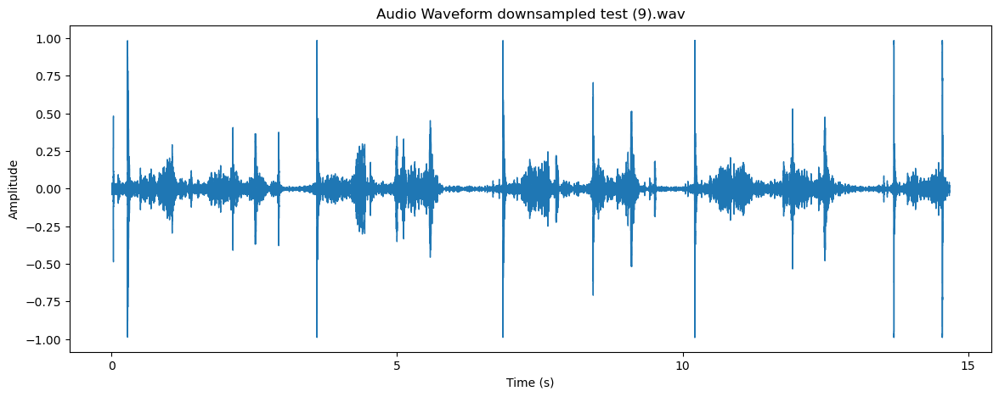

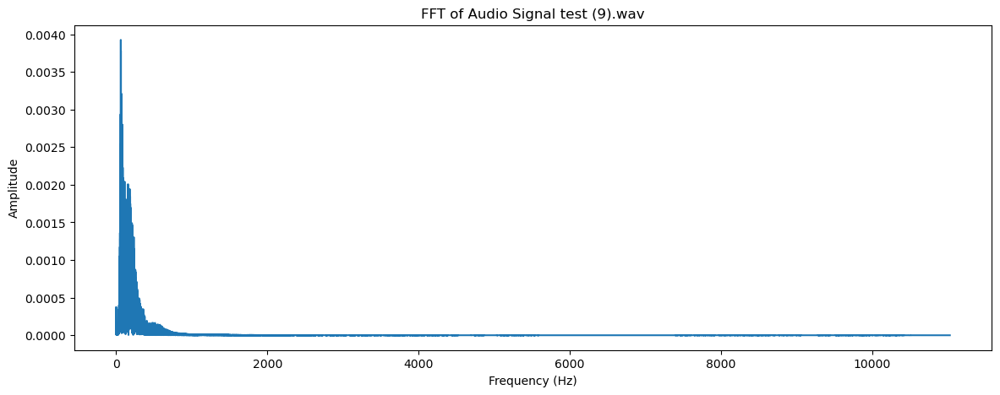

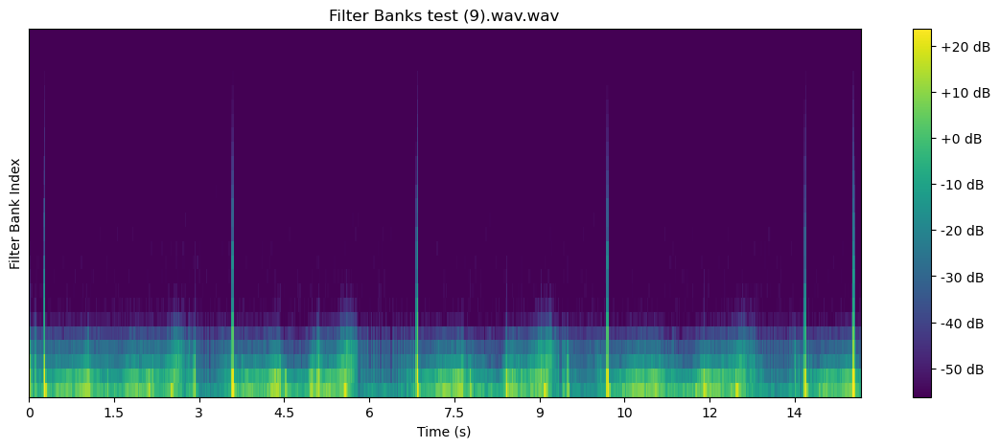

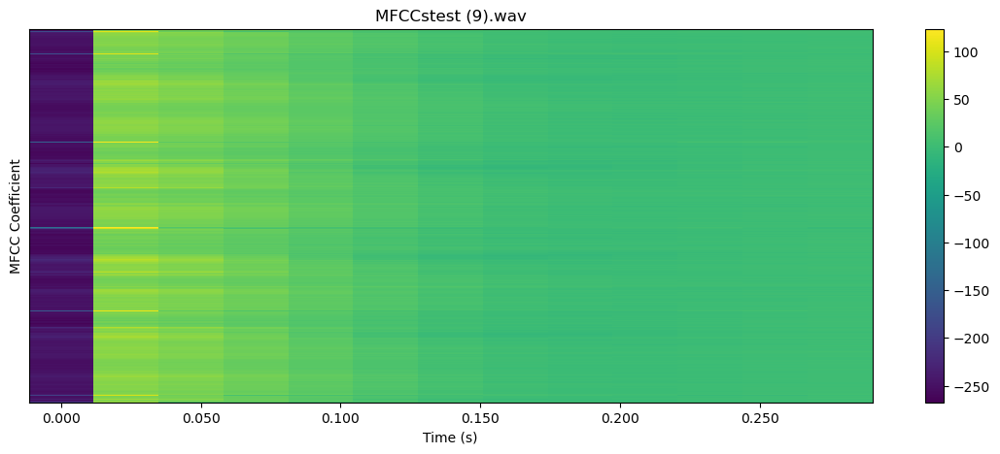

 89%|████████▉ | 17/19 [01:28<00:12,  6.09s/it]

22050


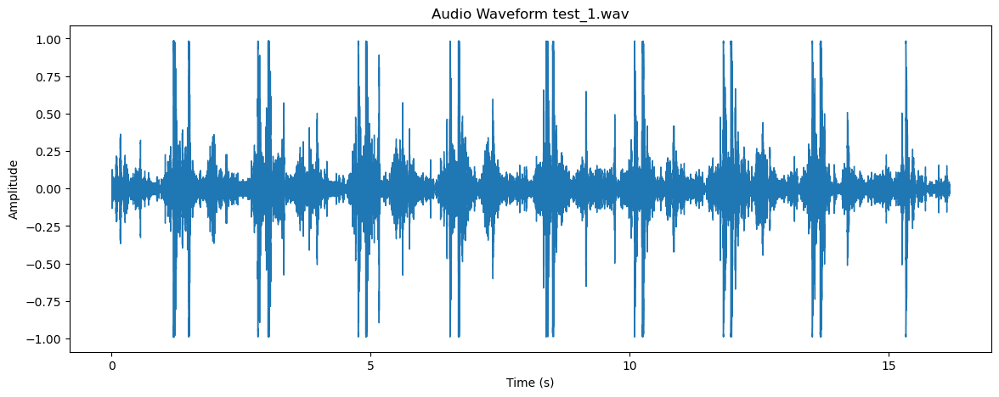

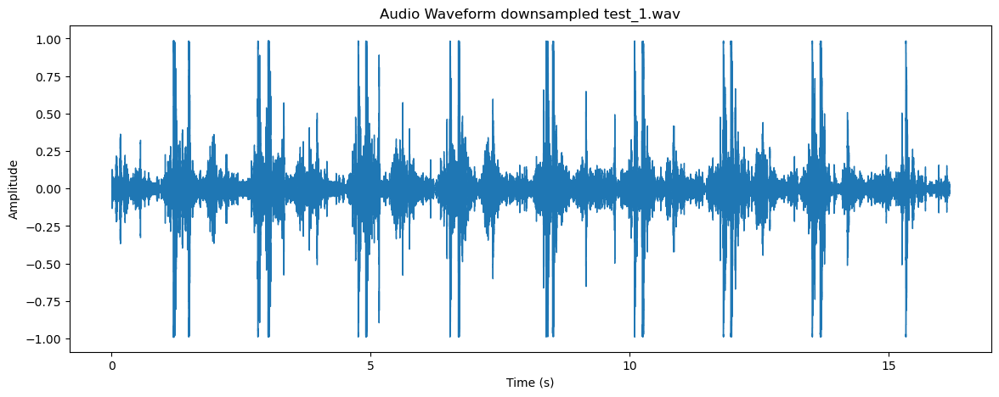

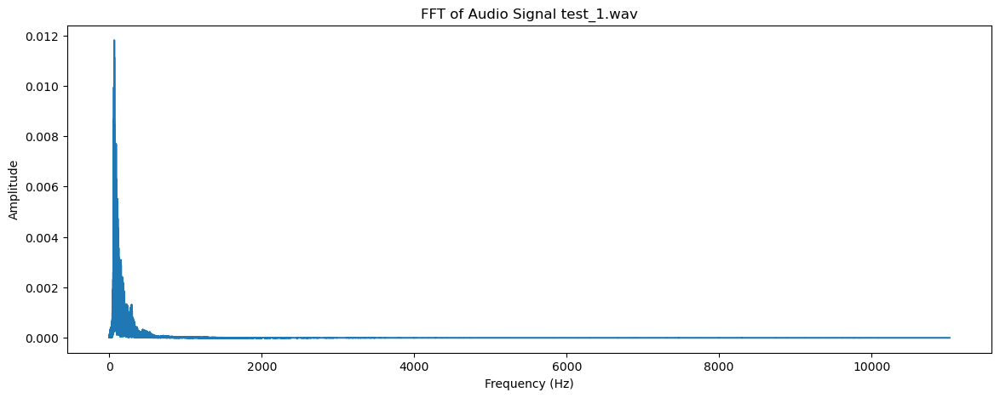

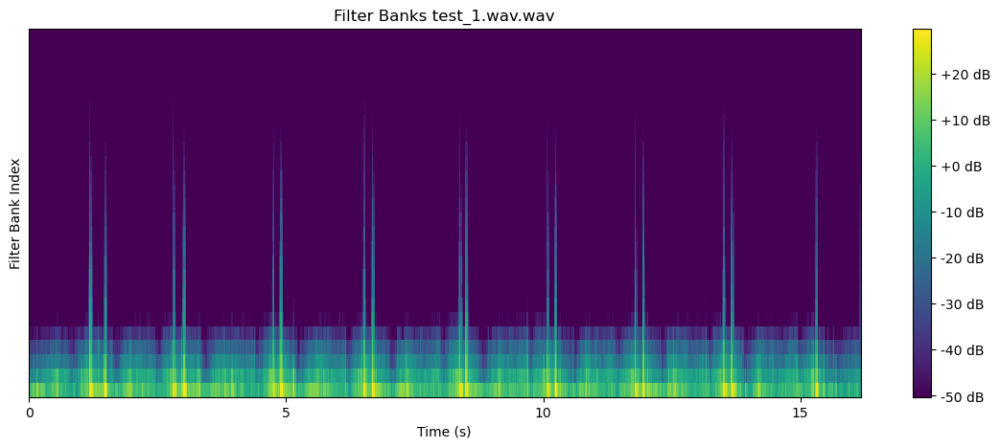

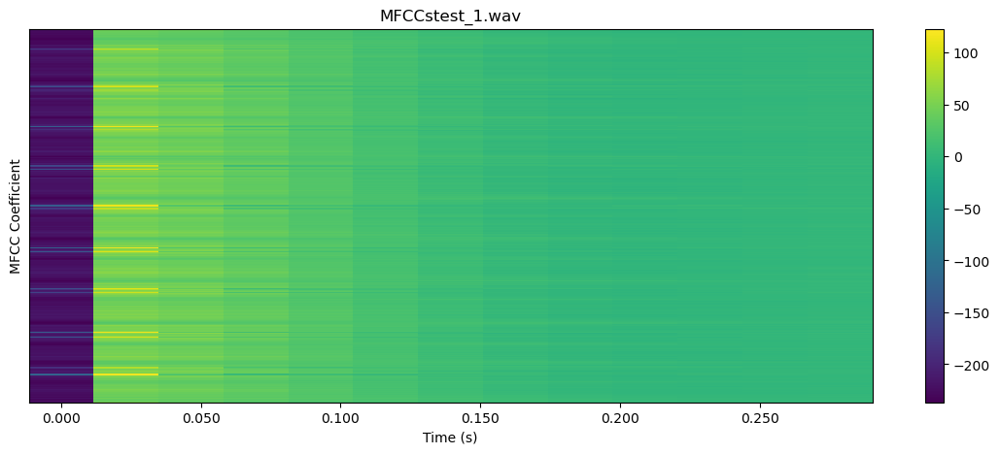

 95%|█████████▍| 18/19 [01:32<00:05,  5.55s/it]

22050


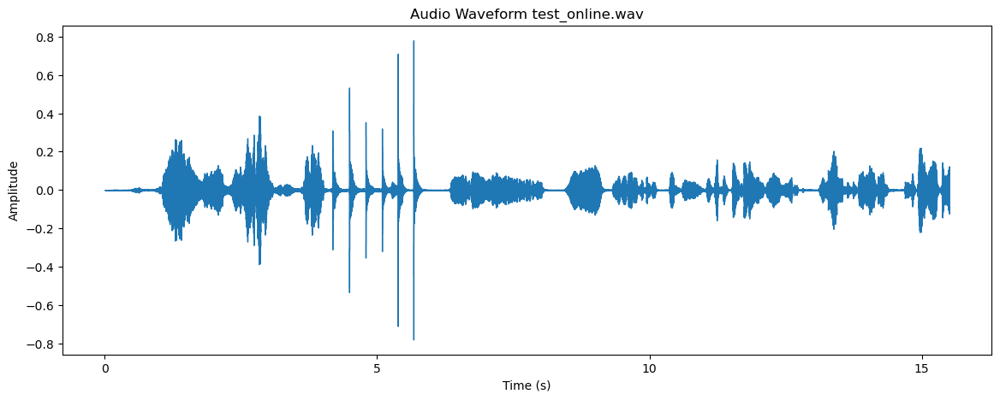

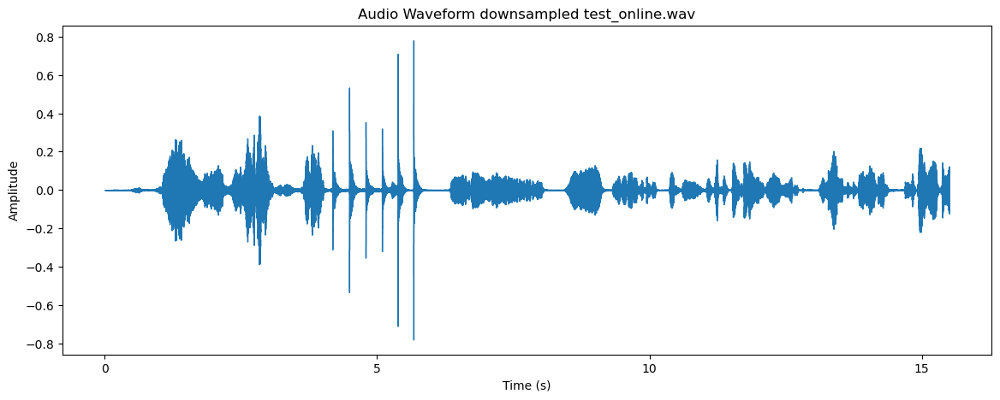

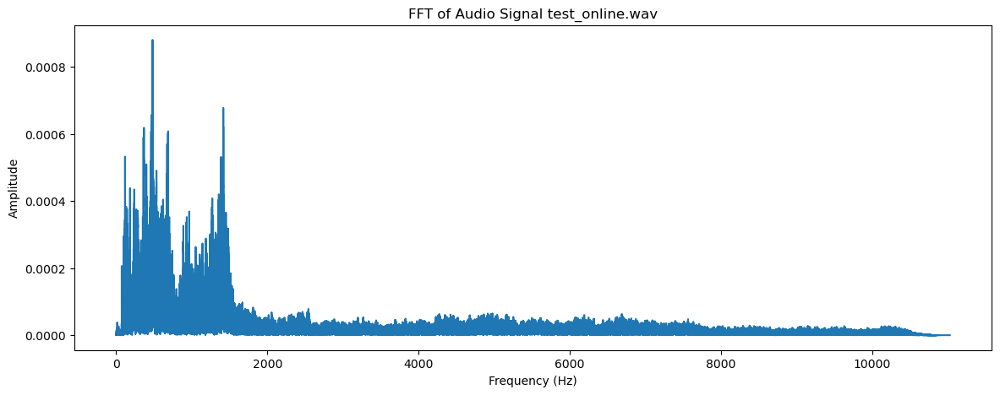

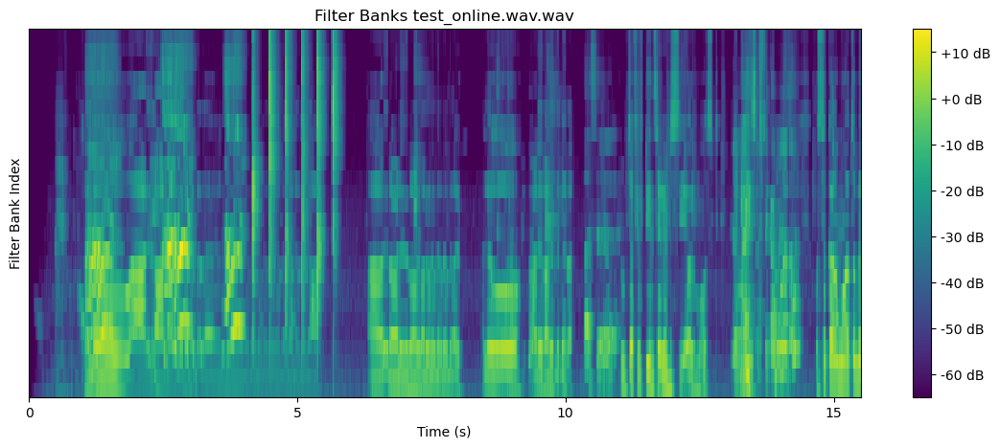

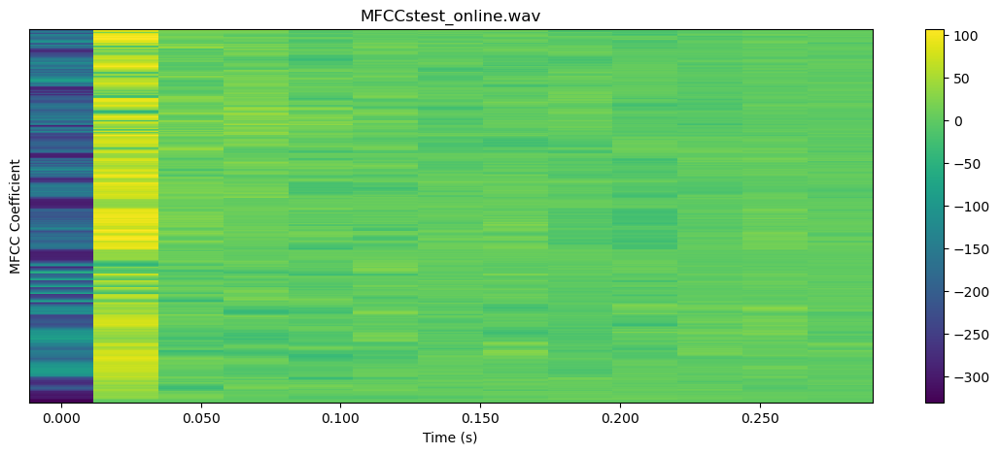

100%|██████████| 19/19 [01:35<00:00,  5.05s/it]


In [27]:
directory_path = 'test'

for file in tqdm(os.listdir(directory_path)):
    audio, sr = librosa.load('test/'+file, sr=22050)
    target_sr=22050
    librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
    print(sr)

    def calc_fft(y , rate):
        n = len(y)

        freq = np.fft.rfftfreq( n , d = 1/rate )## calculates the frequencies corresponding to each bin in a Real-valued Fast Fourier Transform (RFFT).
        Y = abs(np.fft.rfft(y)/n)  ##magnitude (of a complex number) , /n is done to scale/normalise the length
        return (Y , freq)
    Y , freq = calc_fft(audio , sr)

    # Calculate filter banks
    filter_banks = librosa.feature.melspectrogram(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mels=26)

    # Convert filter banks to log scale
    log_filter_banks = librosa.power_to_db(filter_banks)

    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mfcc=13, n_mels=26)

    # Transpose for better visualization
    mfccs = mfccs.T
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform '+file)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform downsampled '+file)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()

    plt.figure(figsize=(14, 5))
    plt.plot(freq, Y)
    plt.title('FFT of Audio Signal '+file)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')
    plt.show()


    plt.figure(figsize=(14, 5))
    librosa.display.specshow(log_filter_banks, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Filter Banks '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Filter Bank Index')
    plt.show()


    # Plot MFCCs
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar()
    plt.title('MFCCs'+file)
    plt.xlabel('Time (s)')
    plt.ylabel('MFCC Coefficient')
    plt.show()


  0%|          | 0/141 [00:00<?, ?it/s]

22050


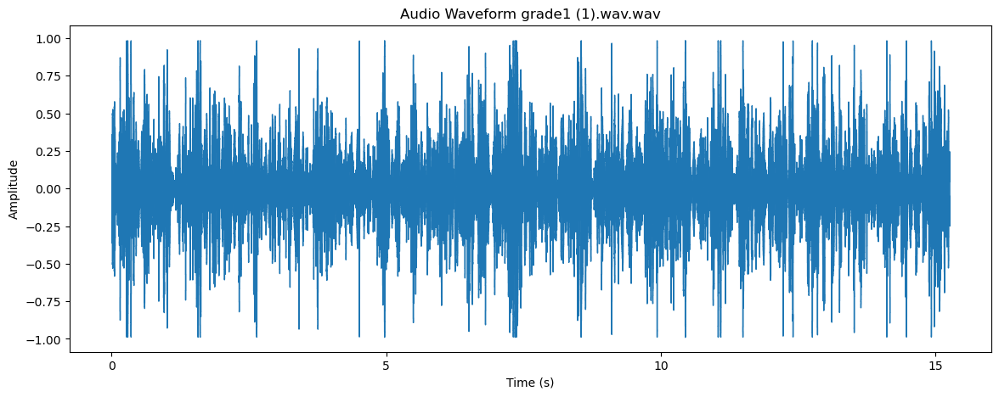

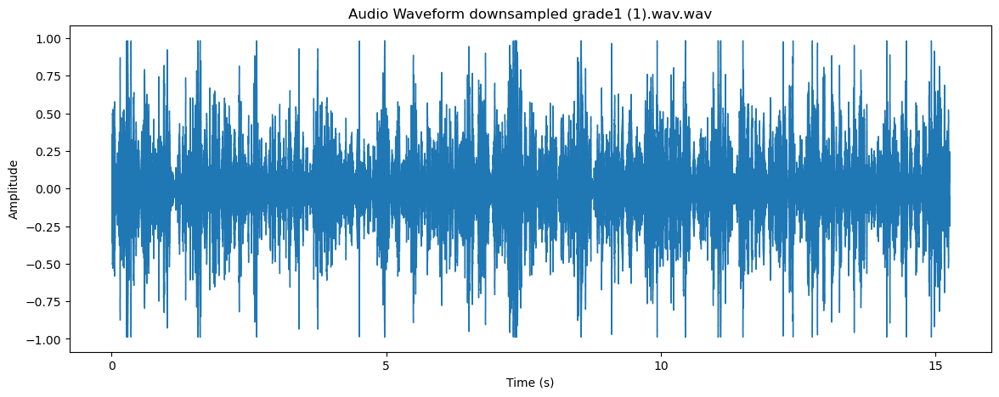

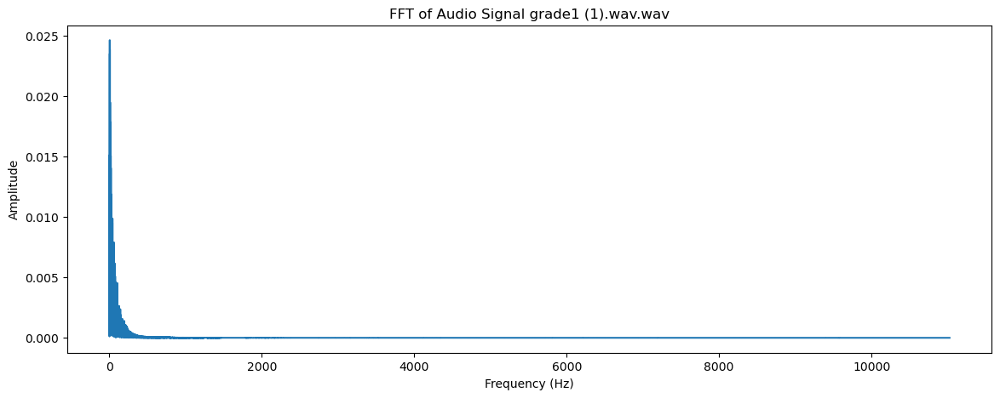

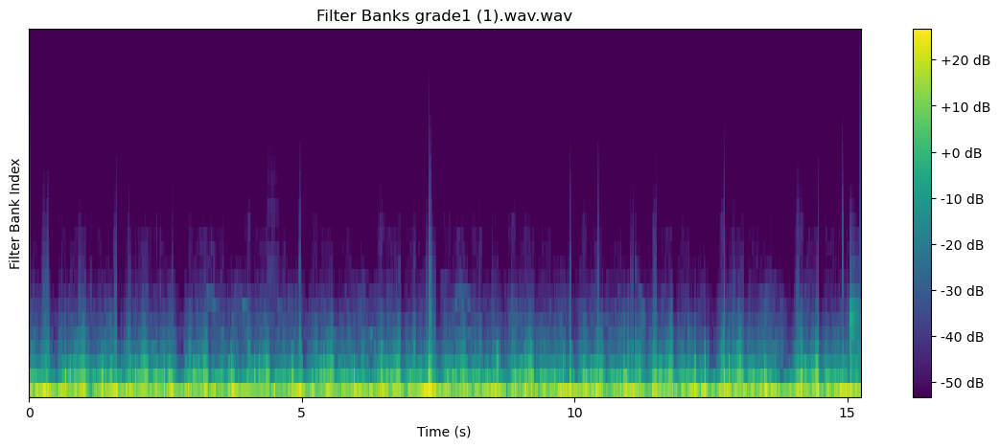

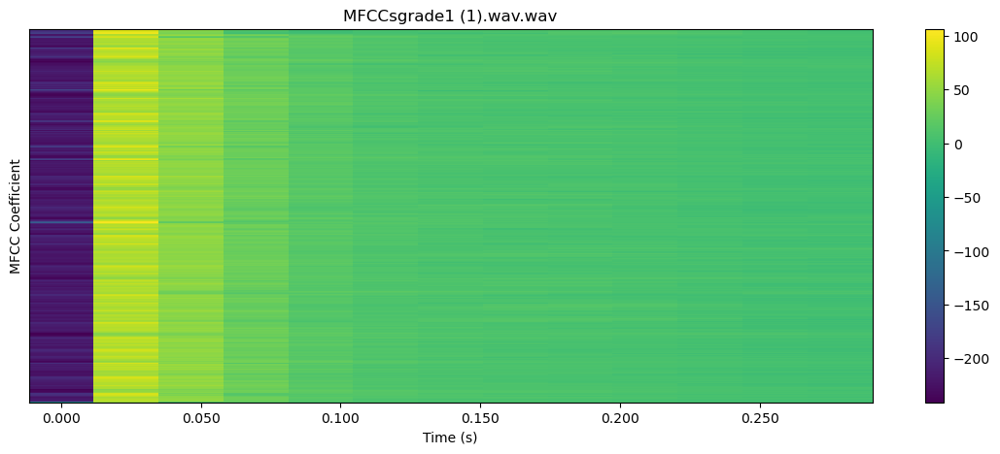

  1%|          | 1/141 [00:02<05:49,  2.50s/it]

22050


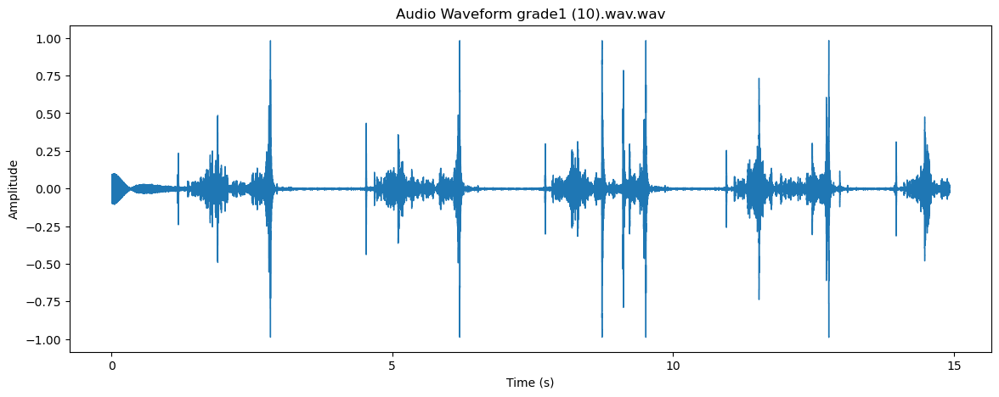

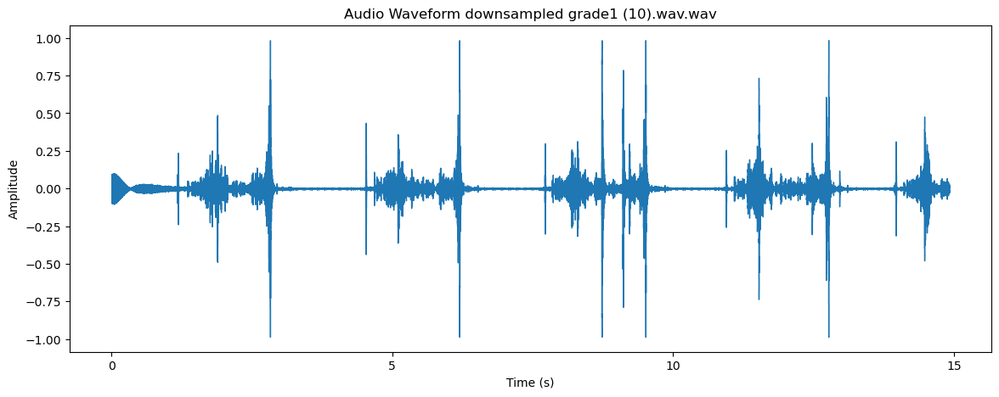

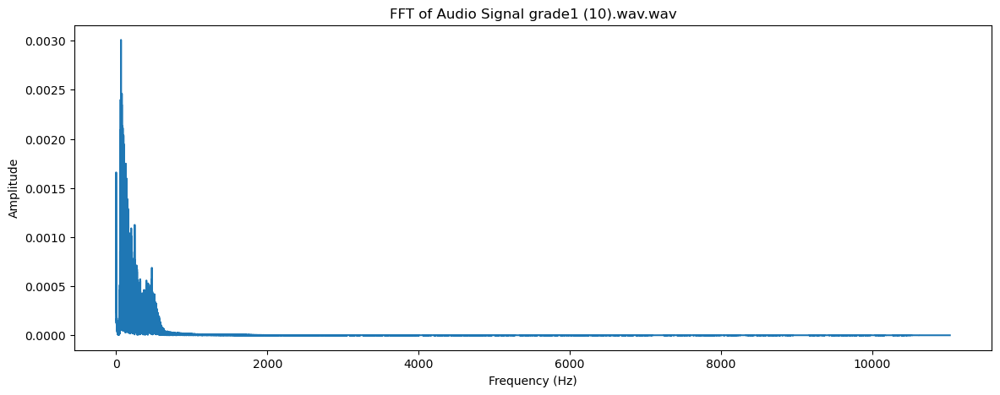

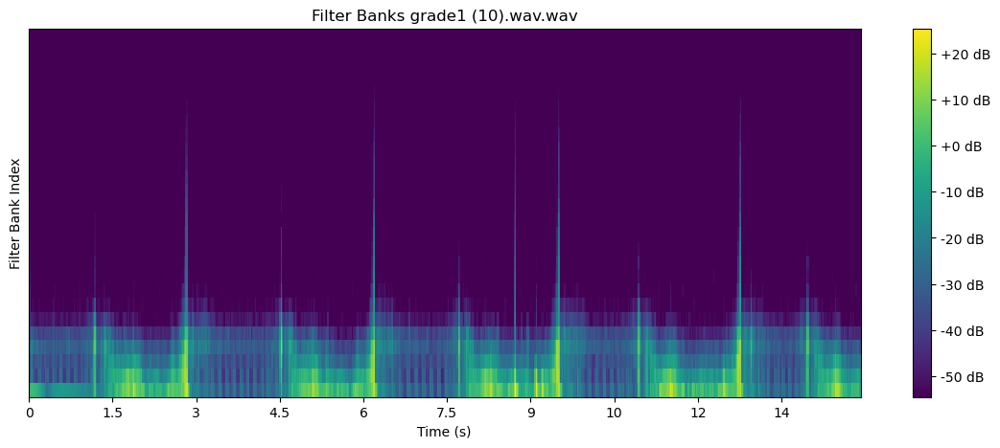

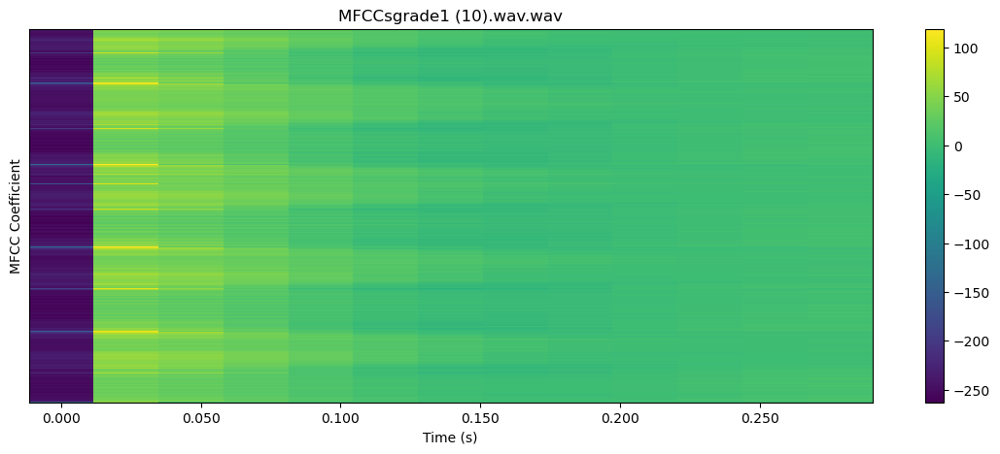

  1%|▏         | 2/141 [00:04<05:03,  2.18s/it]

22050


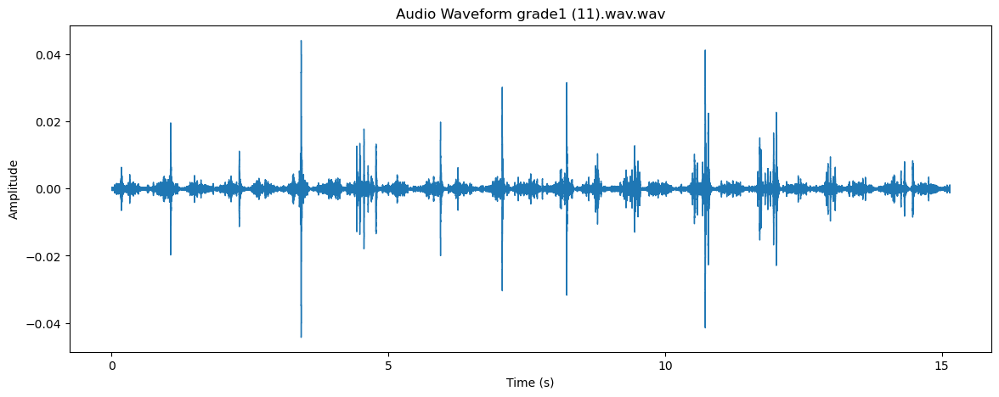

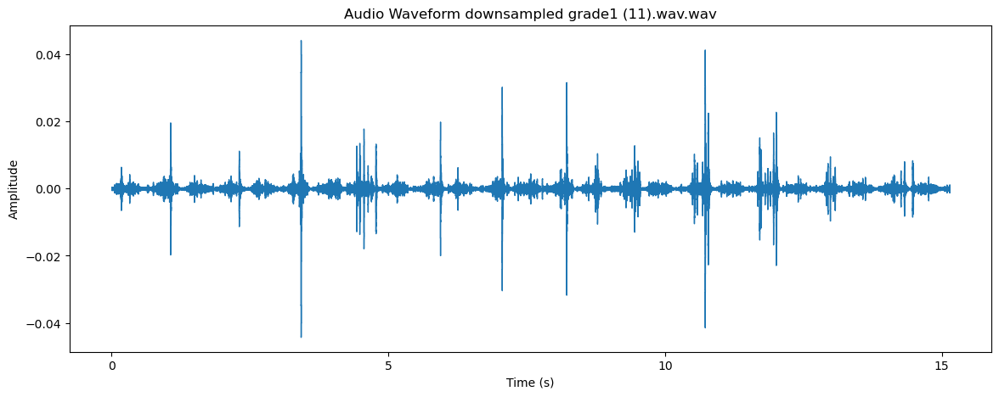

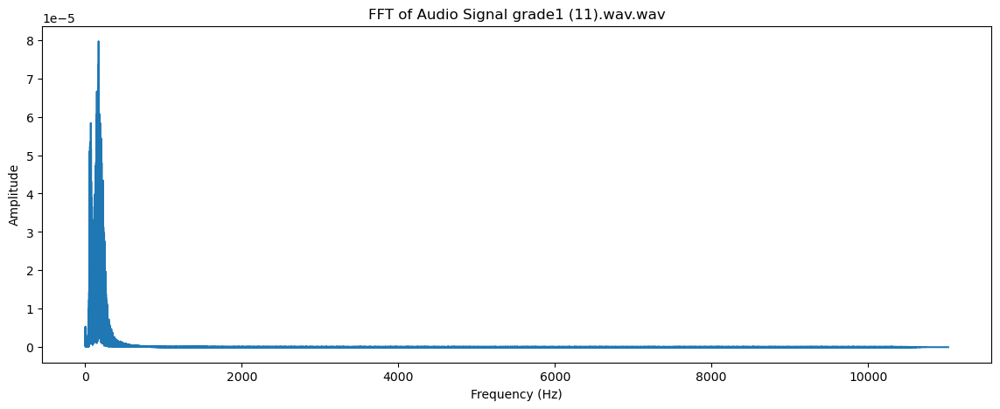

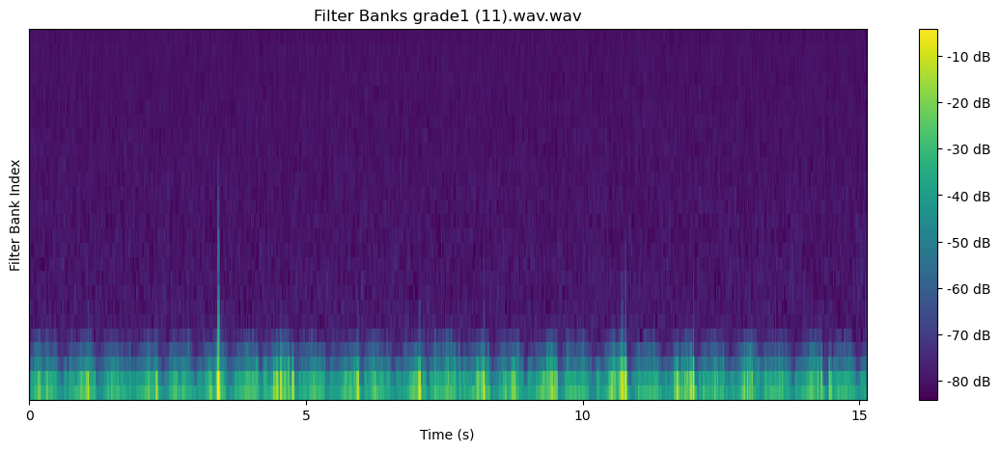

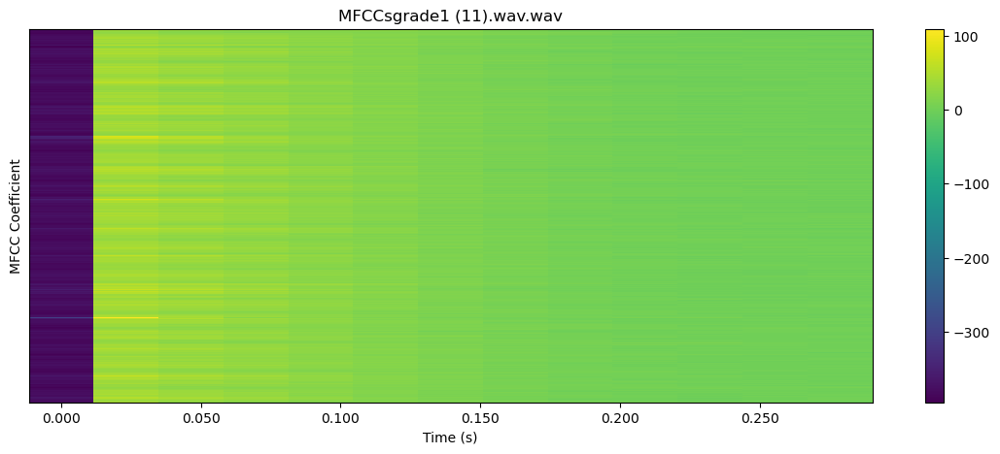

  2%|▏         | 3/141 [00:07<05:28,  2.38s/it]

22050


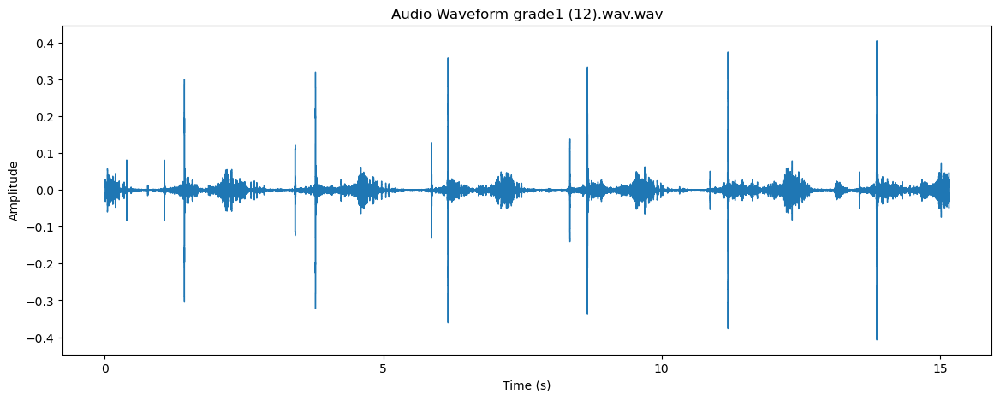

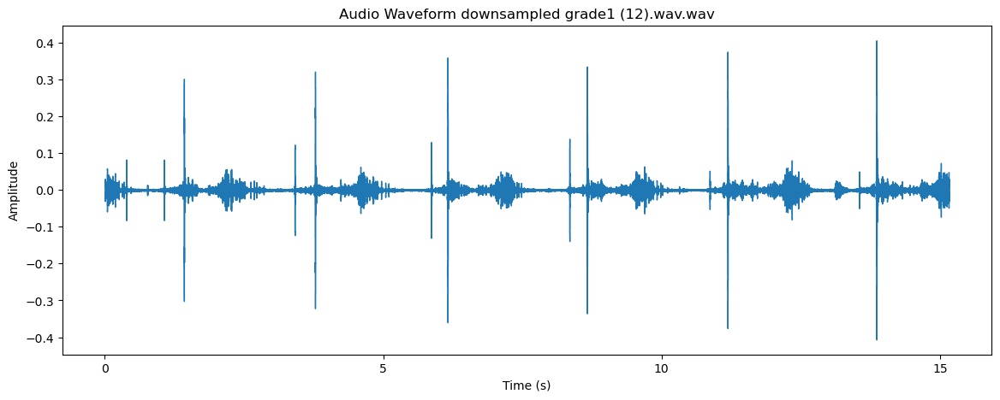

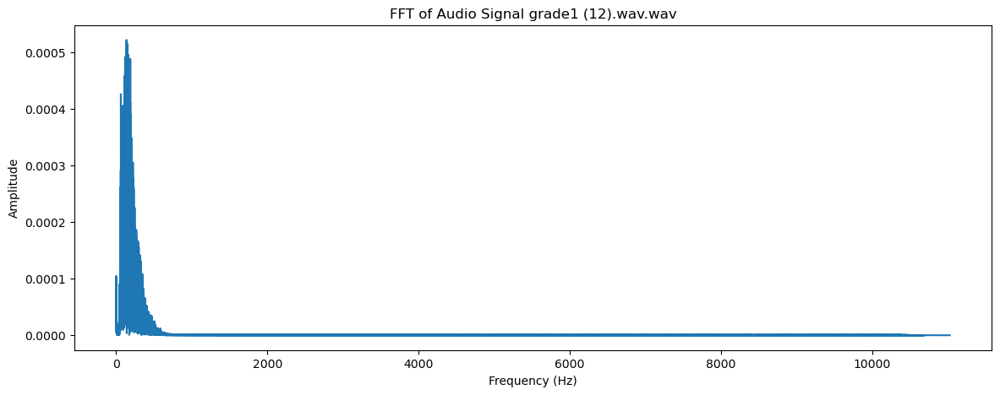

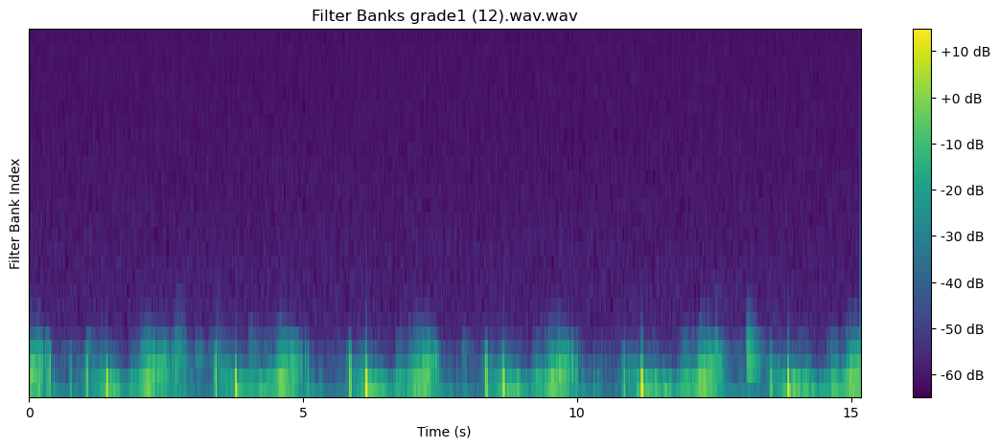

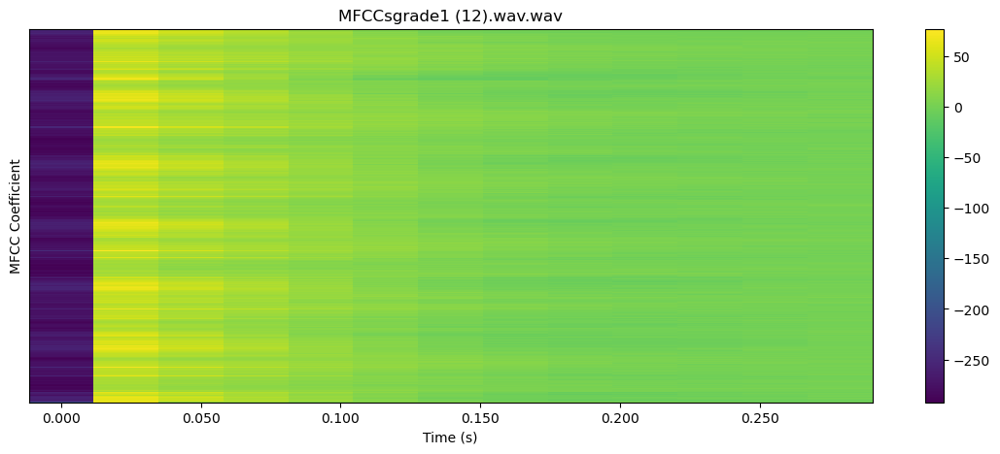

  3%|▎         | 4/141 [00:10<06:06,  2.67s/it]

22050


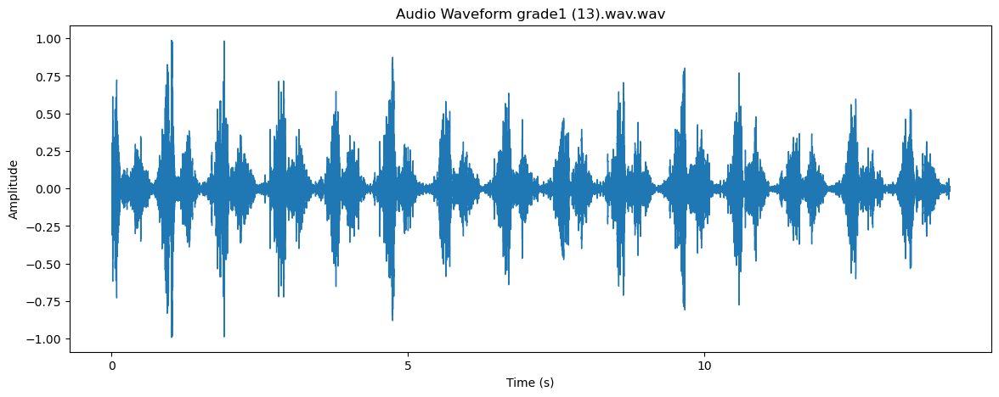

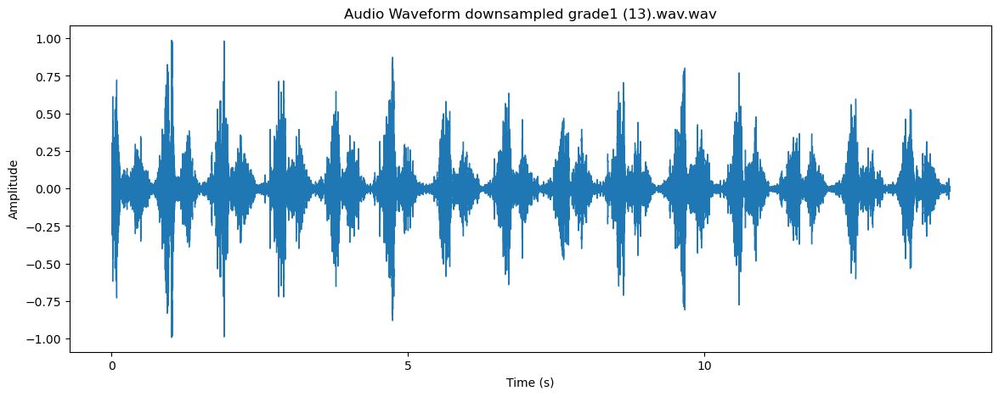

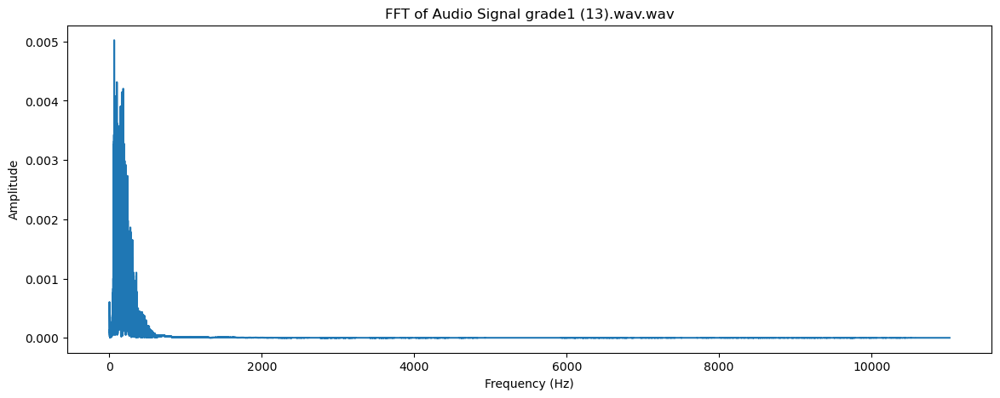

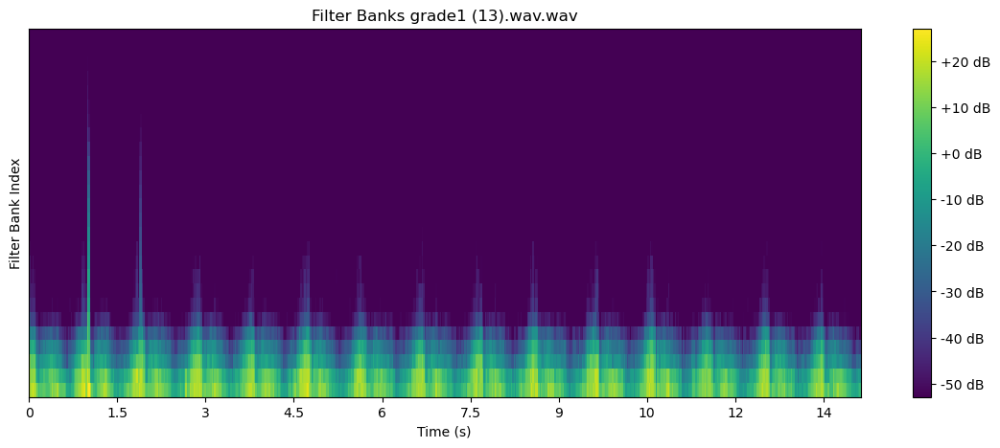

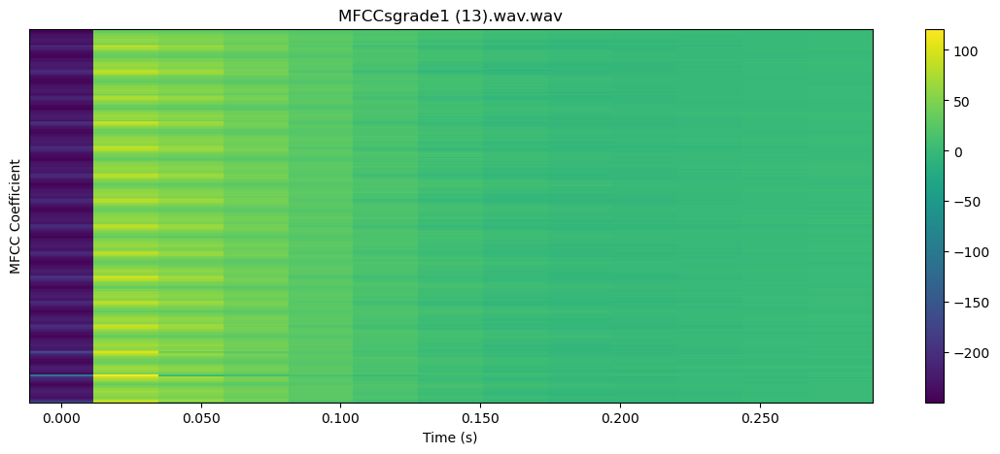

  4%|▎         | 5/141 [00:12<06:00,  2.65s/it]

22050


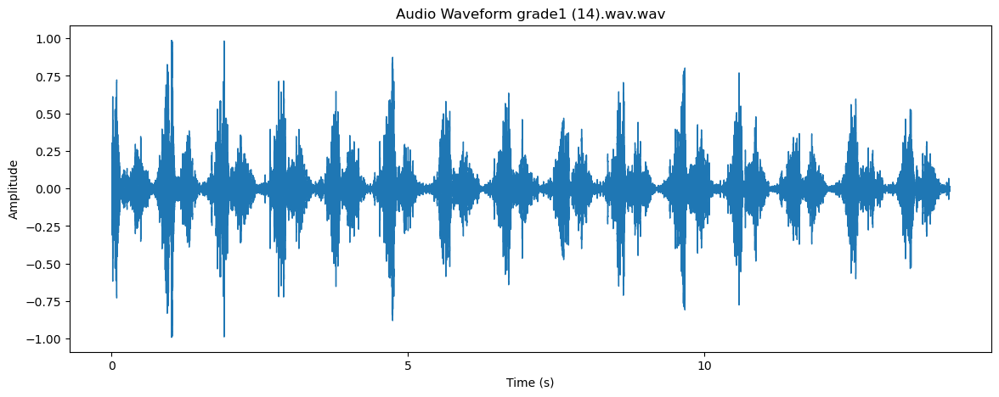

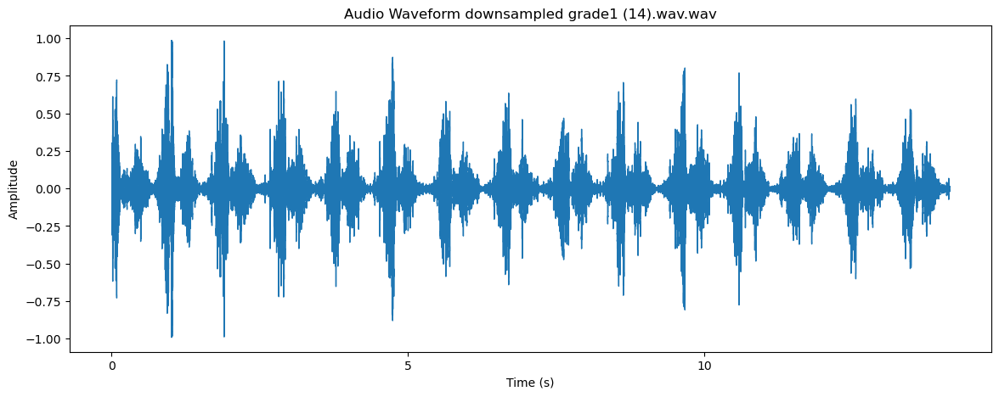

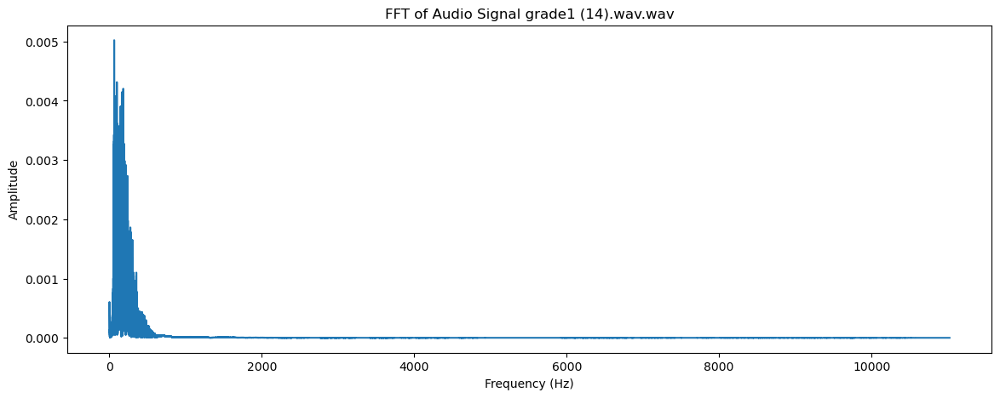

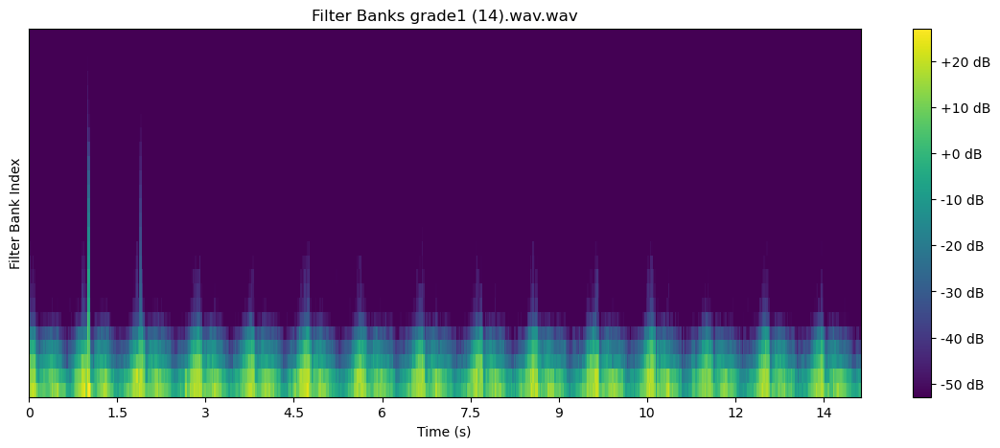

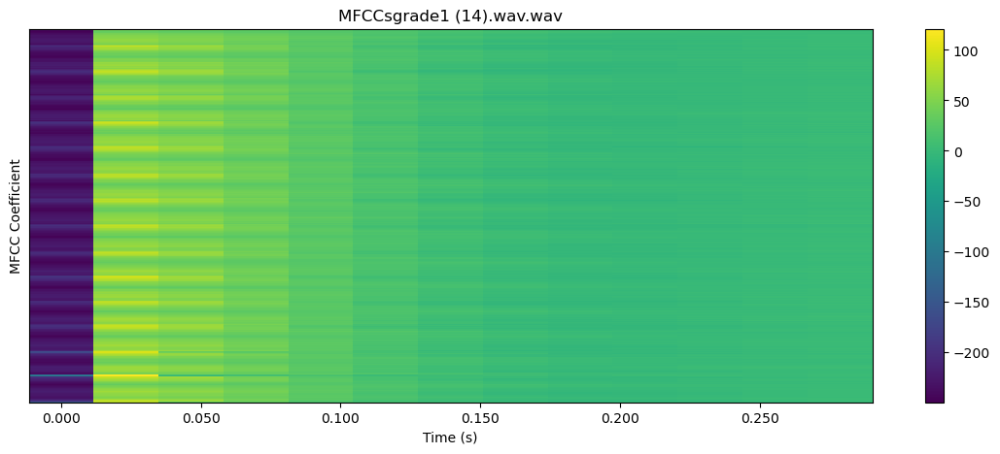

  4%|▍         | 6/141 [00:16<06:43,  2.99s/it]

22050


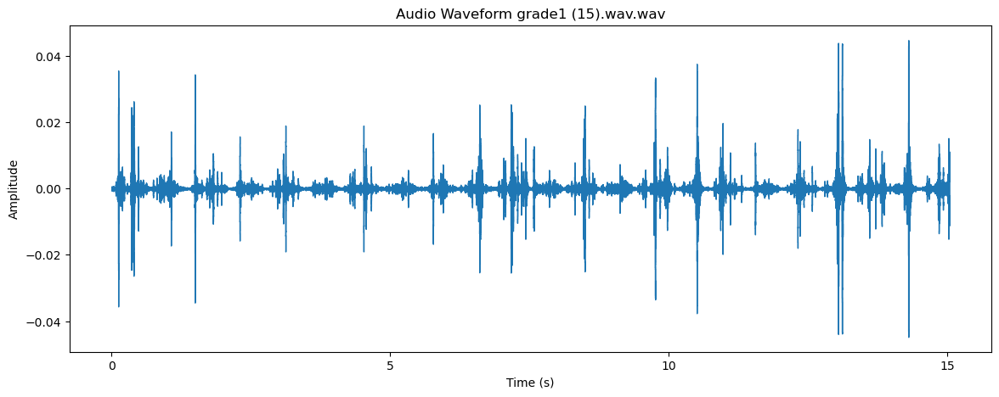

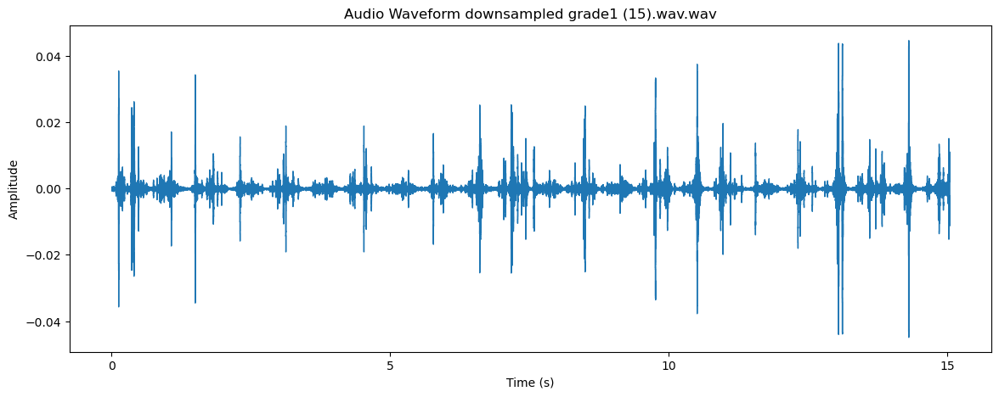

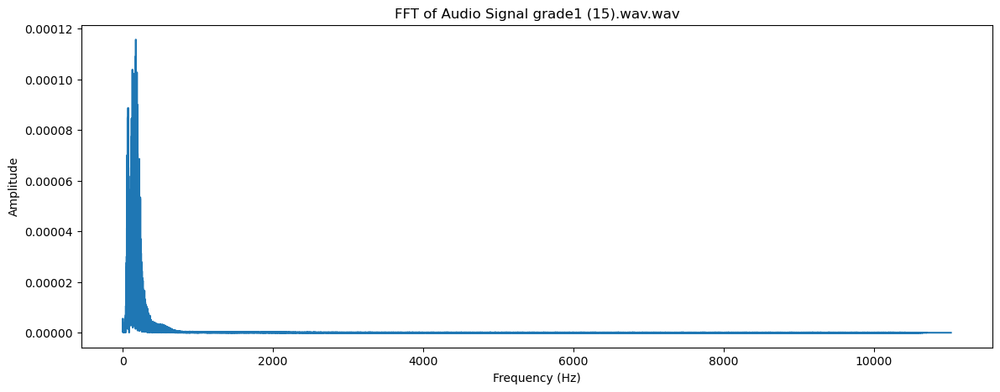

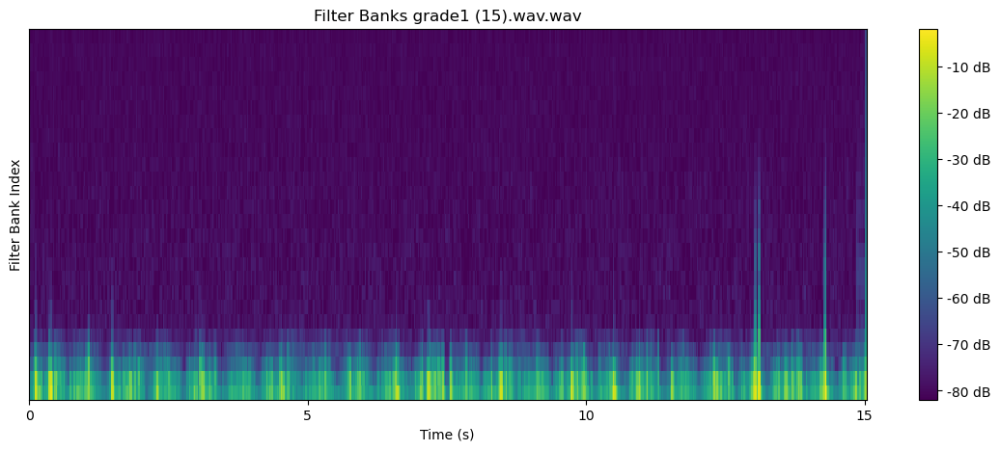

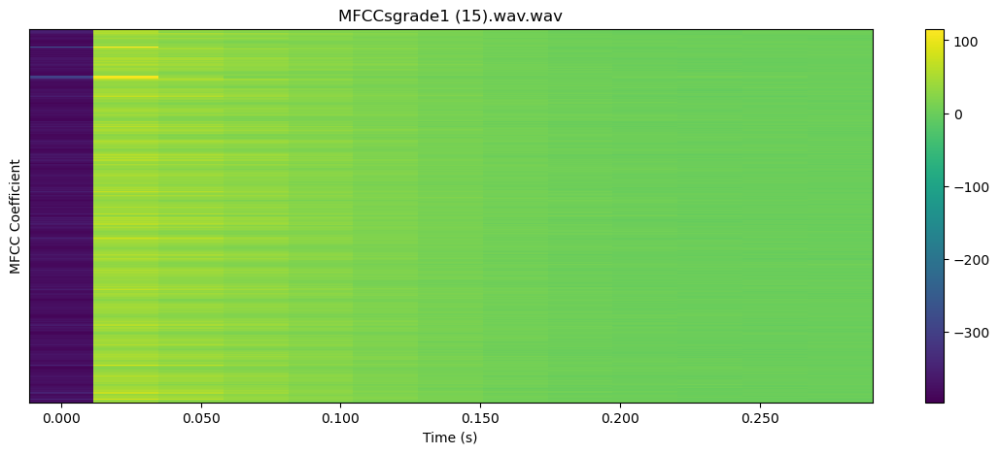

  5%|▍         | 7/141 [00:19<06:39,  2.98s/it]

22050


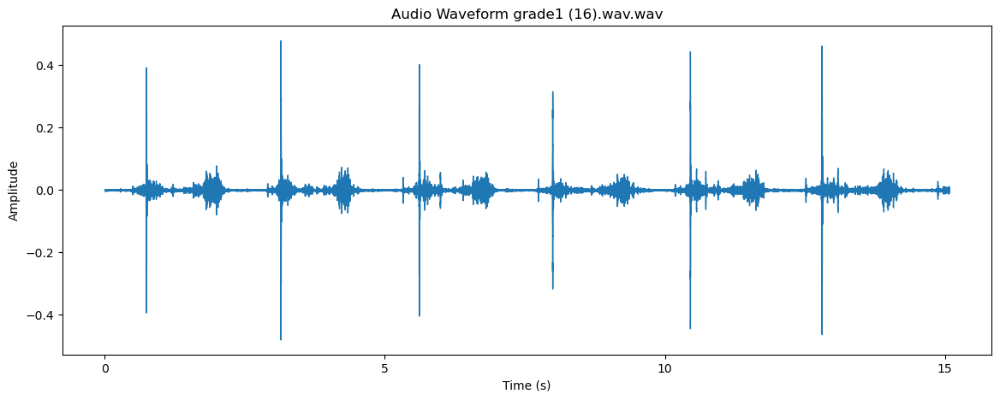

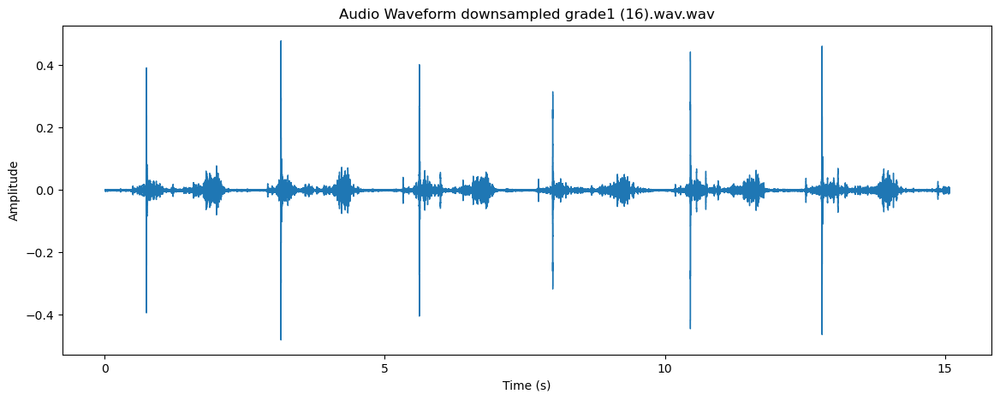

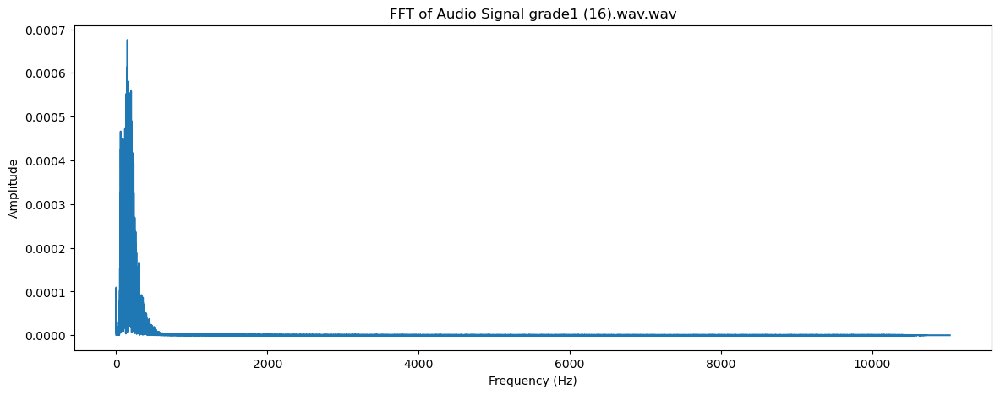

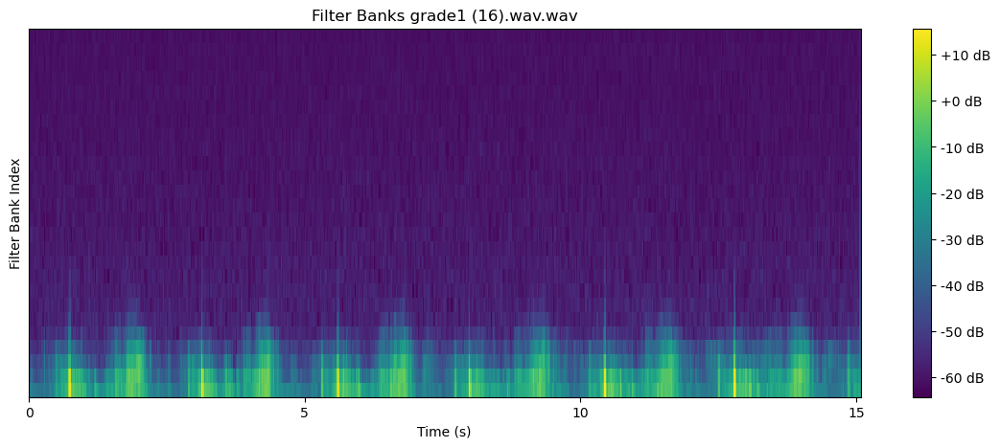

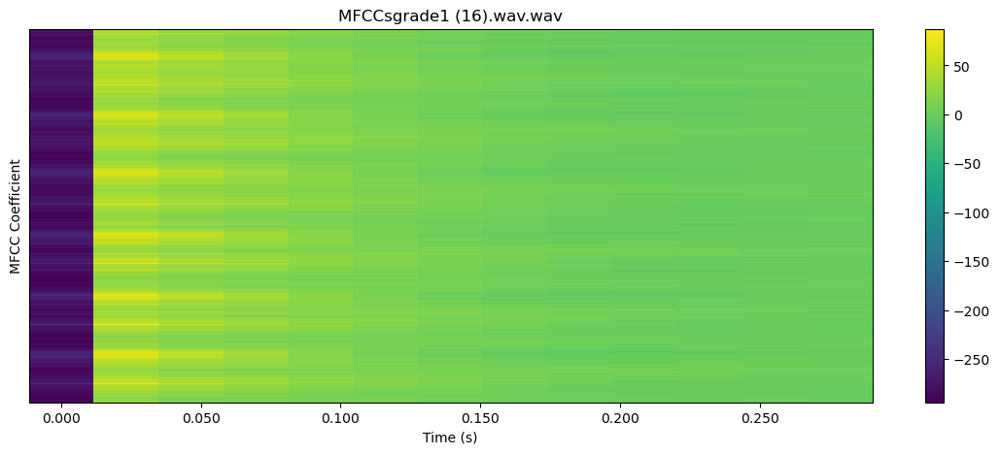

  6%|▌         | 8/141 [00:22<06:24,  2.89s/it]

22050


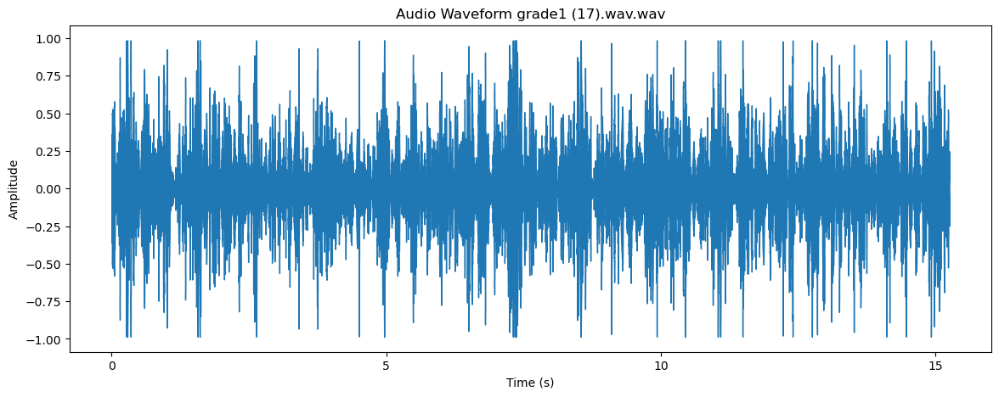

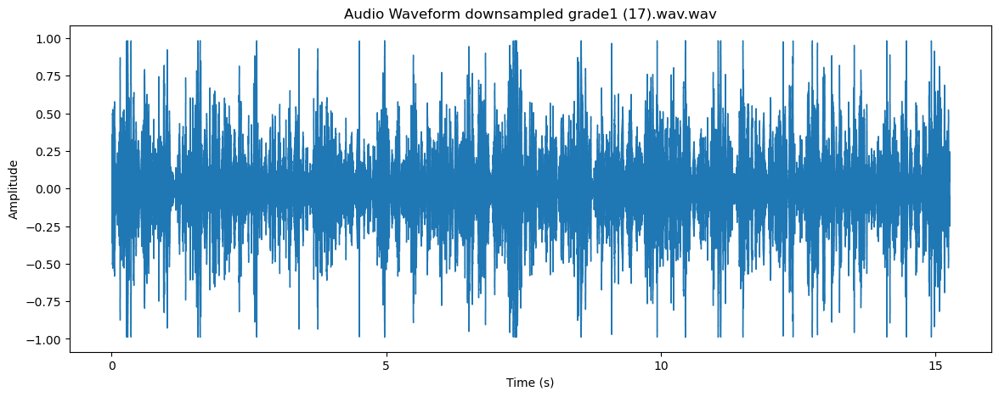

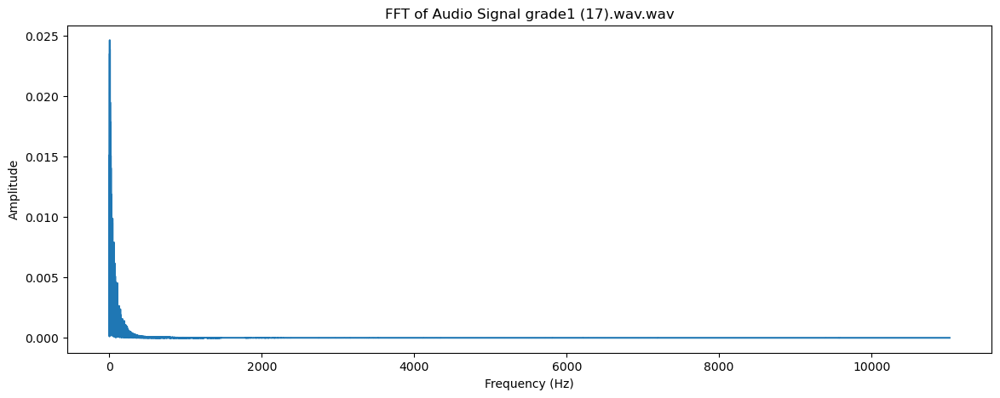

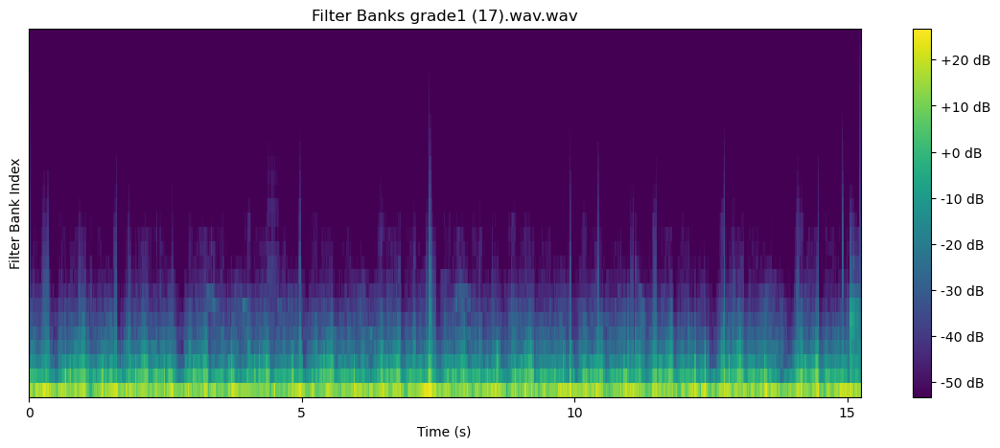

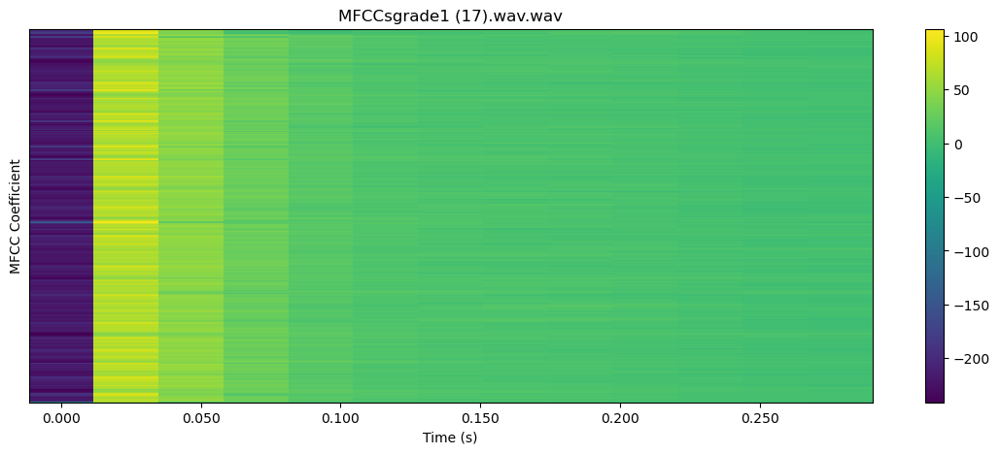

  6%|▋         | 9/141 [00:26<07:09,  3.26s/it]

22050


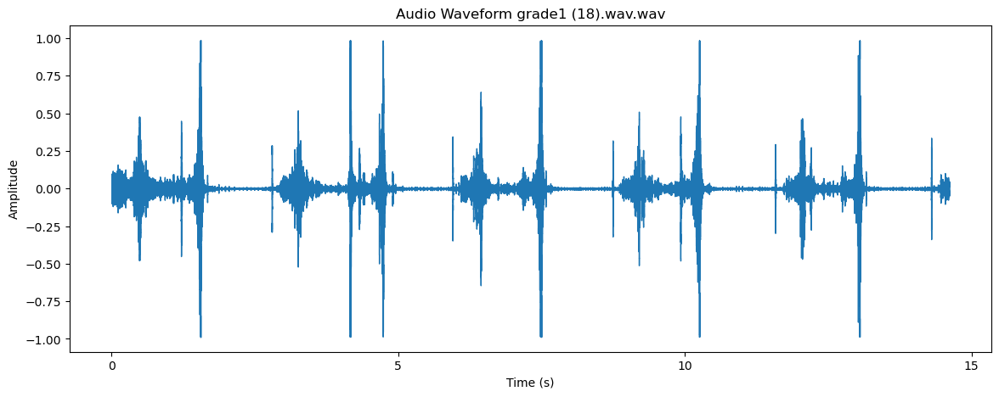

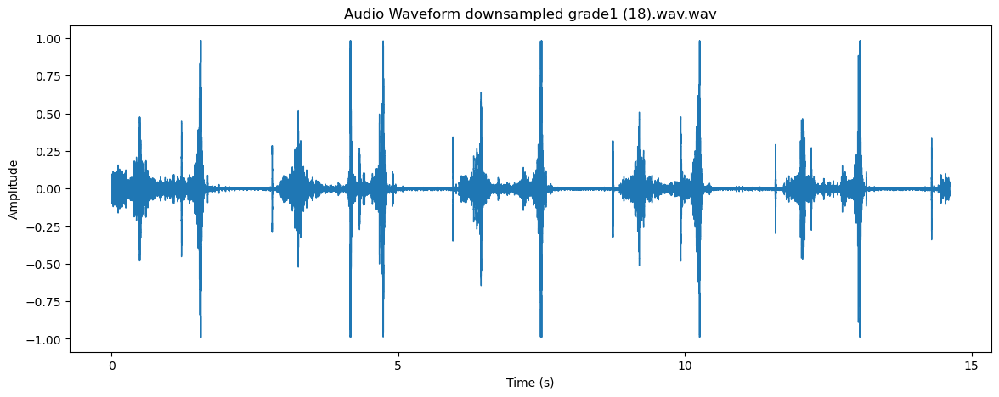

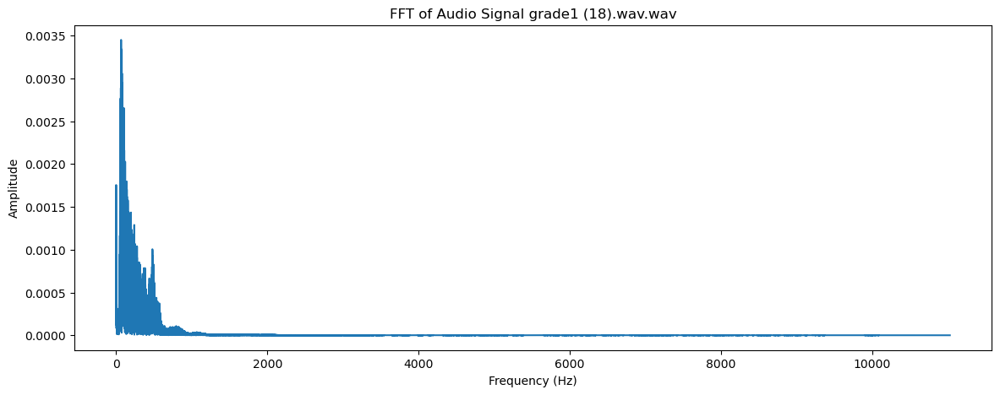

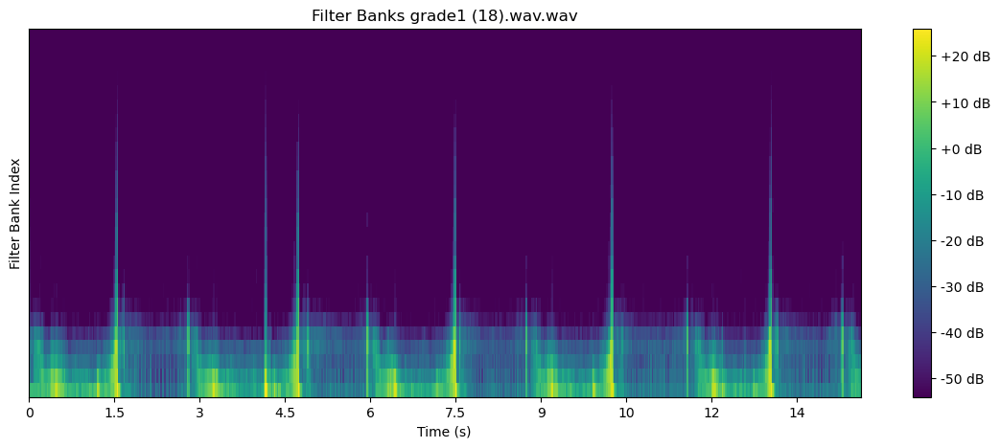

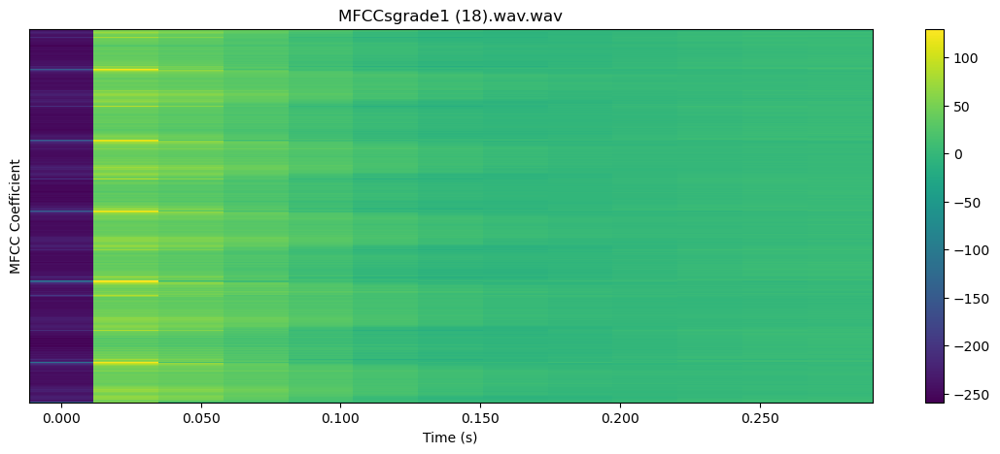

  7%|▋         | 10/141 [00:28<06:35,  3.02s/it]

22050


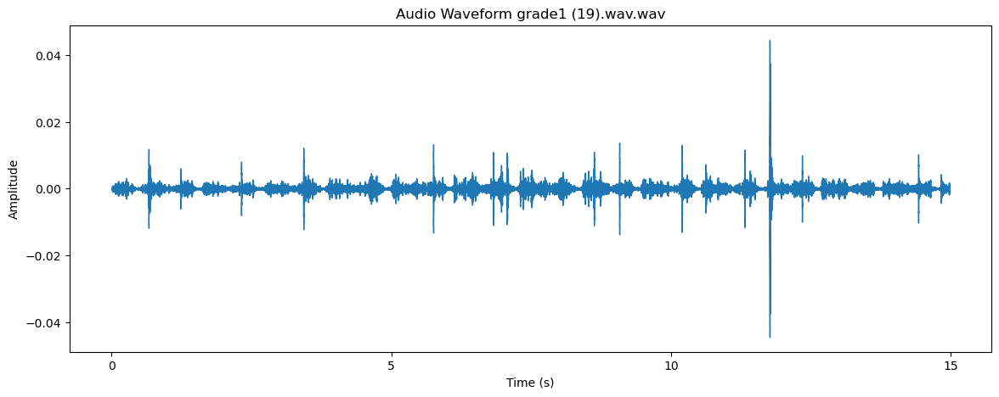

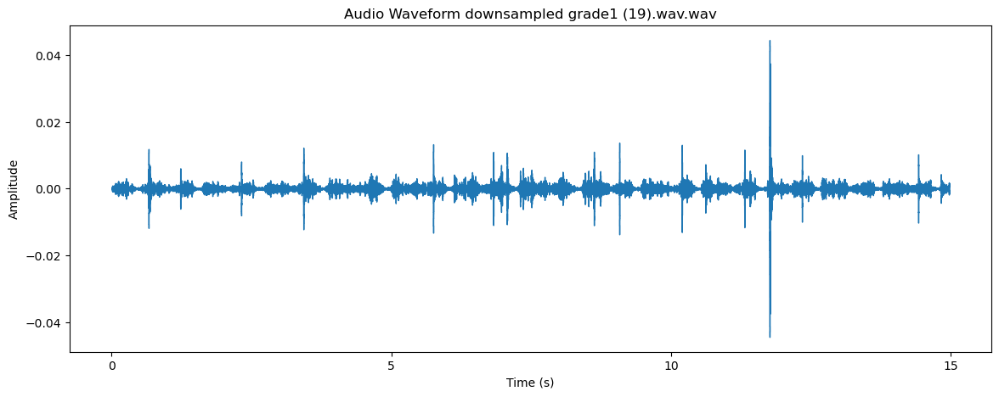

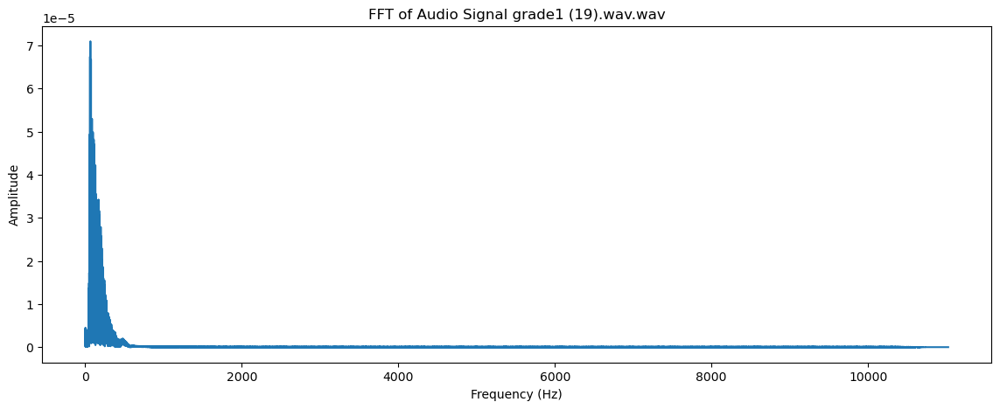

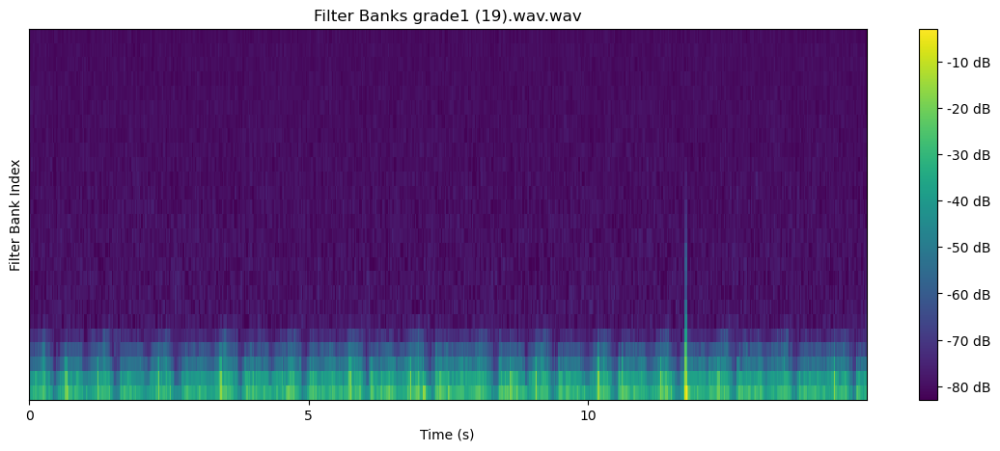

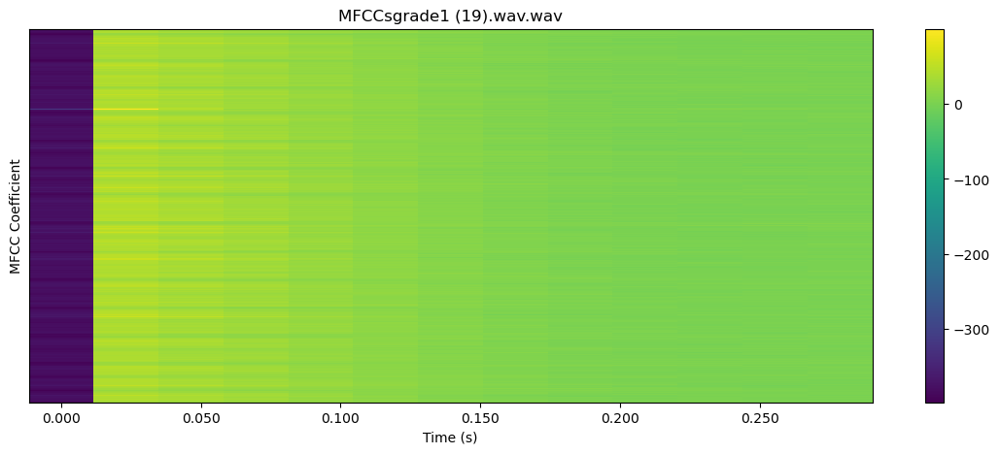

  8%|▊         | 11/141 [00:29<05:25,  2.50s/it]

22050


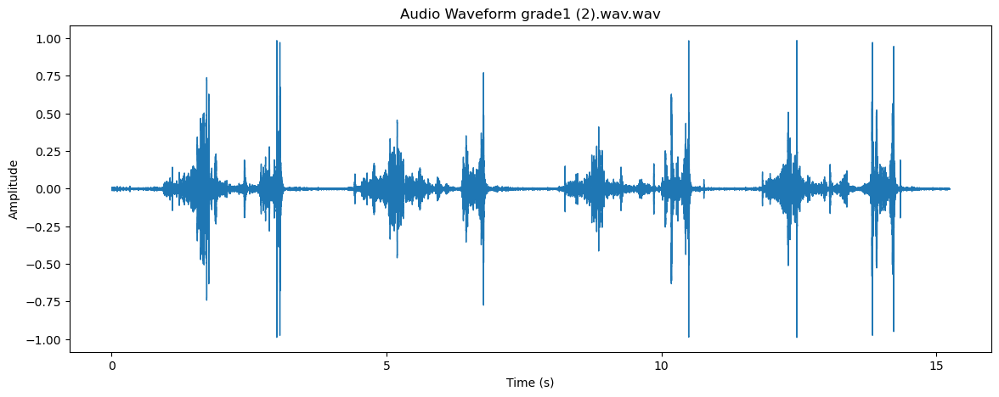

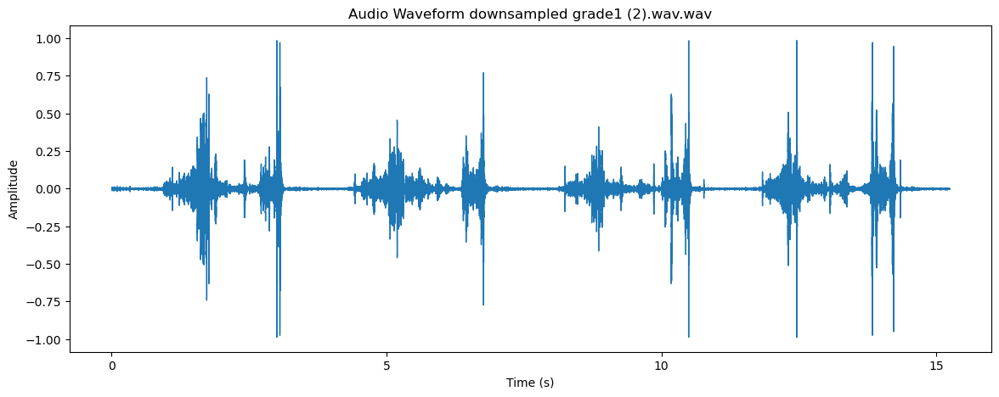

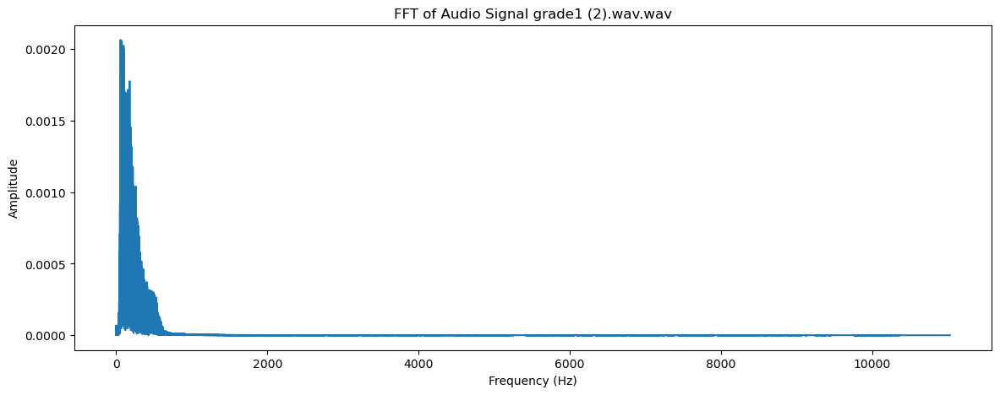

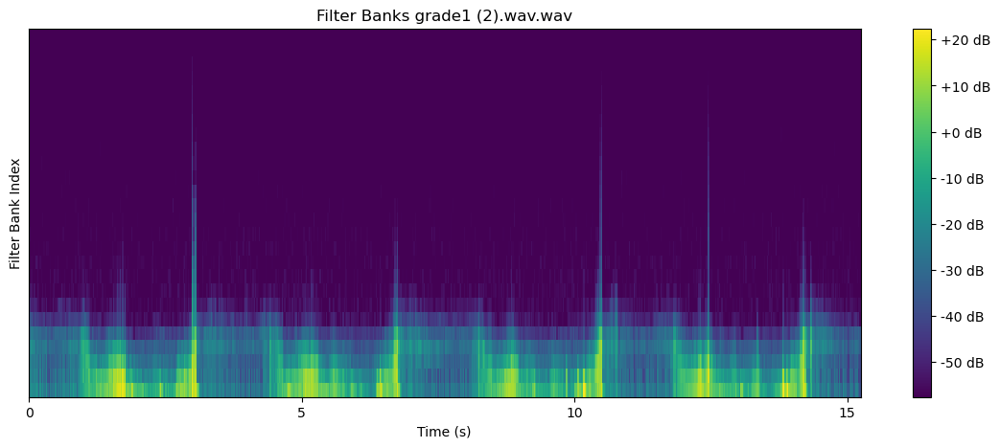

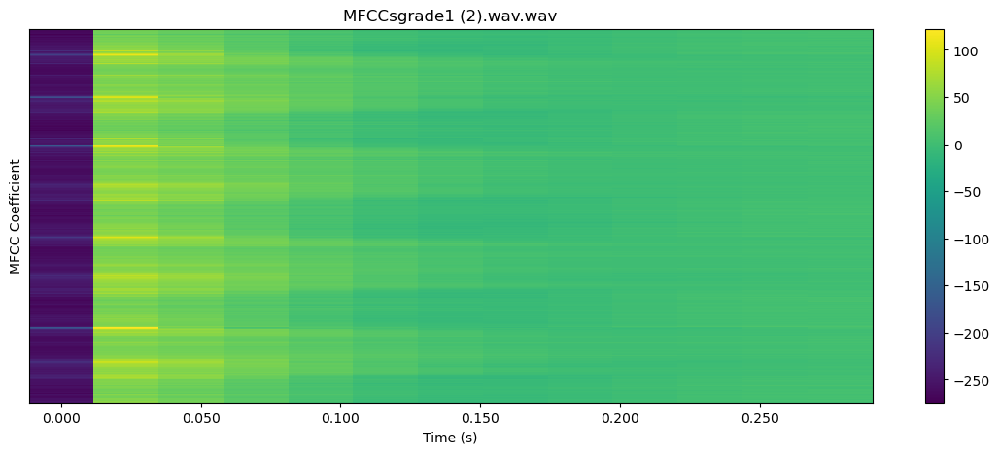

  9%|▊         | 12/141 [00:31<04:40,  2.17s/it]

22050


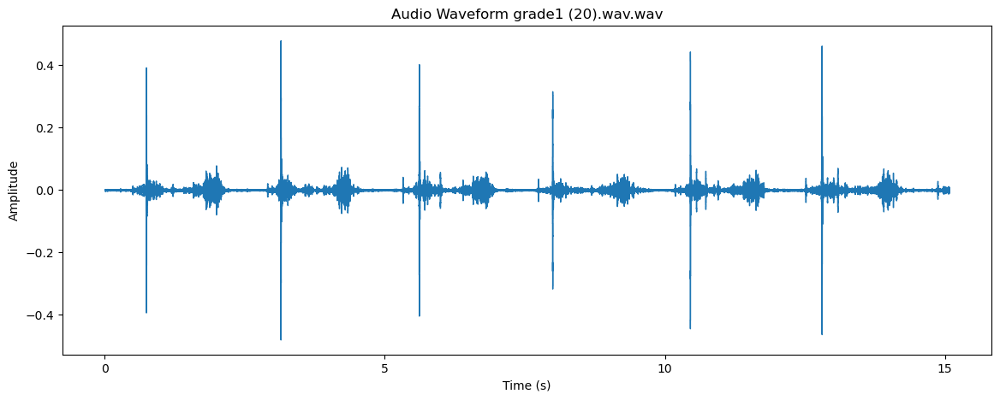

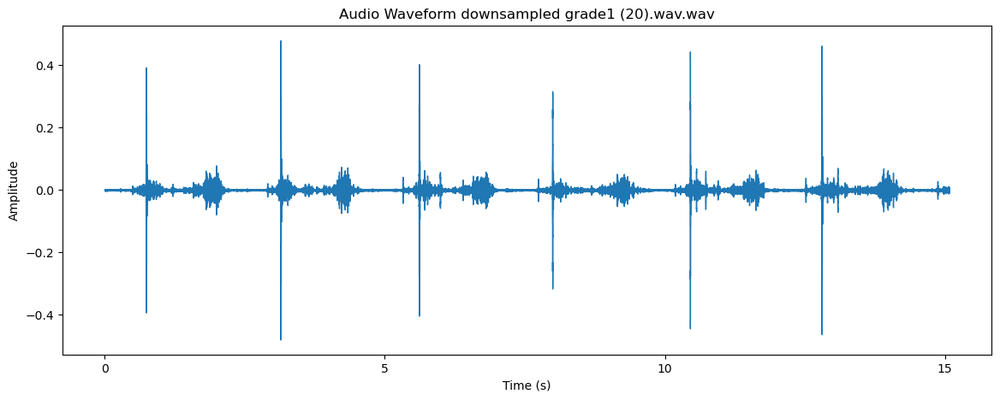

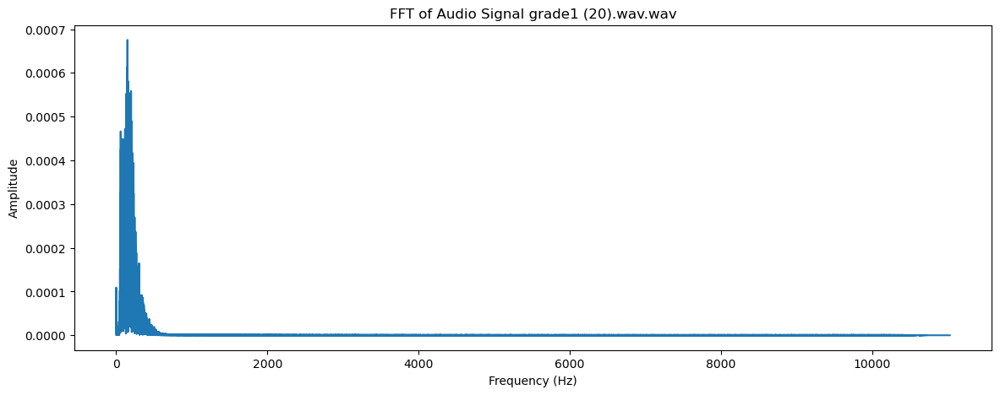

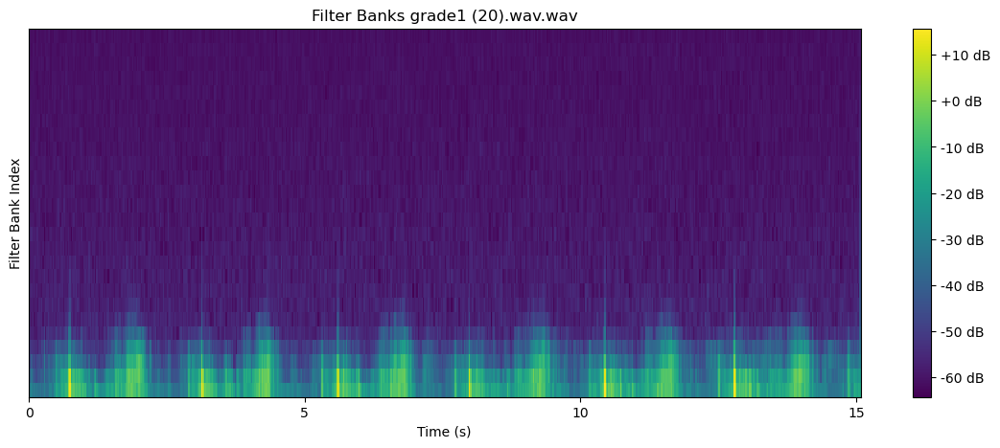

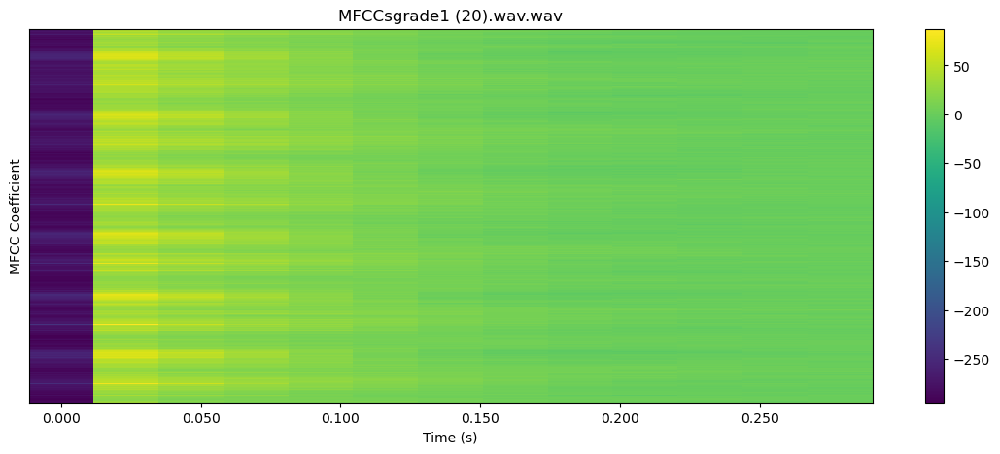

  9%|▉         | 13/141 [00:32<04:08,  1.94s/it]

22050


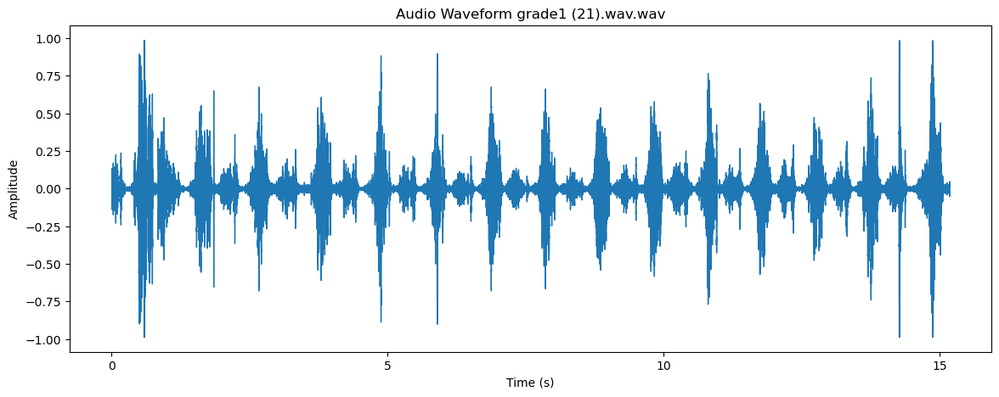

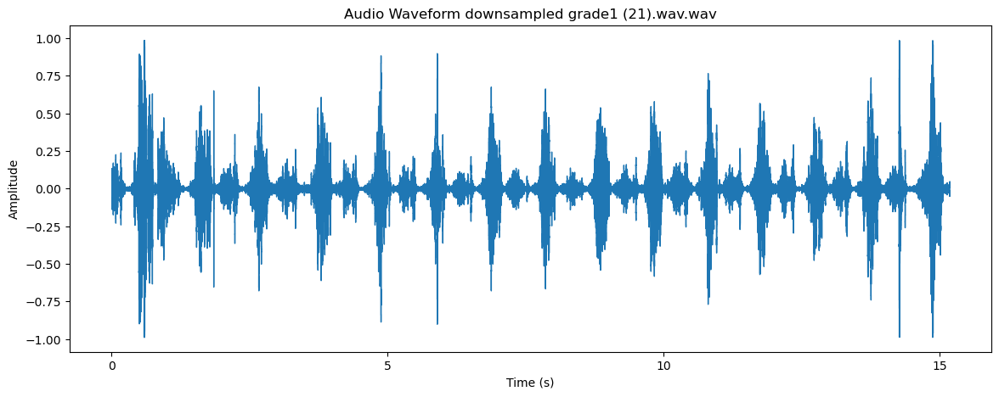

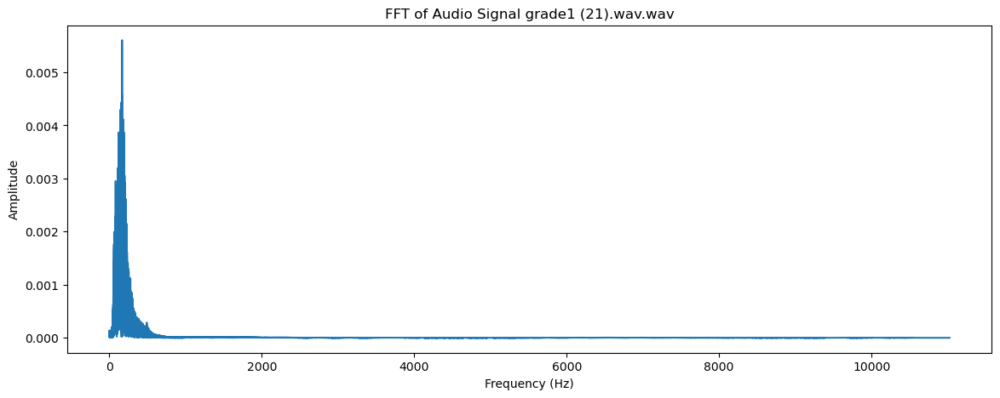

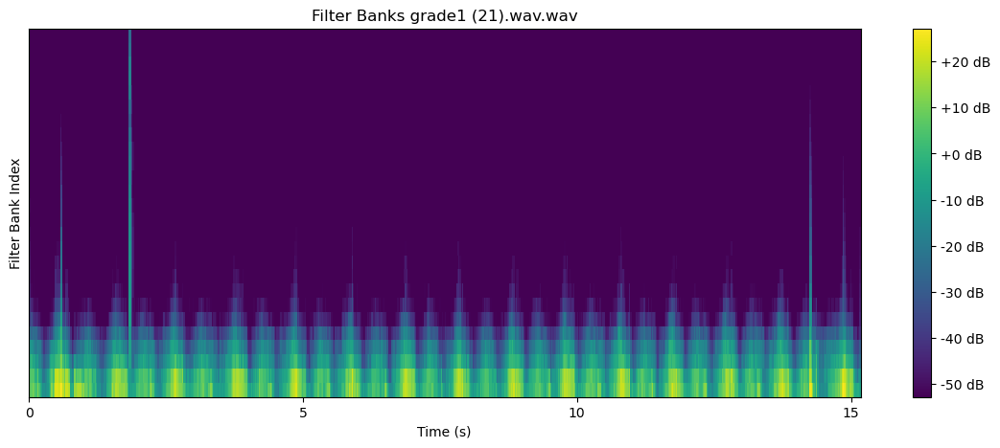

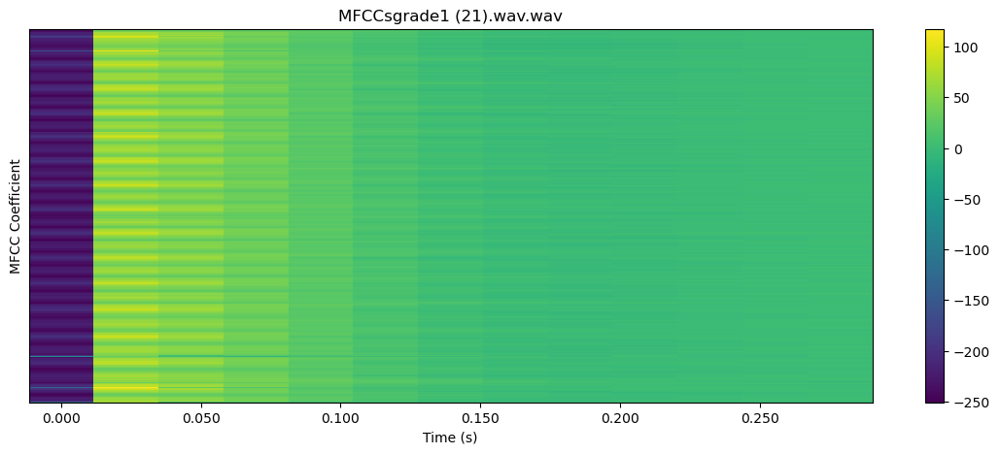

 10%|▉         | 14/141 [00:34<03:54,  1.85s/it]

22050


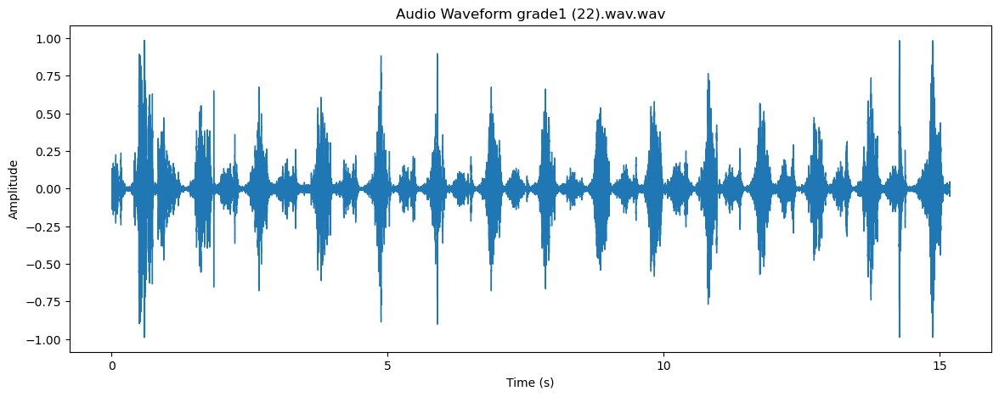

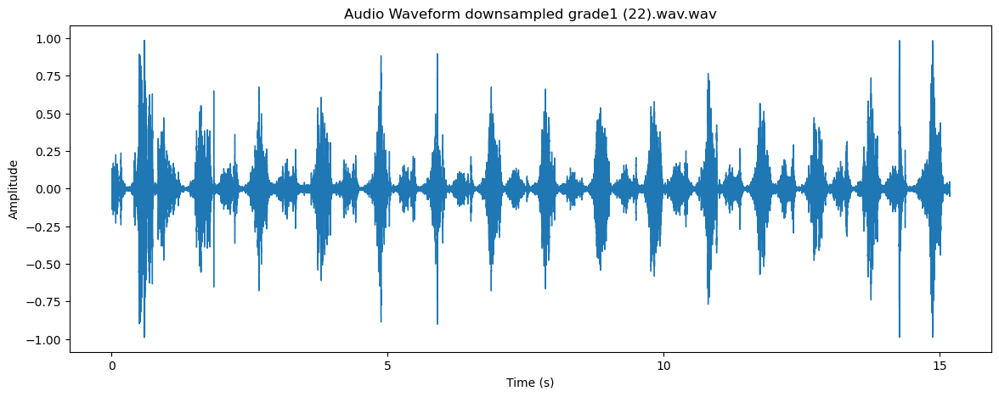

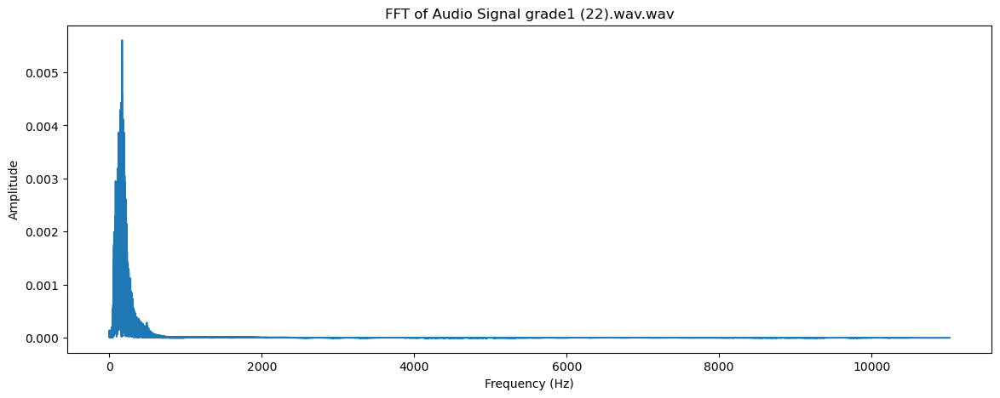

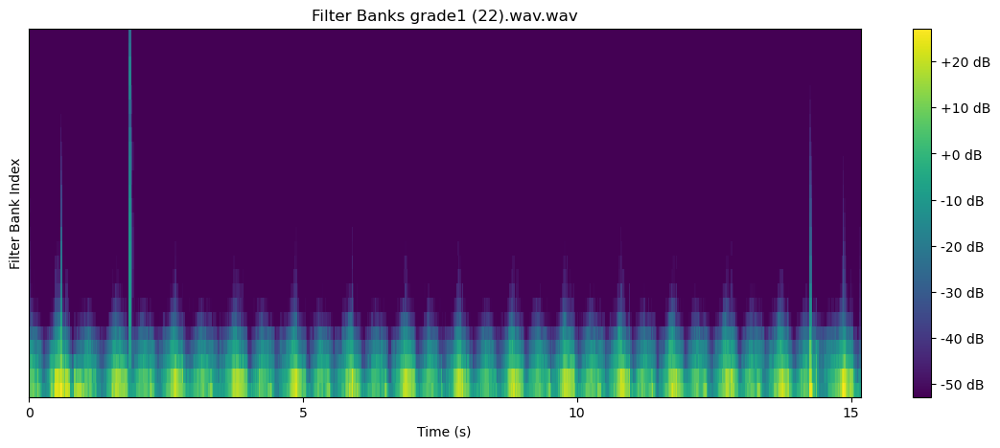

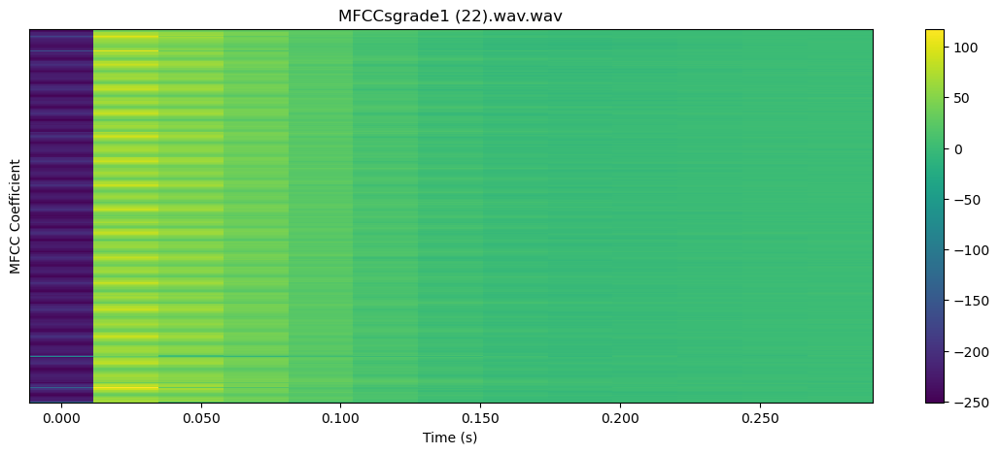

 11%|█         | 15/141 [00:36<03:46,  1.80s/it]

22050


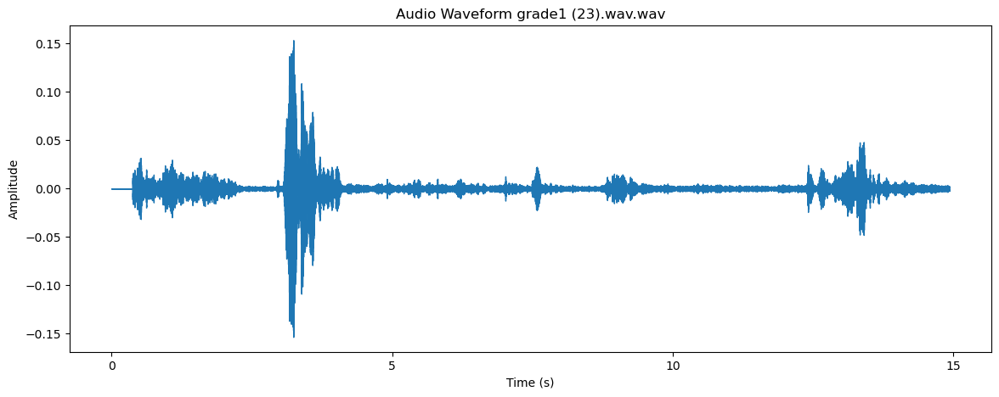

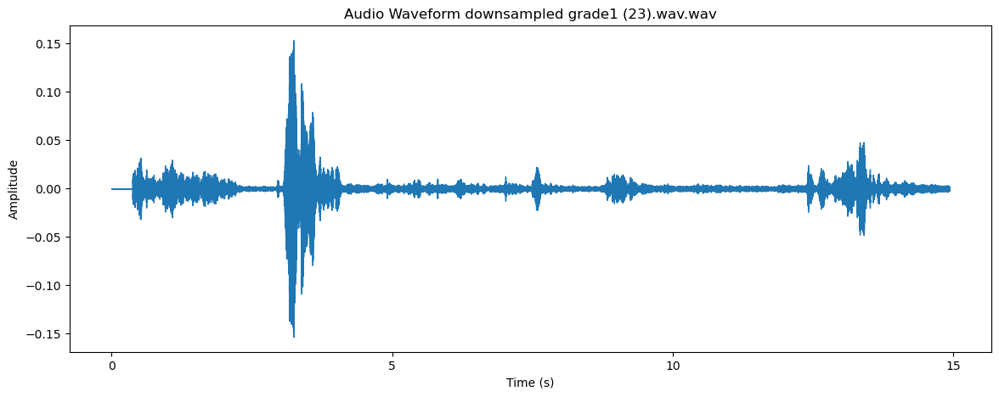

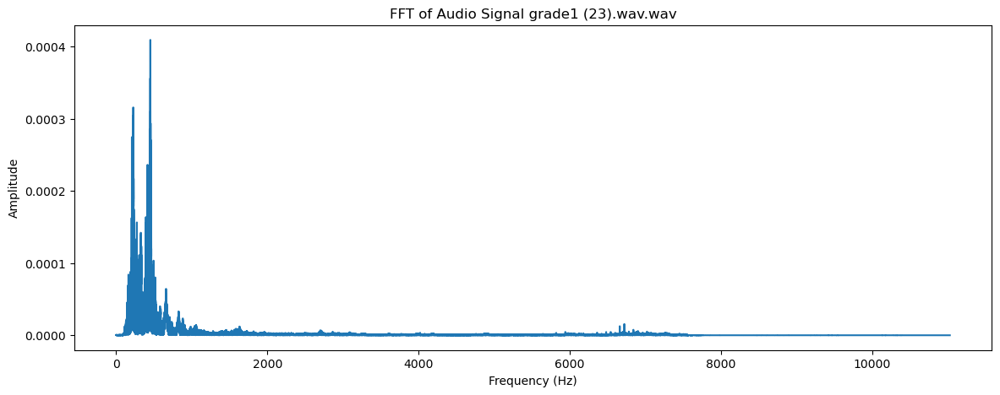

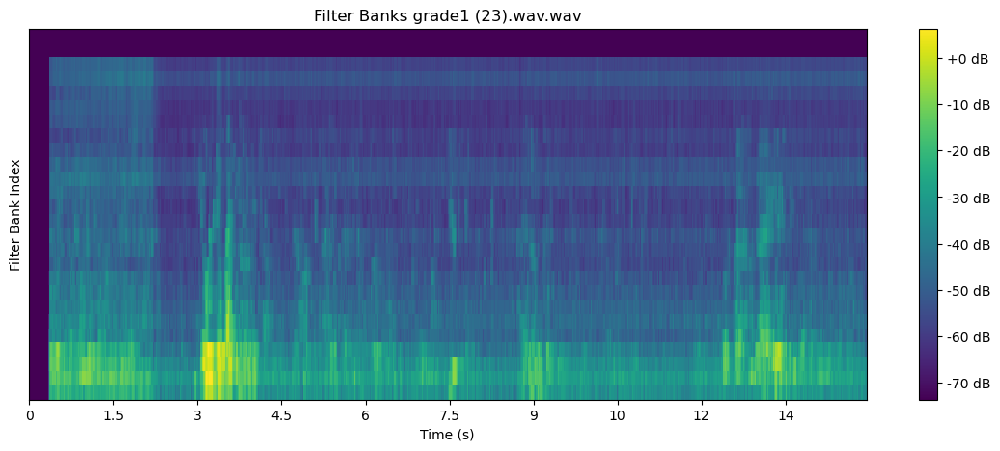

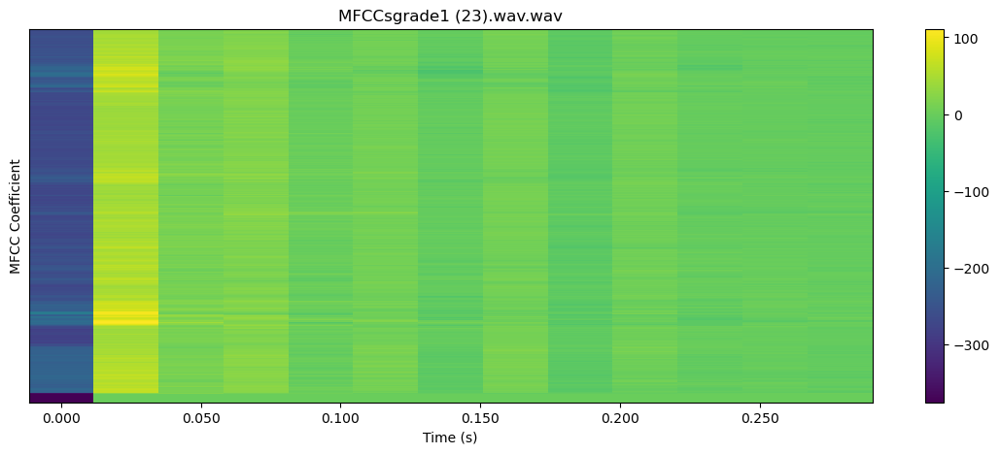

 11%|█▏        | 16/141 [00:37<03:35,  1.72s/it]

22050


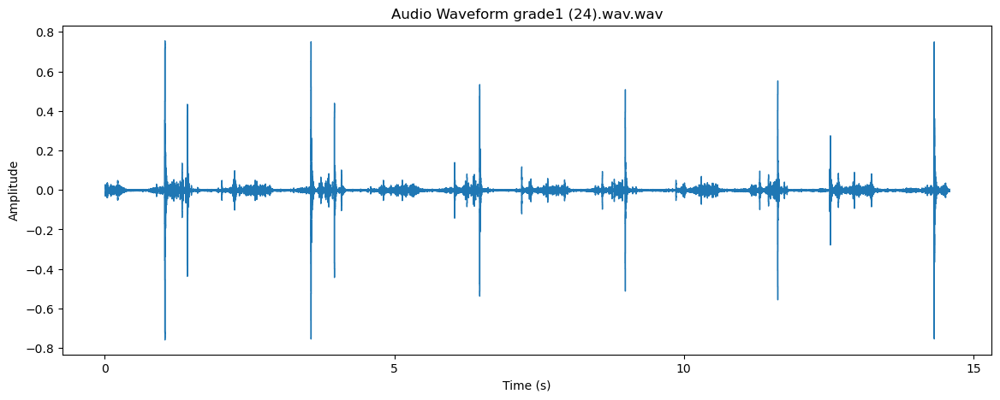

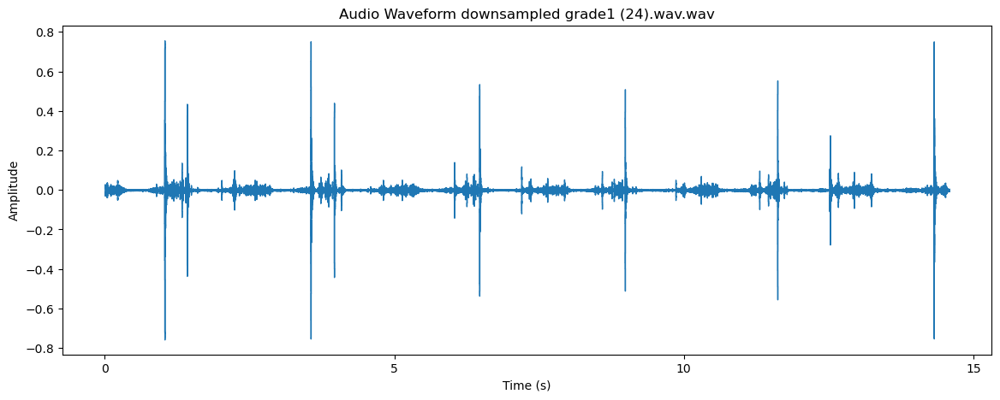

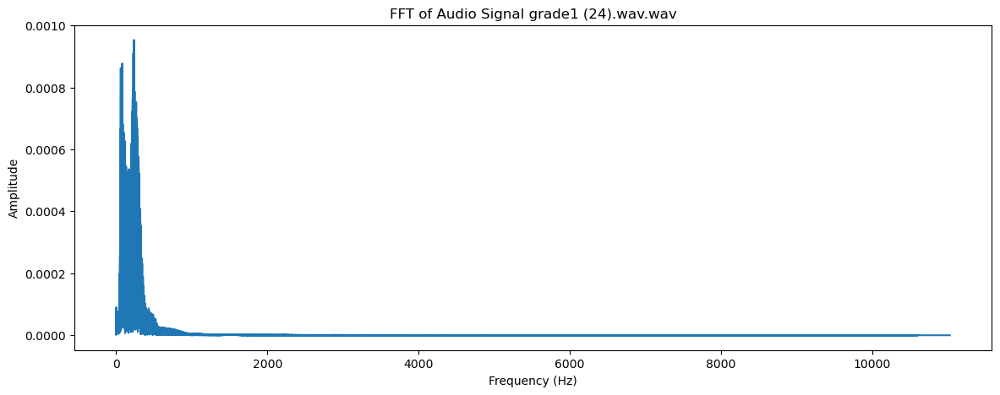

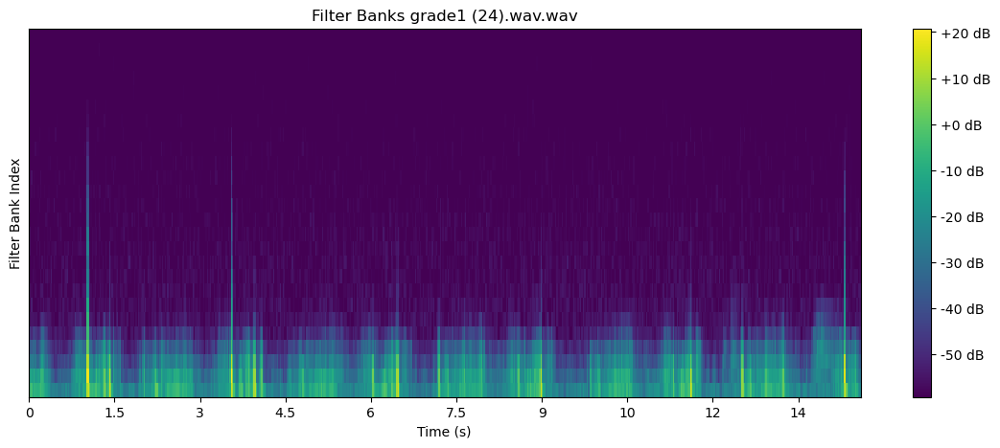

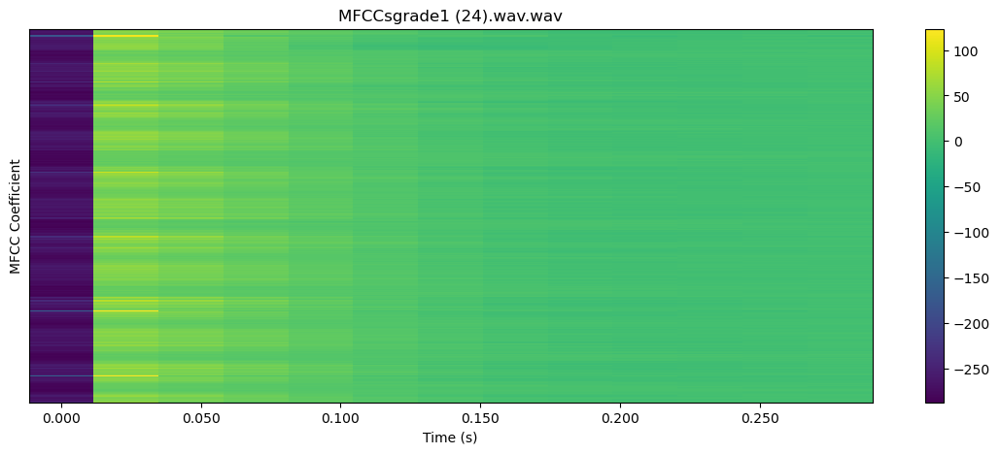

 12%|█▏        | 17/141 [00:40<04:07,  2.00s/it]

22050


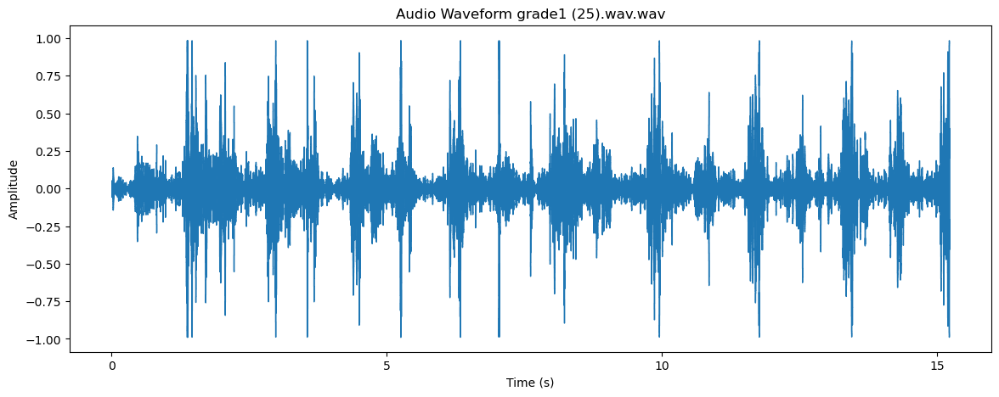

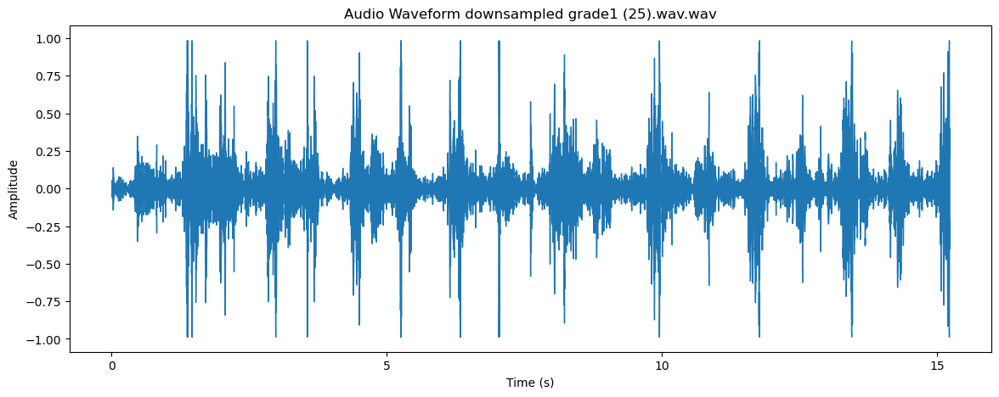

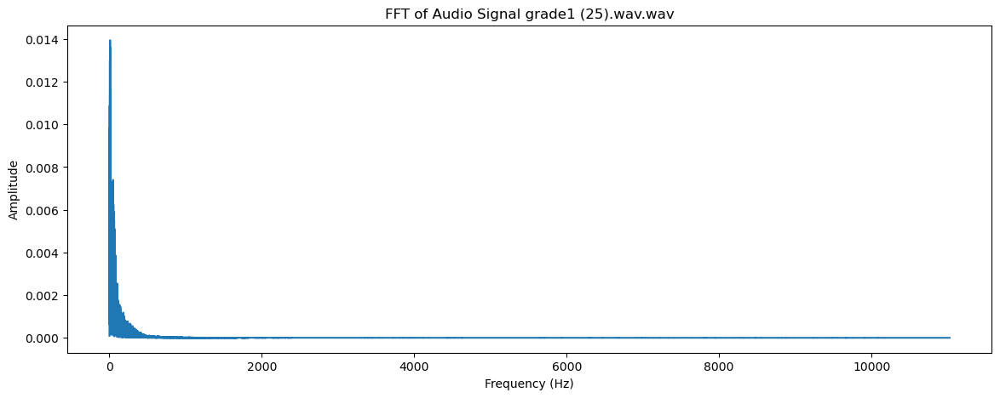

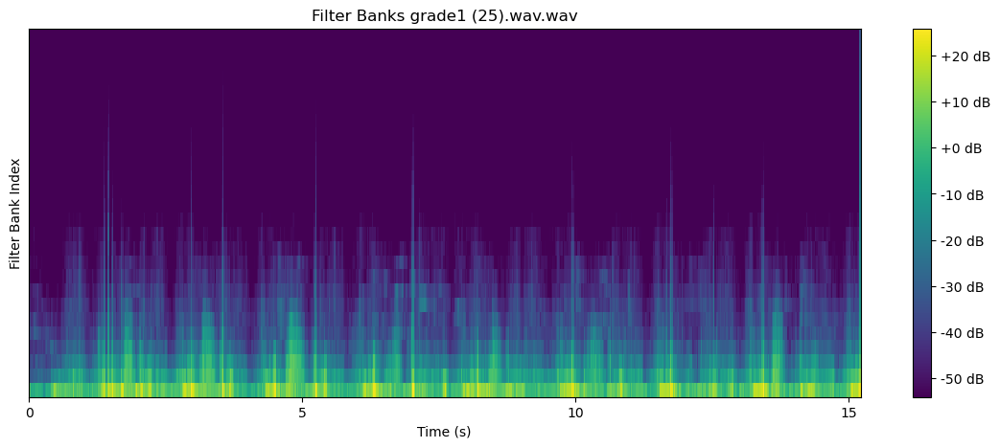

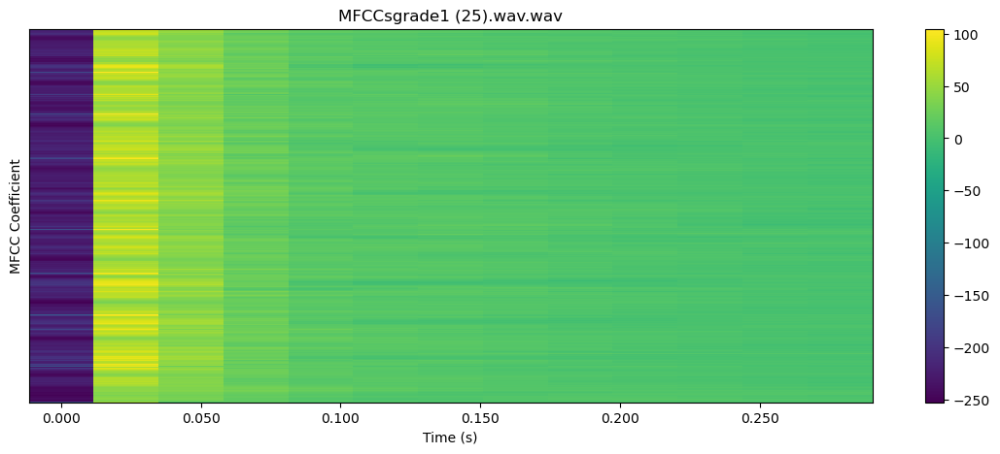

 13%|█▎        | 18/141 [00:43<04:32,  2.22s/it]

22050


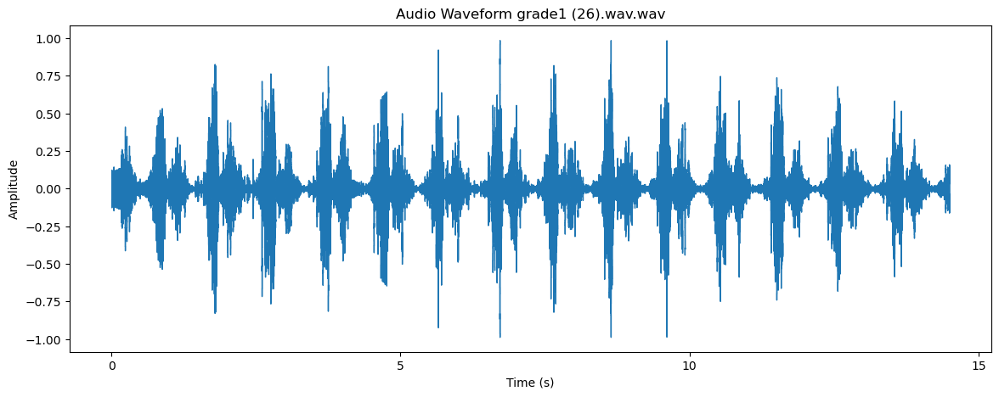

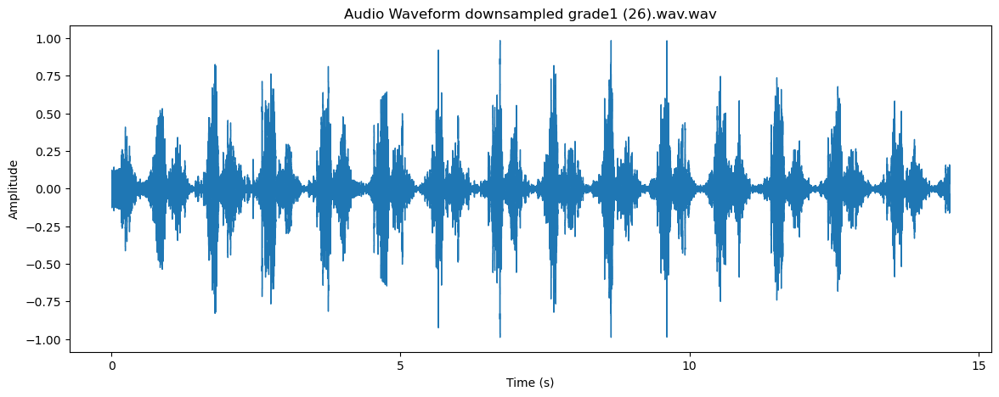

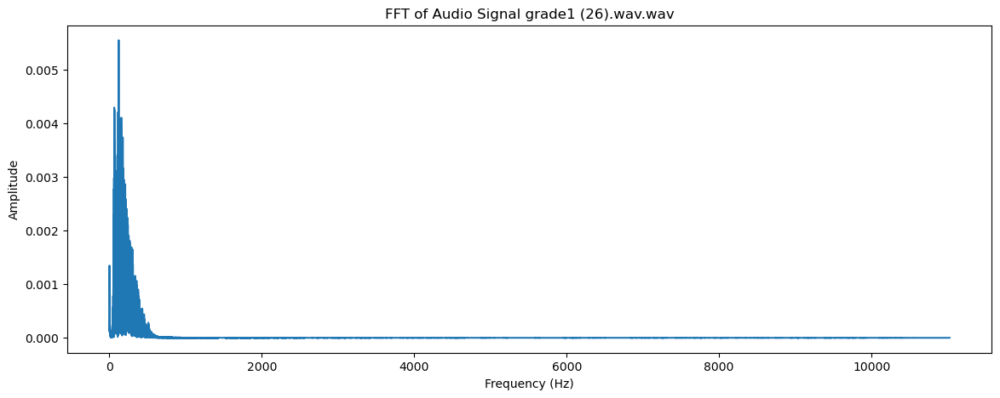

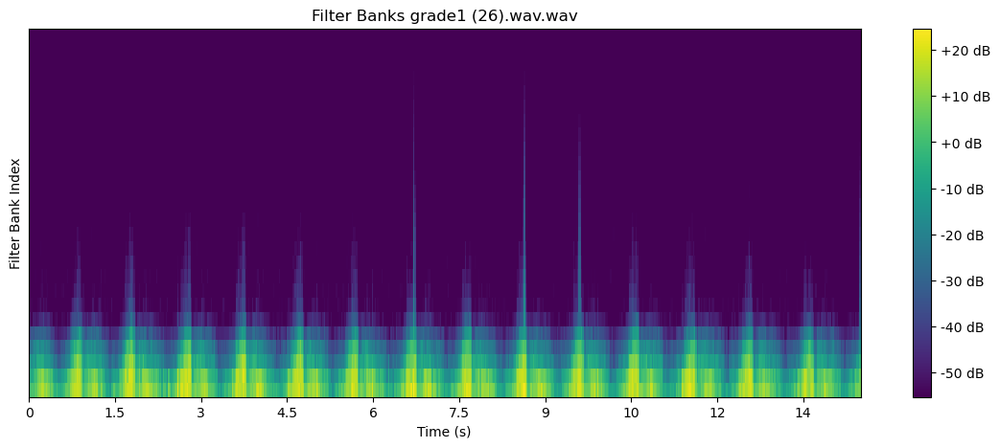

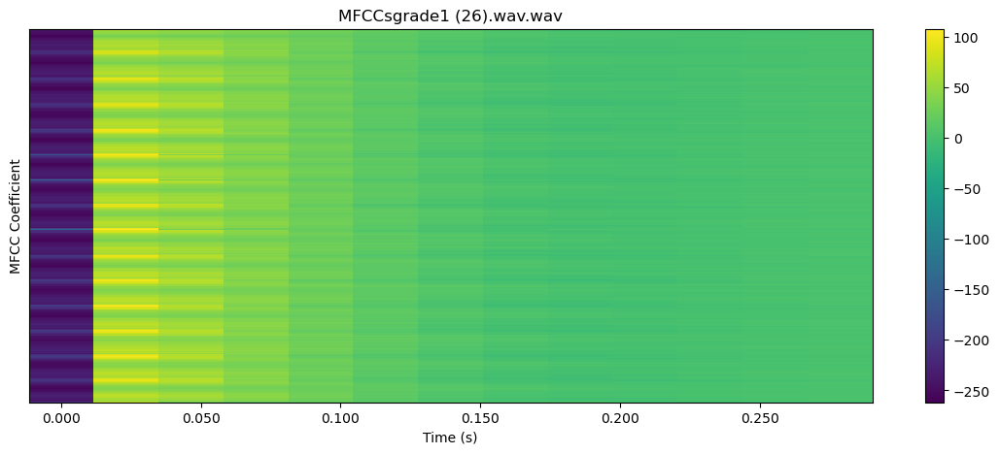

 13%|█▎        | 19/141 [00:44<04:10,  2.05s/it]

22050


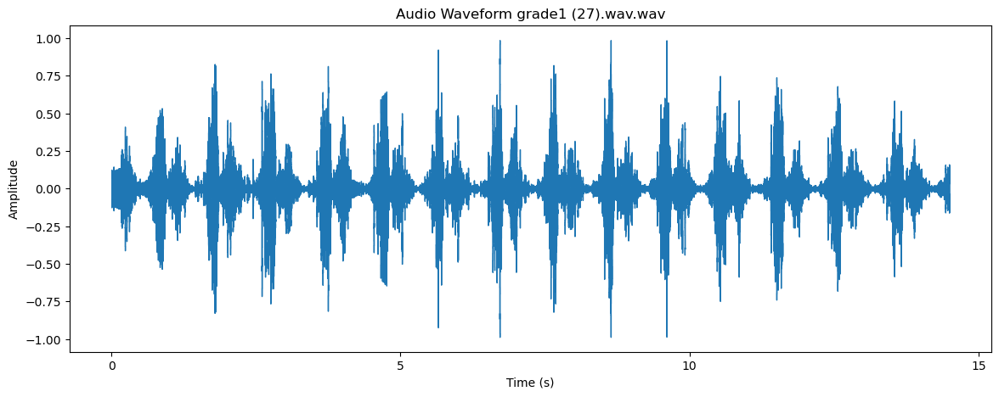

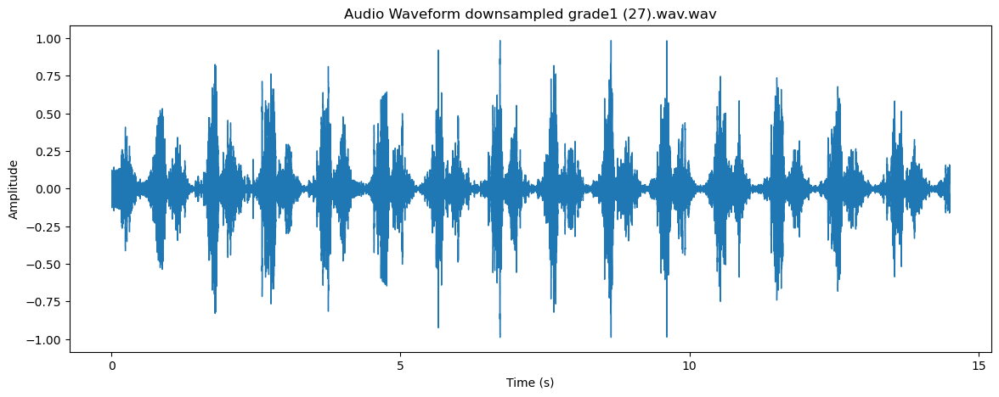

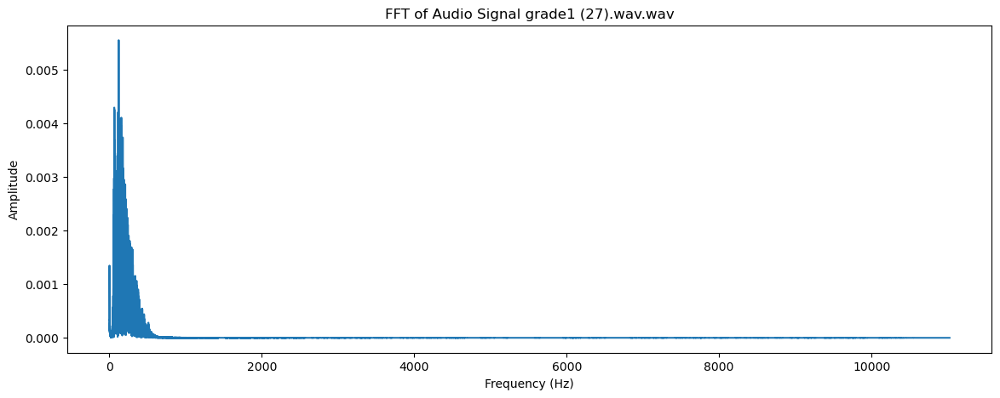

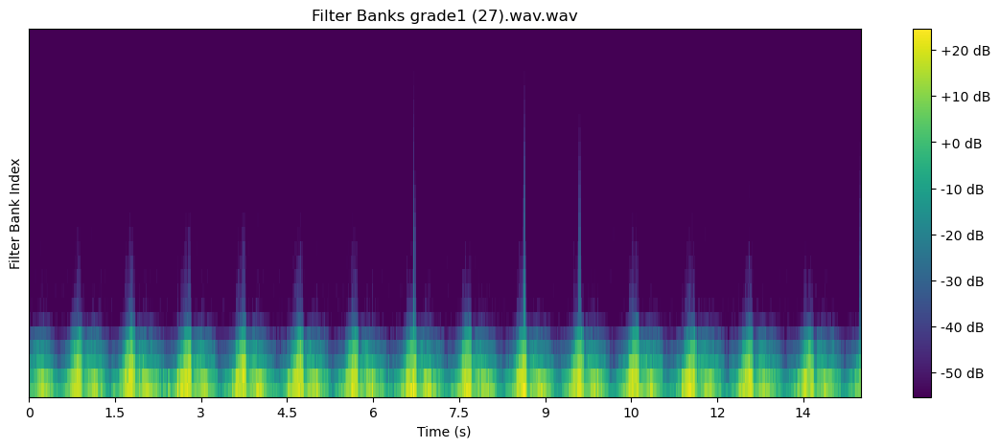

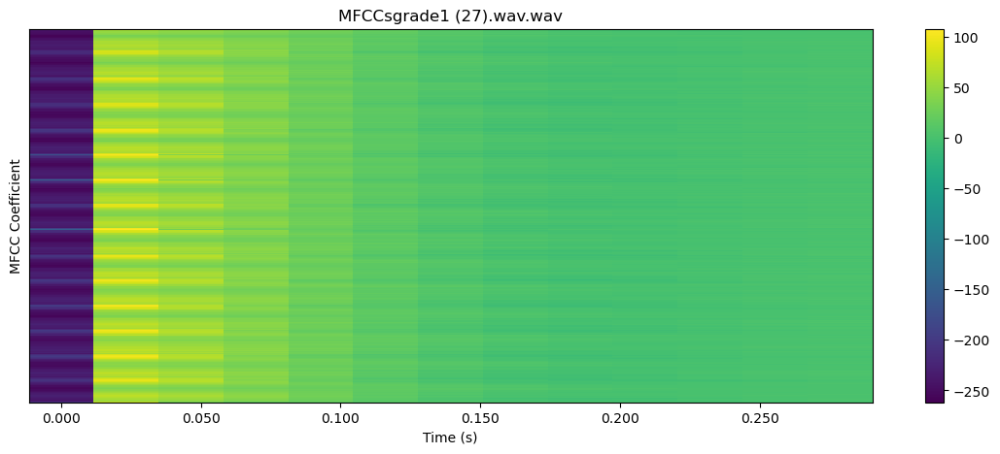

 14%|█▍        | 20/141 [00:46<03:55,  1.95s/it]

22050


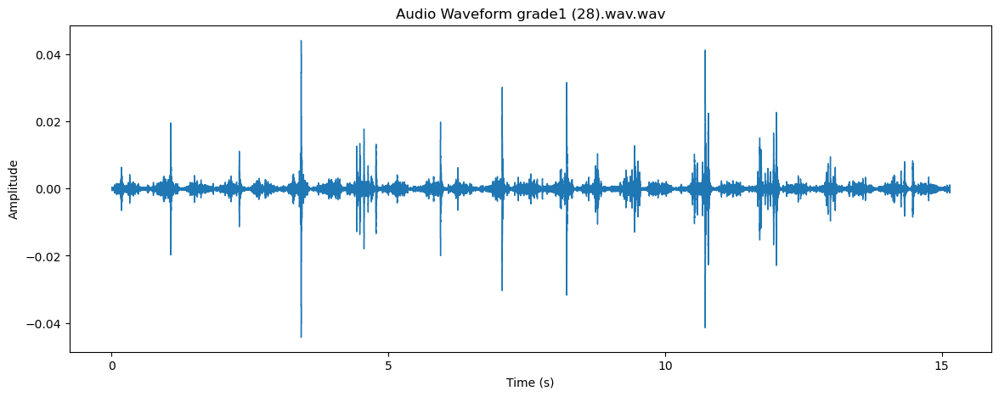

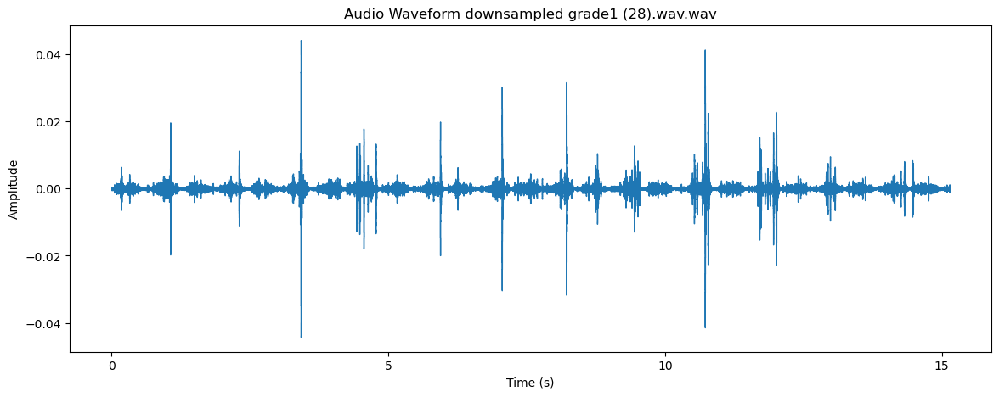

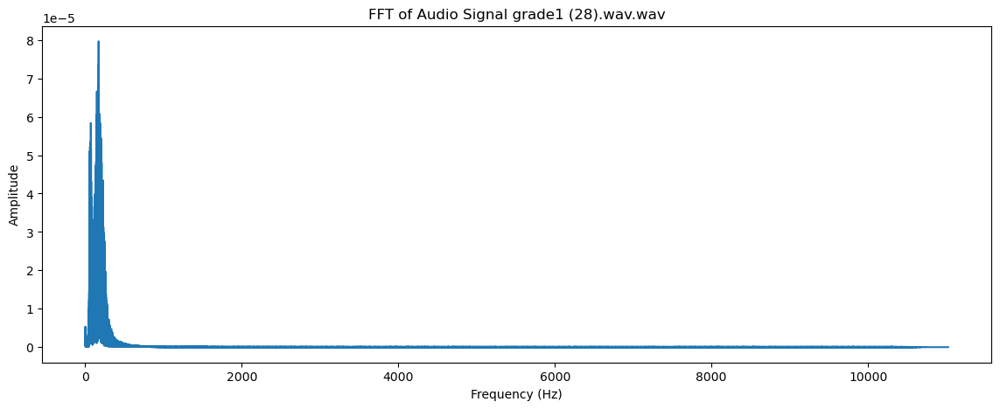

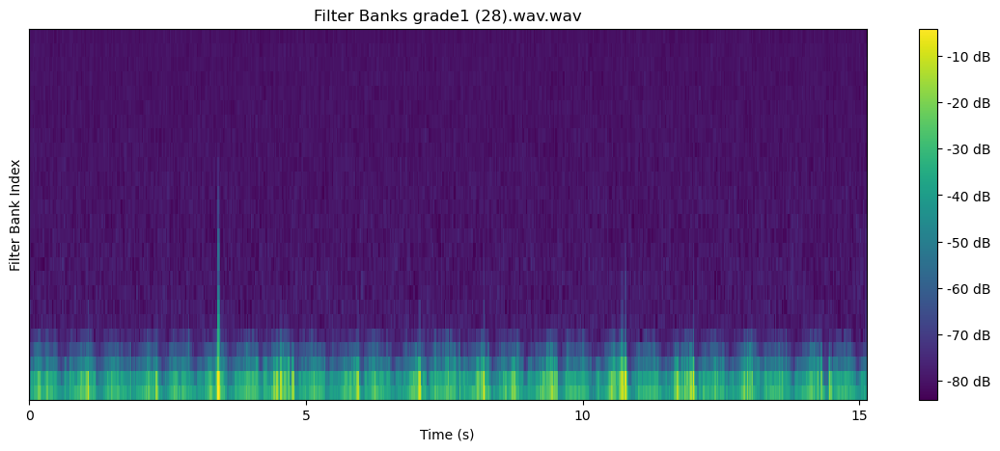

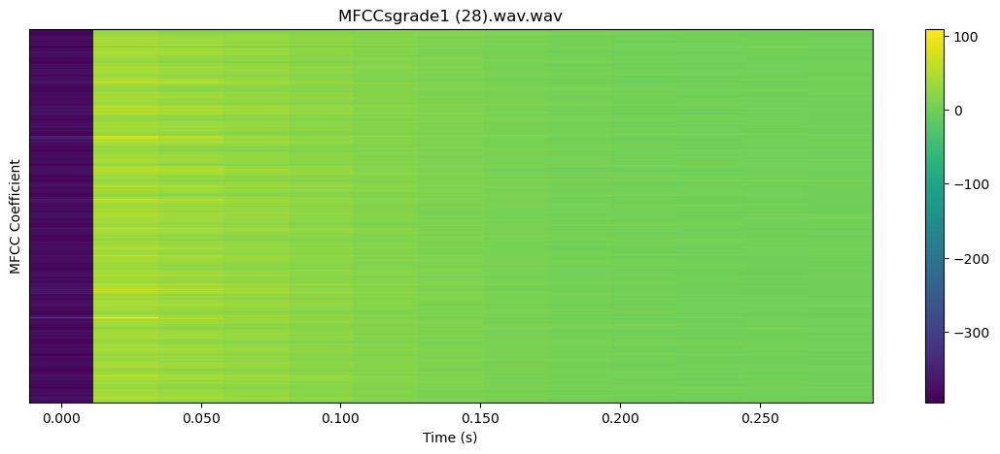

 15%|█▍        | 21/141 [00:49<04:19,  2.16s/it]

22050


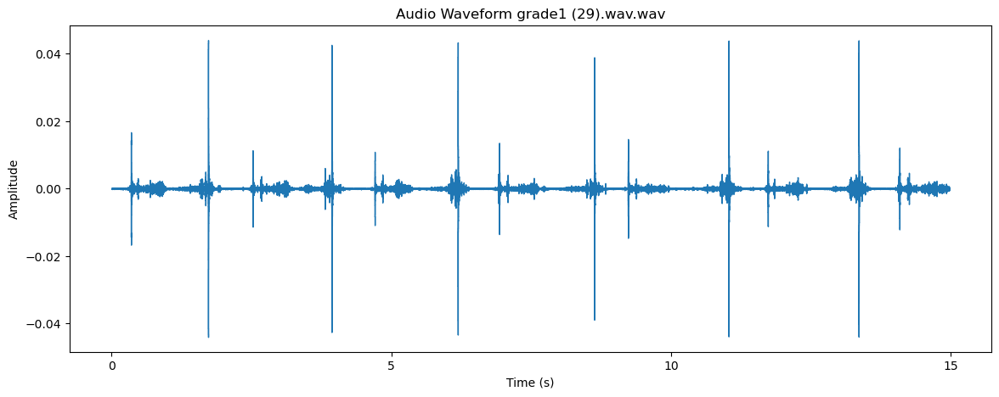

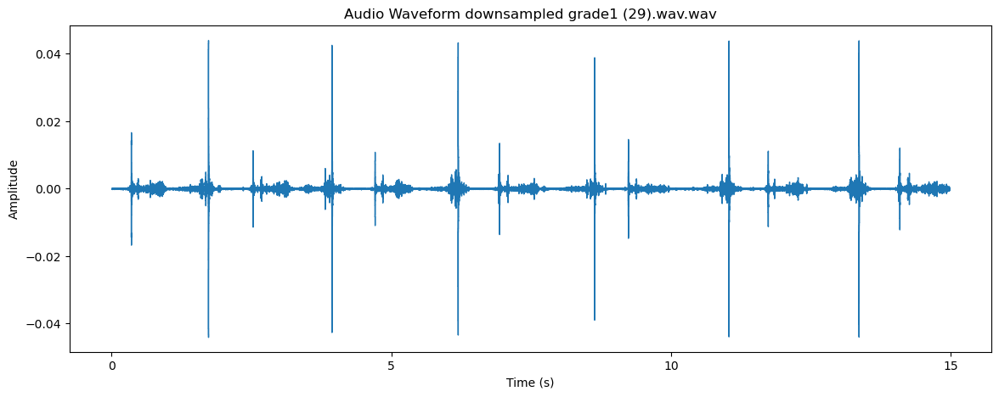

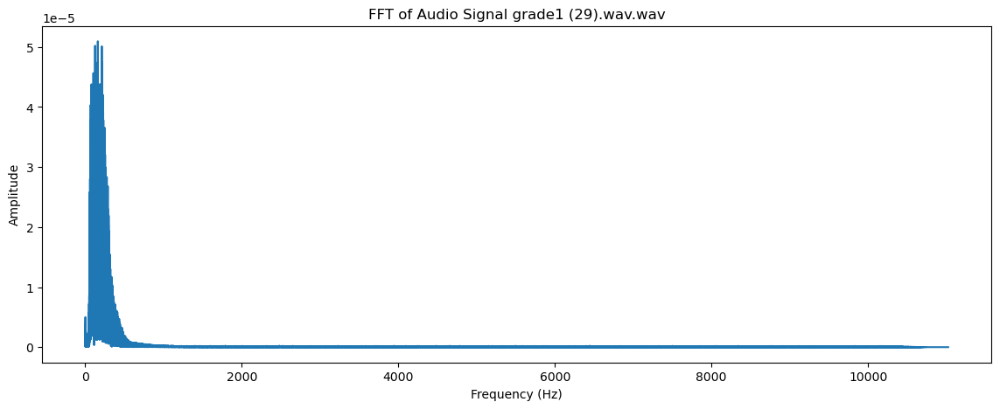

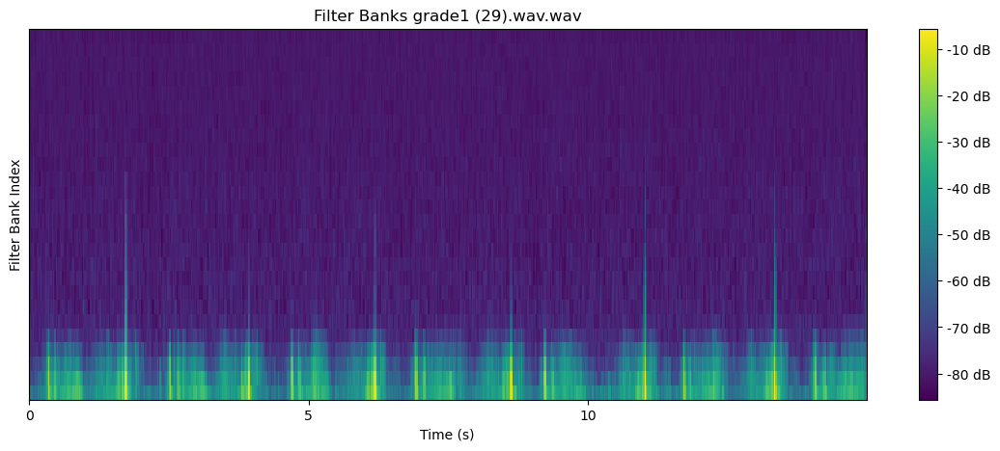

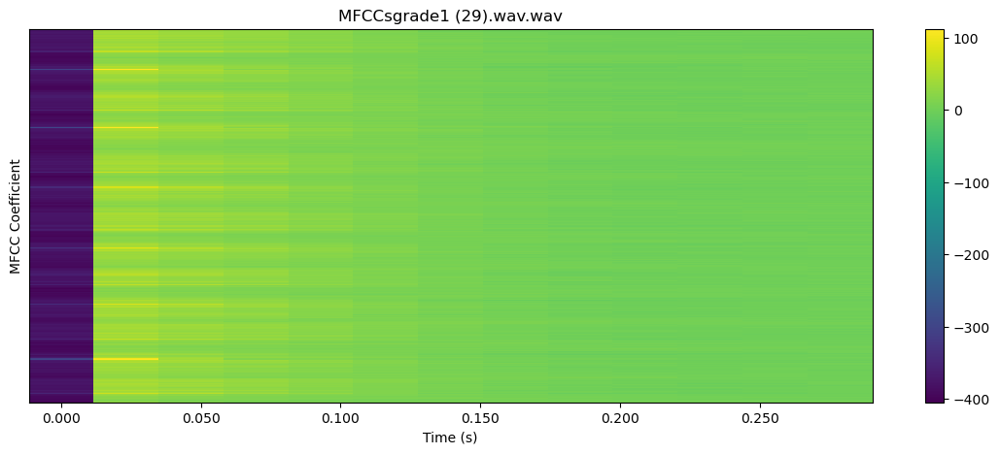

 16%|█▌        | 22/141 [00:51<04:14,  2.14s/it]

22050


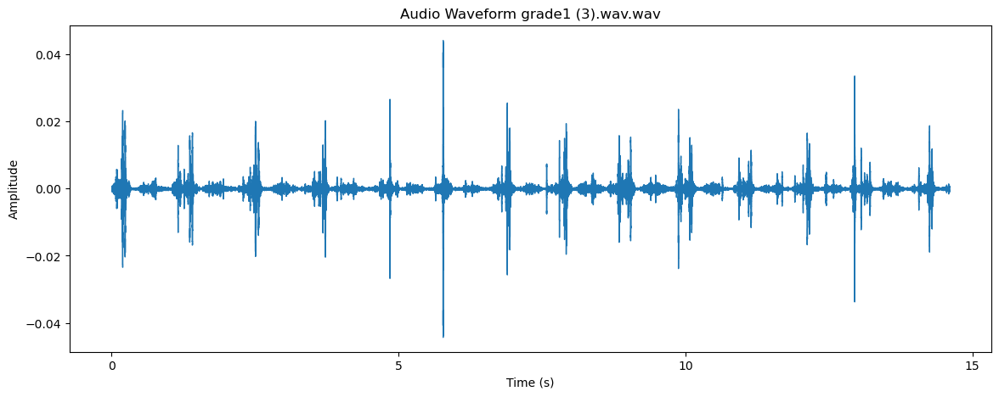

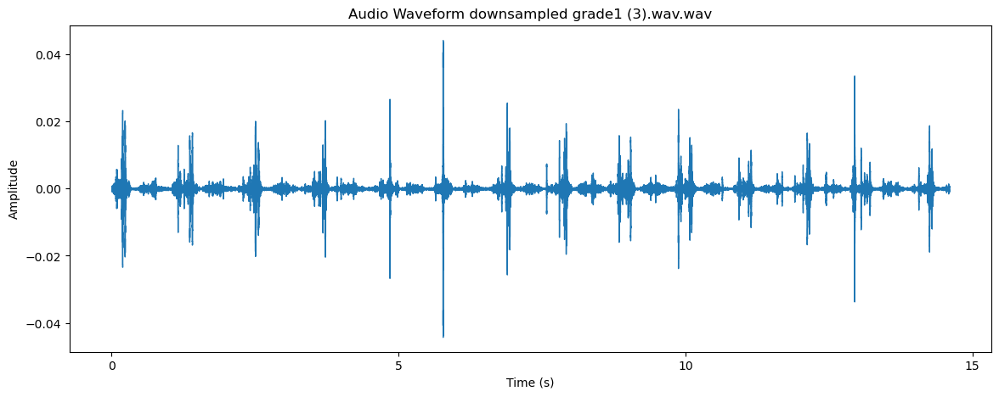

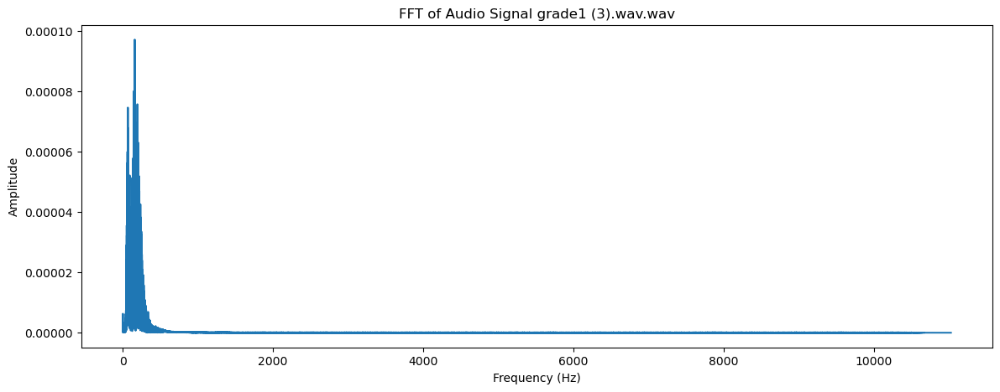

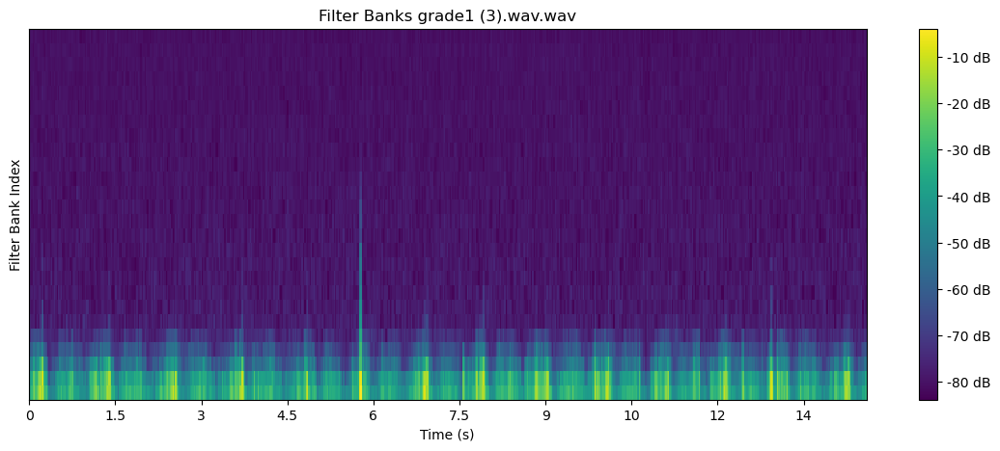

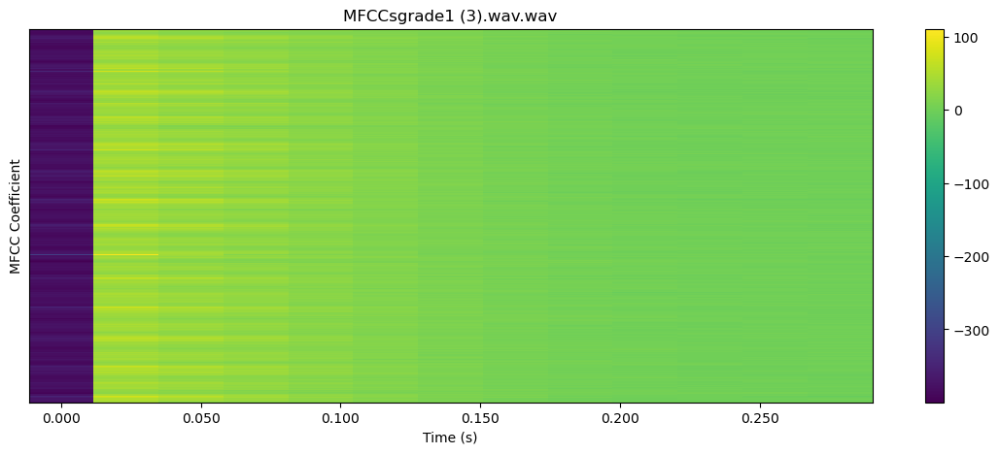

 16%|█▋        | 23/141 [00:52<03:47,  1.93s/it]

22050


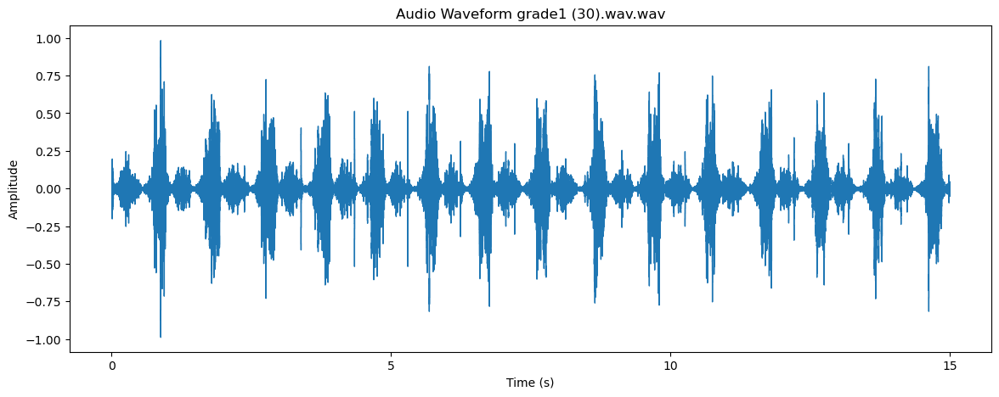

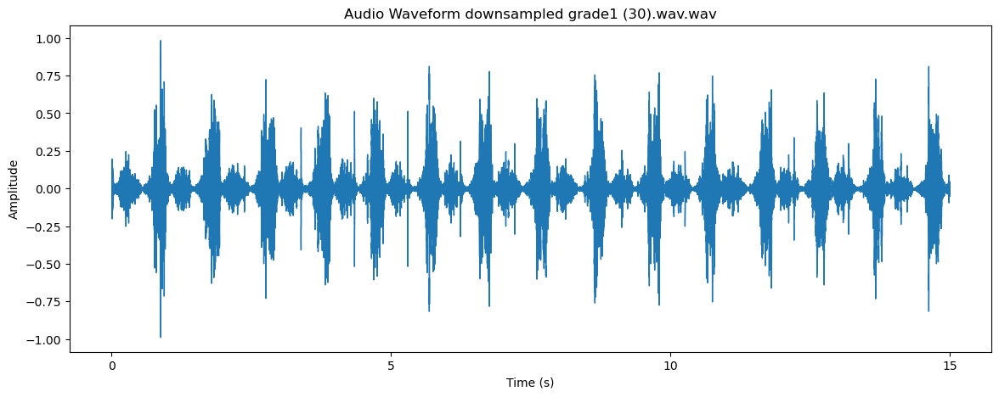

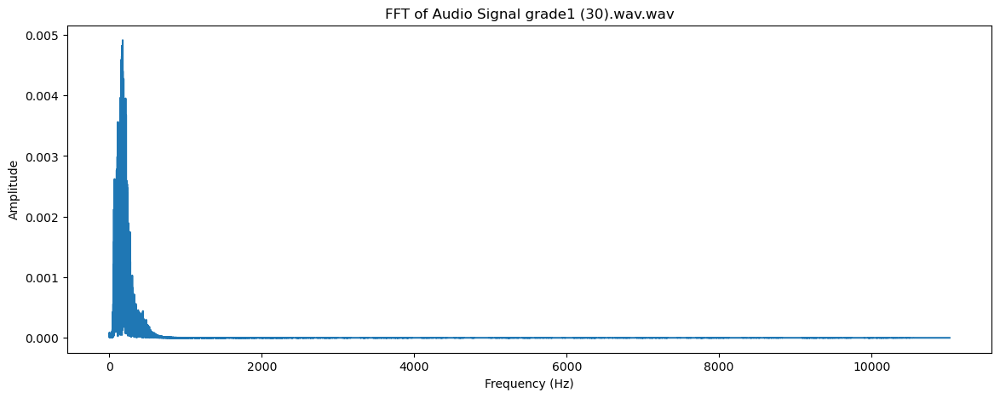

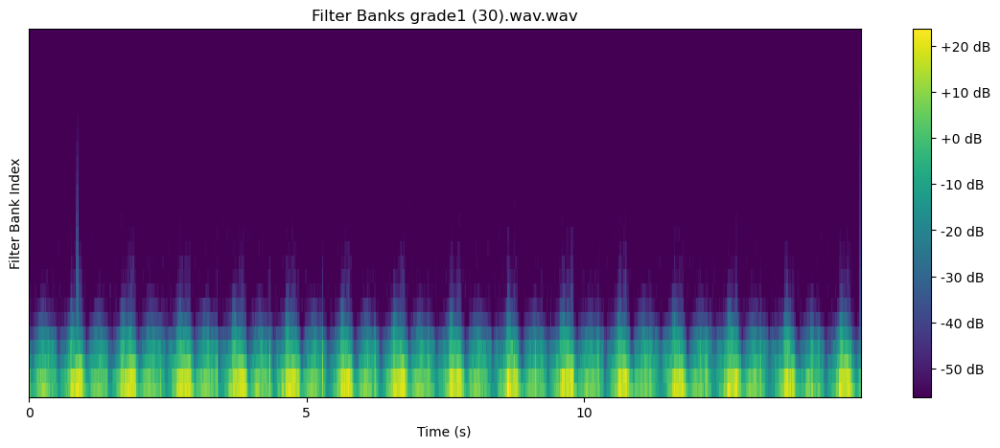

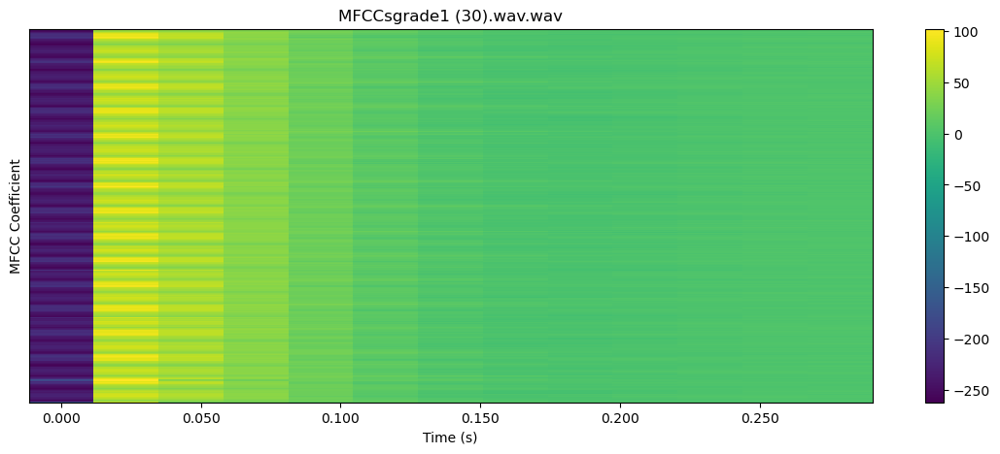

 17%|█▋        | 24/141 [00:54<03:38,  1.87s/it]

22050


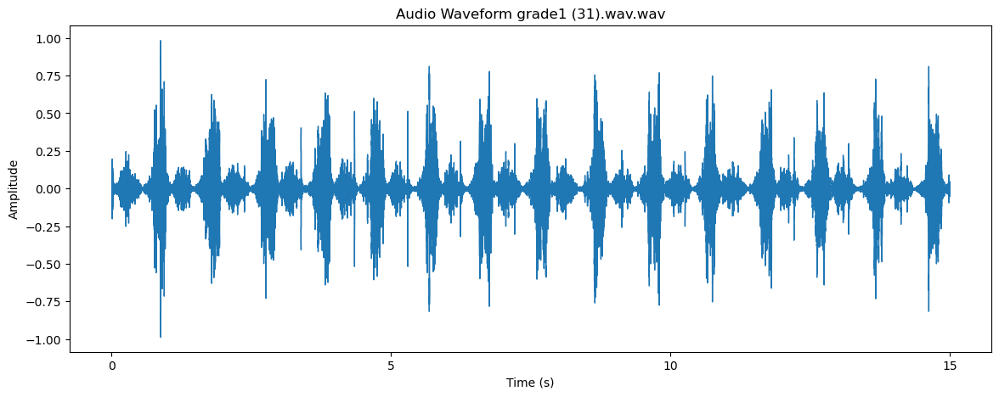

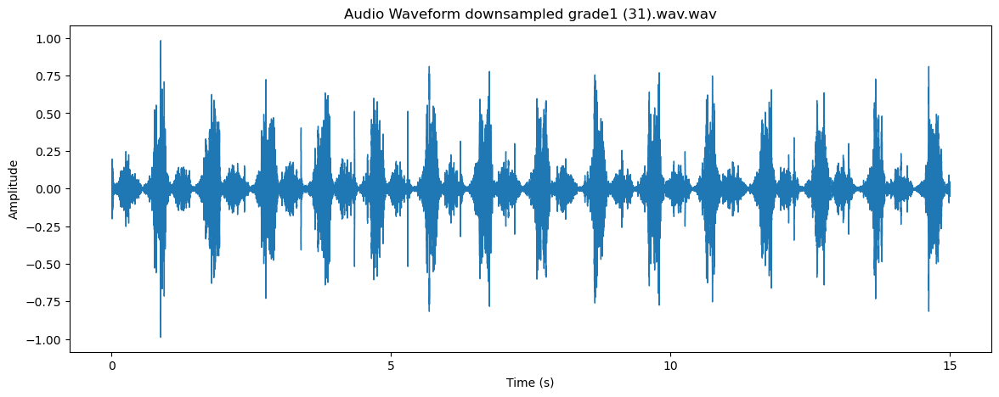

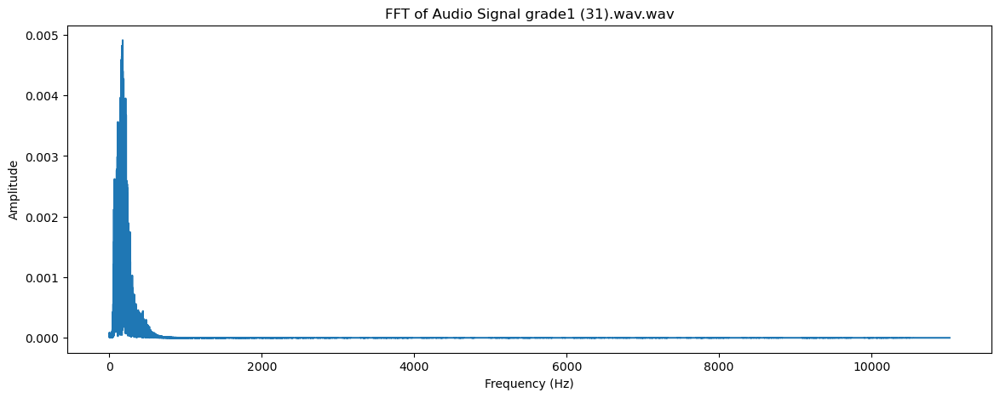

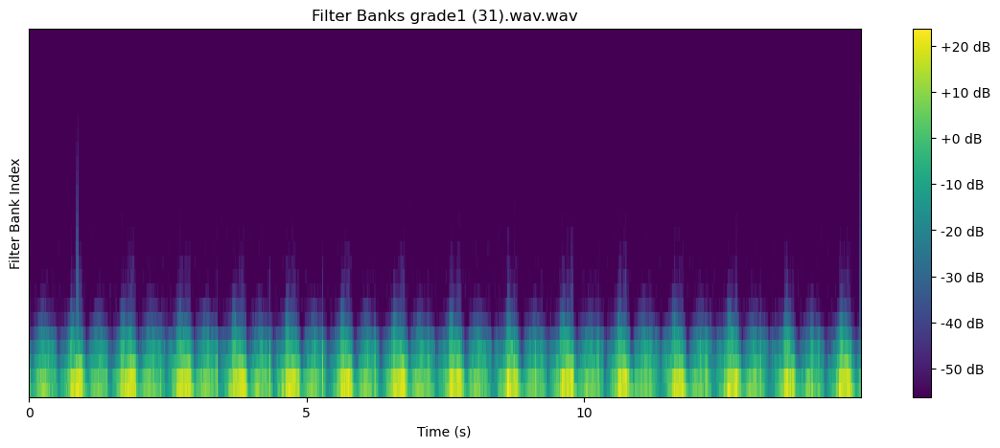

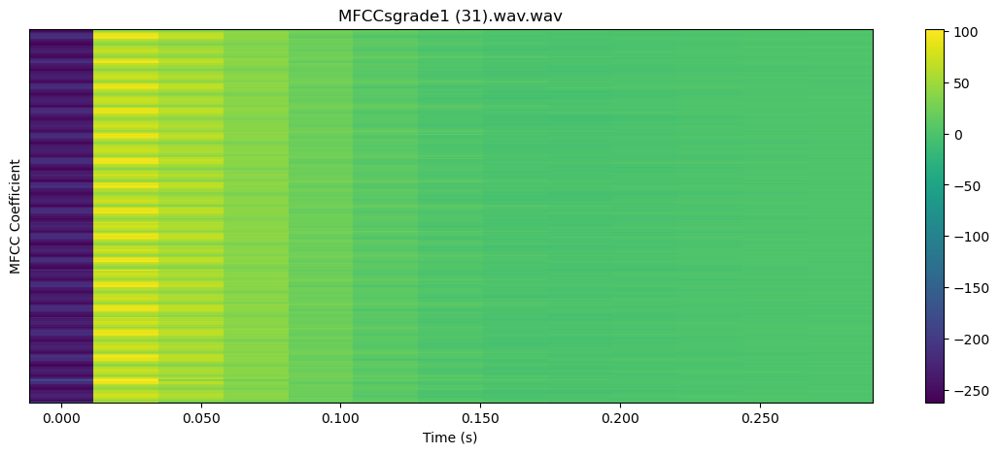

 18%|█▊        | 25/141 [00:56<03:45,  1.94s/it]

22050


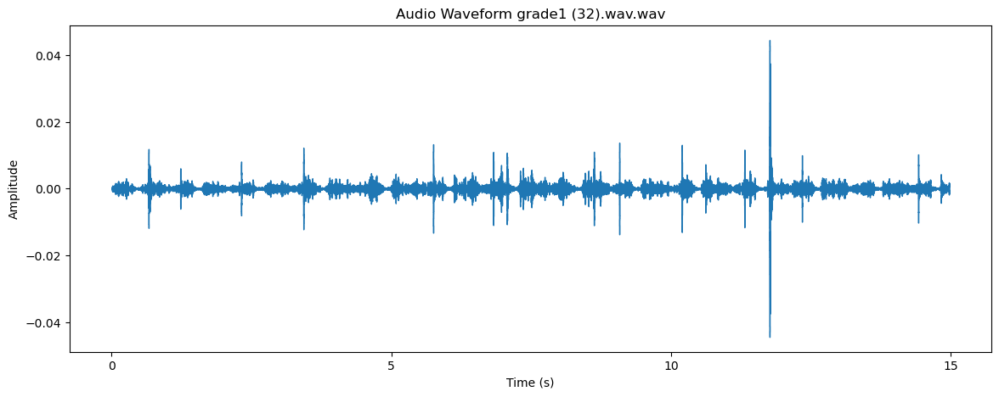

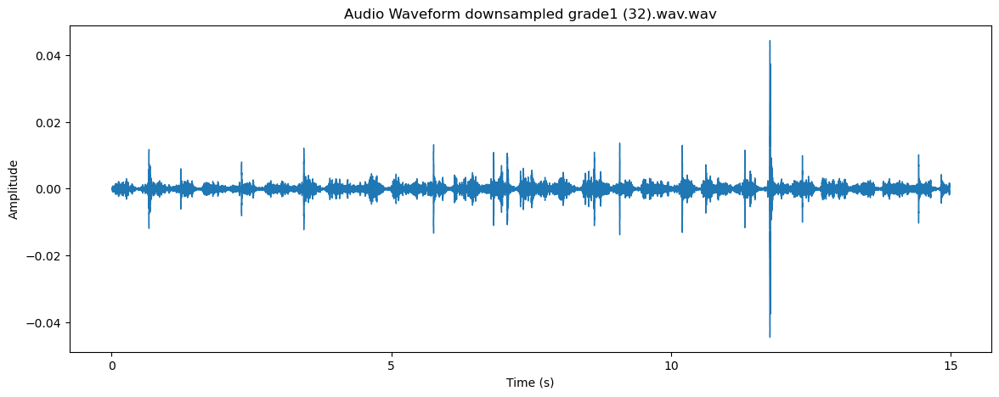

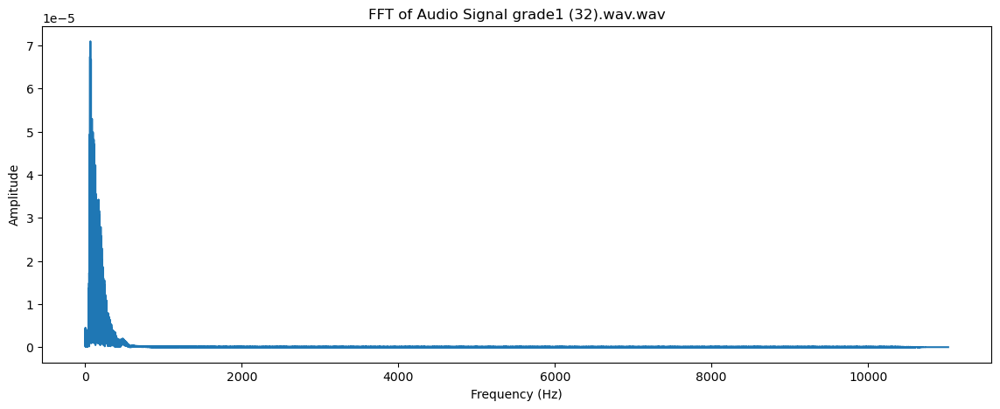

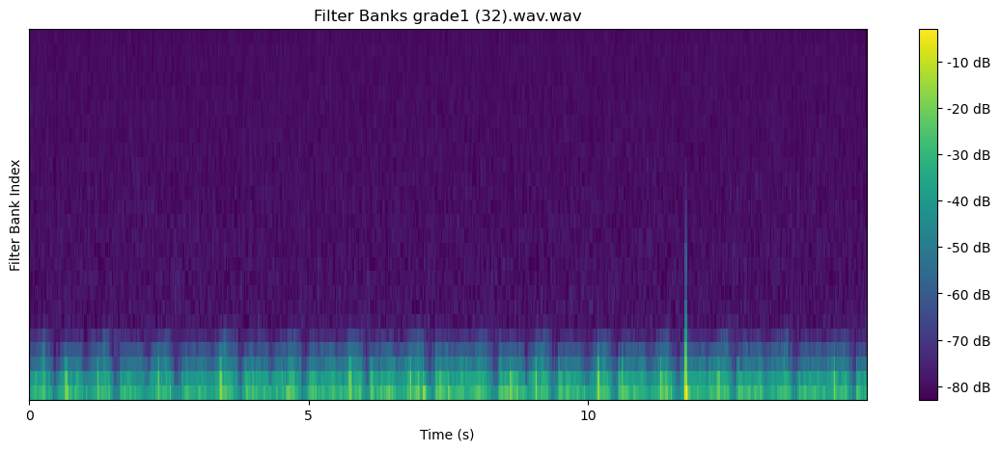

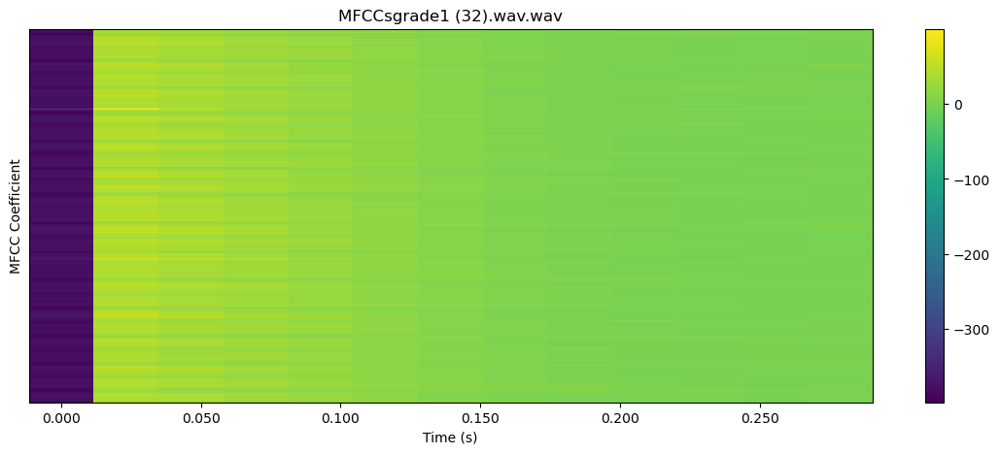

 18%|█▊        | 26/141 [00:58<03:35,  1.87s/it]

22050


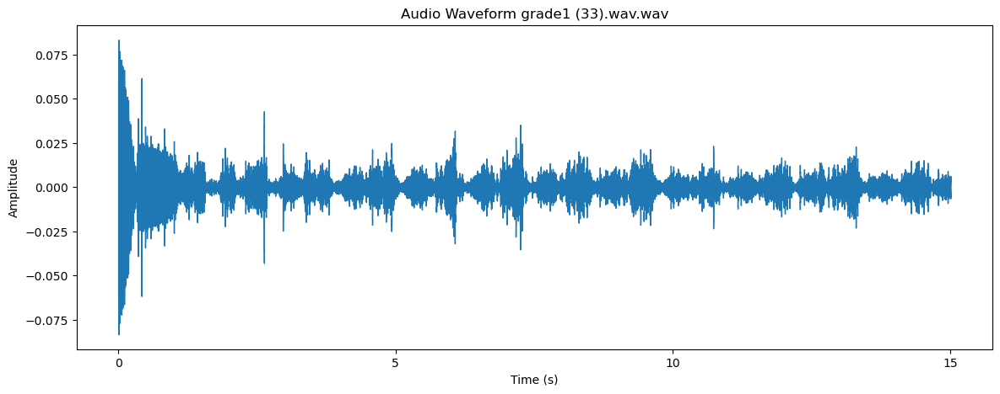

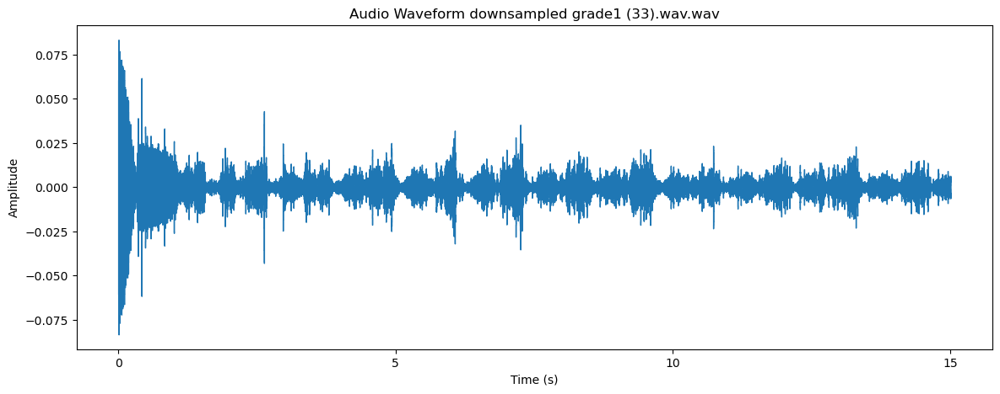

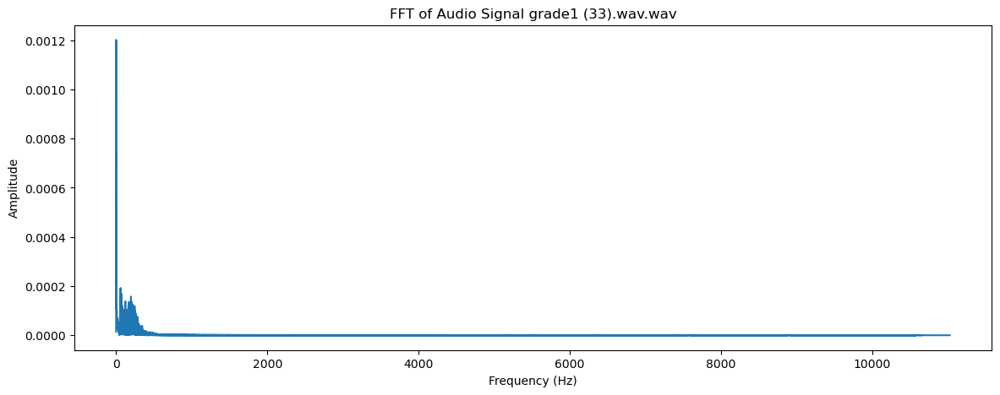

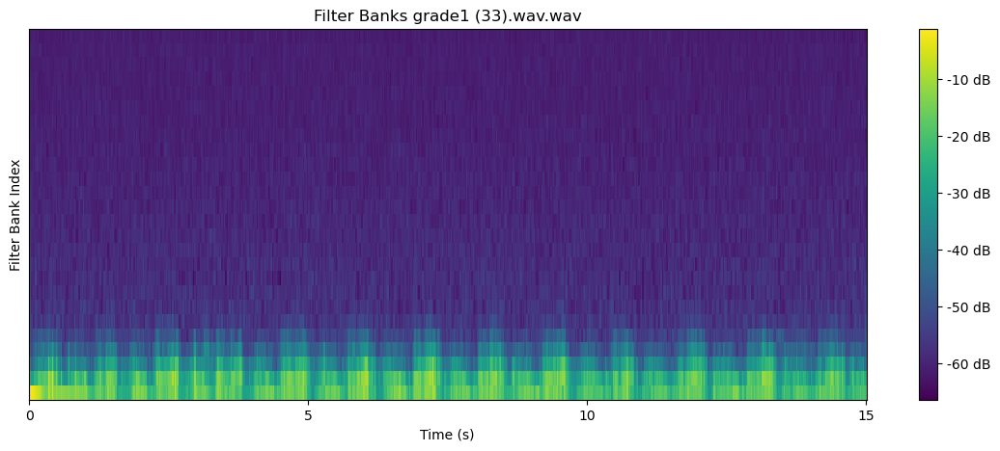

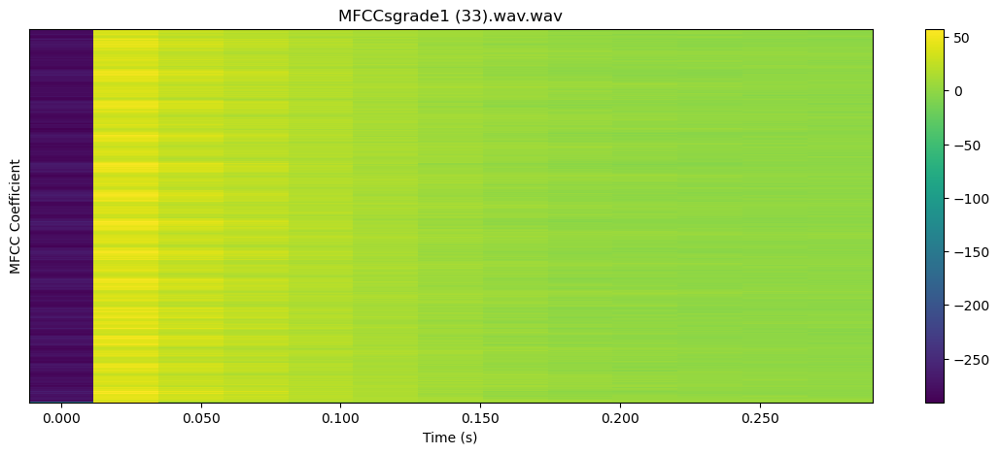

 19%|█▉        | 27/141 [00:59<03:19,  1.75s/it]

22050


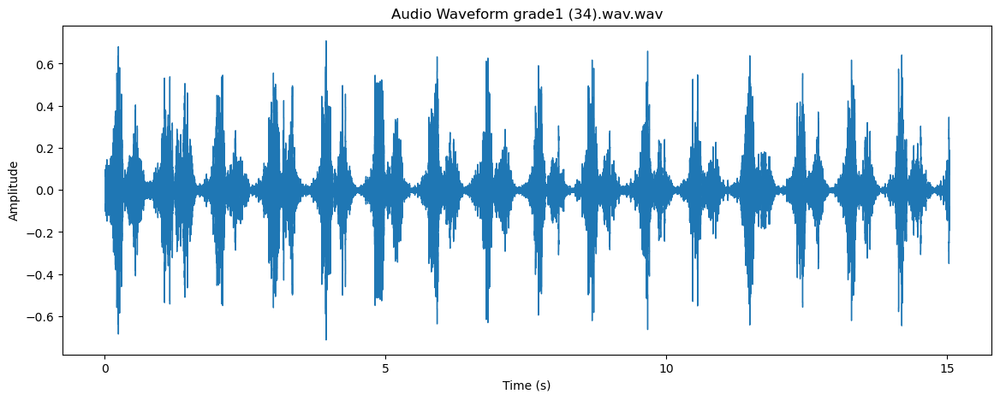

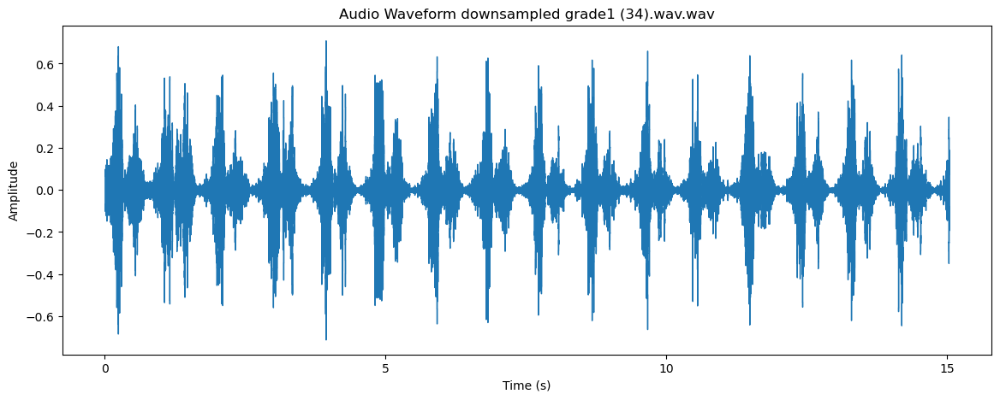

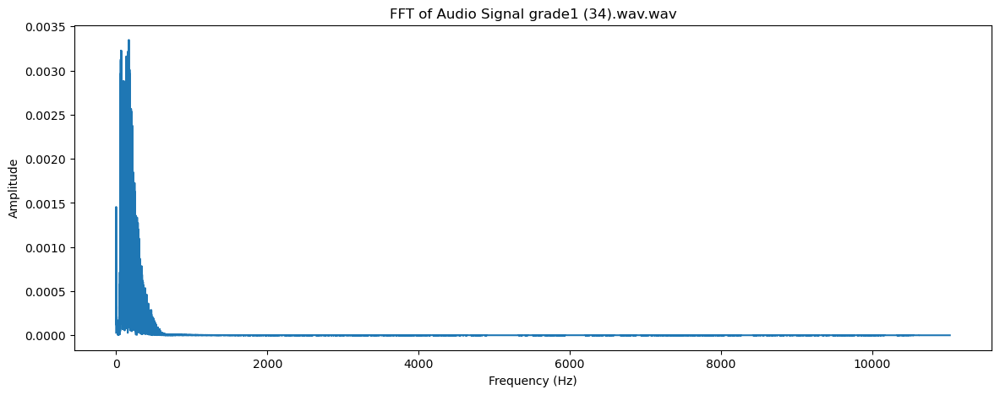

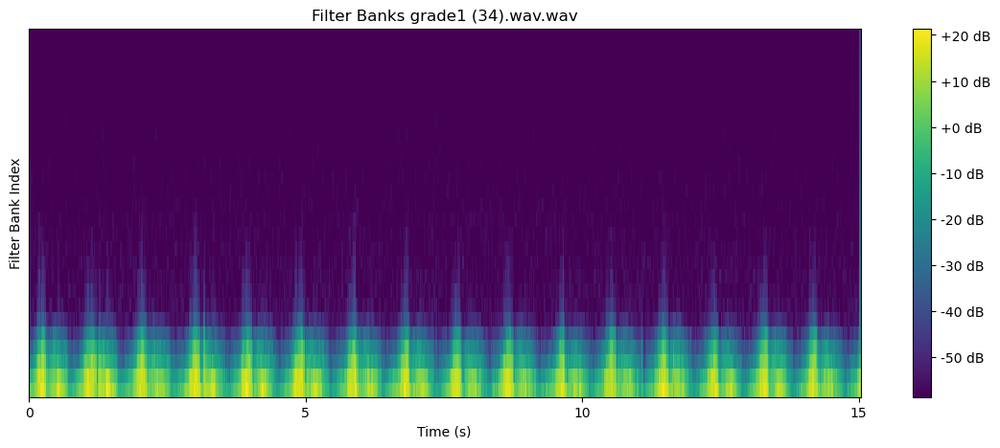

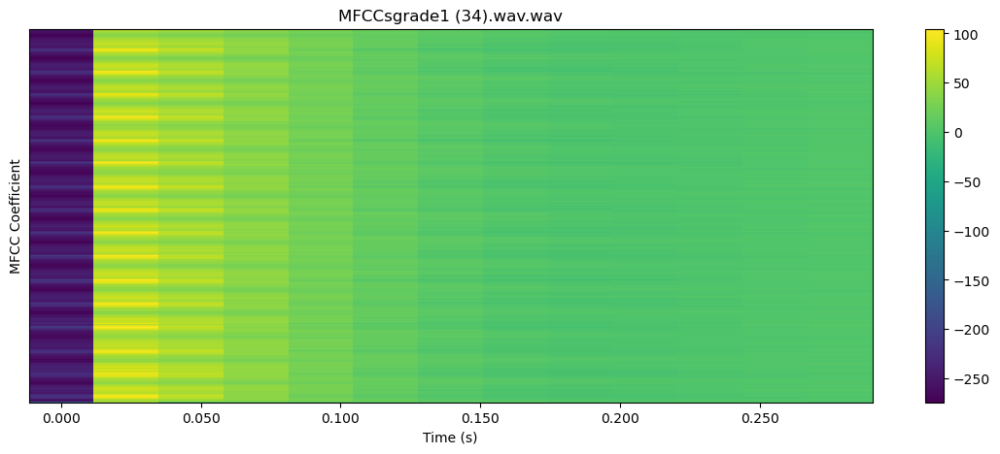

 20%|█▉        | 28/141 [01:01<03:05,  1.64s/it]

22050


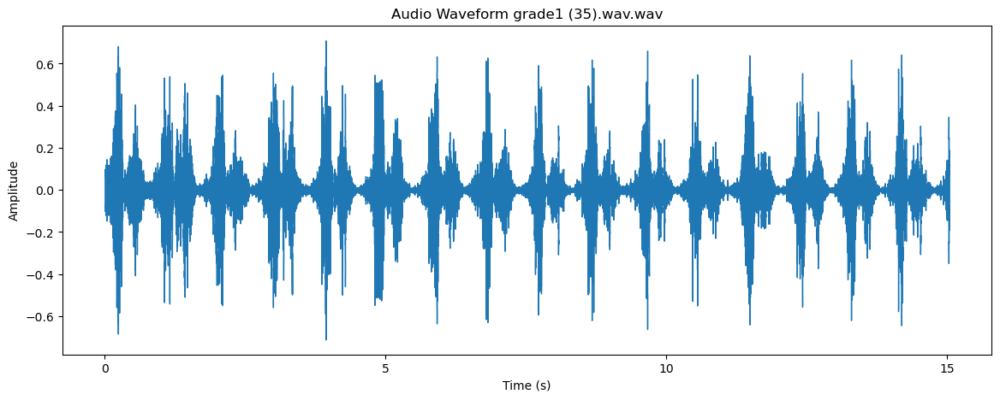

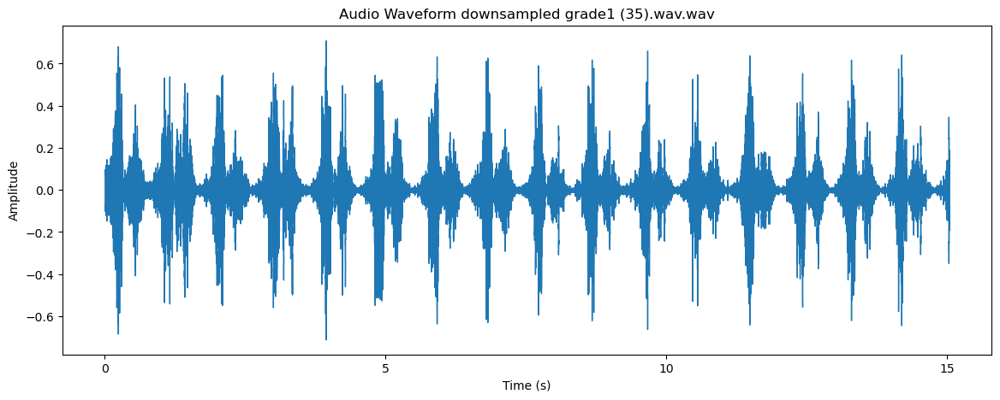

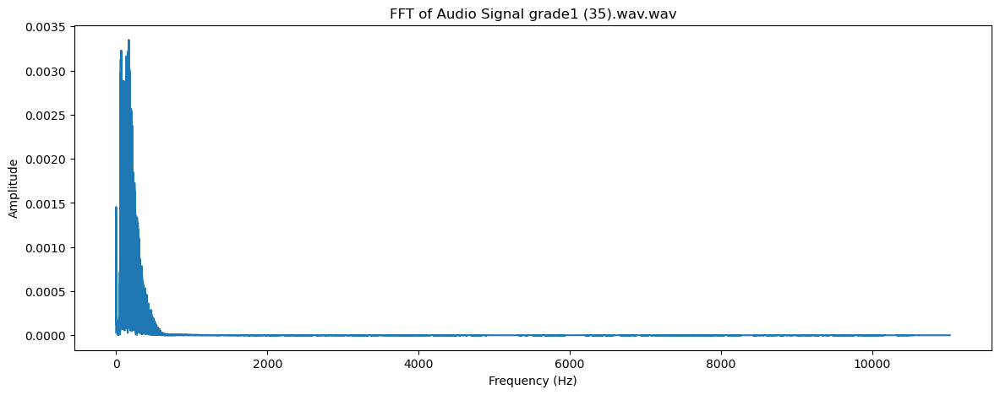

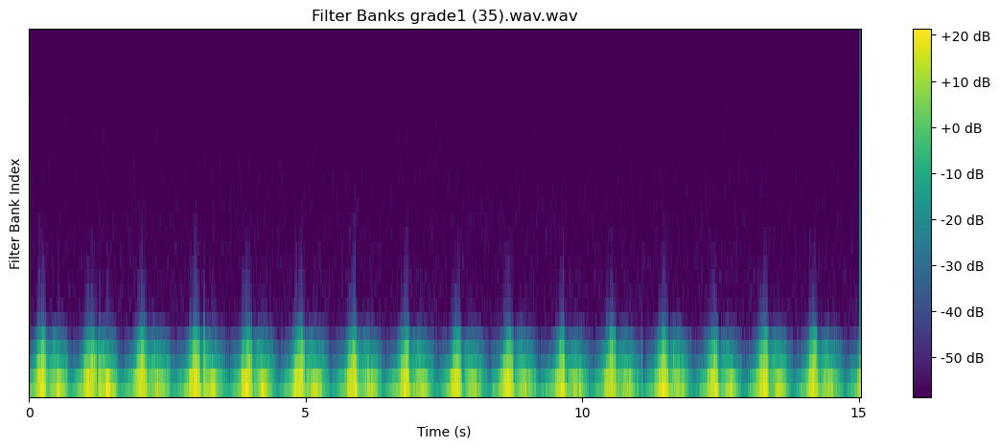

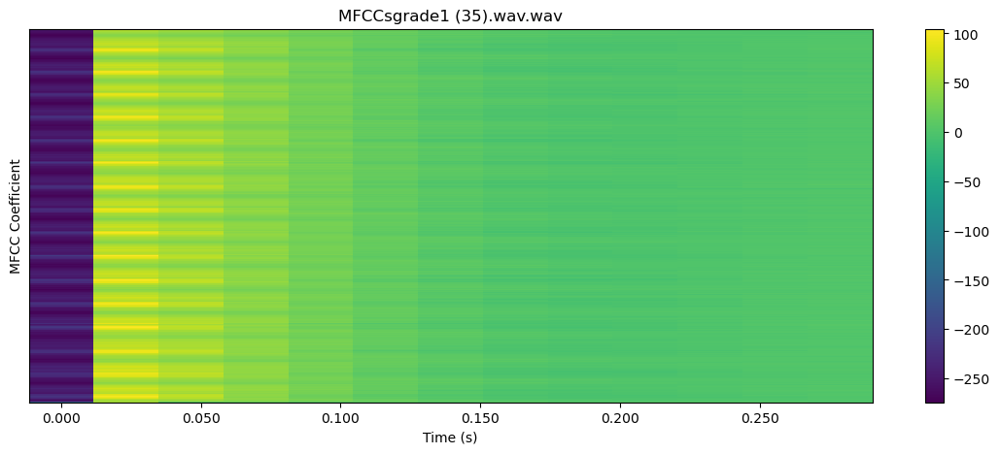

 21%|██        | 29/141 [01:02<03:04,  1.65s/it]

22050


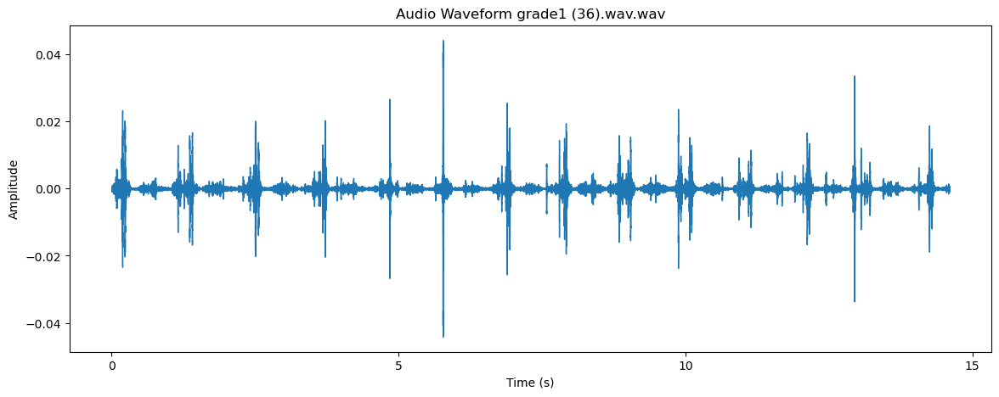

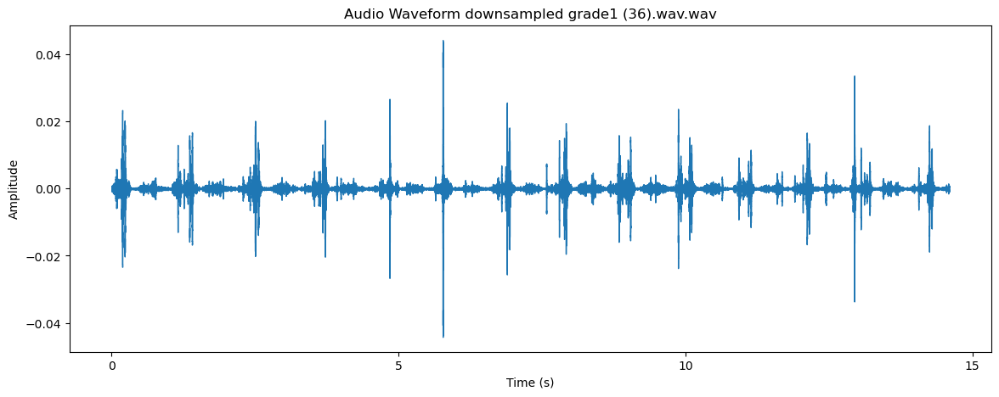

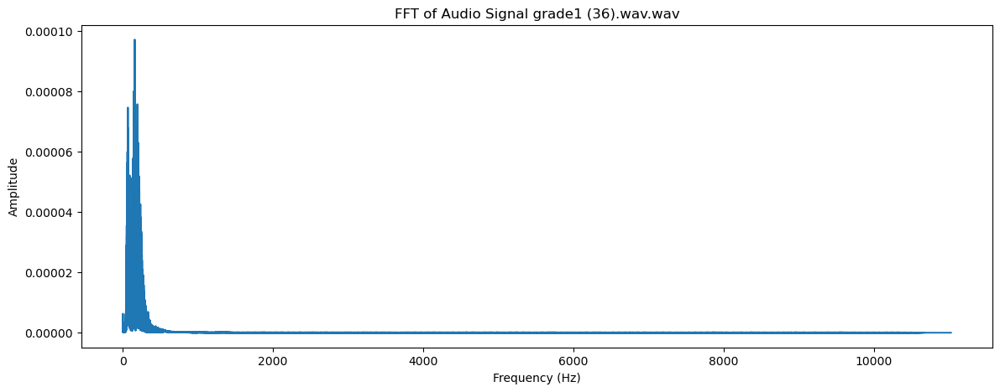

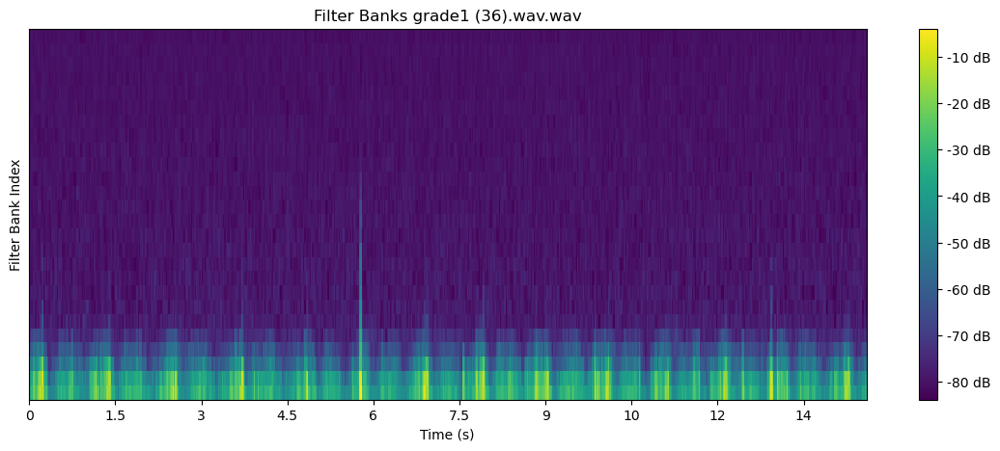

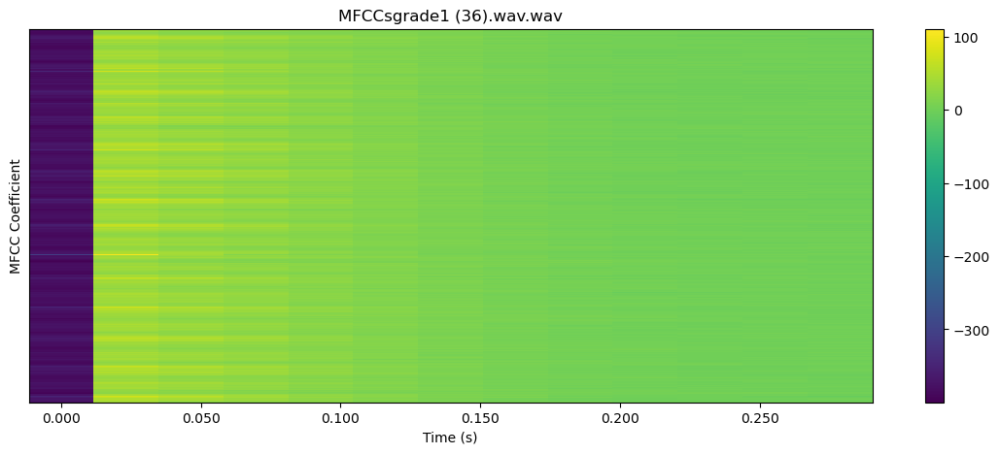

 21%|██▏       | 30/141 [01:04<03:13,  1.75s/it]

22050


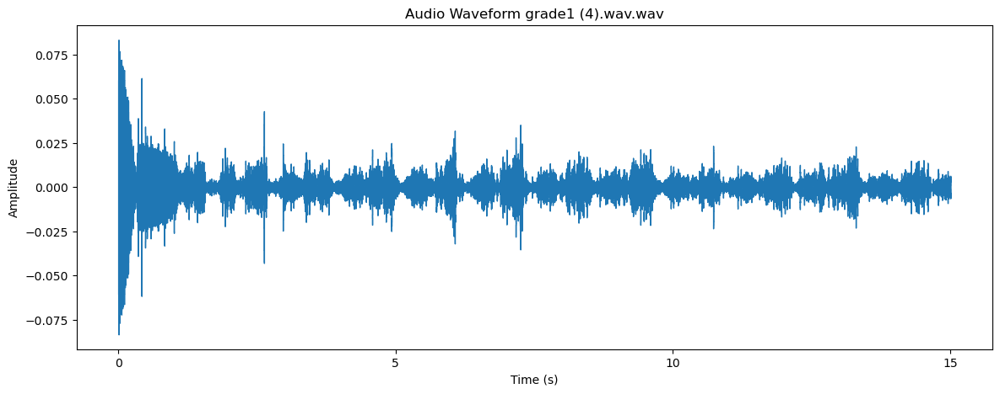

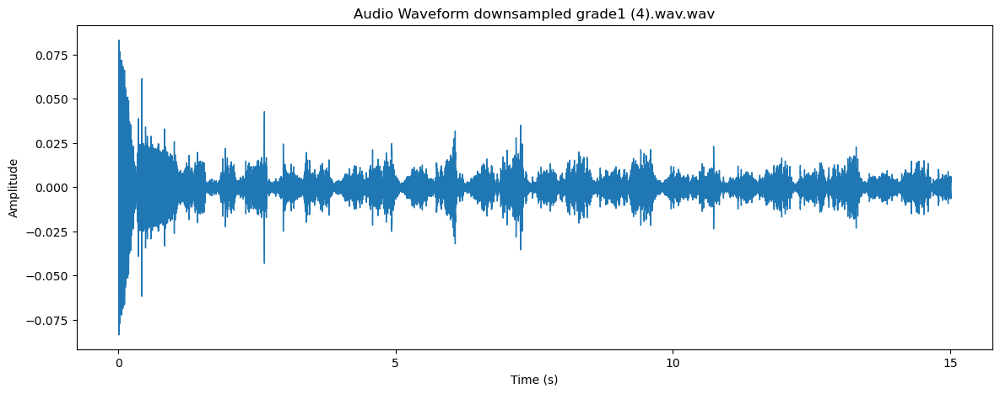

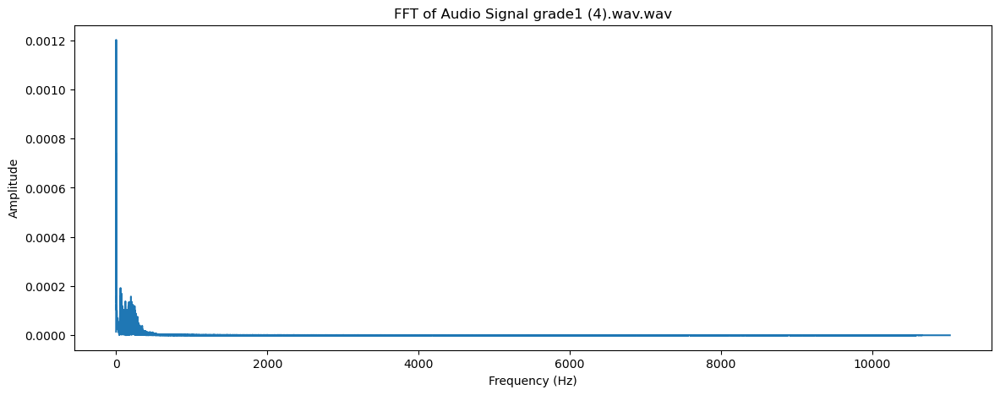

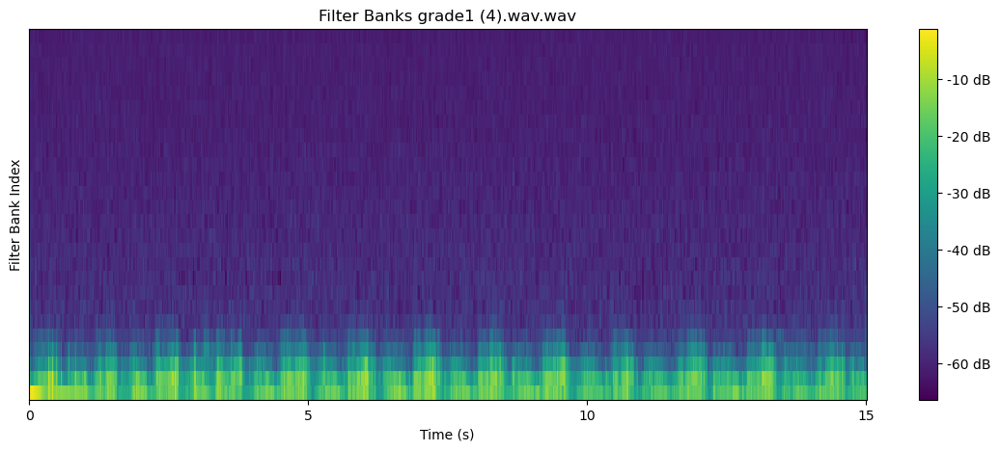

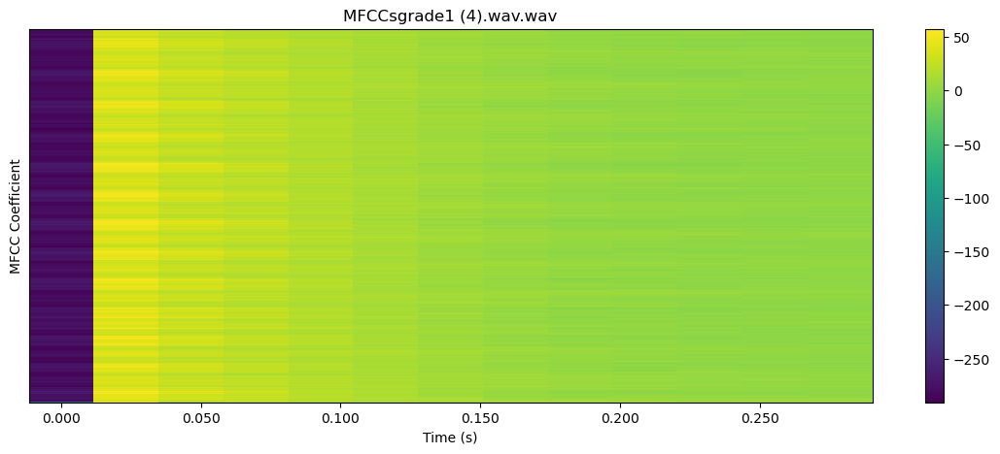

 22%|██▏       | 31/141 [01:07<03:33,  1.94s/it]

22050


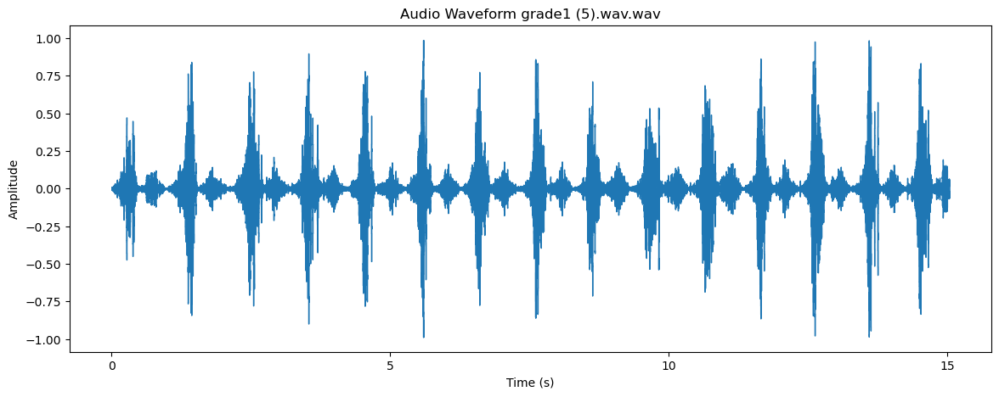

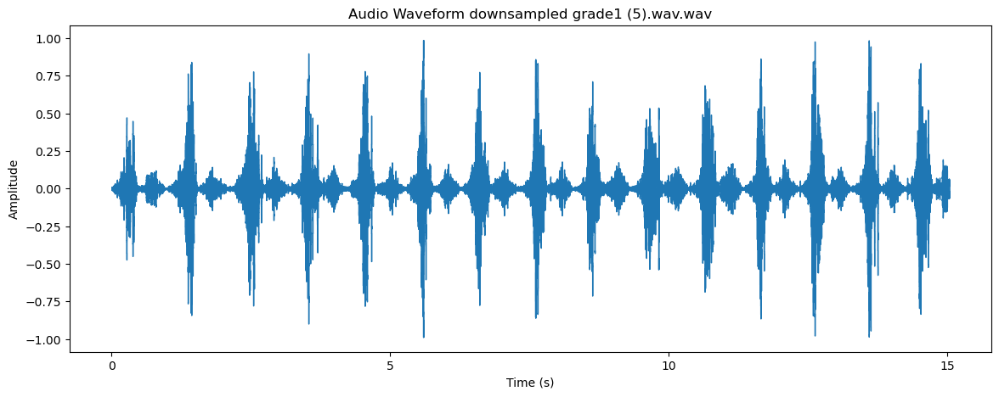

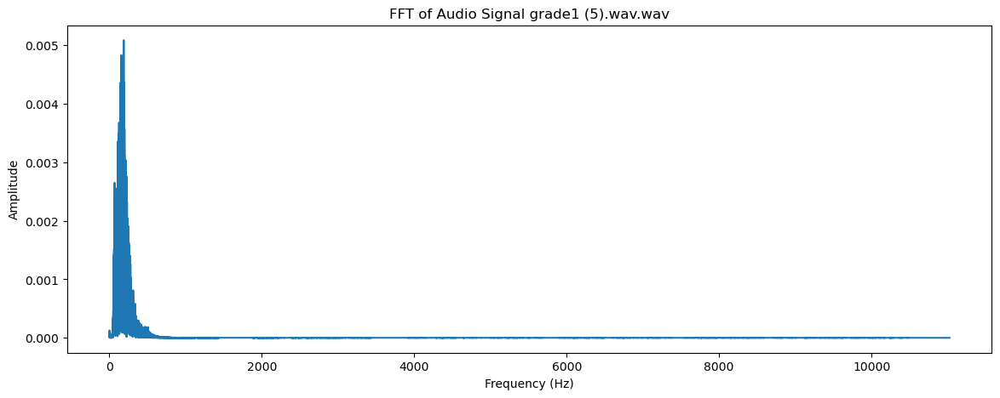

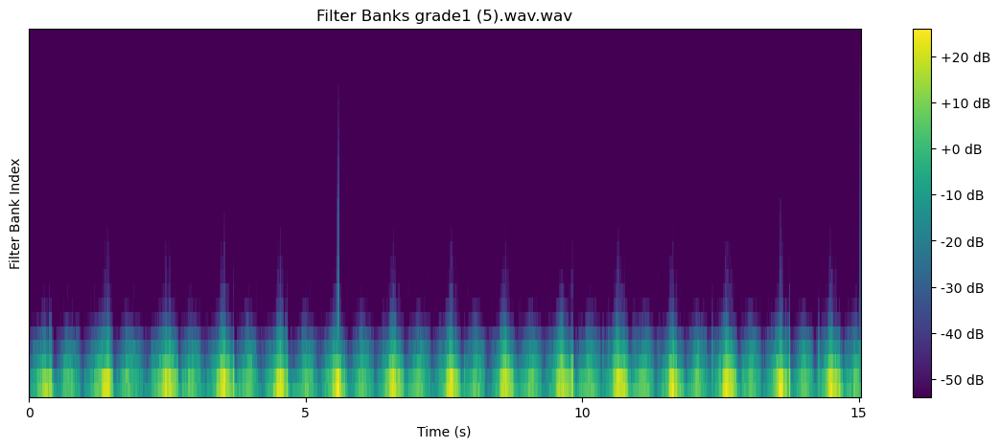

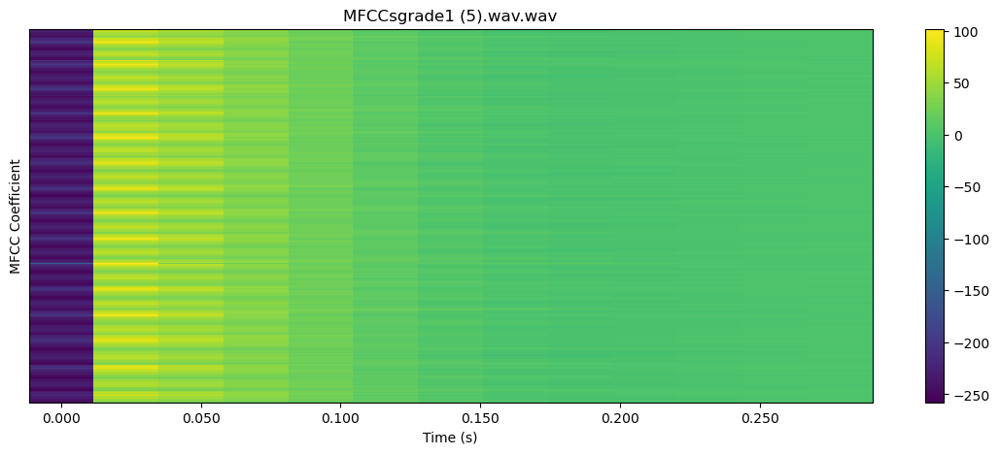

 23%|██▎       | 32/141 [01:08<03:20,  1.84s/it]

22050


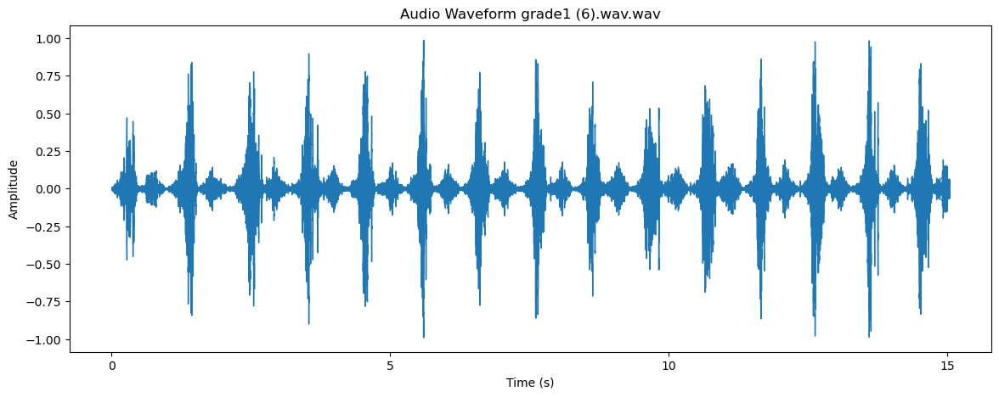

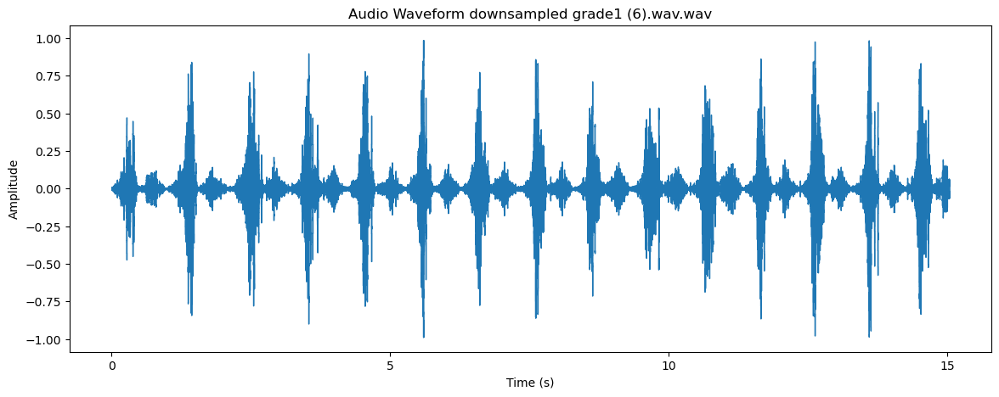

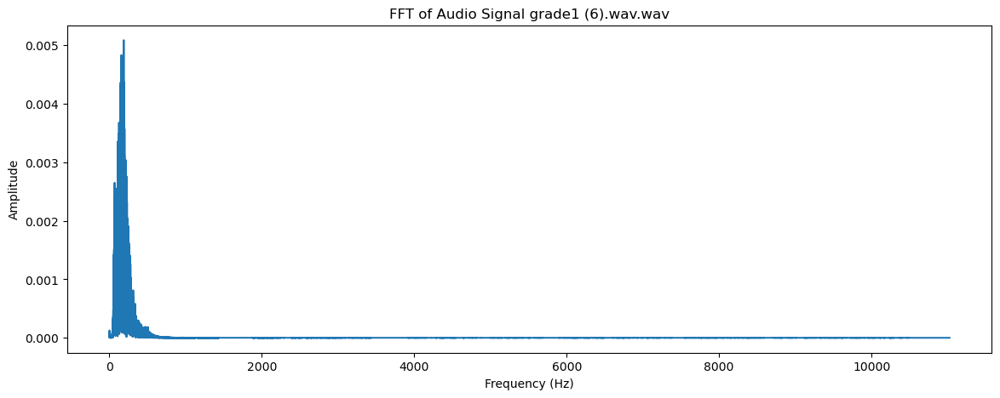

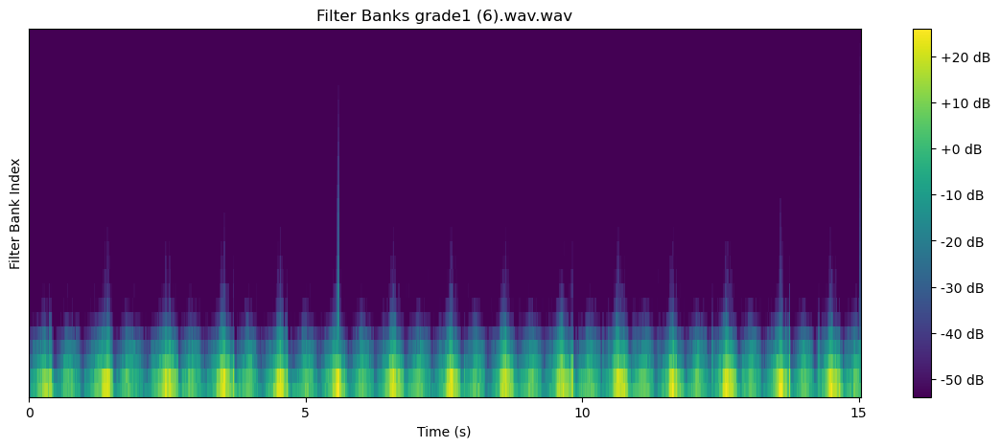

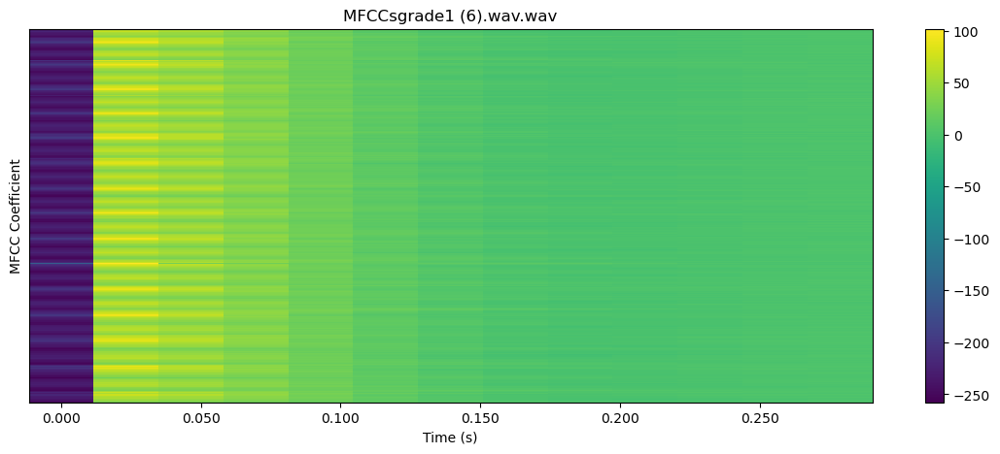

 23%|██▎       | 33/141 [01:10<03:29,  1.94s/it]

22050


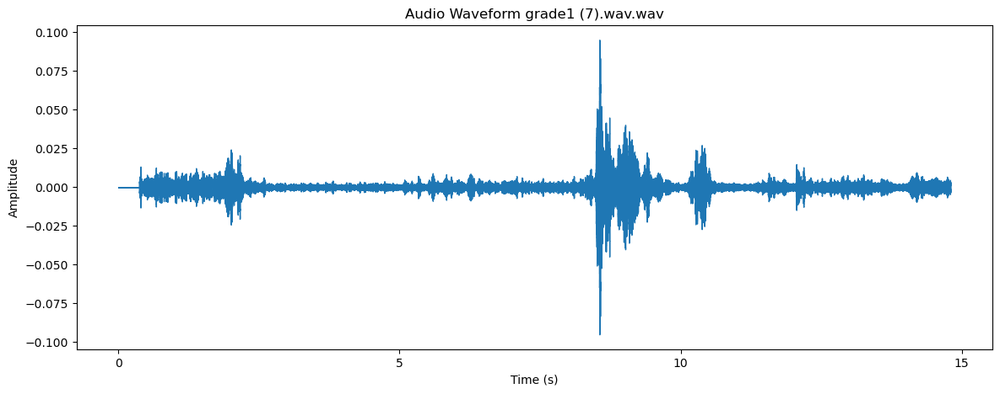

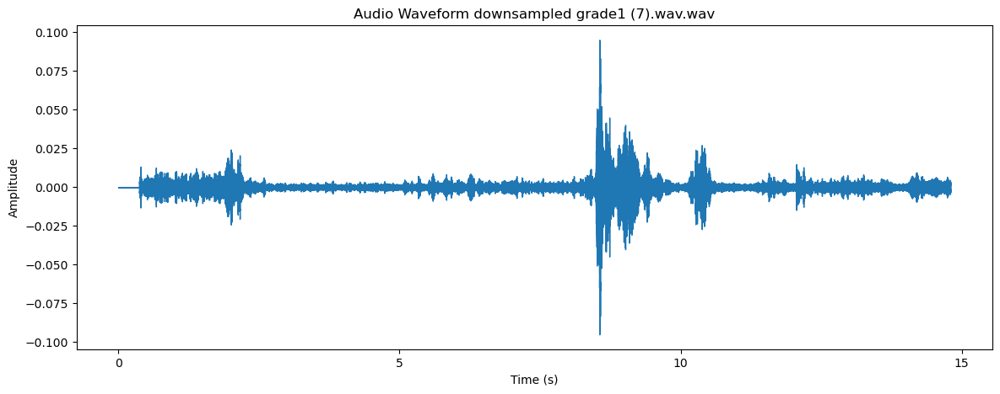

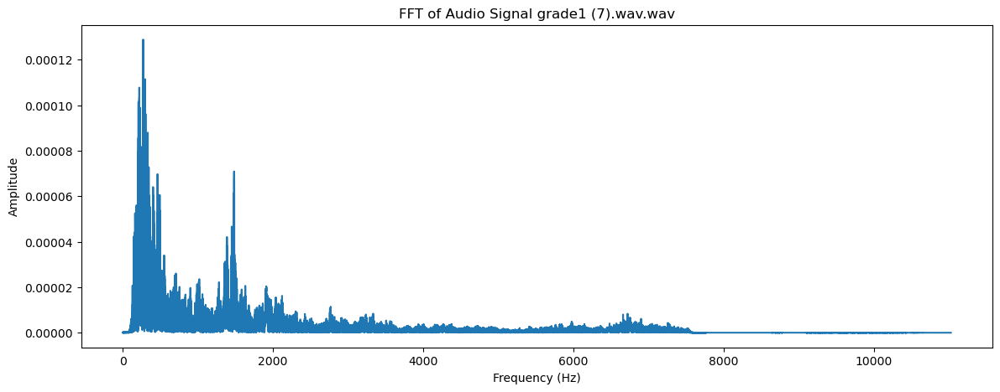

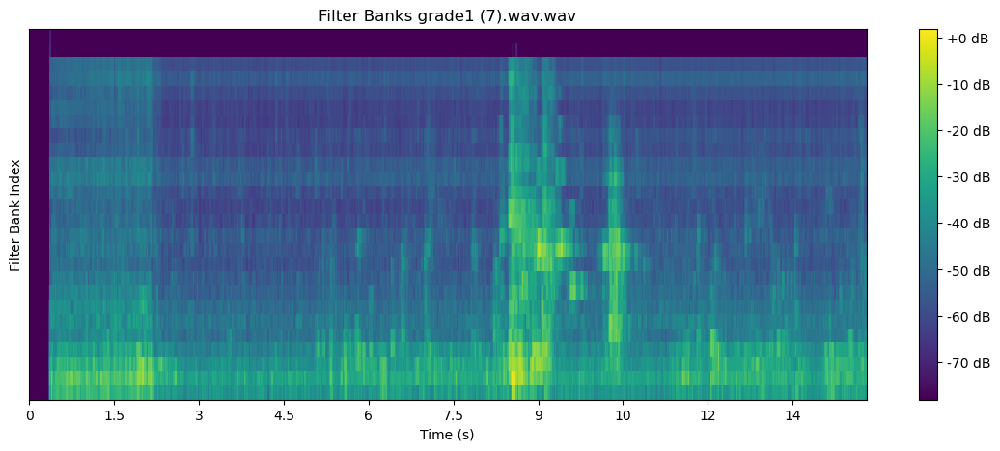

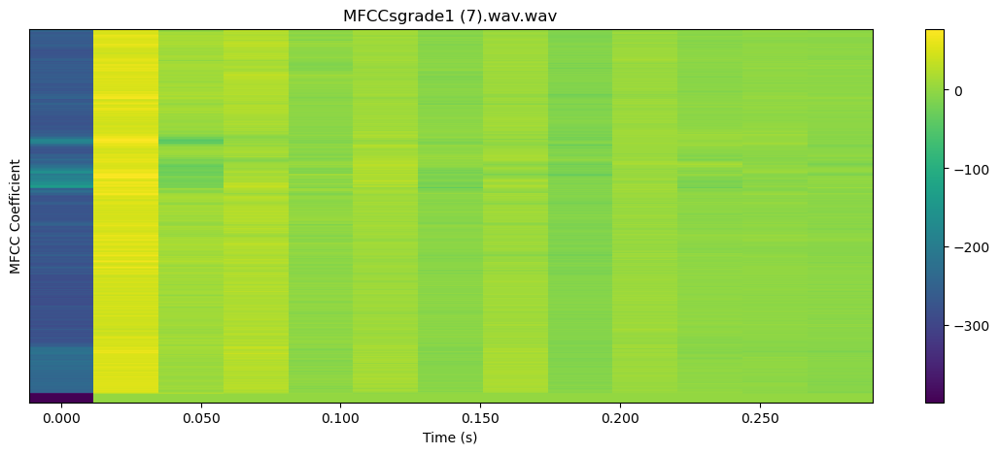

 24%|██▍       | 34/141 [01:13<03:36,  2.03s/it]

22050


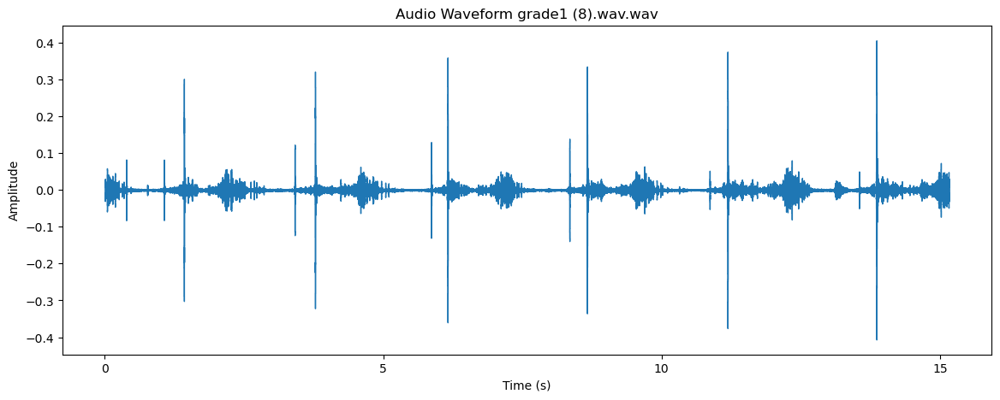

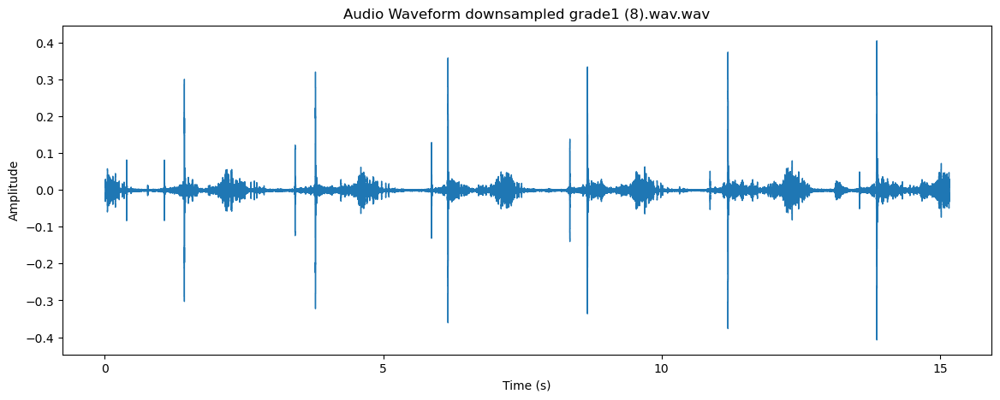

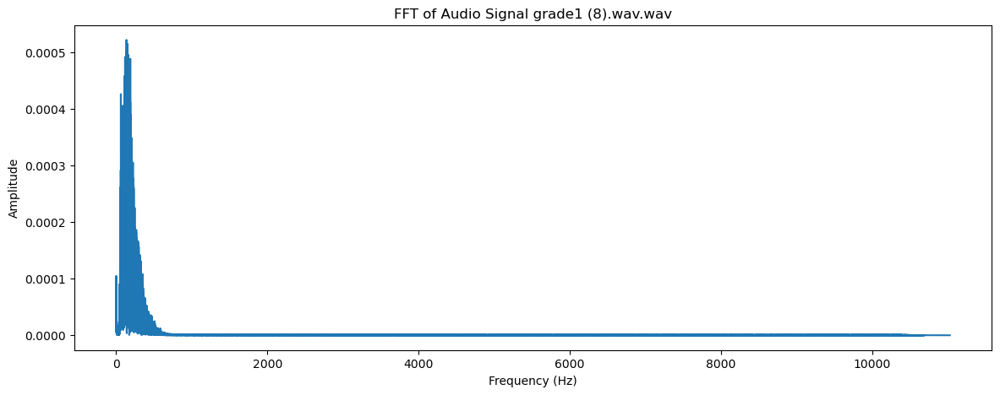

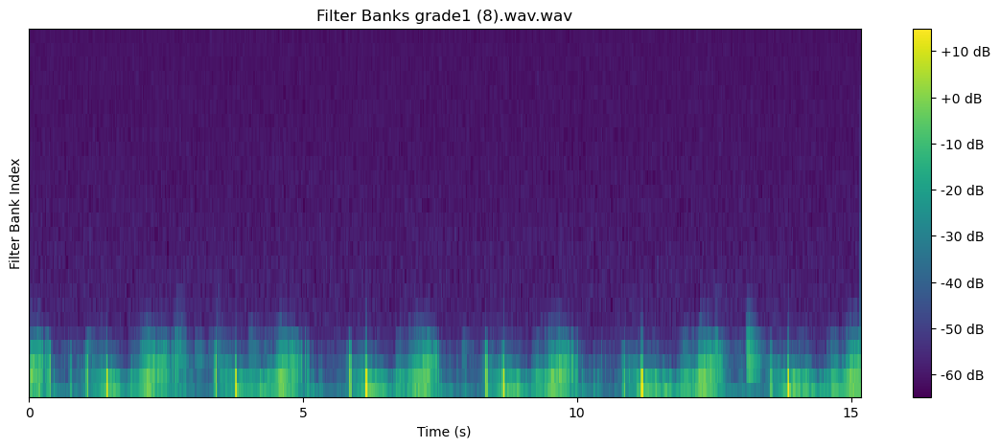

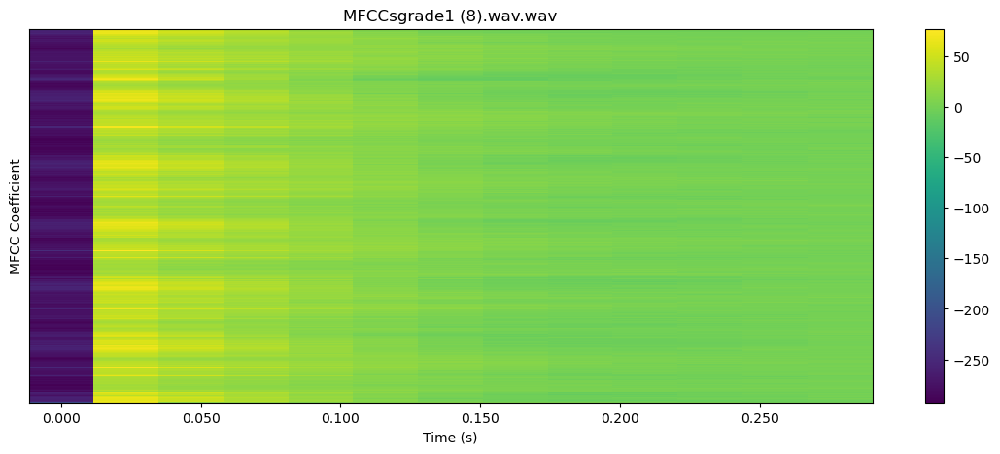

 25%|██▍       | 35/141 [01:15<03:39,  2.07s/it]

22050


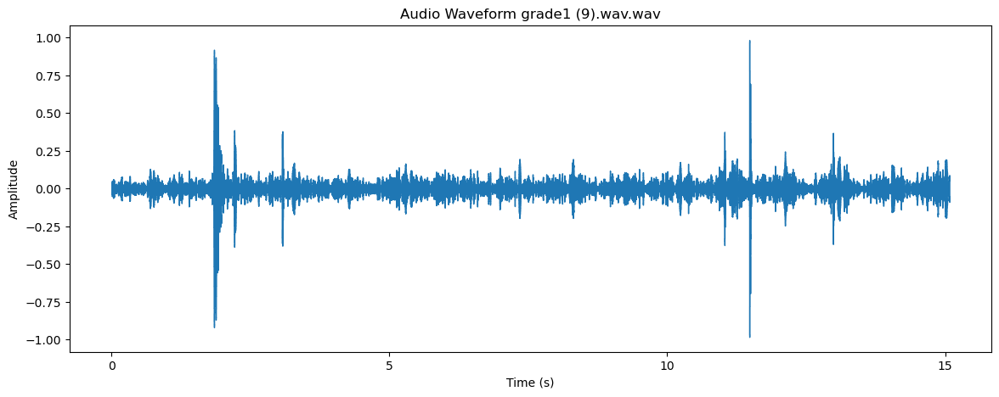

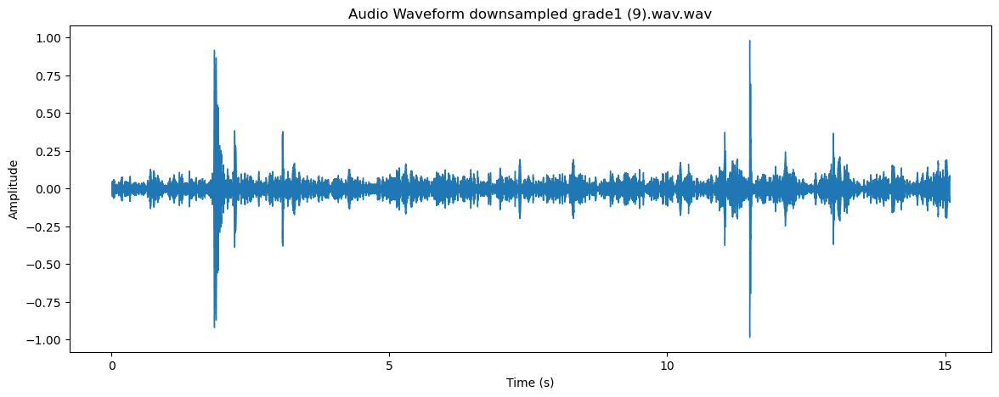

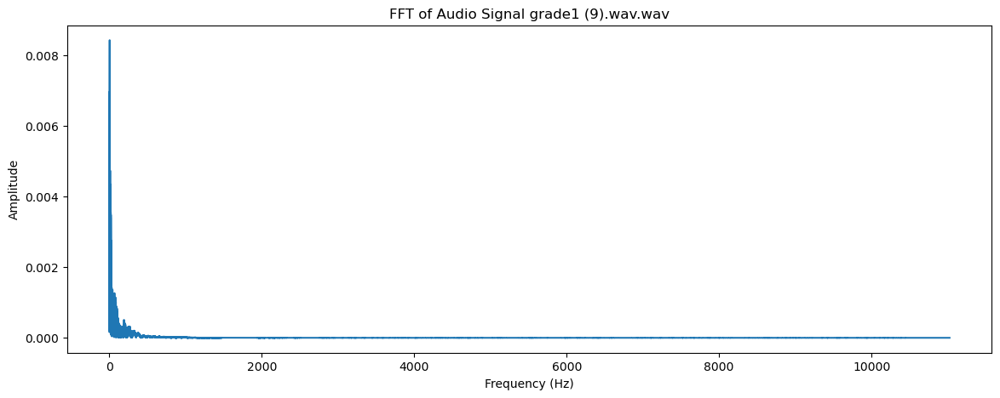

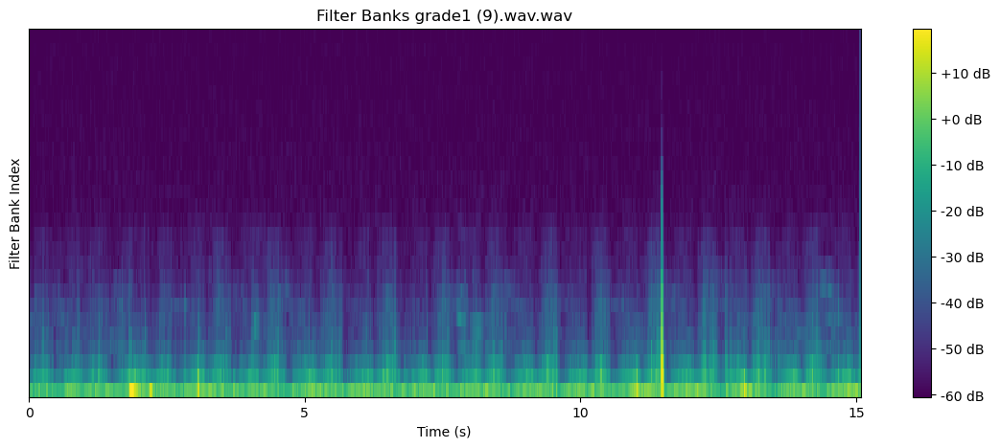

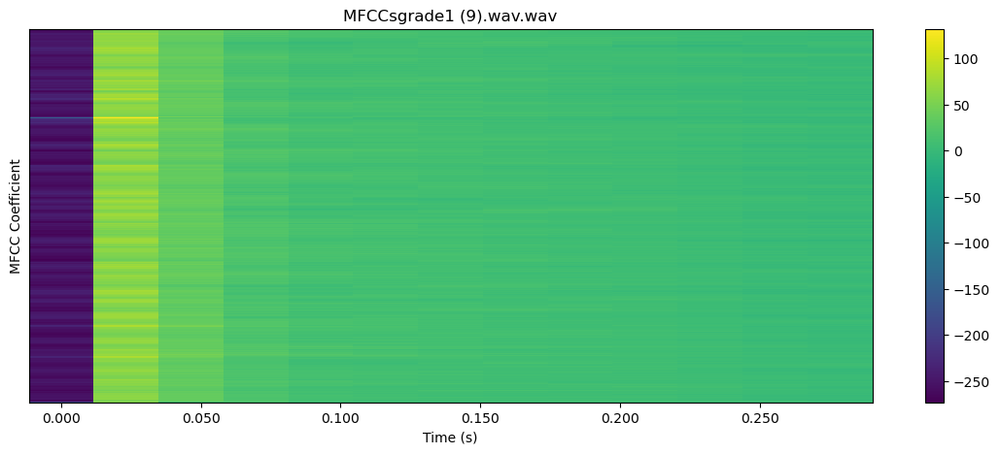

 26%|██▌       | 36/141 [01:16<03:21,  1.91s/it]

22050


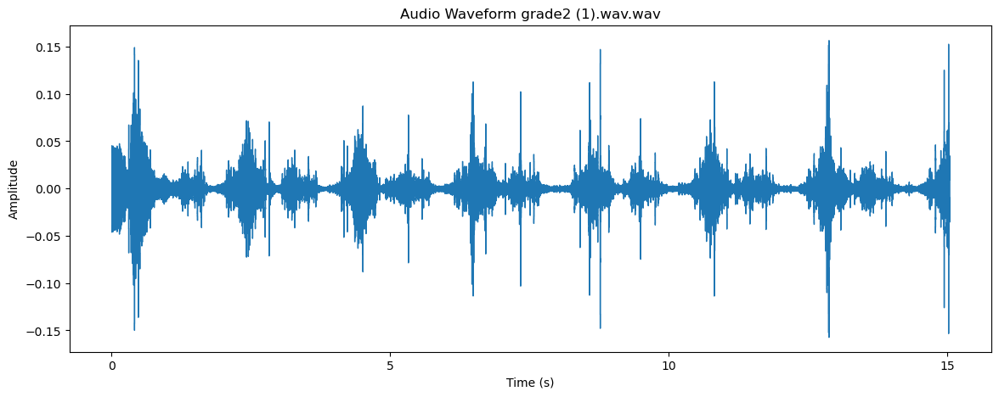

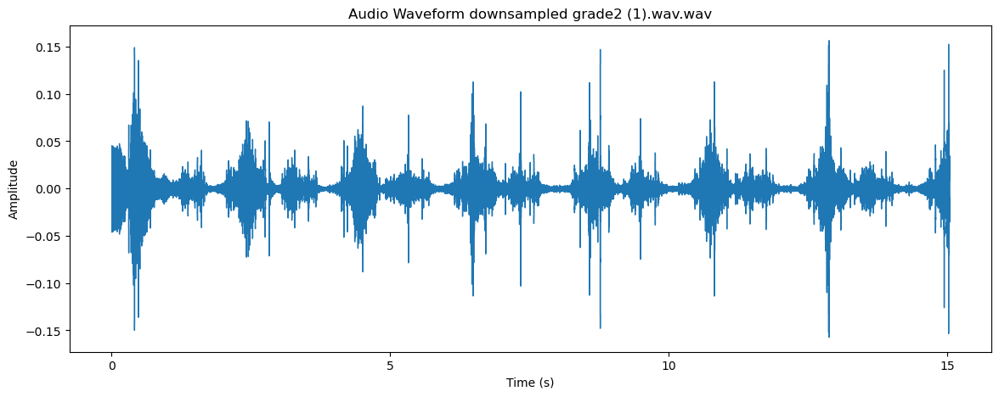

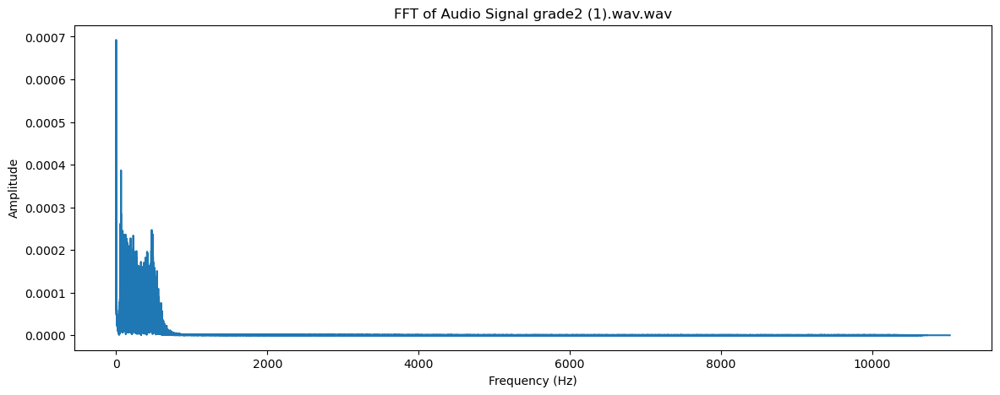

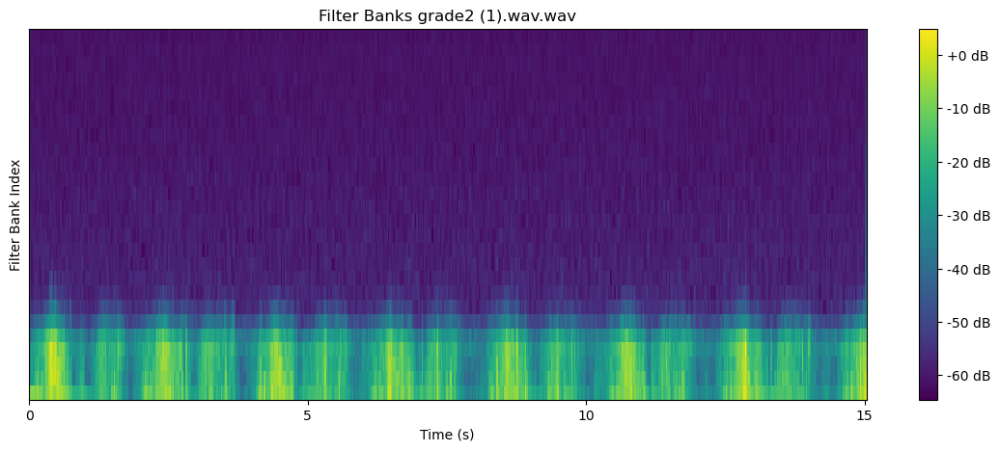

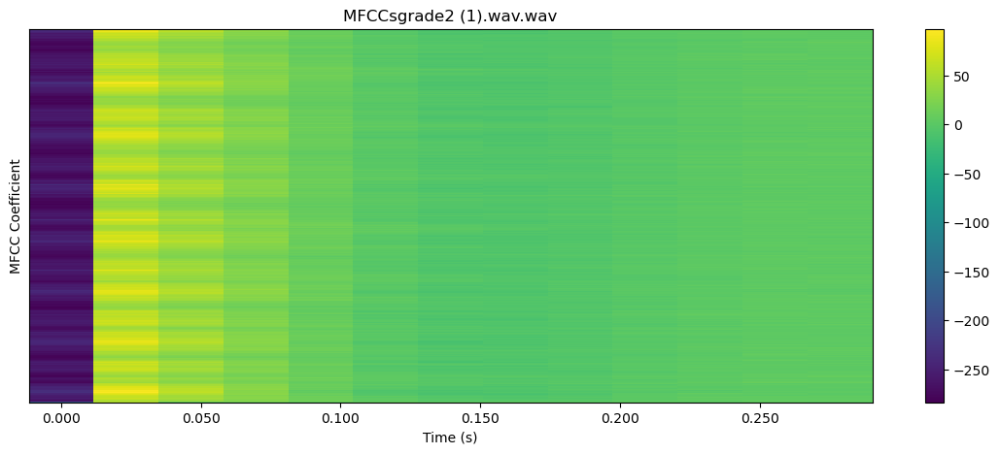

 26%|██▌       | 37/141 [01:18<03:07,  1.80s/it]

22050


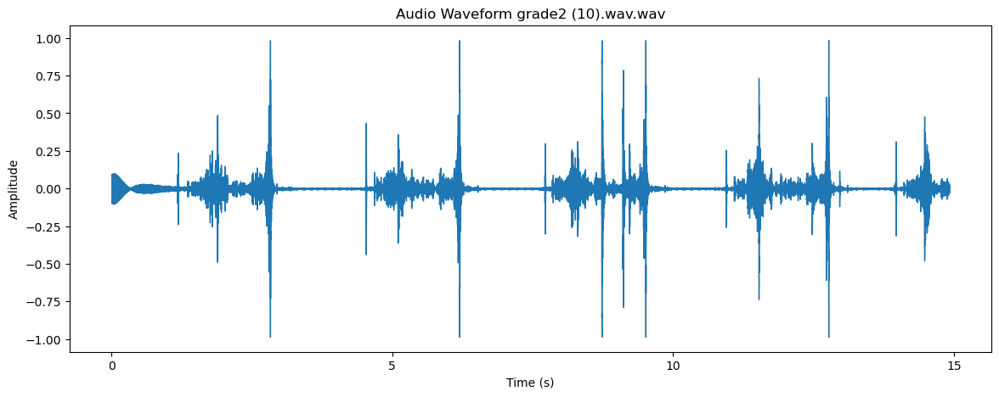

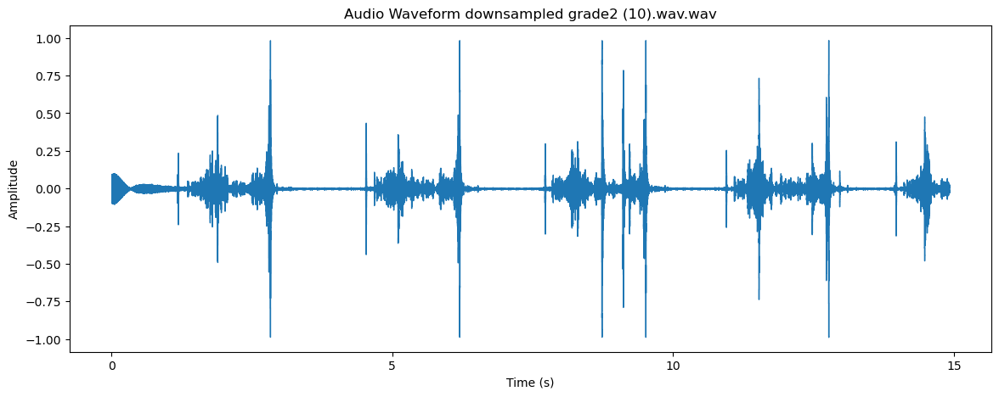

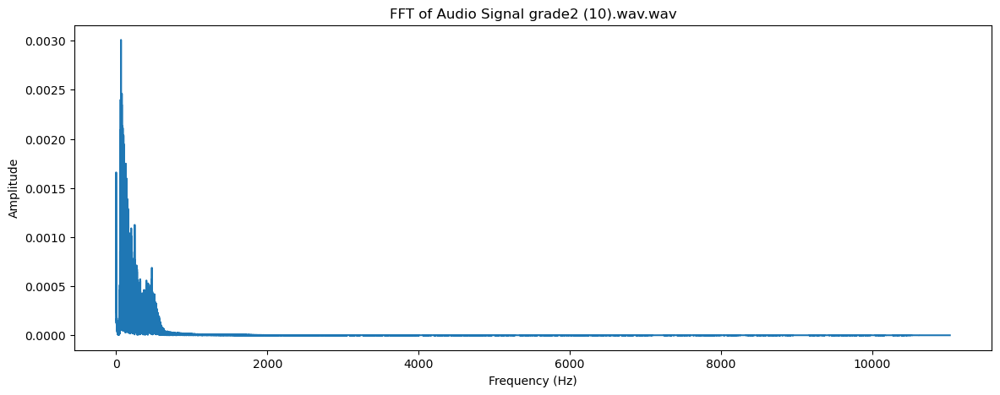

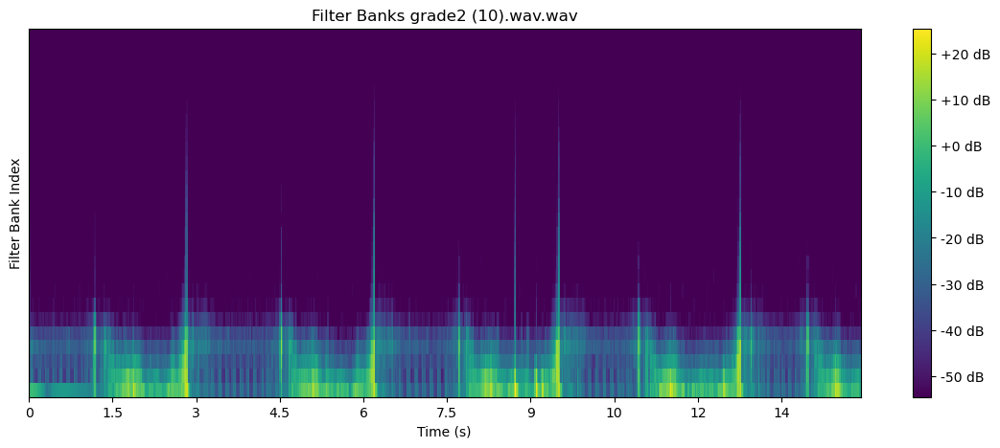

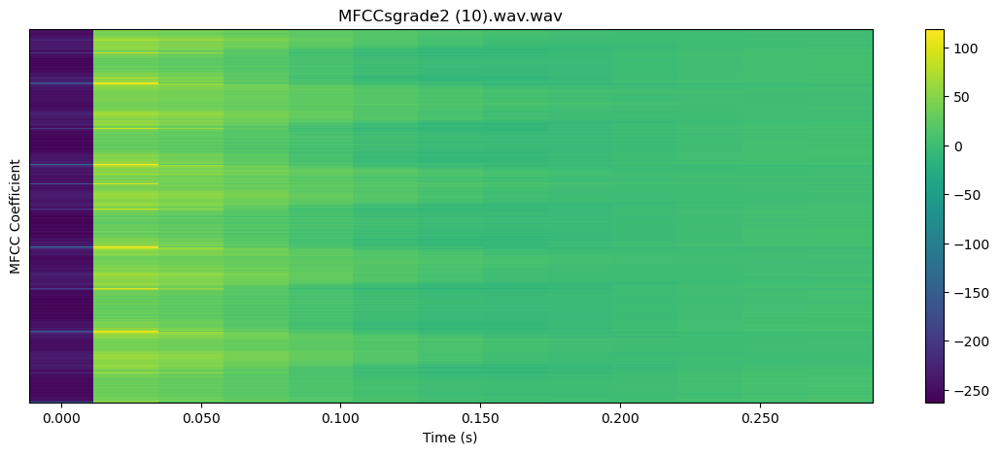

 27%|██▋       | 38/141 [01:19<02:57,  1.72s/it]

22050


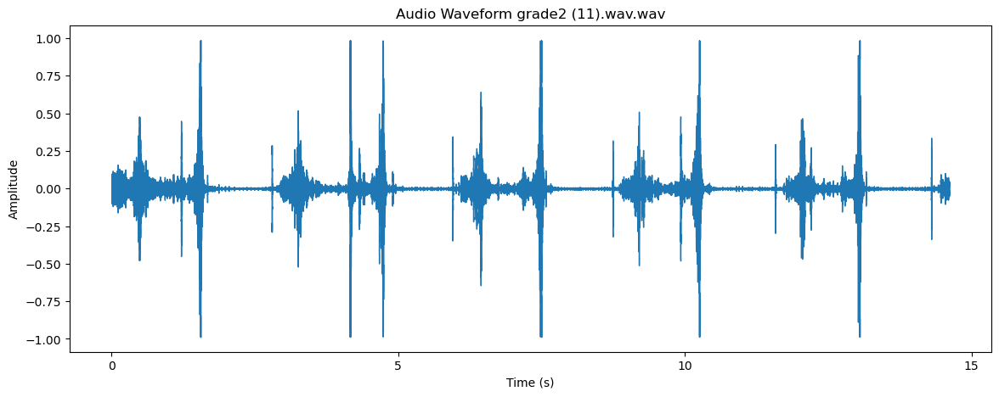

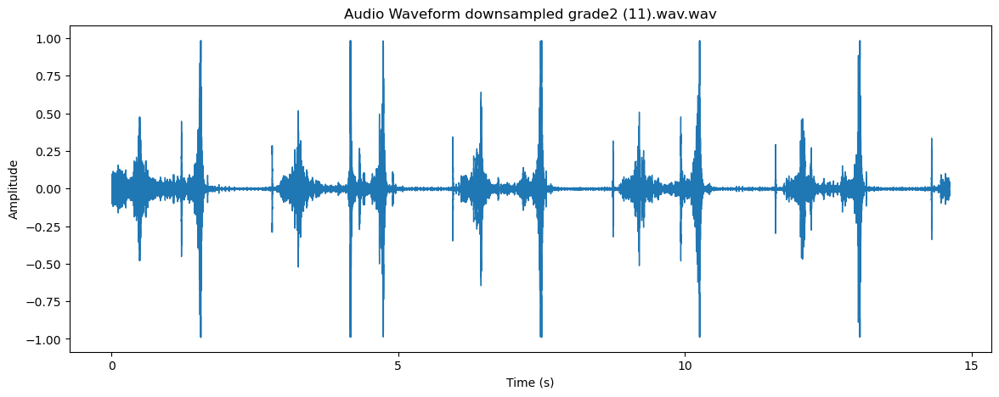

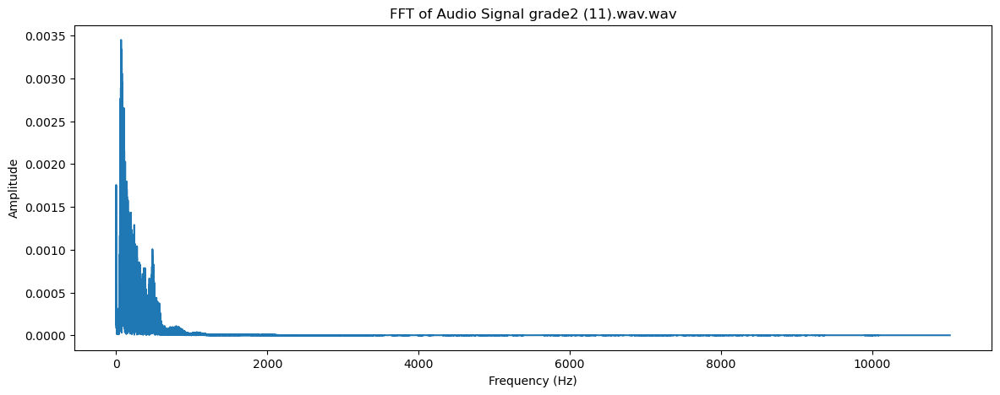

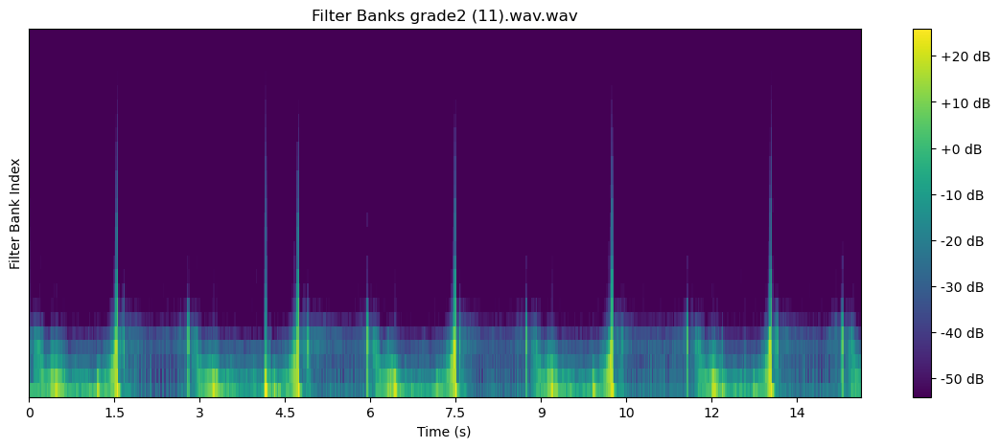

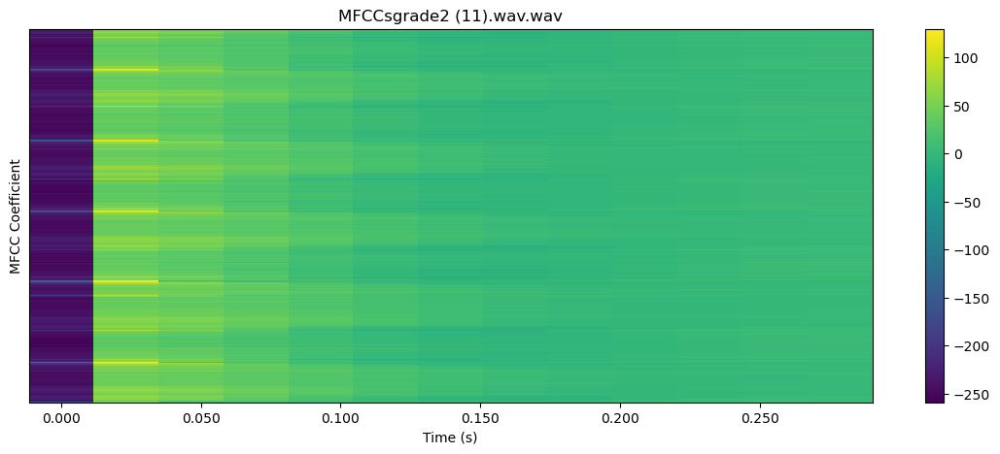

 28%|██▊       | 39/141 [01:21<02:50,  1.67s/it]

22050


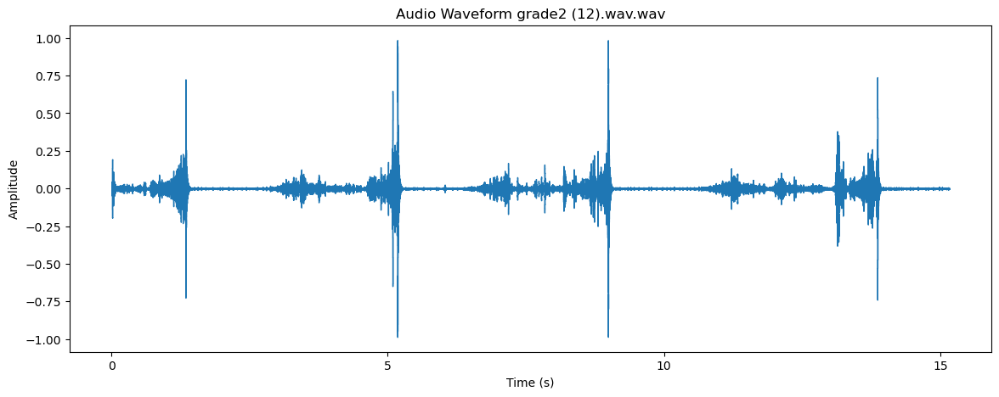

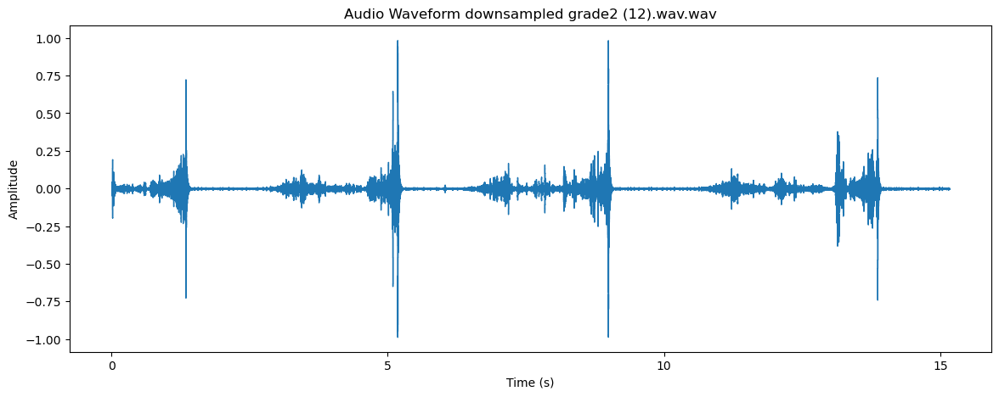

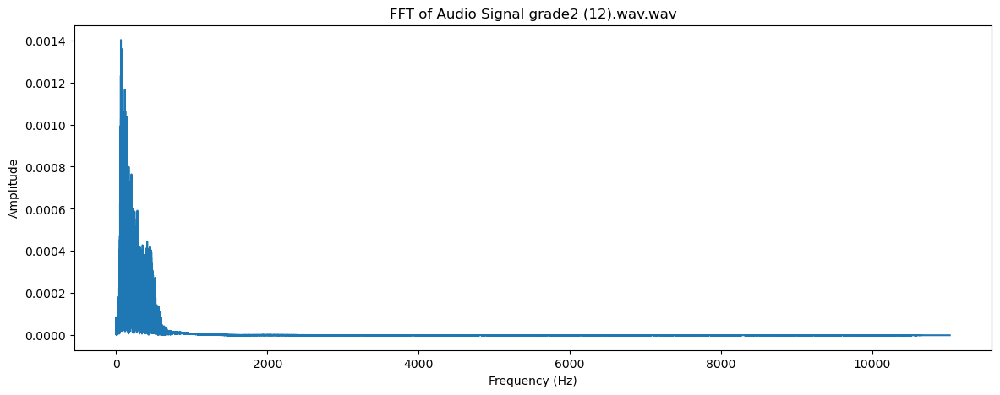

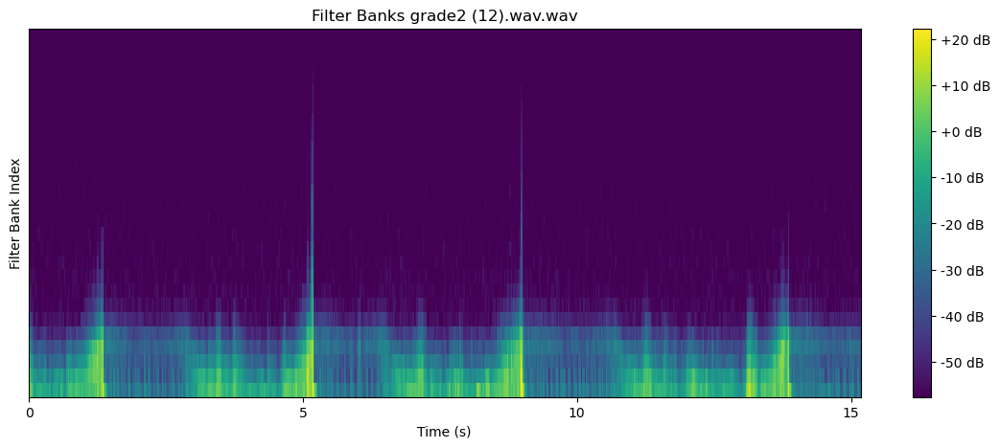

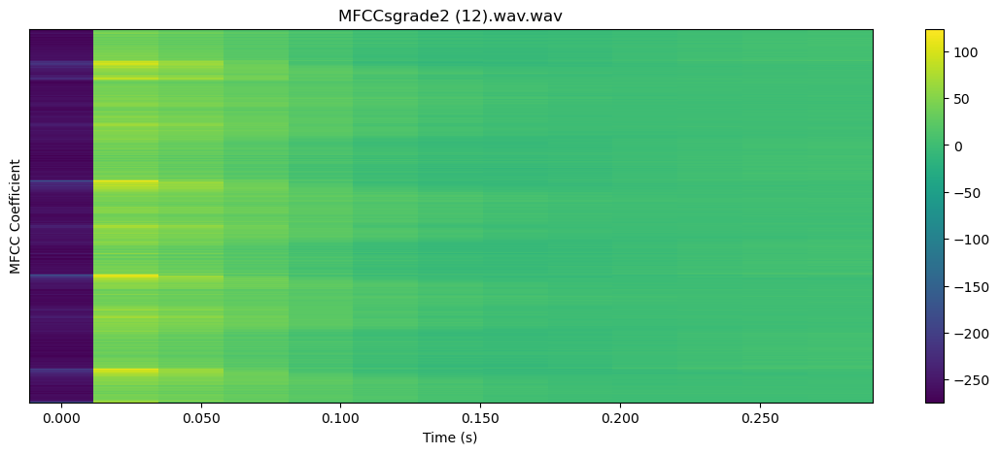

 28%|██▊       | 40/141 [01:22<02:46,  1.65s/it]

22050


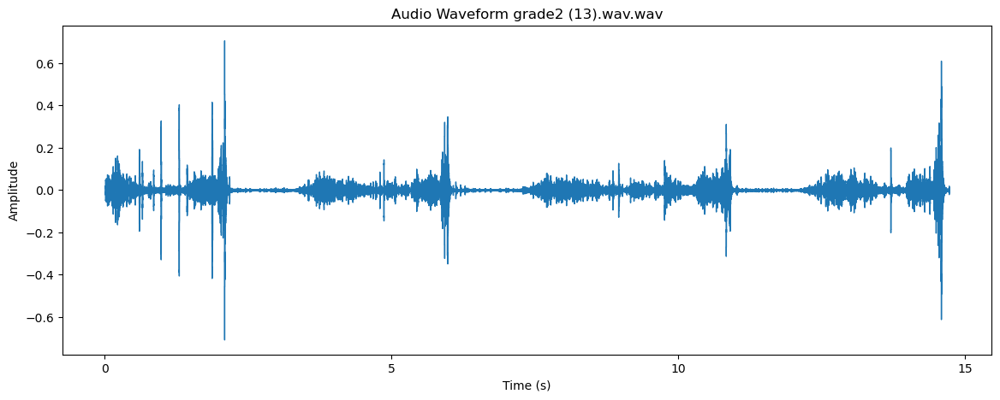

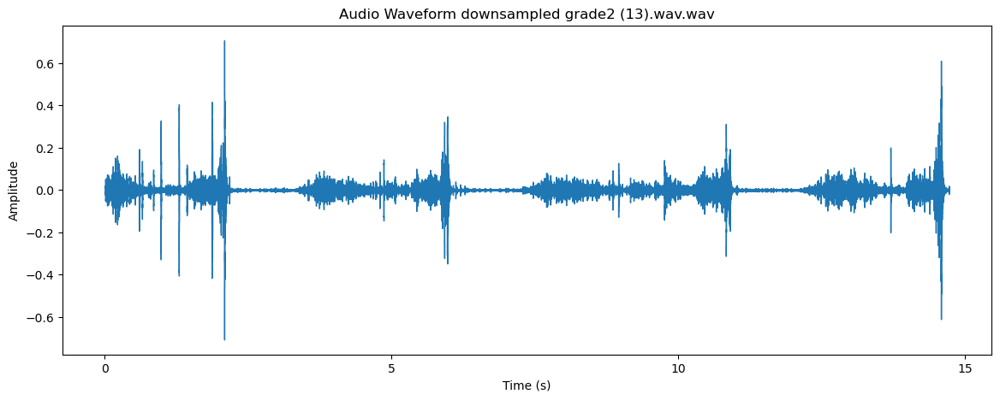

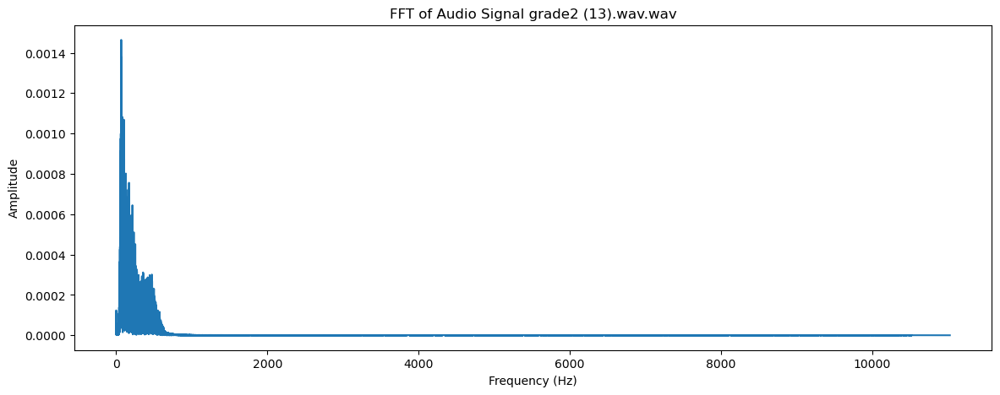

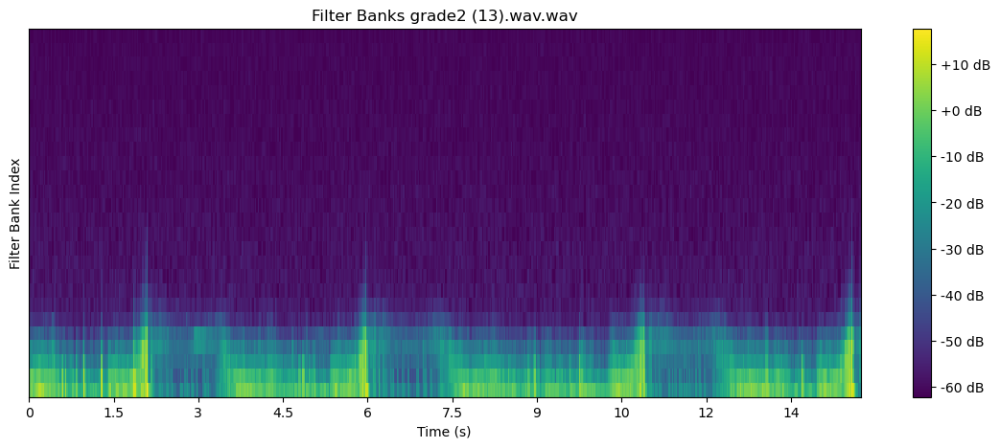

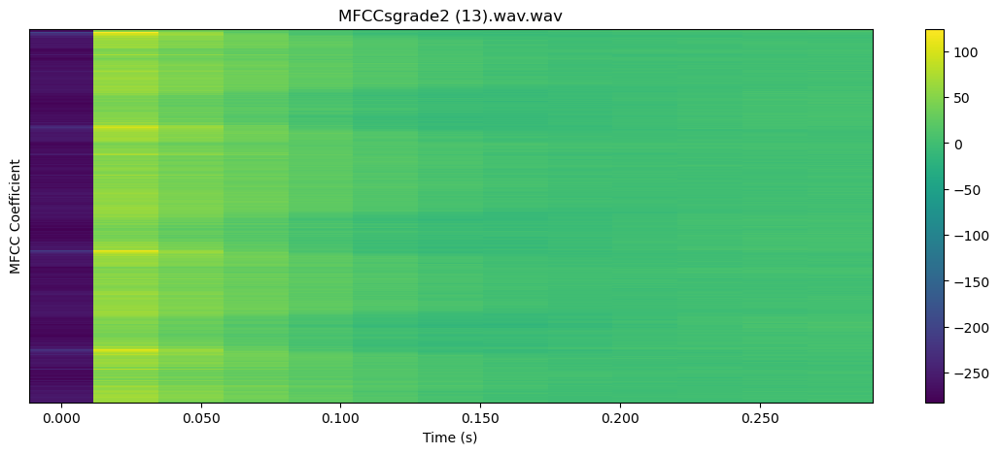

 29%|██▉       | 41/141 [01:24<02:51,  1.71s/it]

22050


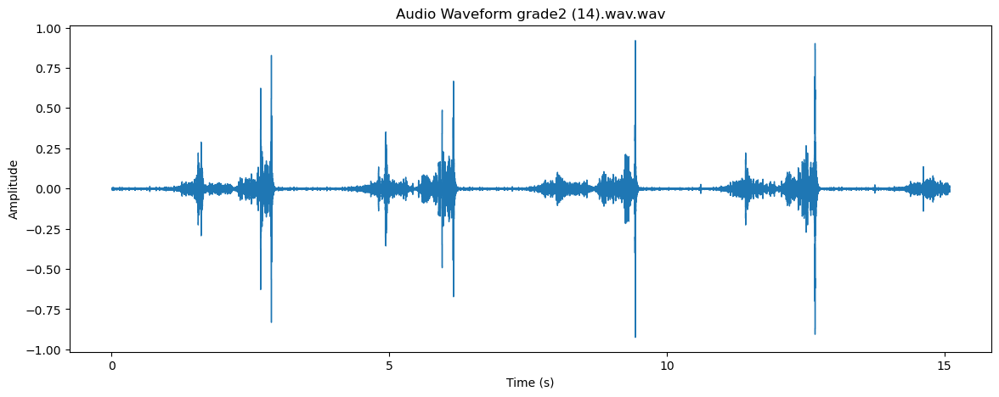

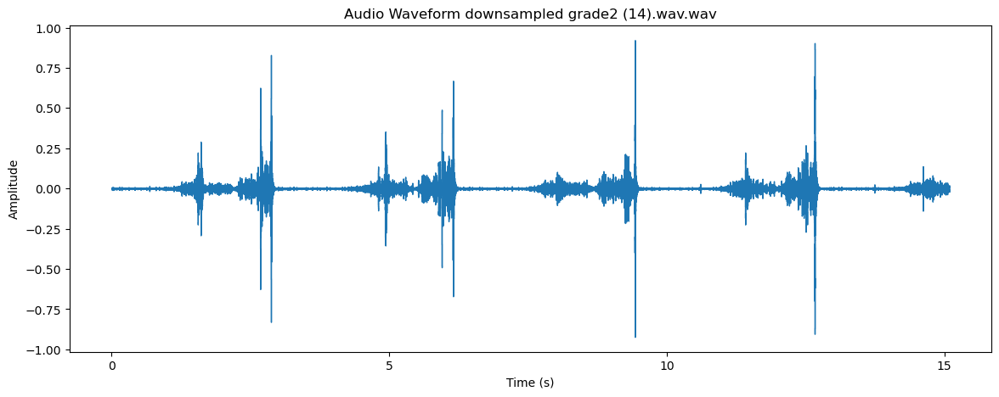

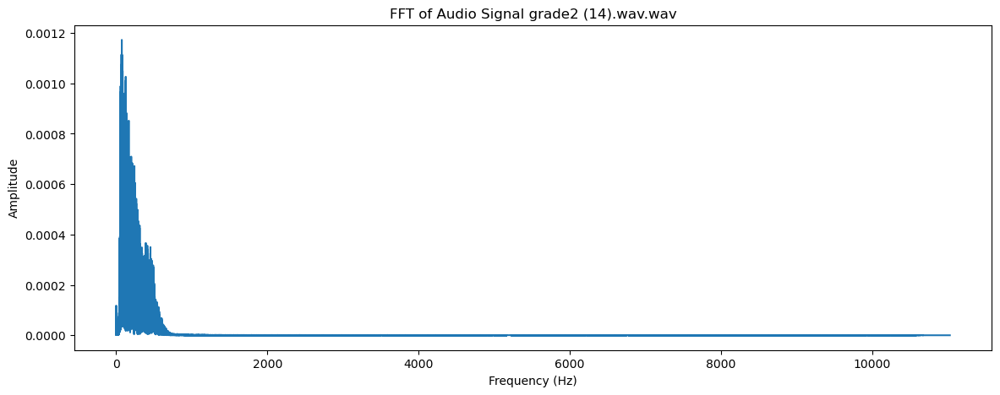

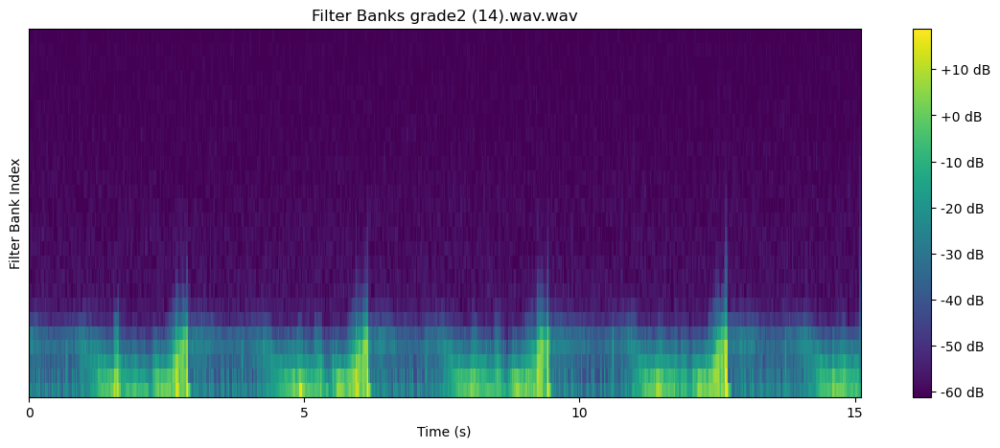

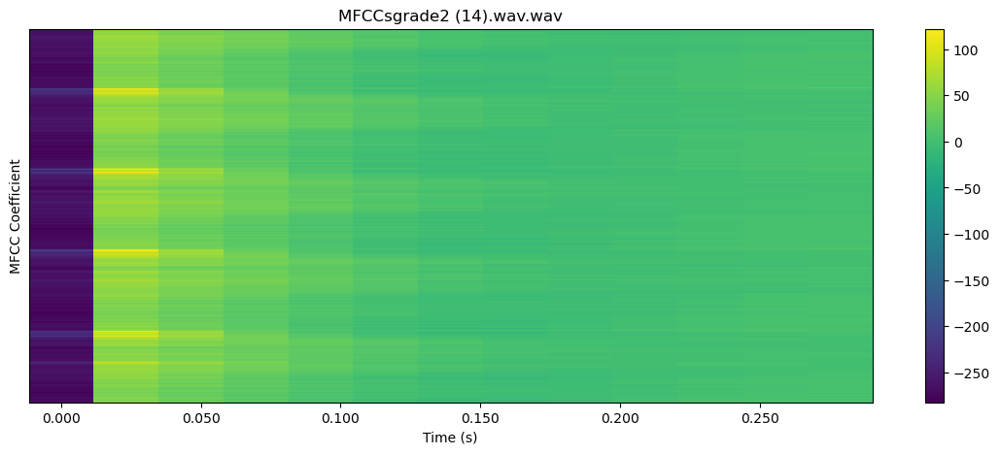

 30%|██▉       | 42/141 [01:26<02:56,  1.79s/it]

22050


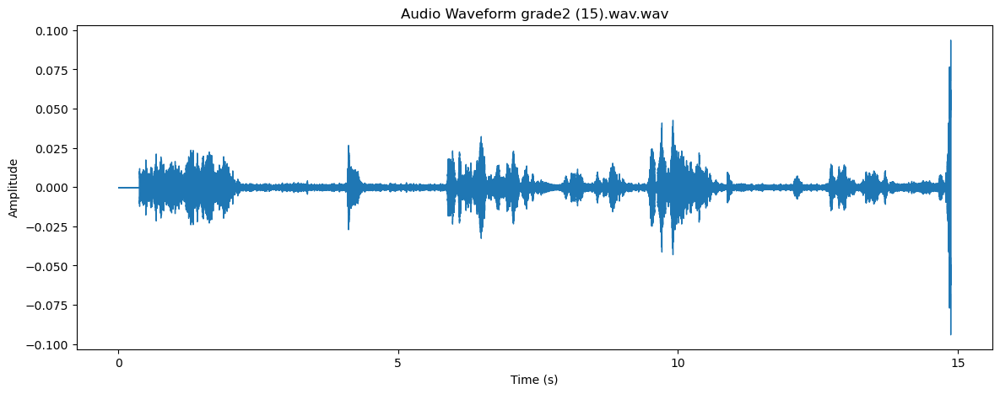

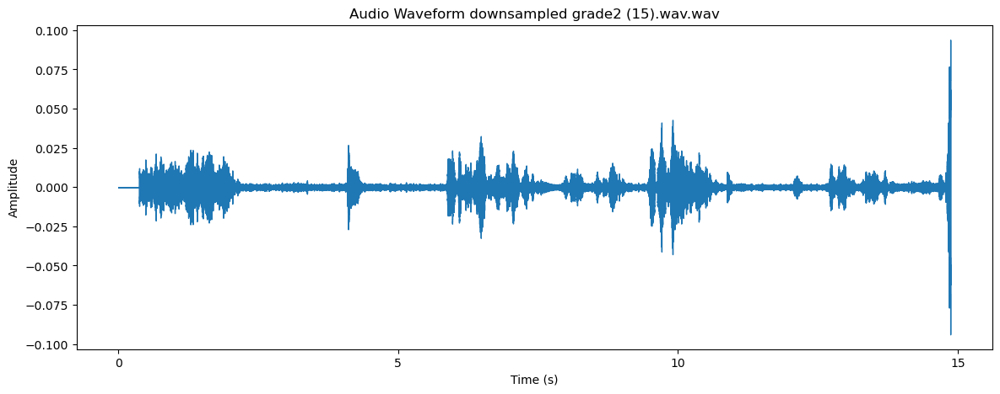

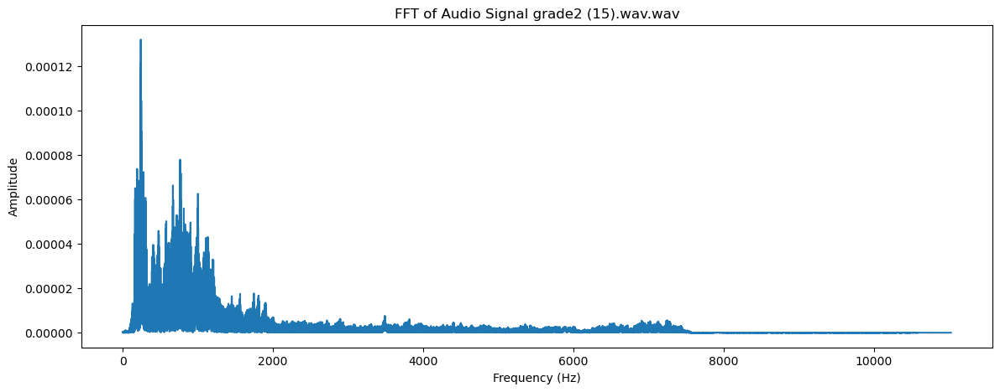

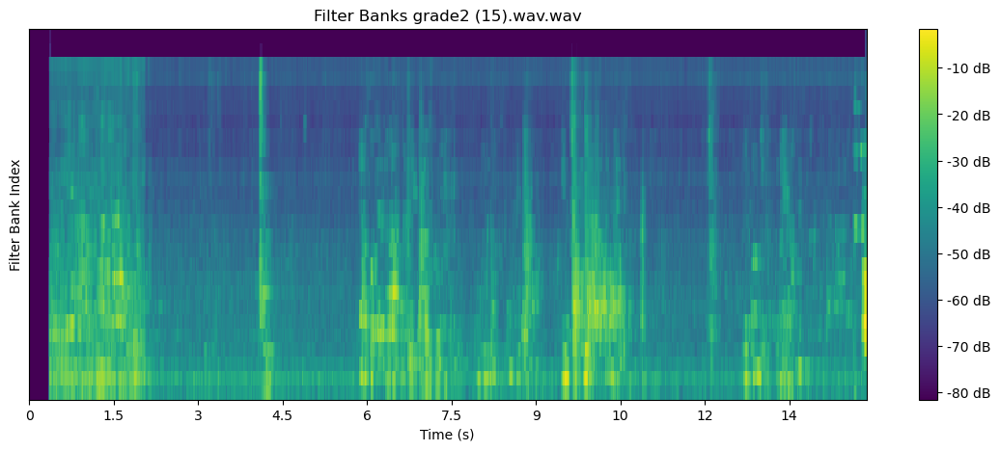

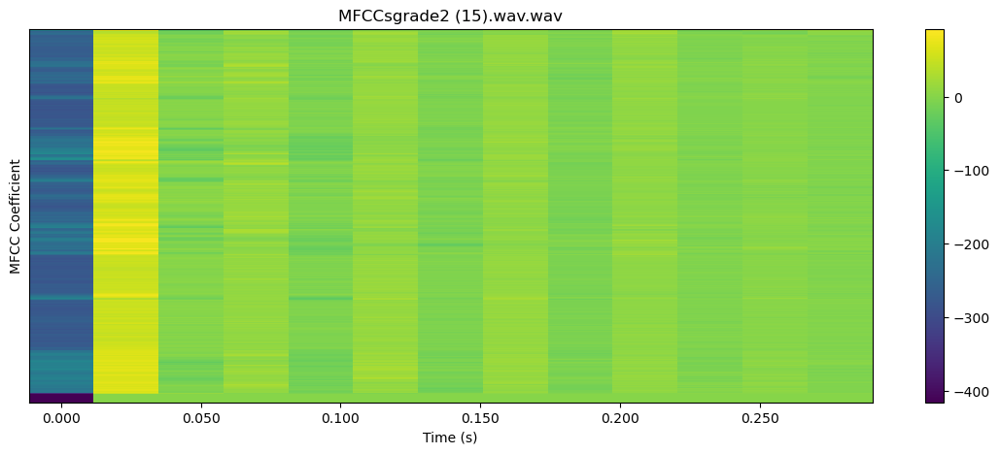

 30%|███       | 43/141 [01:29<03:10,  1.94s/it]

22050


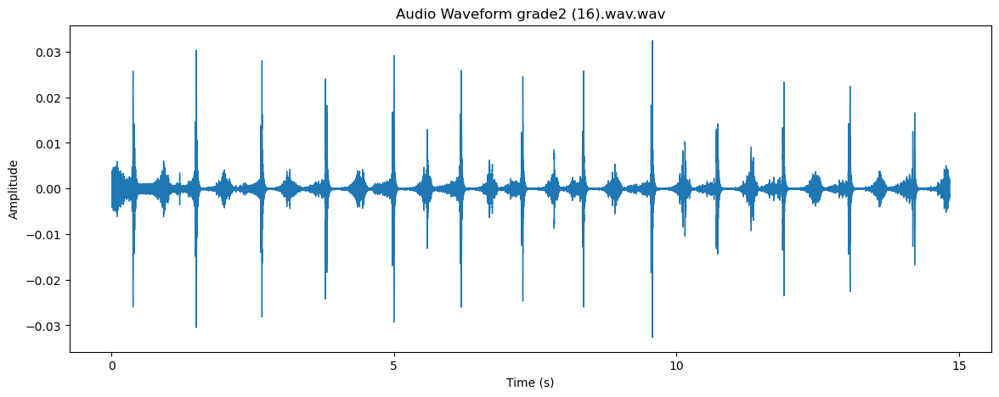

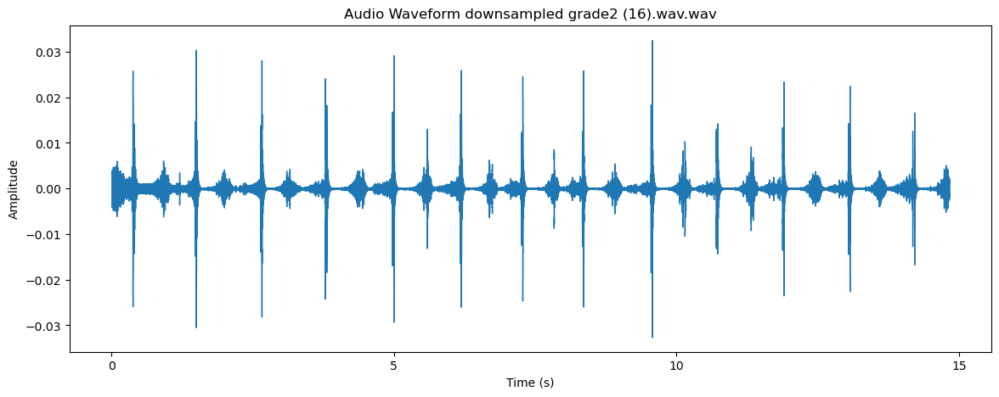

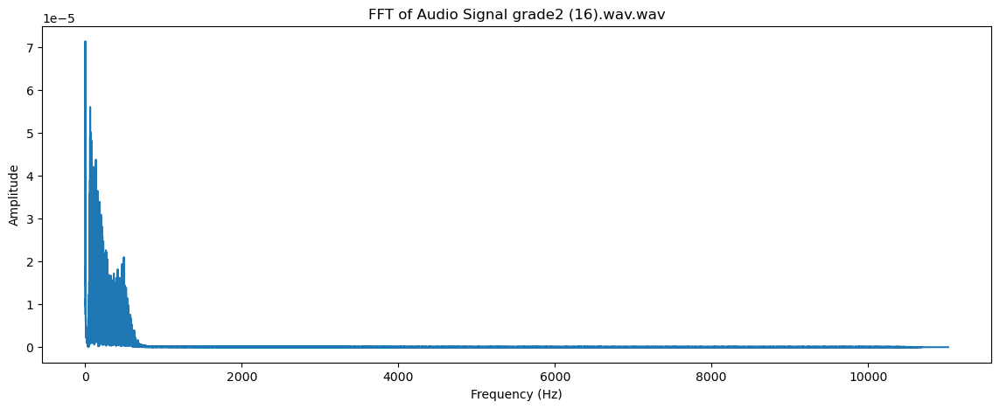

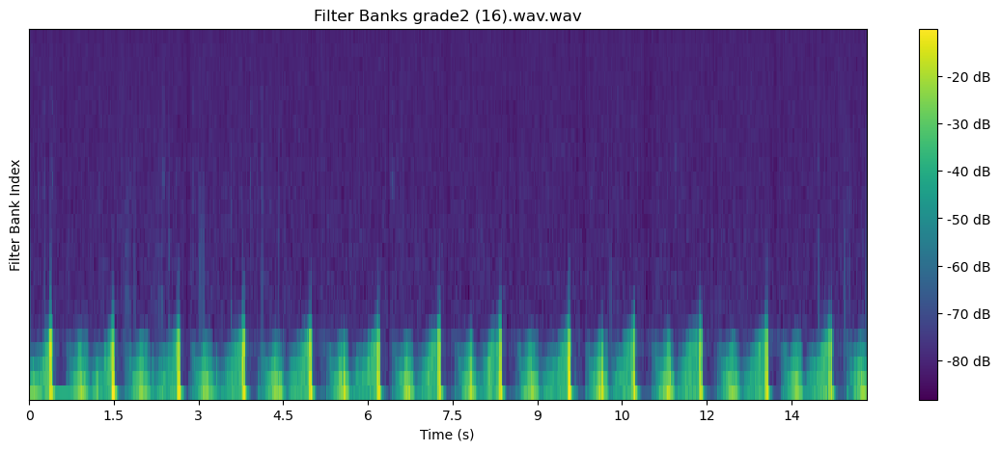

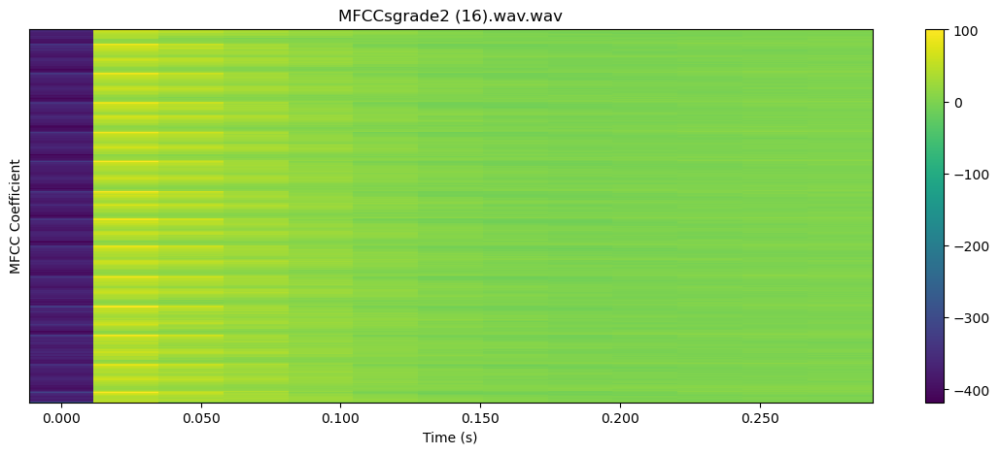

 31%|███       | 44/141 [01:31<03:20,  2.07s/it]

22050


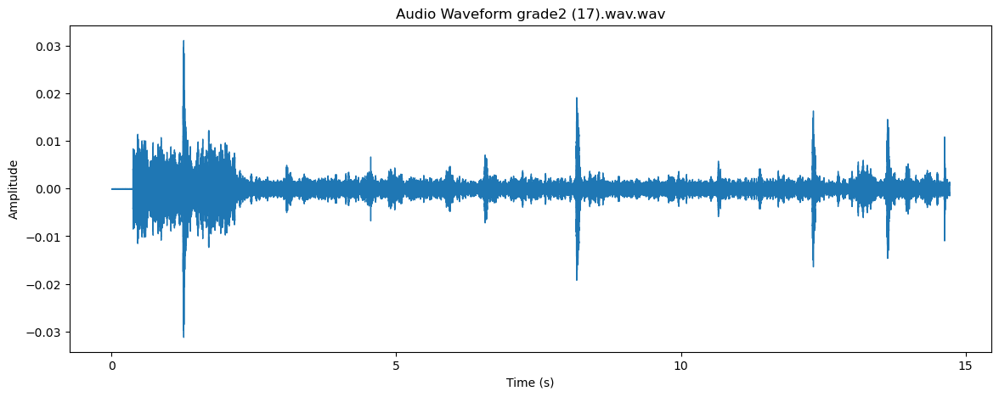

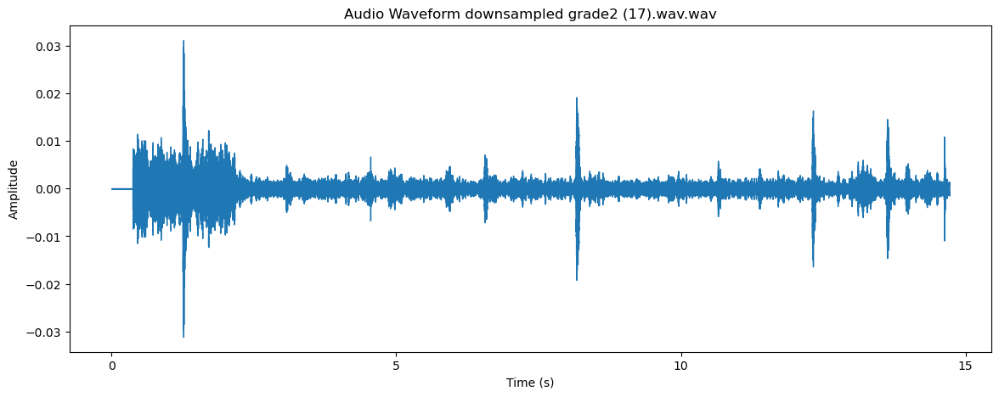

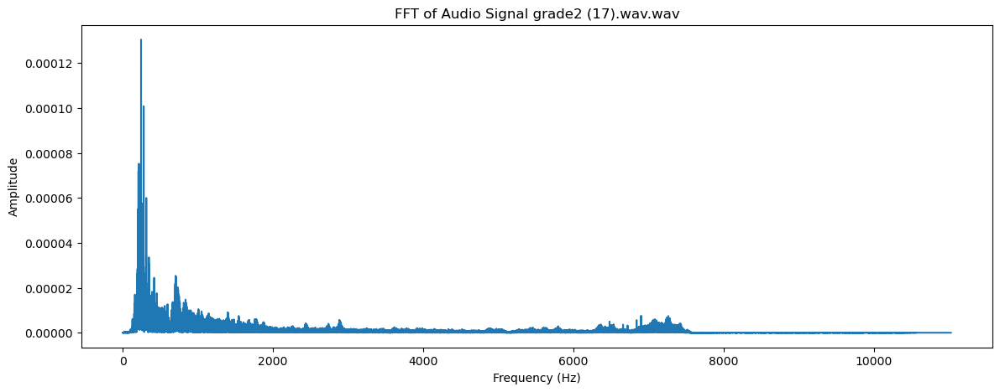

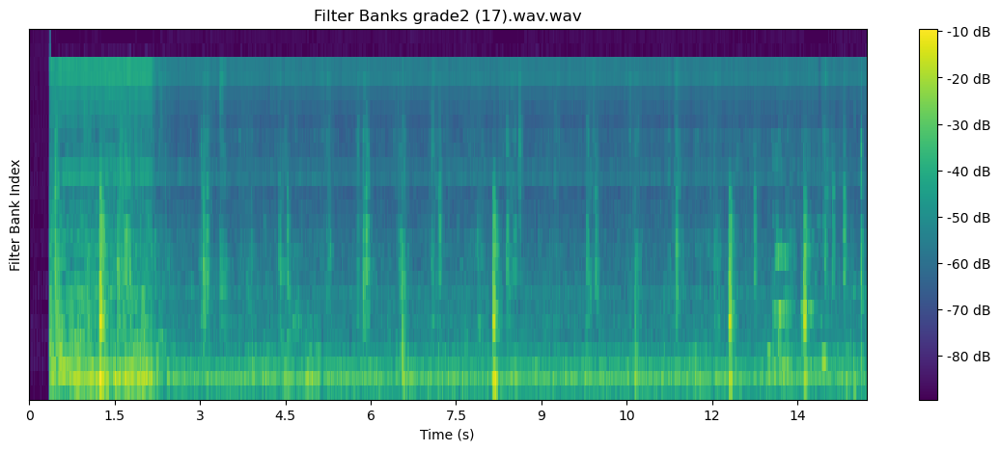

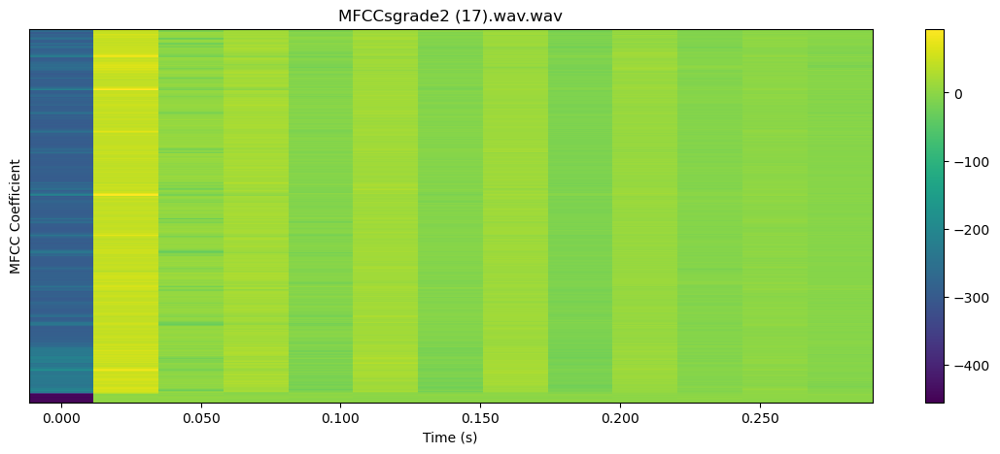

 32%|███▏      | 45/141 [01:33<03:05,  1.94s/it]

22050


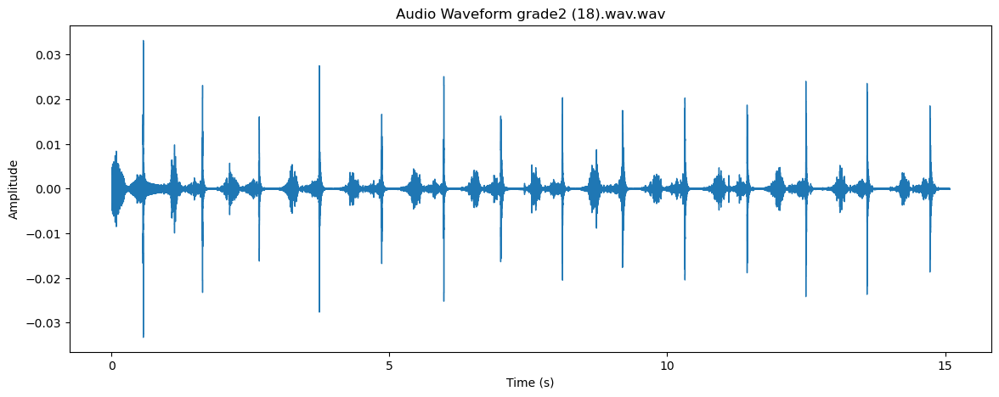

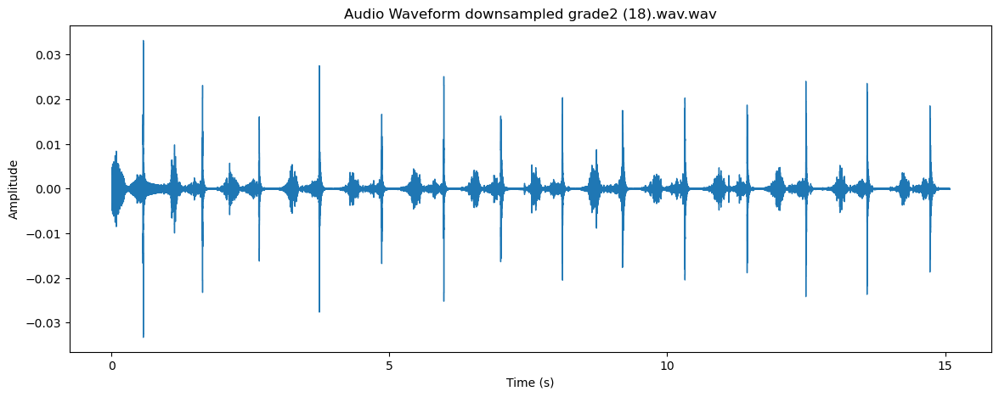

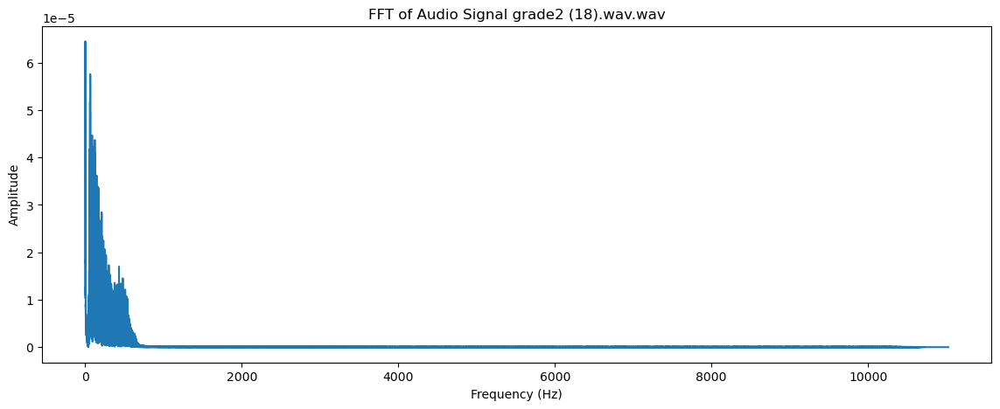

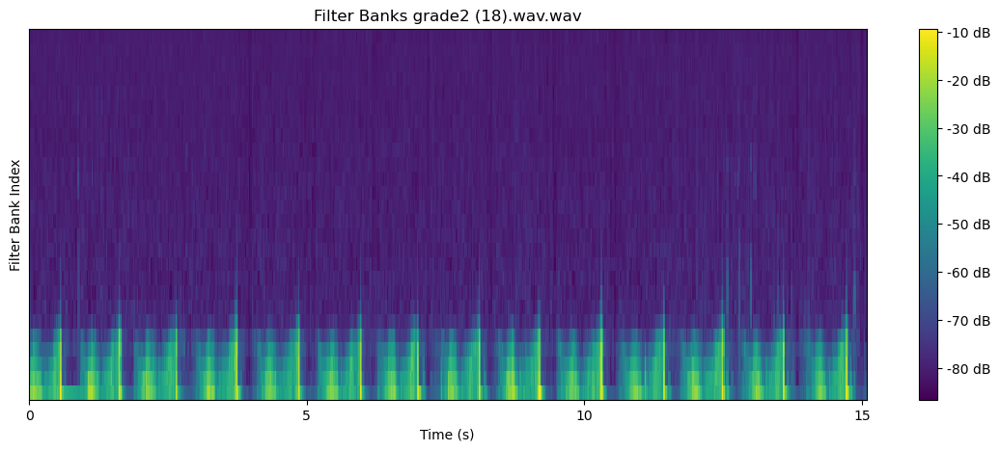

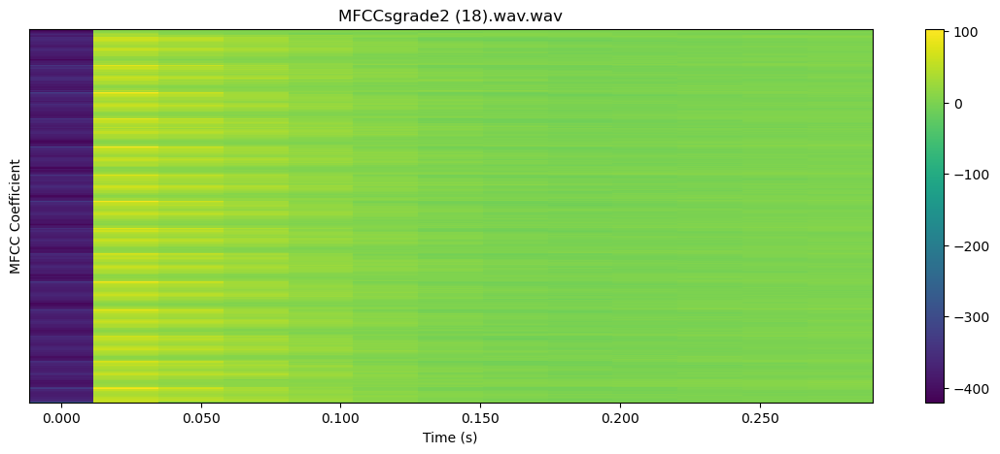

 33%|███▎      | 46/141 [01:34<02:53,  1.82s/it]

22050


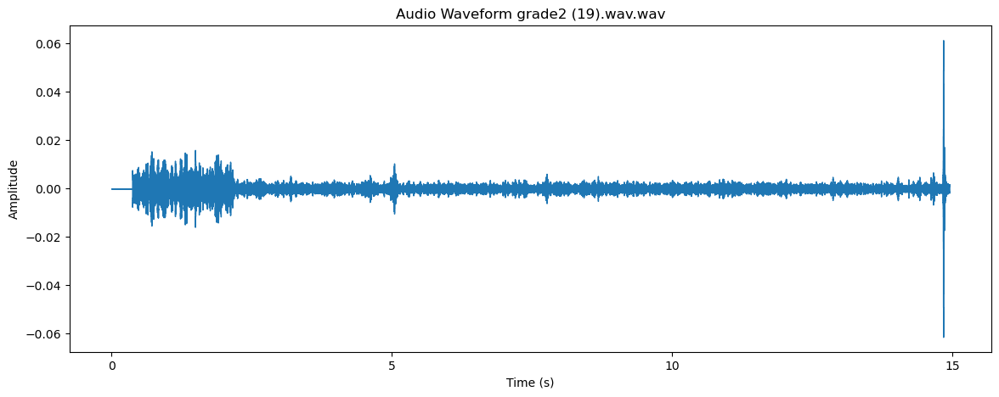

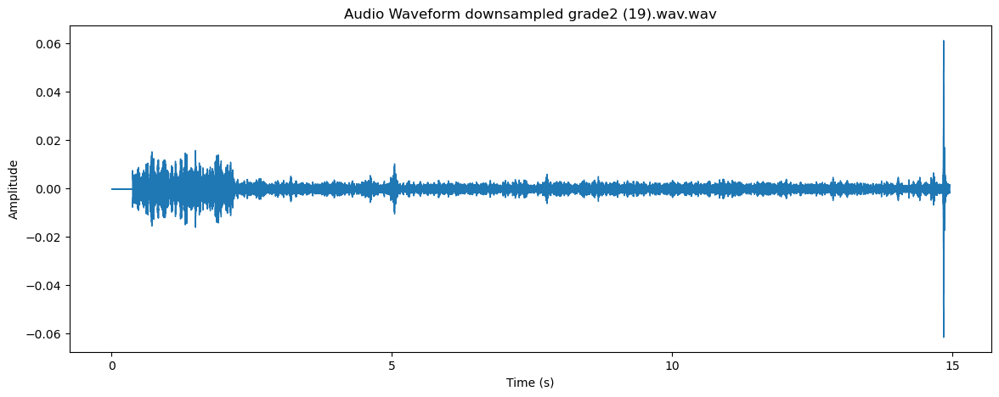

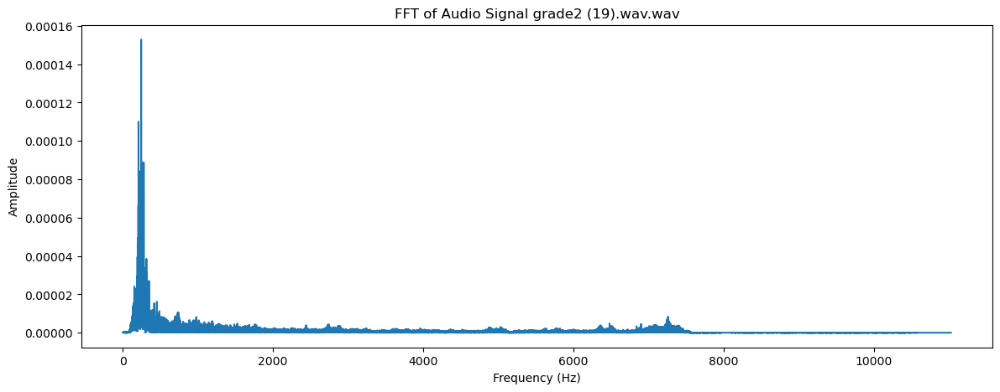

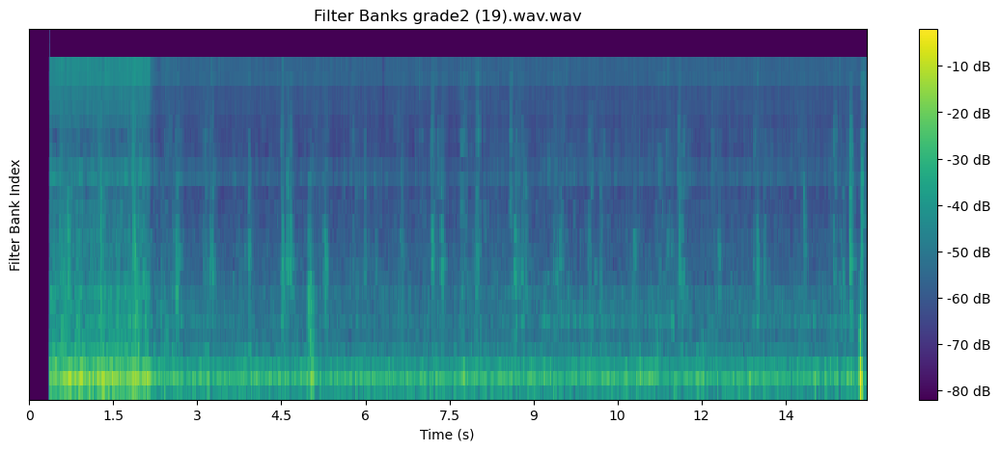

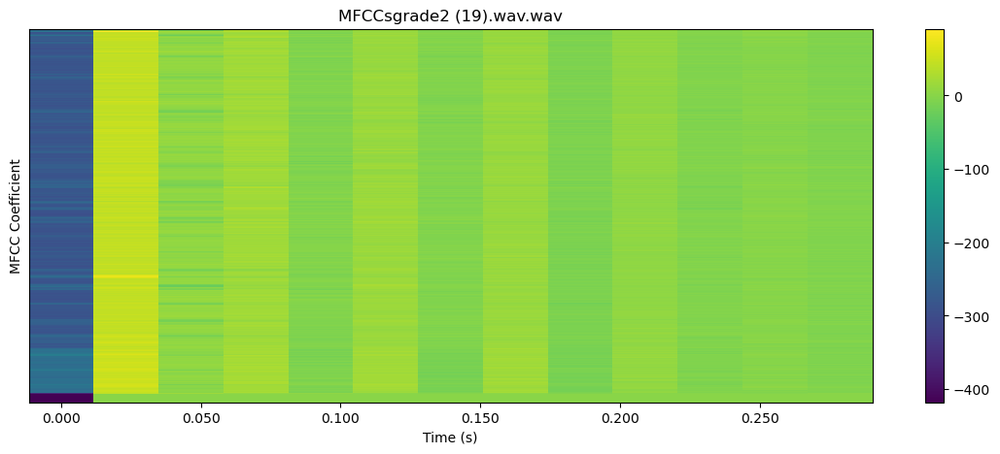

 33%|███▎      | 47/141 [01:36<02:39,  1.70s/it]

22050


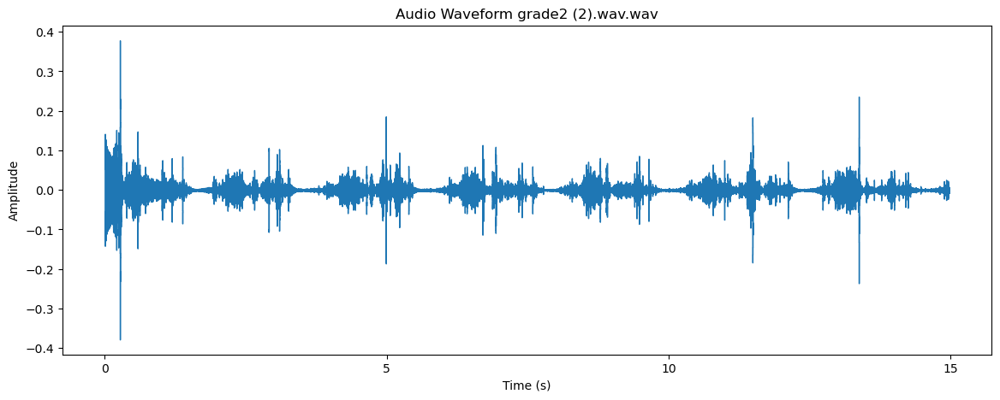

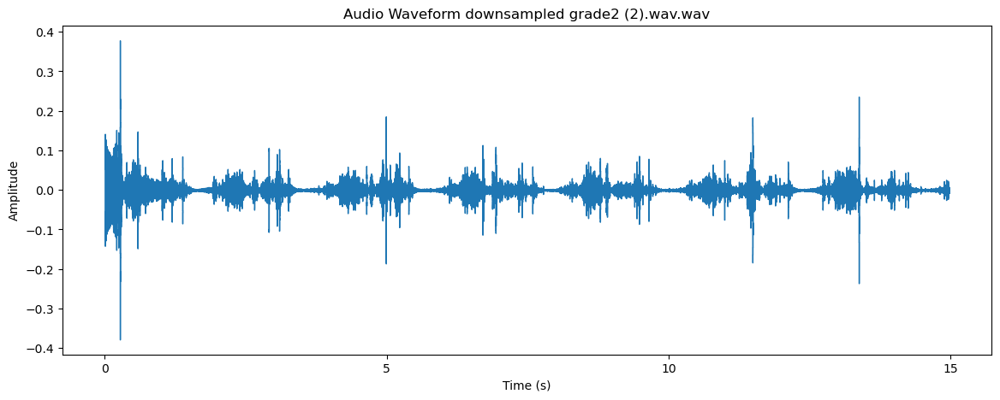

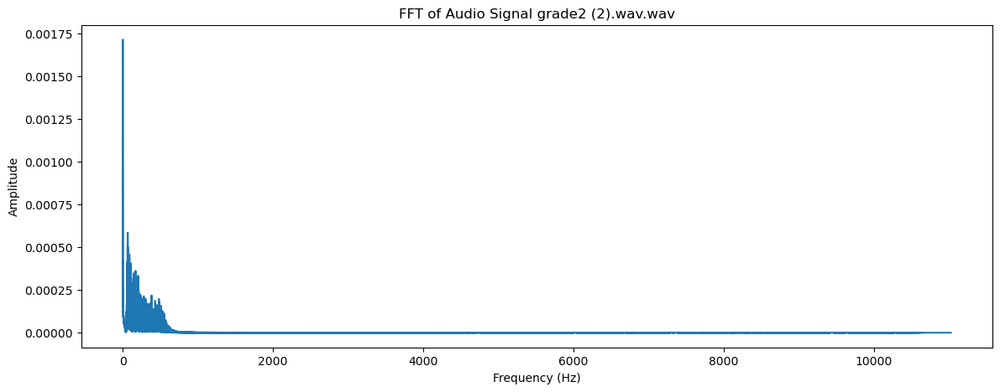

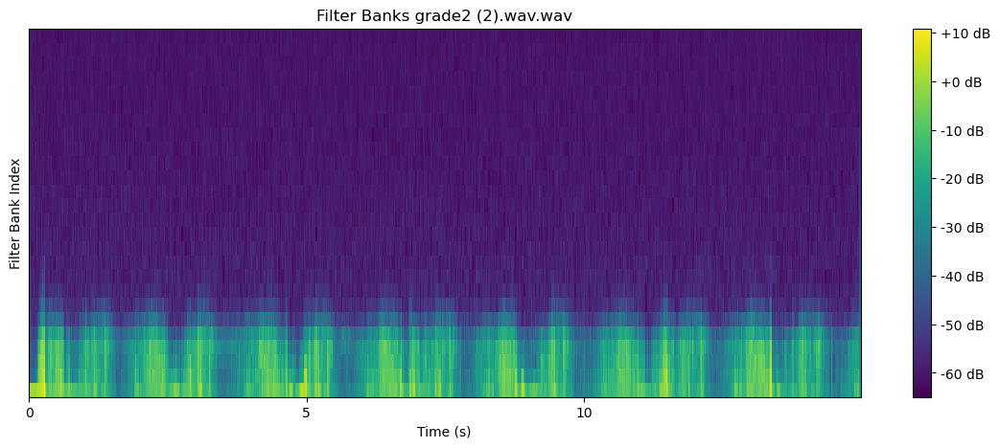

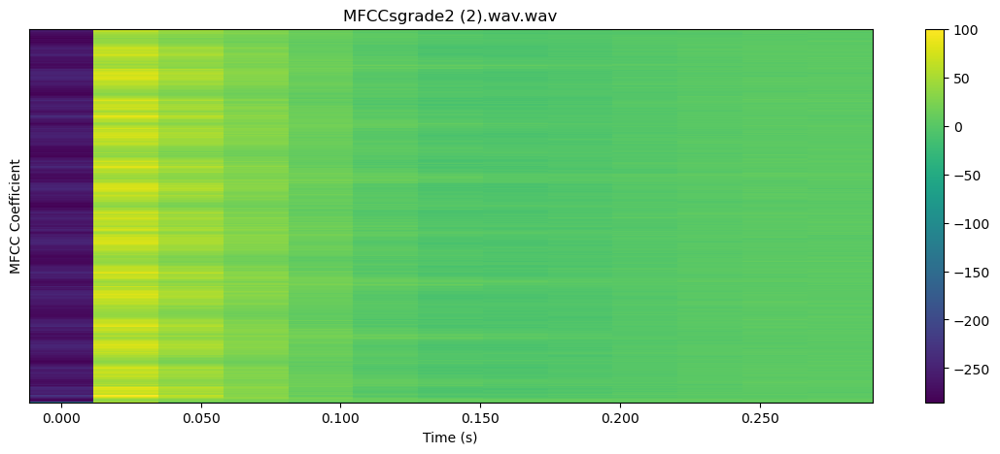

 34%|███▍      | 48/141 [01:37<02:36,  1.68s/it]

22050


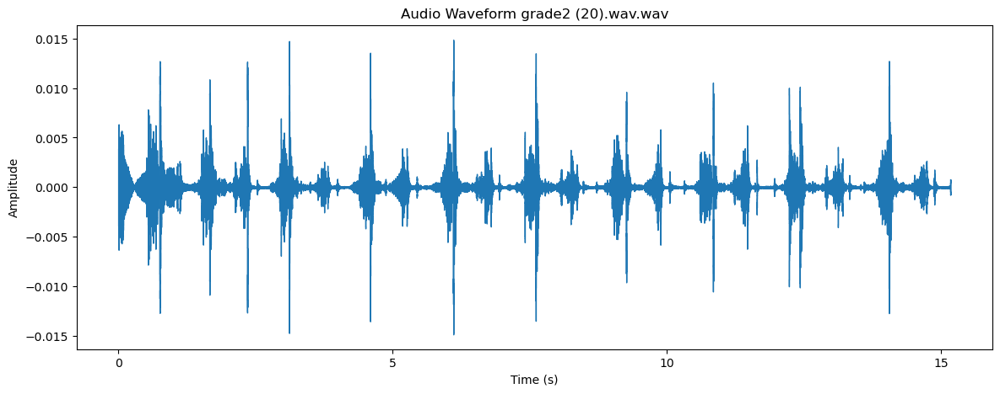

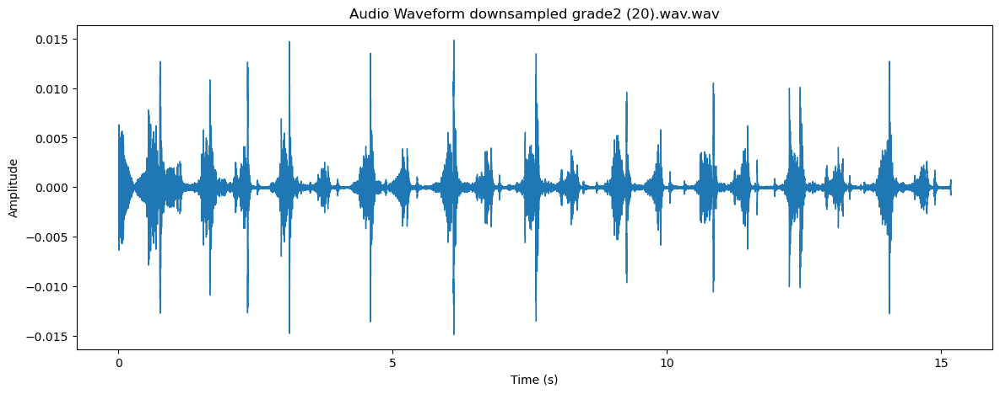

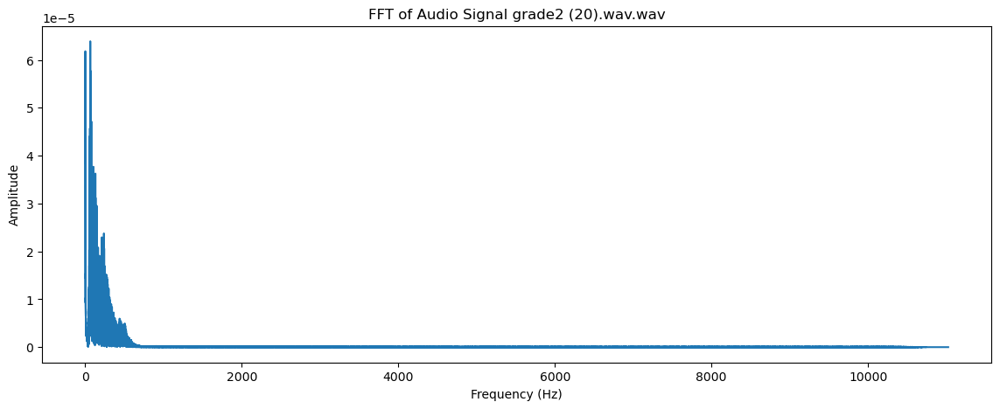

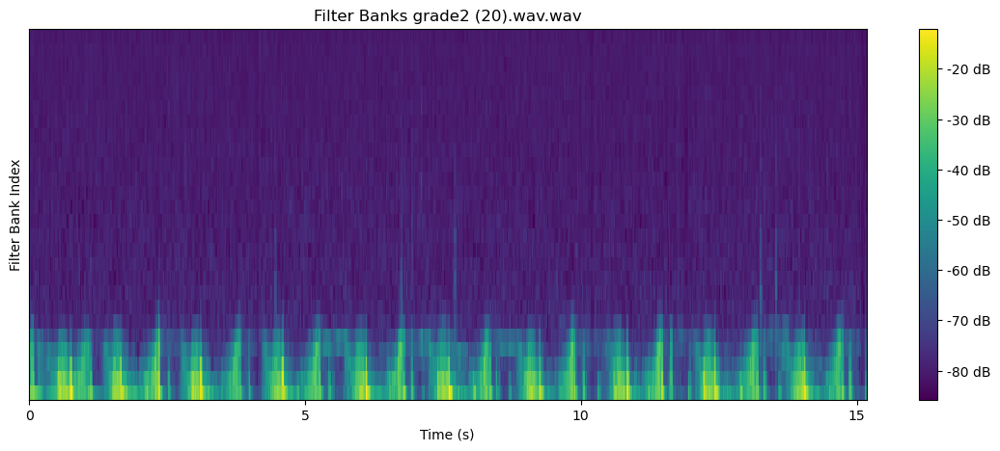

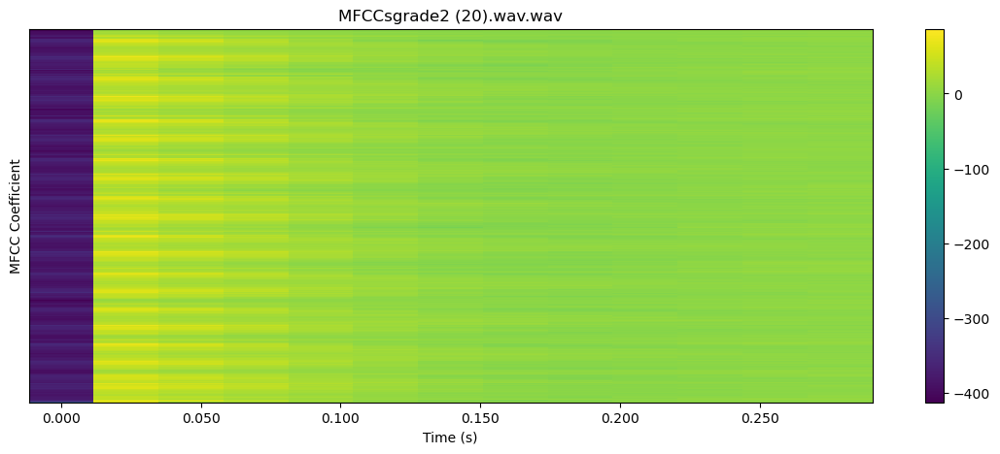

 35%|███▍      | 49/141 [01:39<02:30,  1.63s/it]

22050


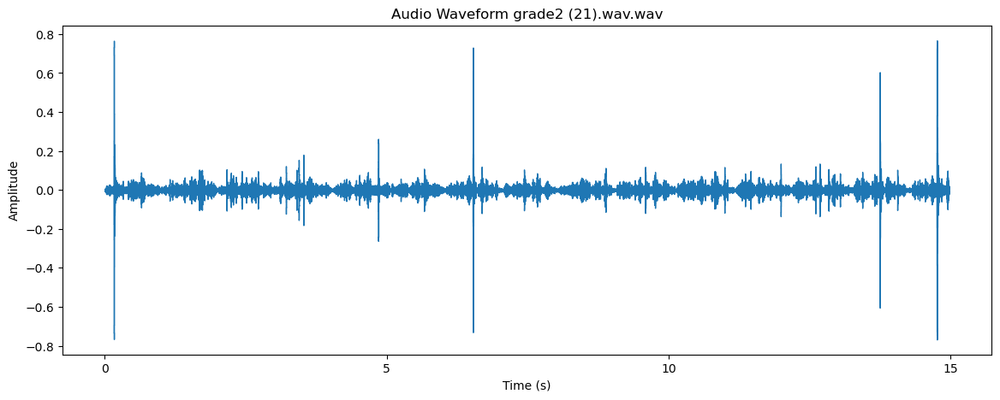

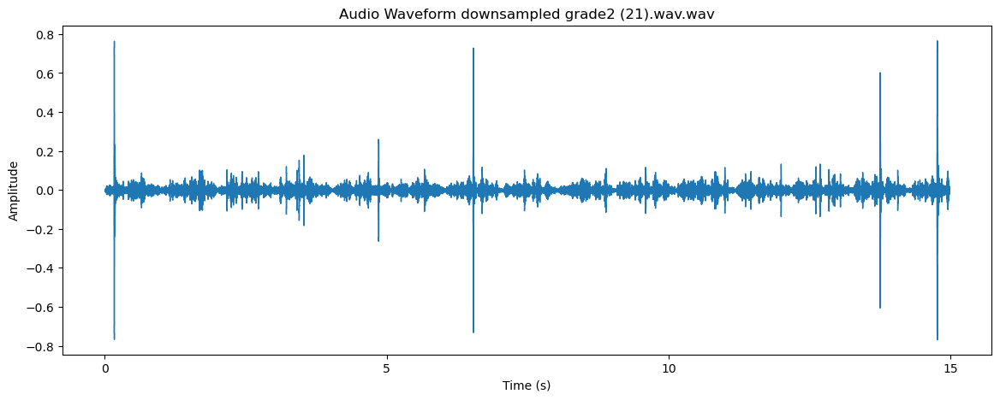

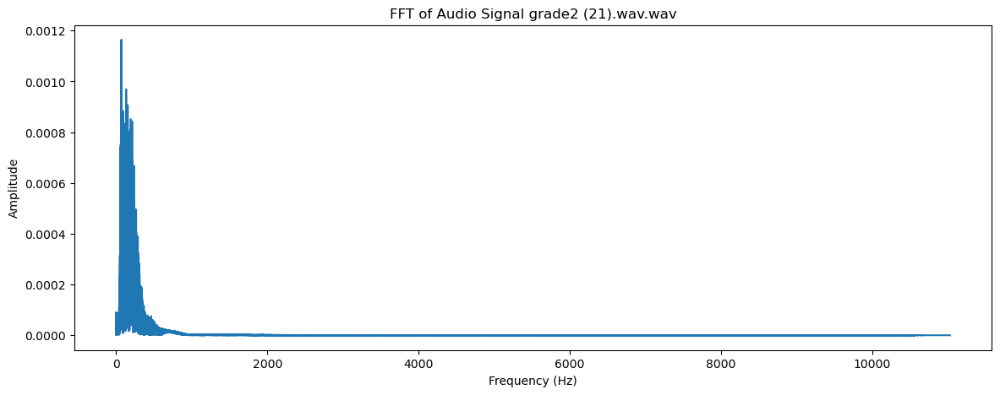

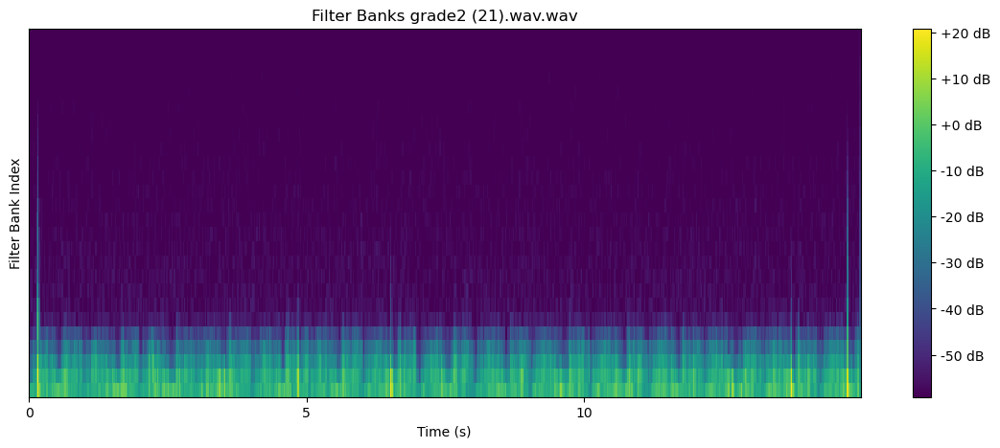

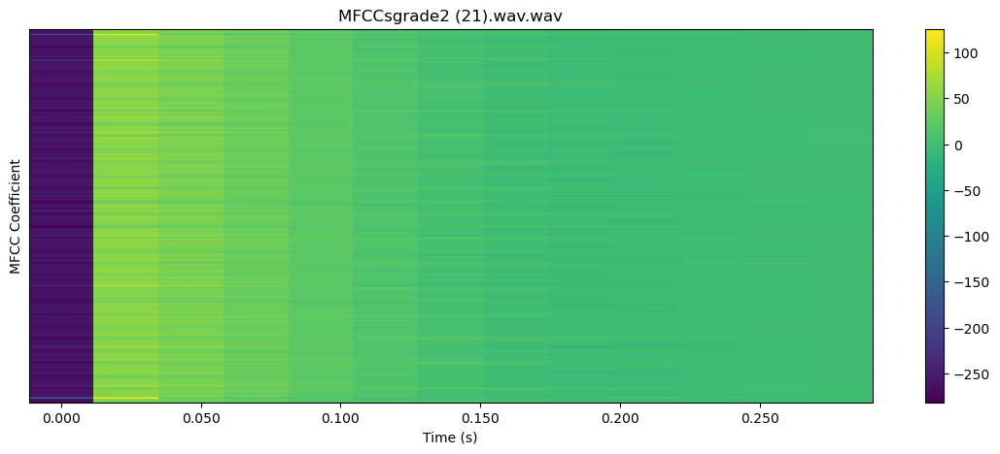

 35%|███▌      | 50/141 [01:40<02:23,  1.58s/it]

22050


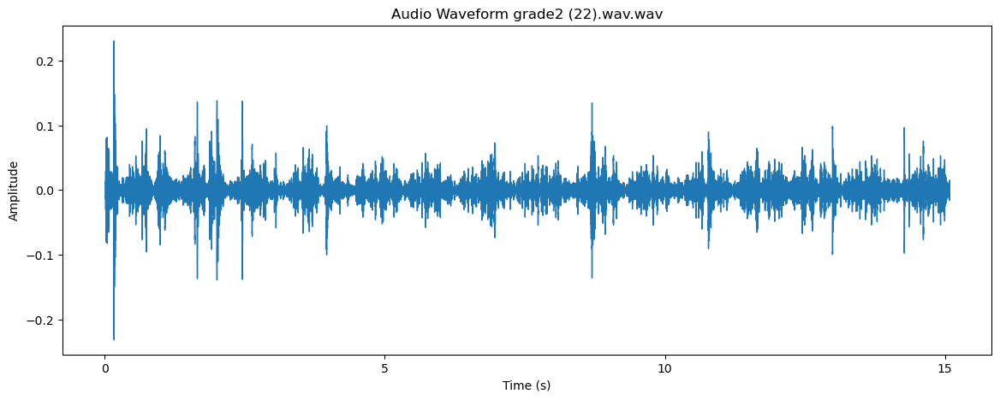

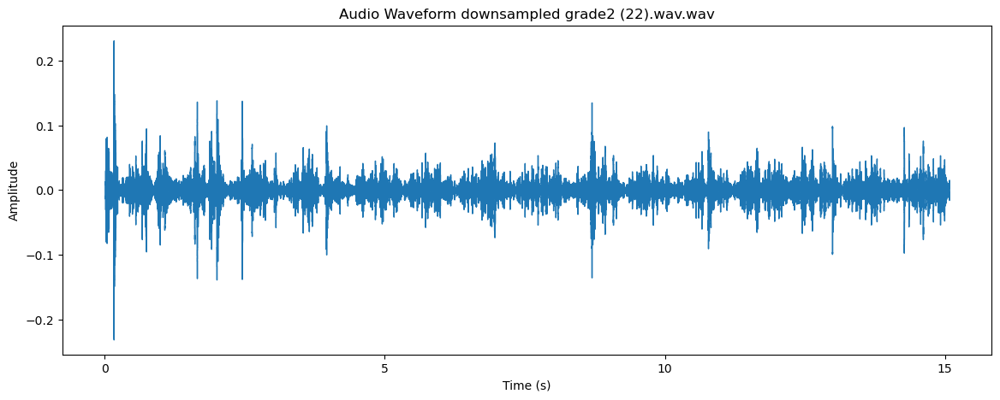

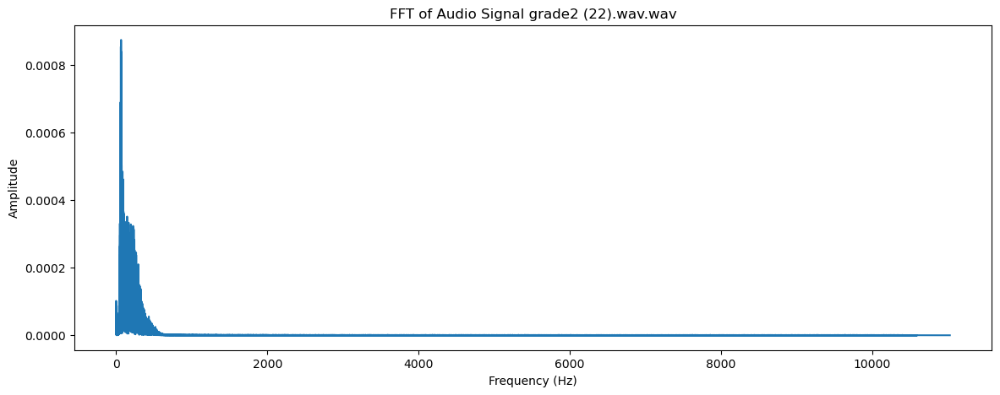

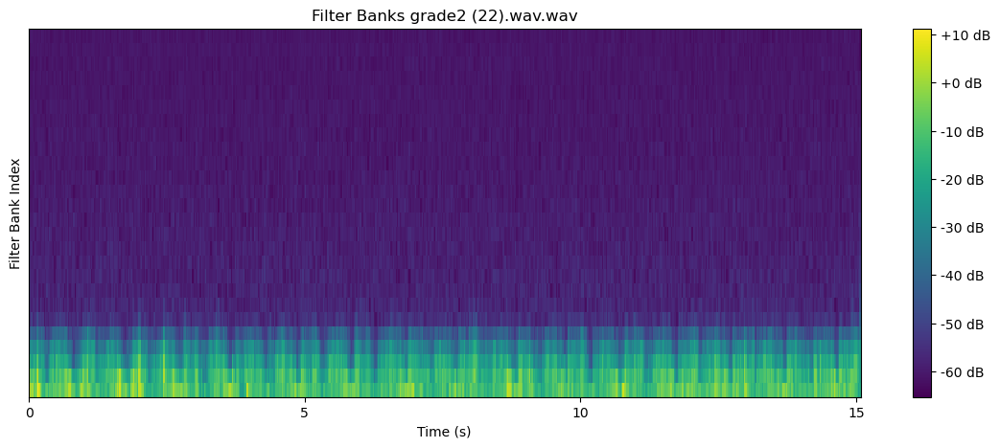

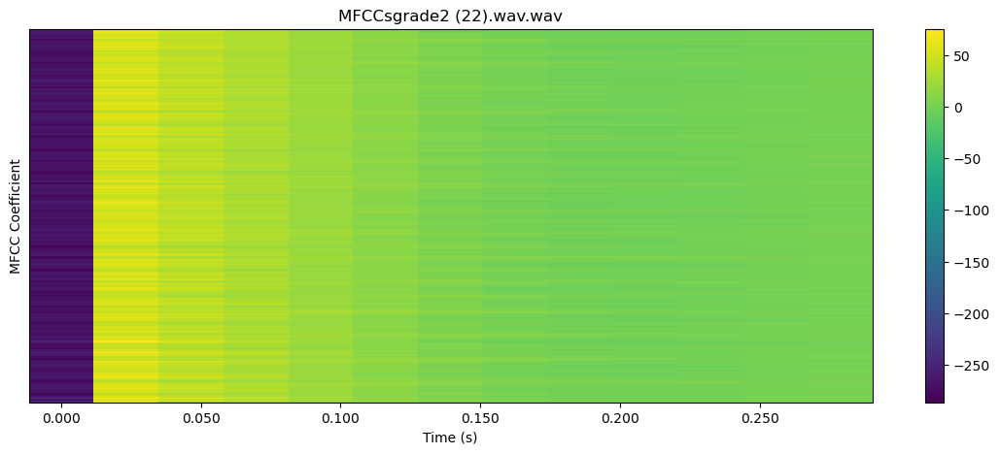

 36%|███▌      | 51/141 [01:42<02:31,  1.69s/it]

22050


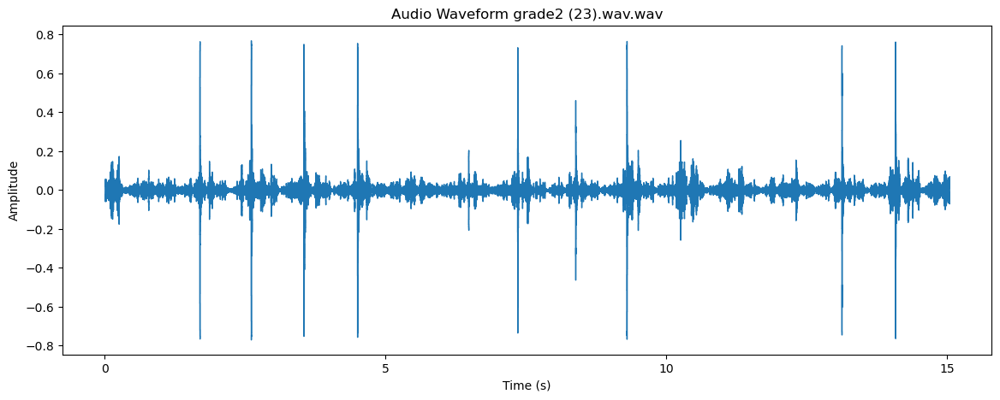

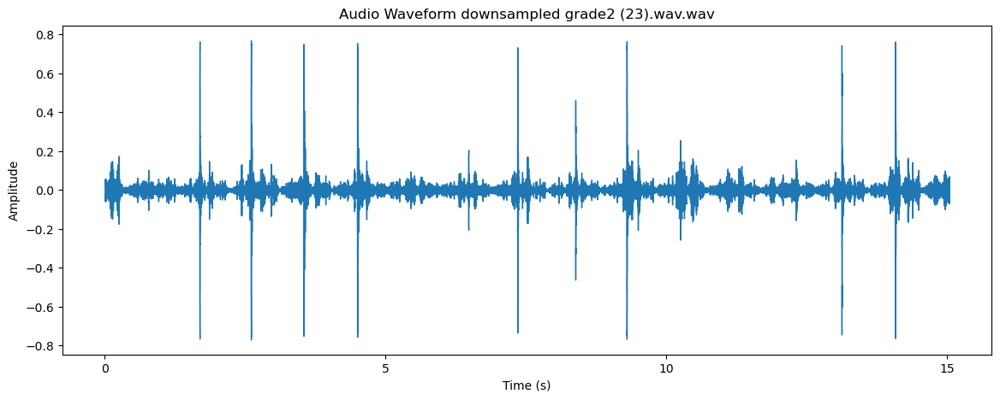

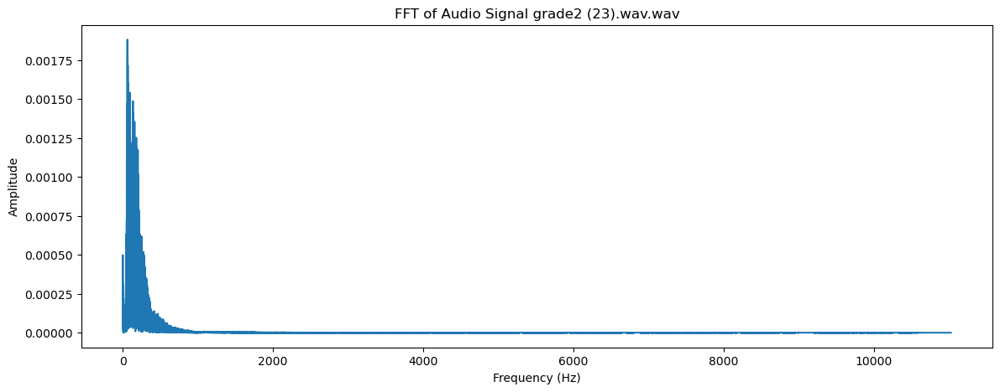

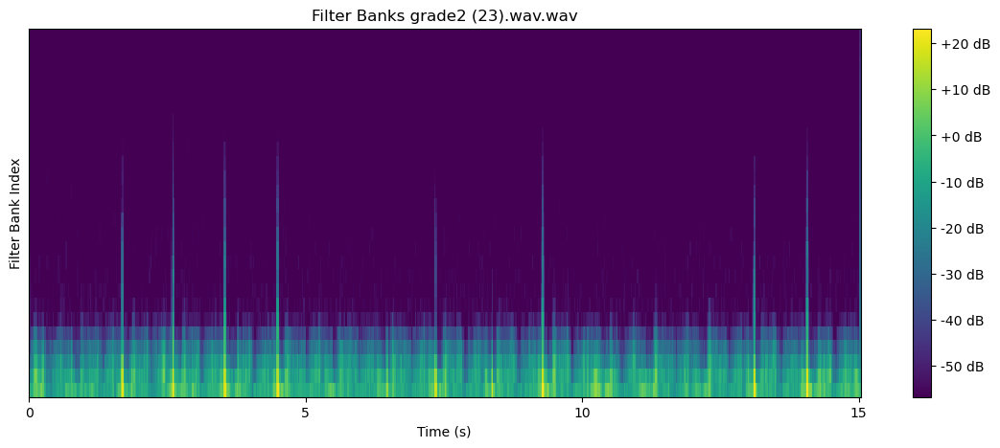

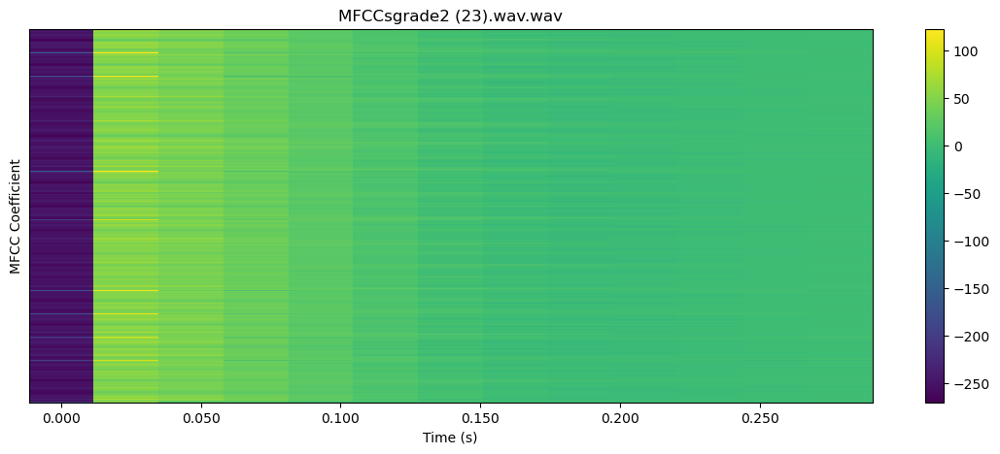

 37%|███▋      | 52/141 [01:45<02:54,  1.96s/it]

22050


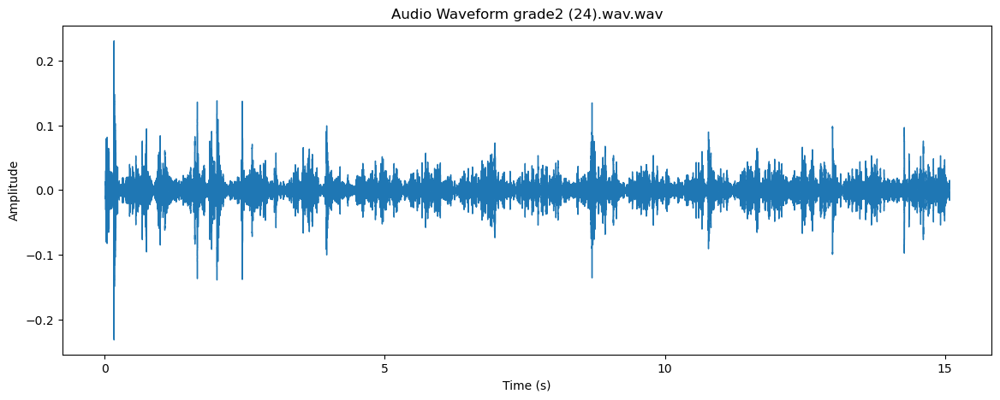

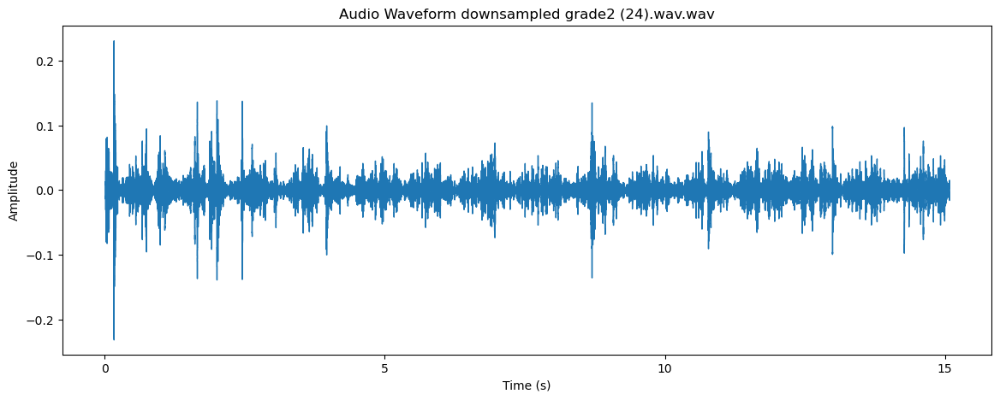

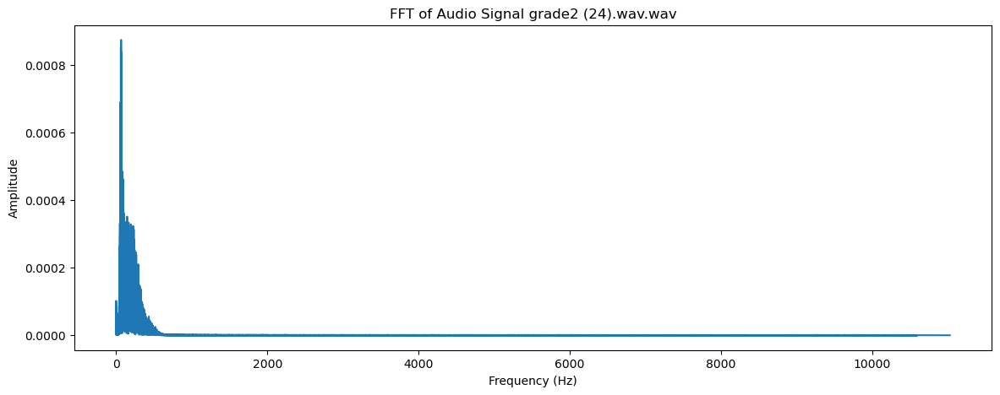

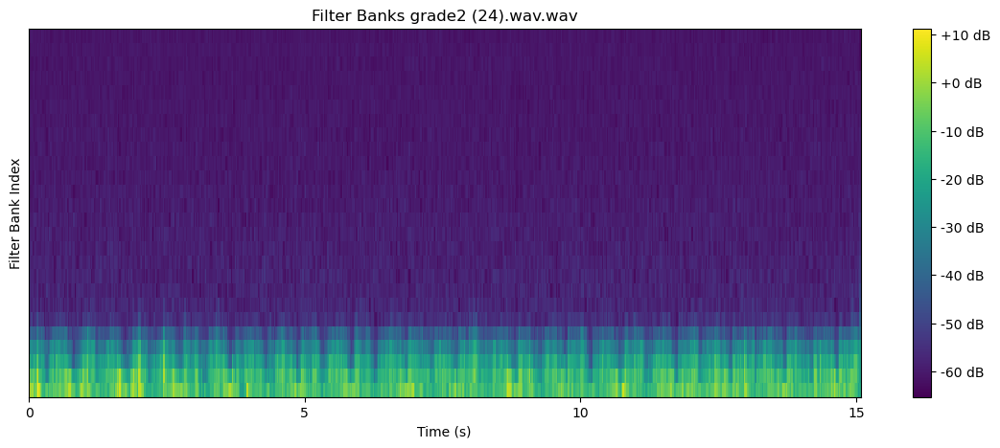

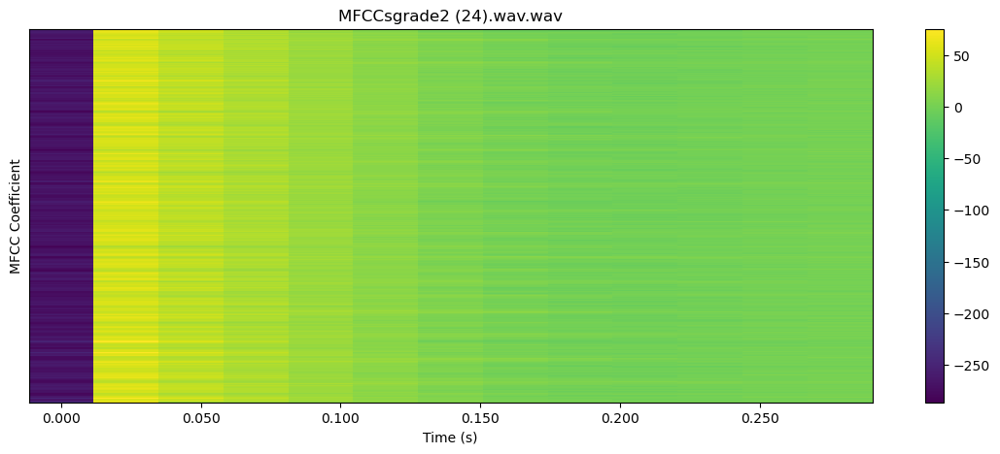

 38%|███▊      | 53/141 [01:46<02:44,  1.87s/it]

22050


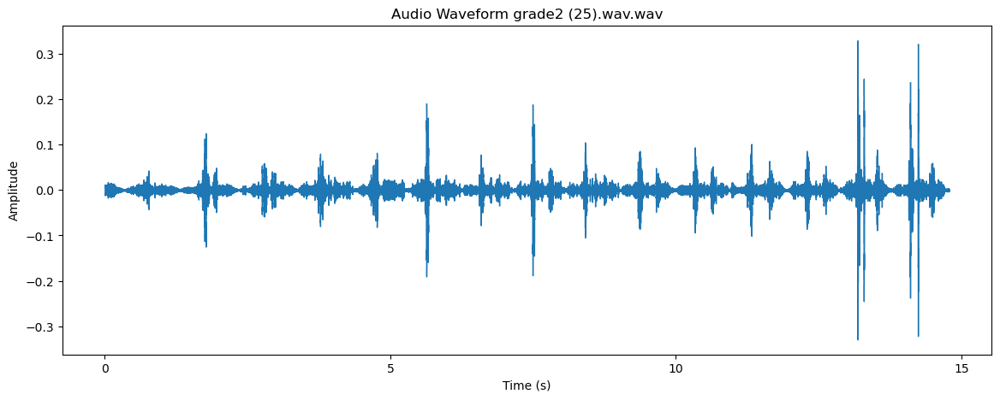

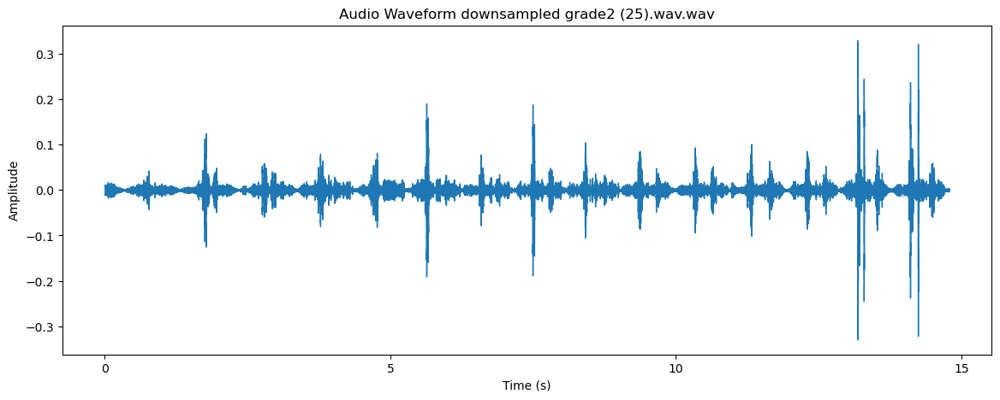

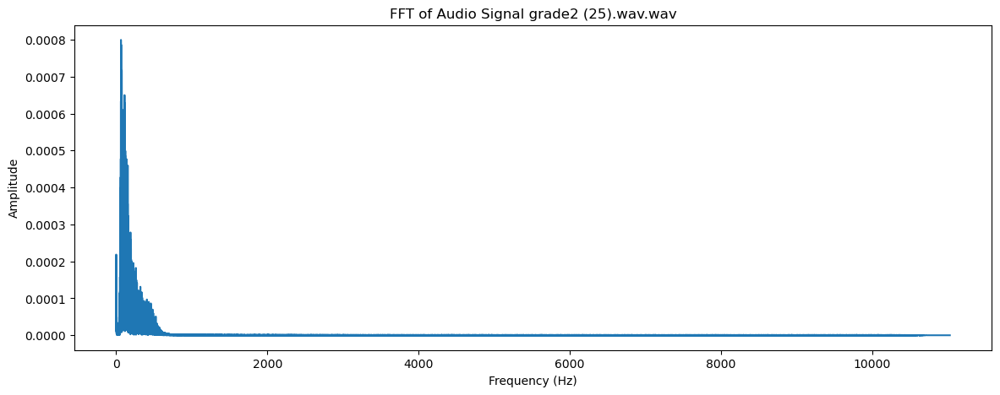

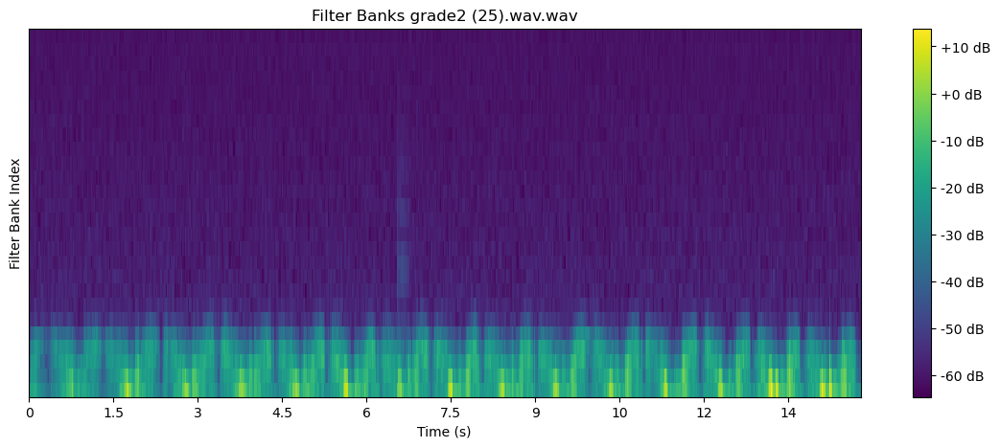

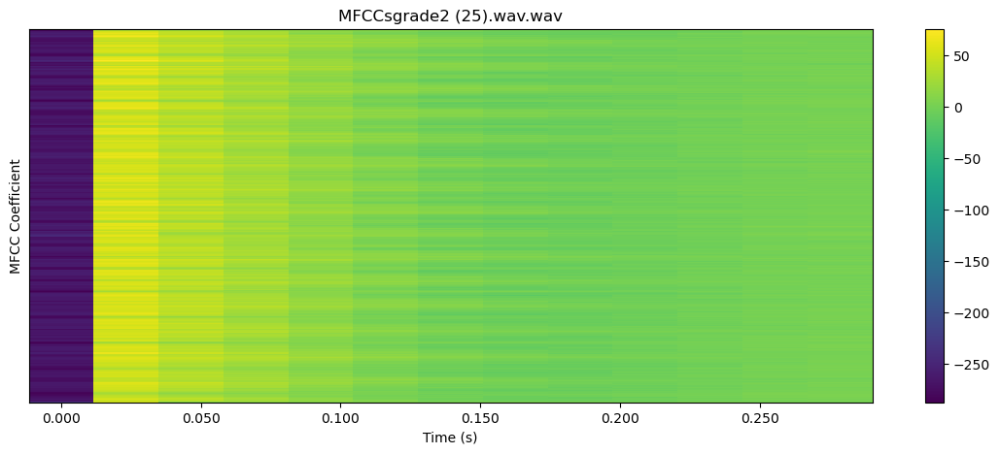

 38%|███▊      | 54/141 [01:48<02:28,  1.71s/it]

22050


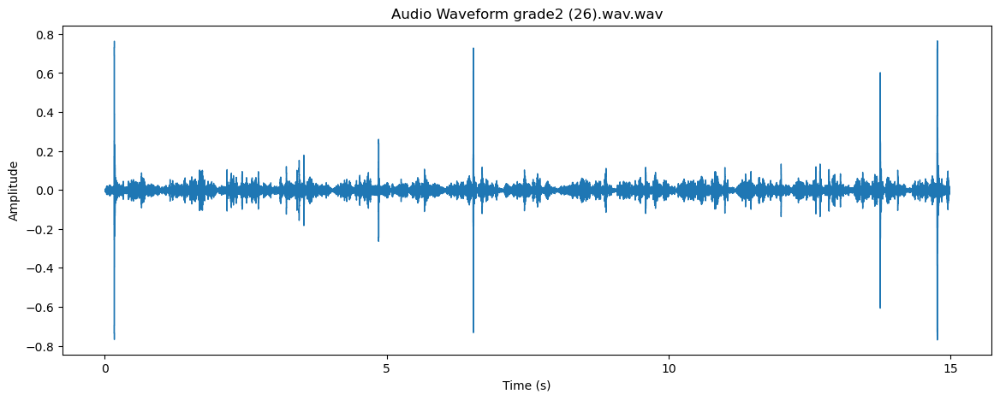

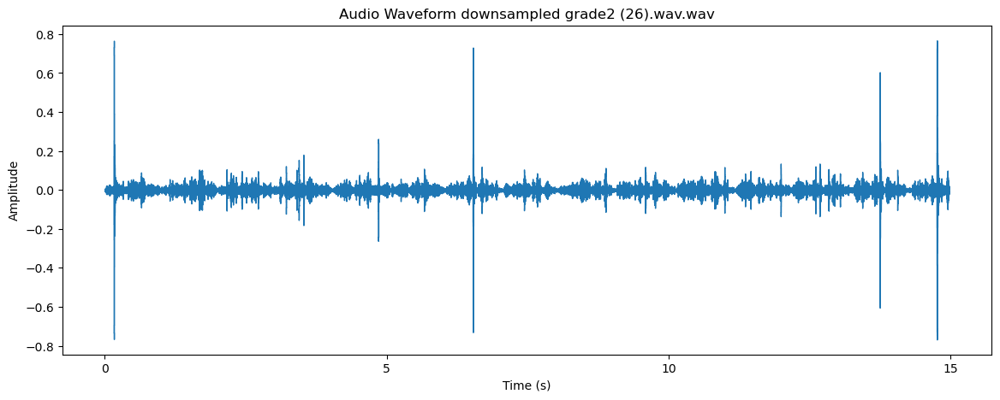

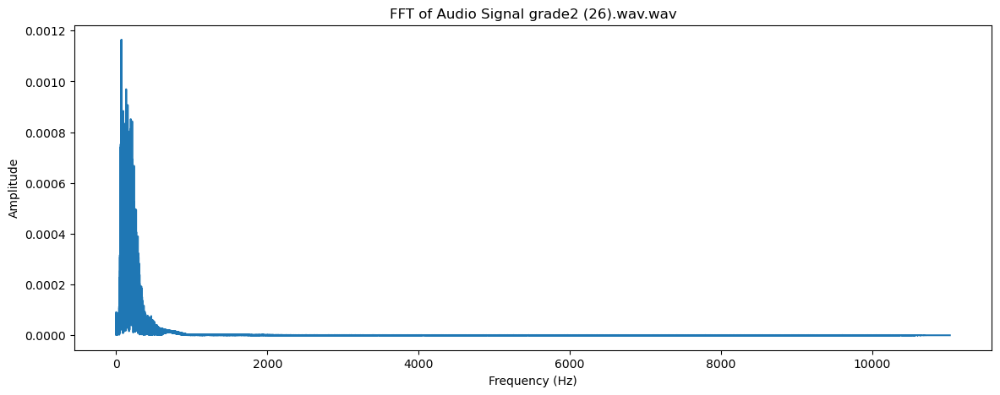

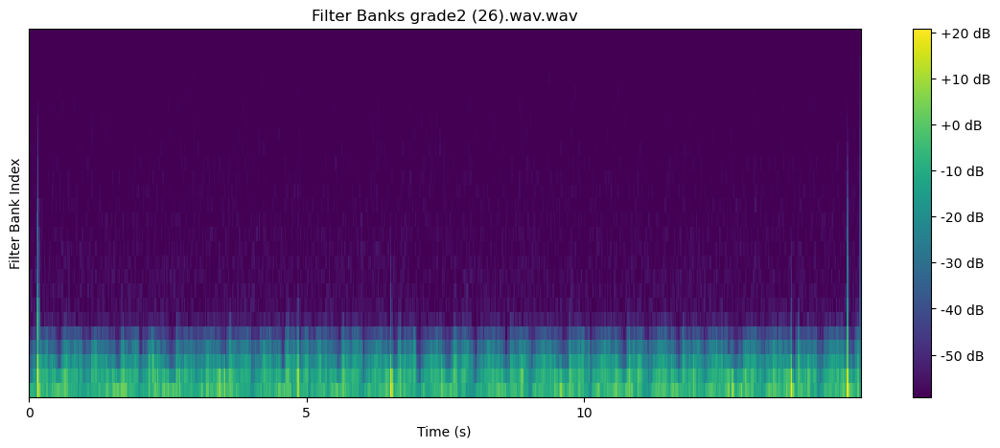

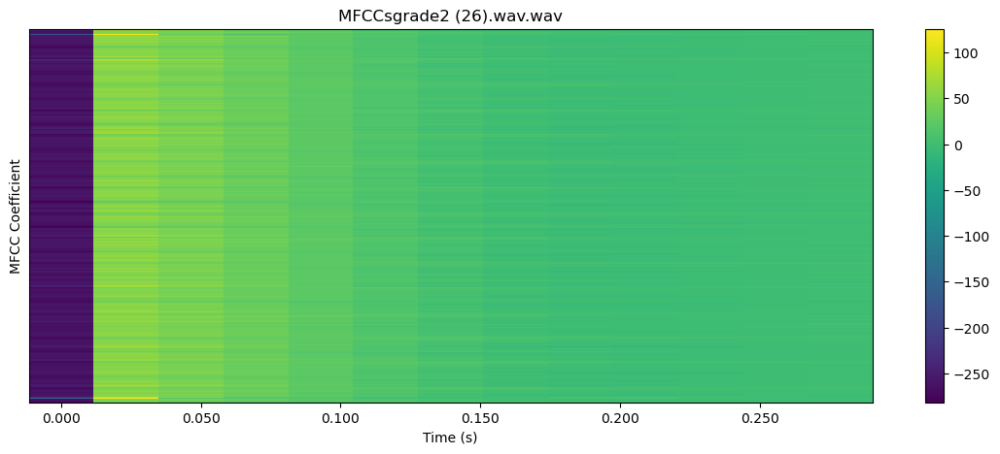

 39%|███▉      | 55/141 [01:49<02:22,  1.66s/it]

22050


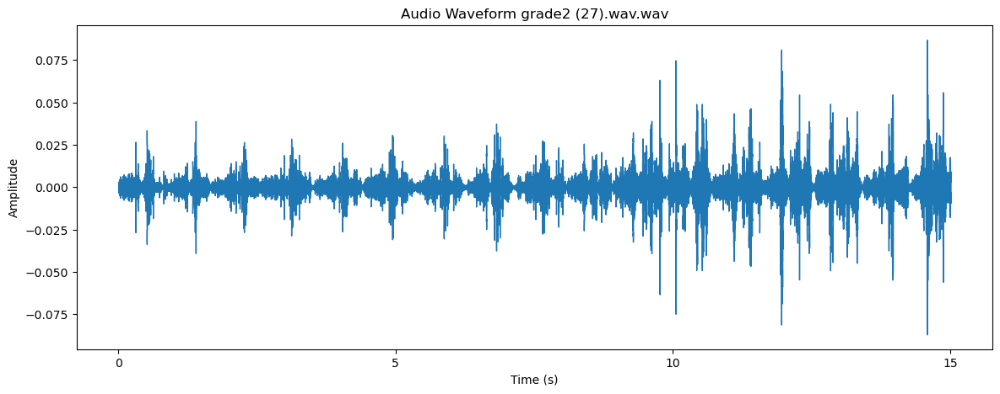

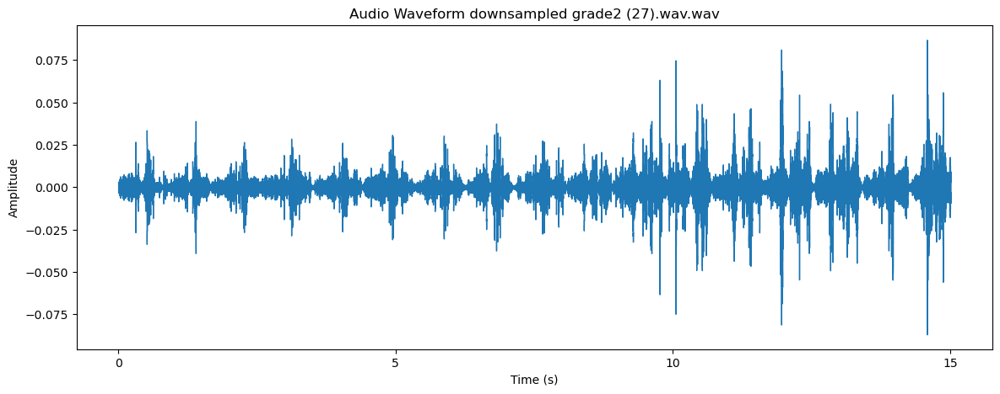

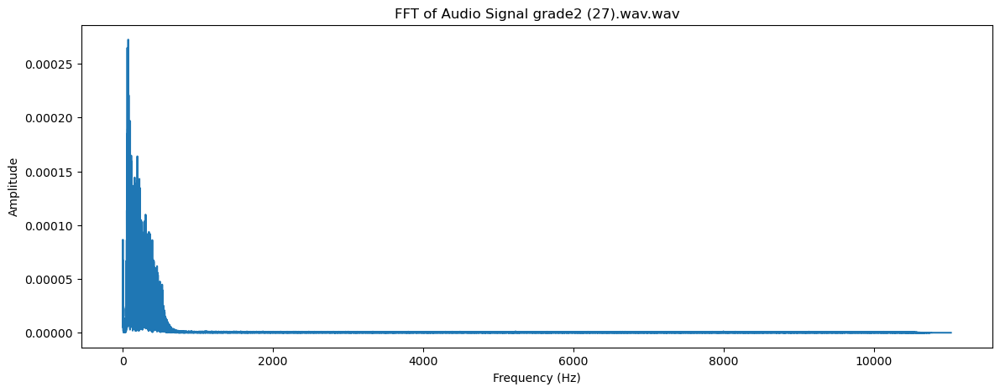

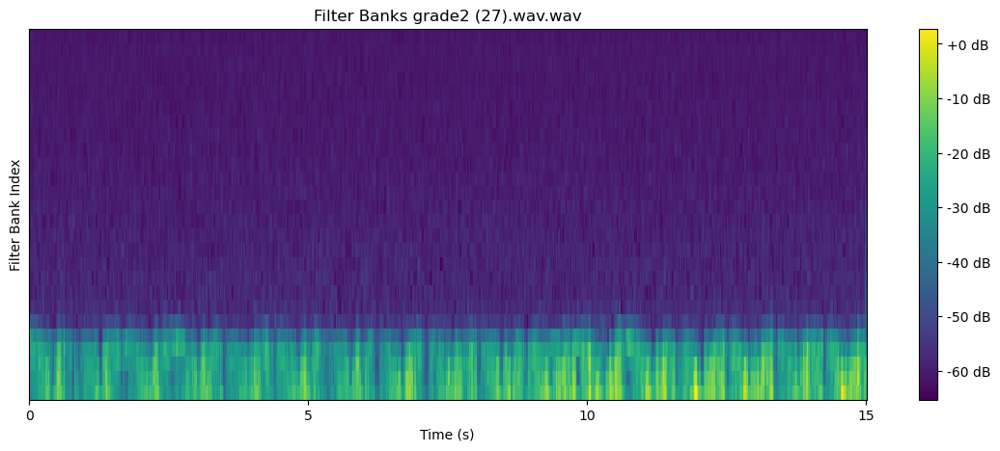

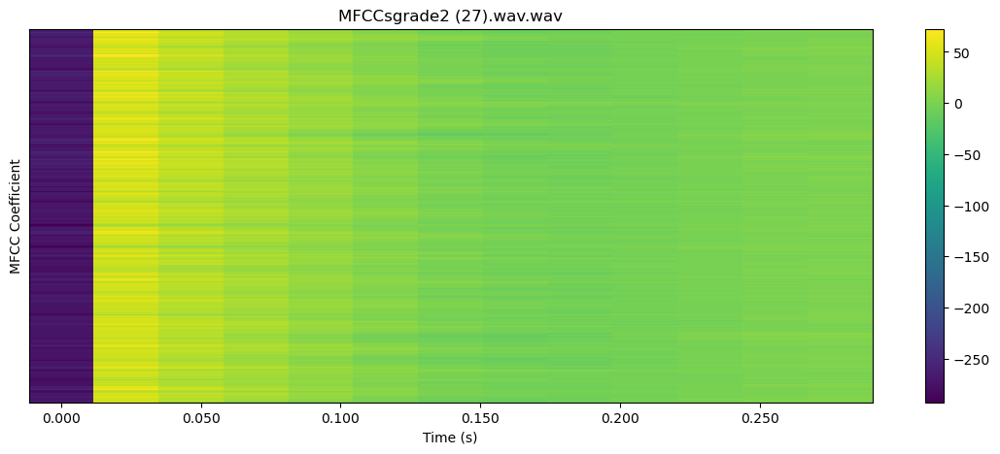

 40%|███▉      | 56/141 [01:51<02:17,  1.62s/it]

22050


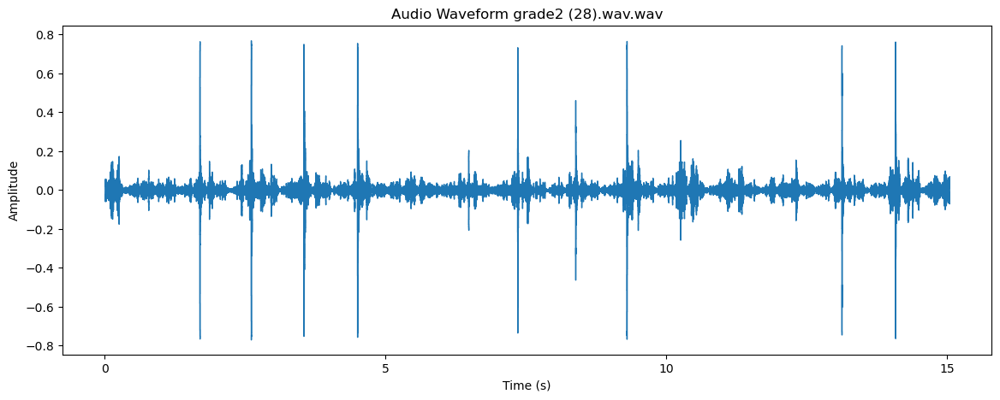

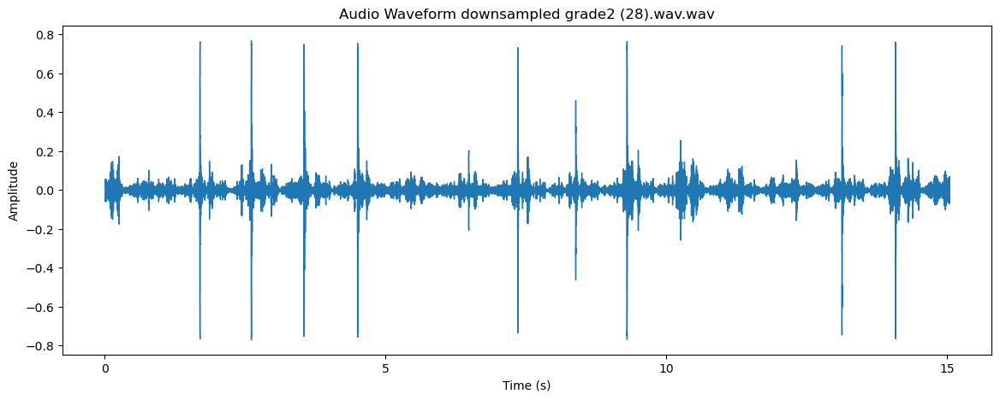

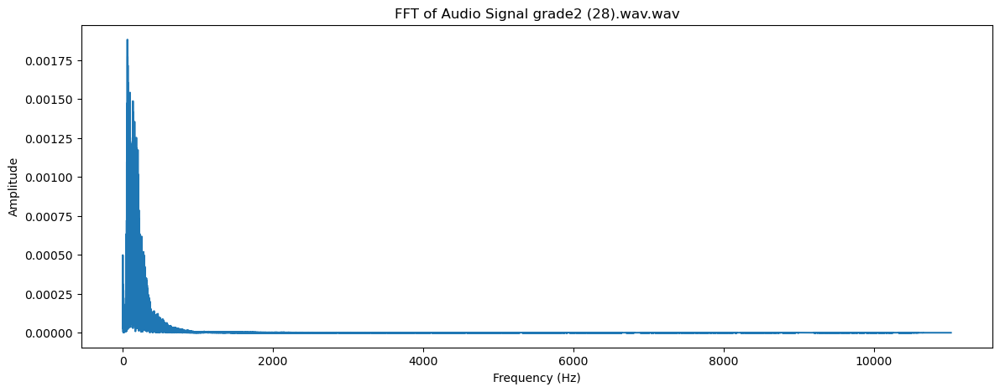

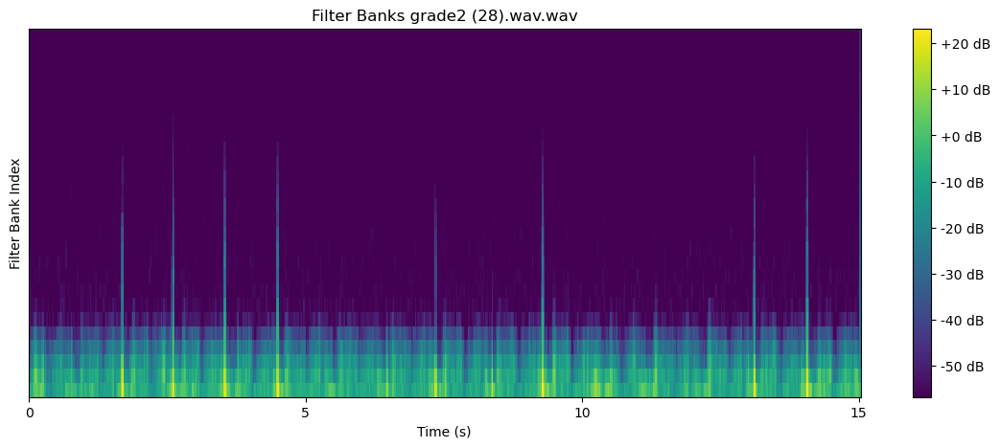

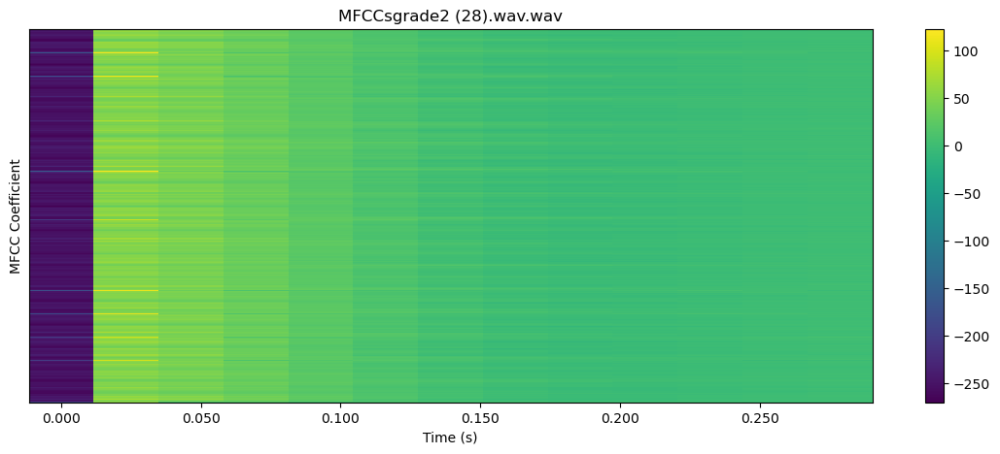

 40%|████      | 57/141 [01:52<02:12,  1.57s/it]

22050


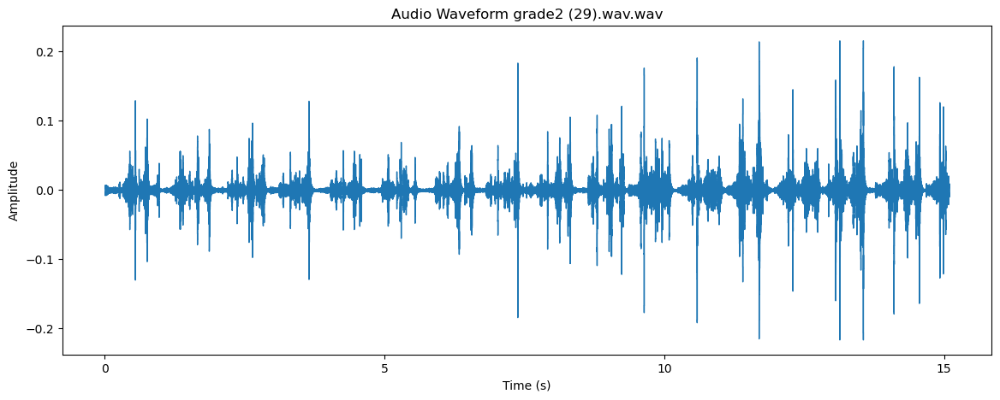

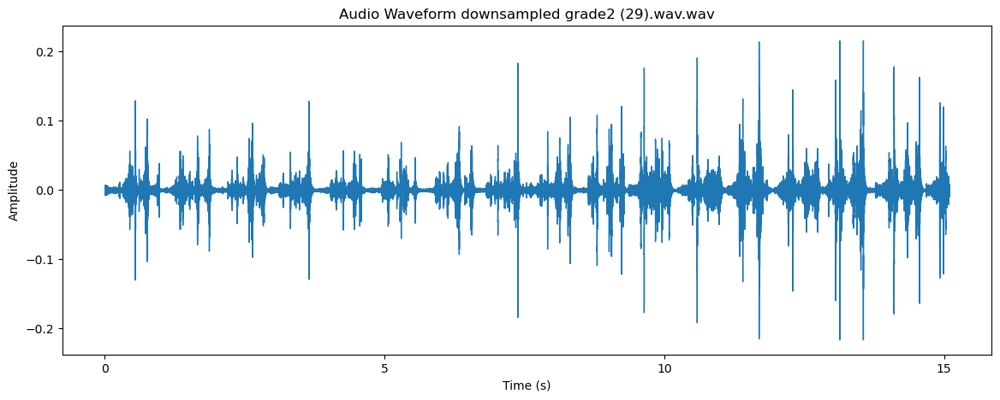

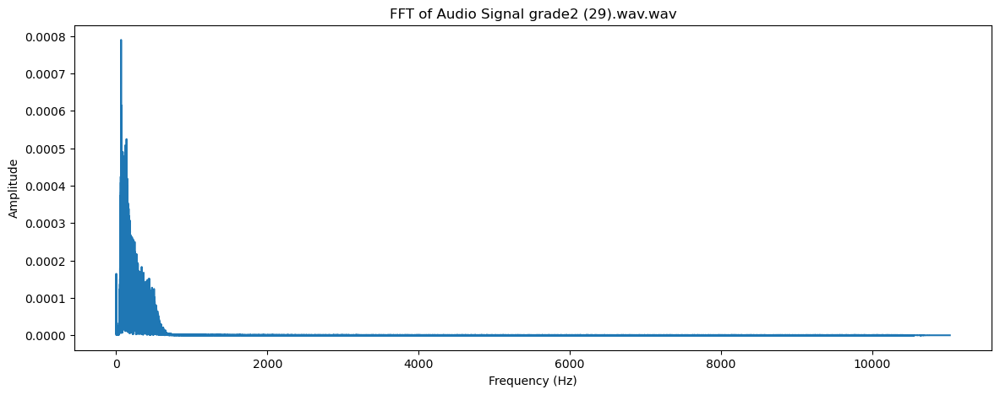

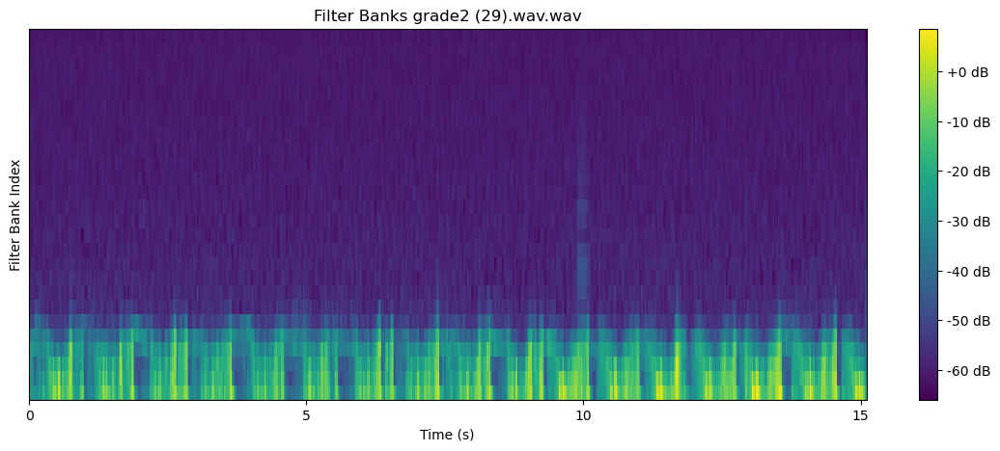

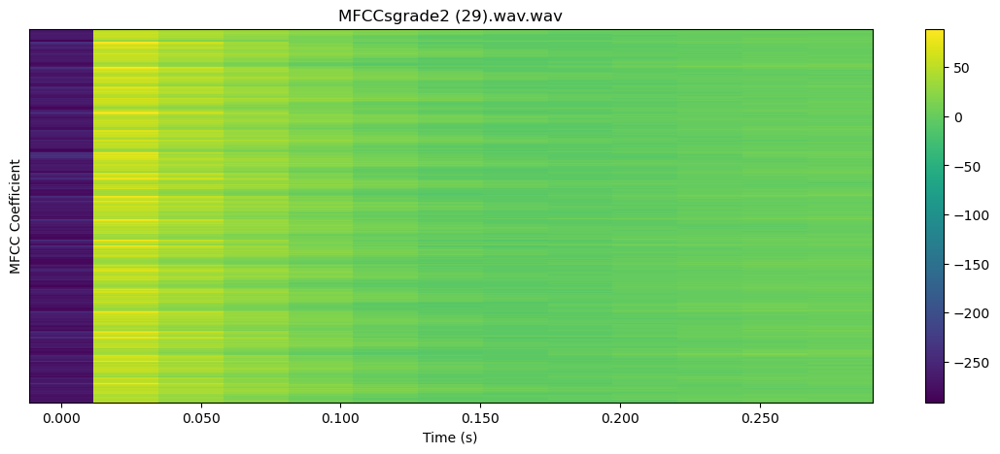

 41%|████      | 58/141 [01:54<02:13,  1.61s/it]

22050


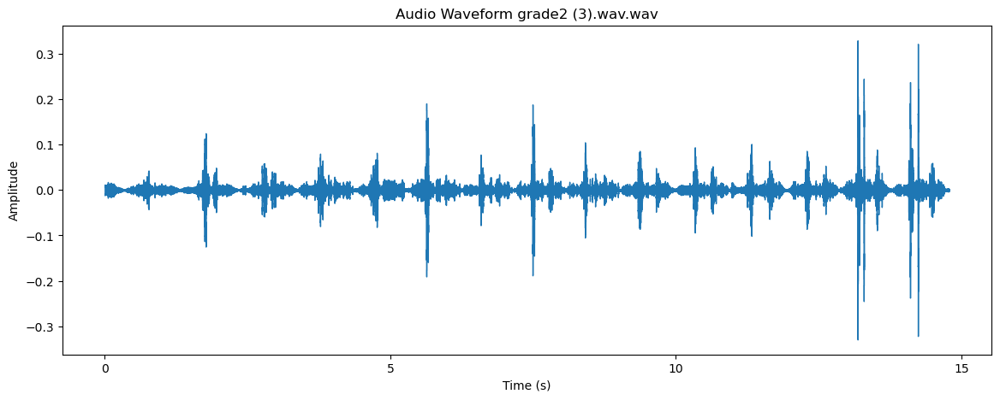

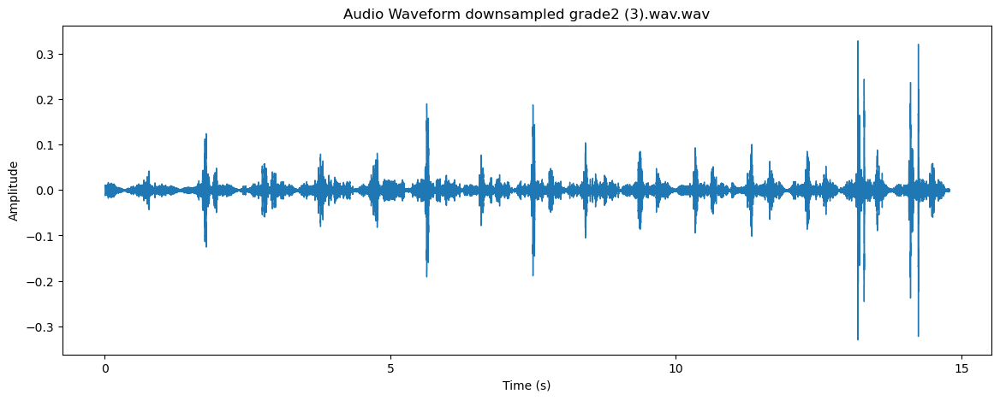

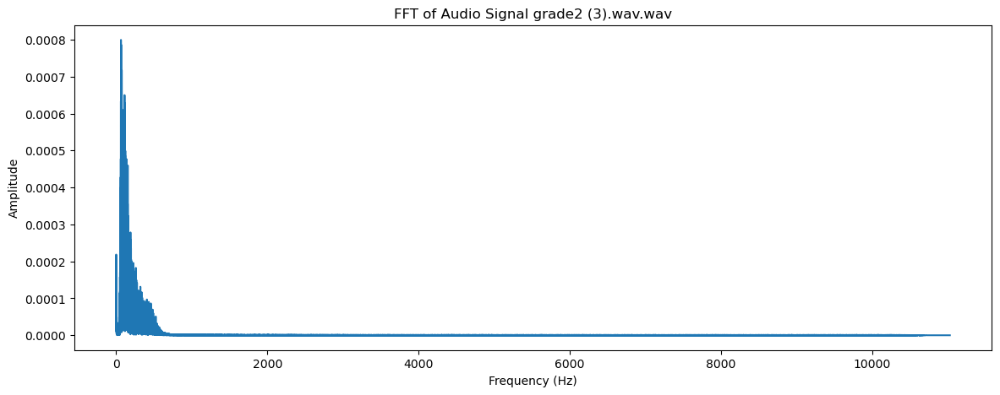

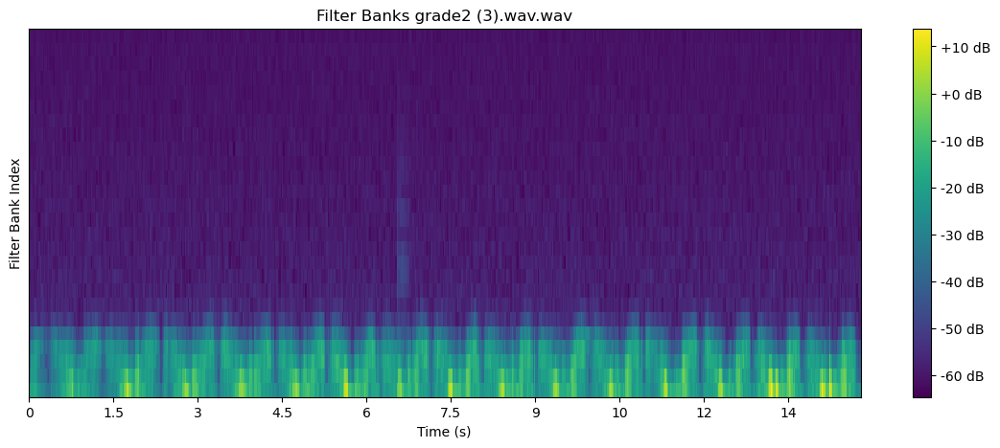

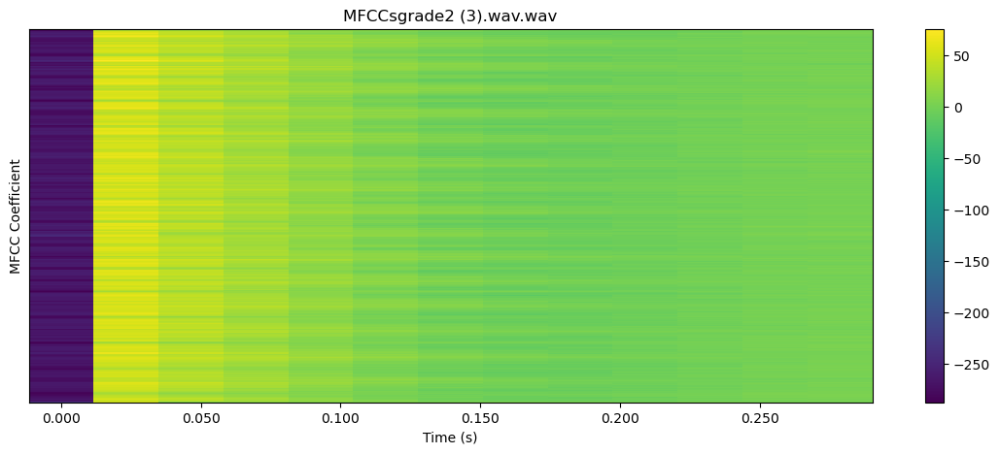

 42%|████▏     | 59/141 [01:55<02:07,  1.55s/it]

22050


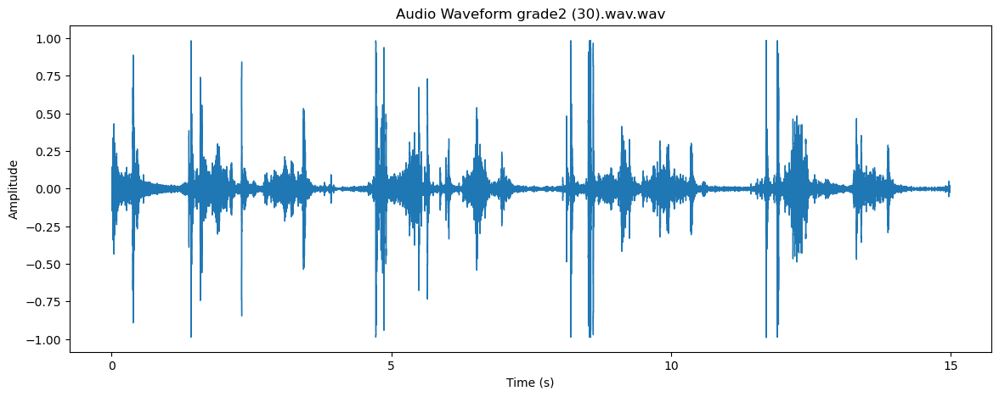

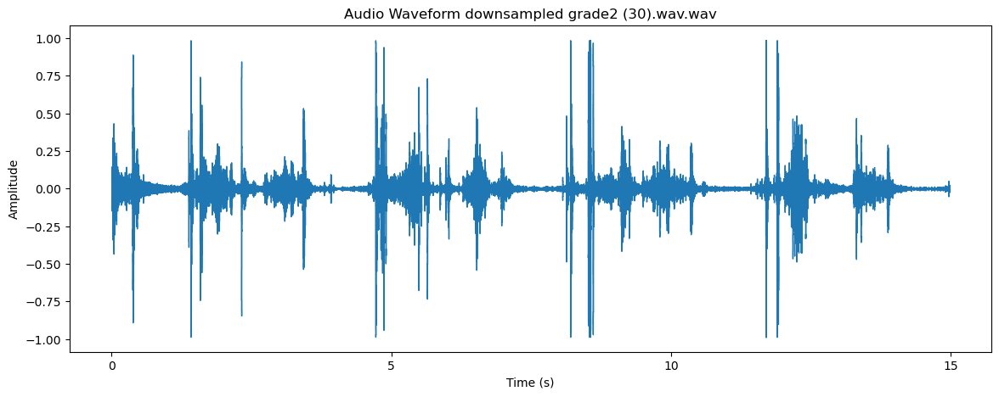

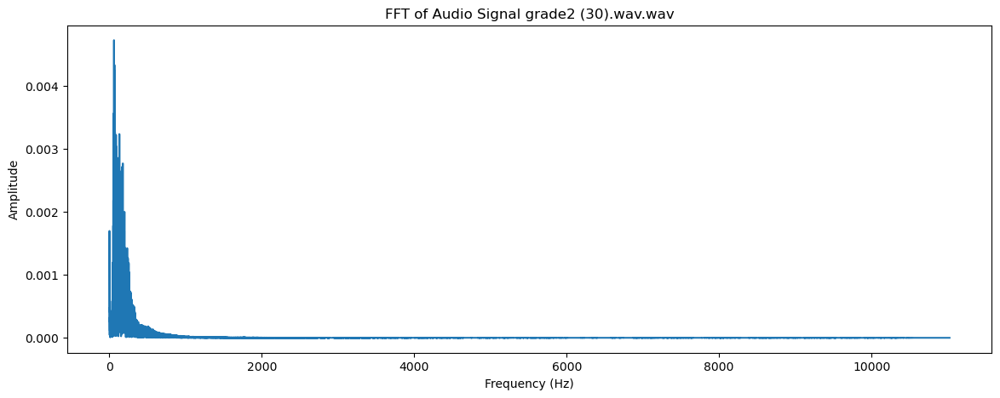

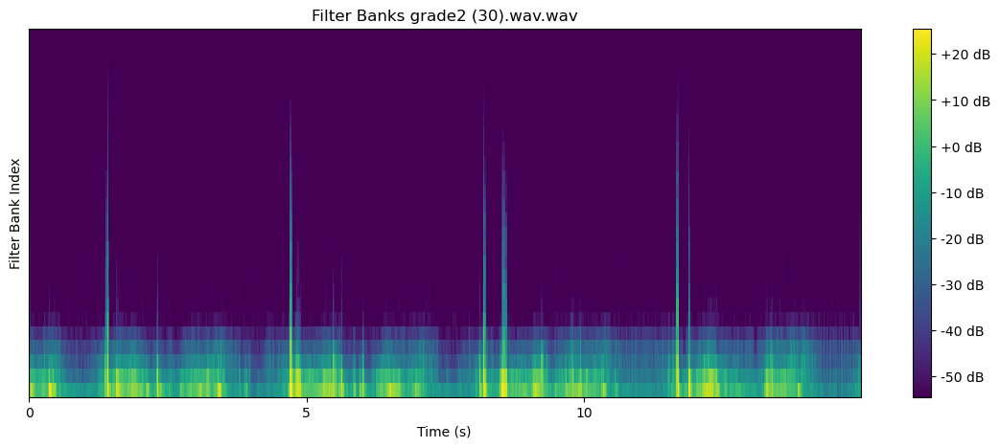

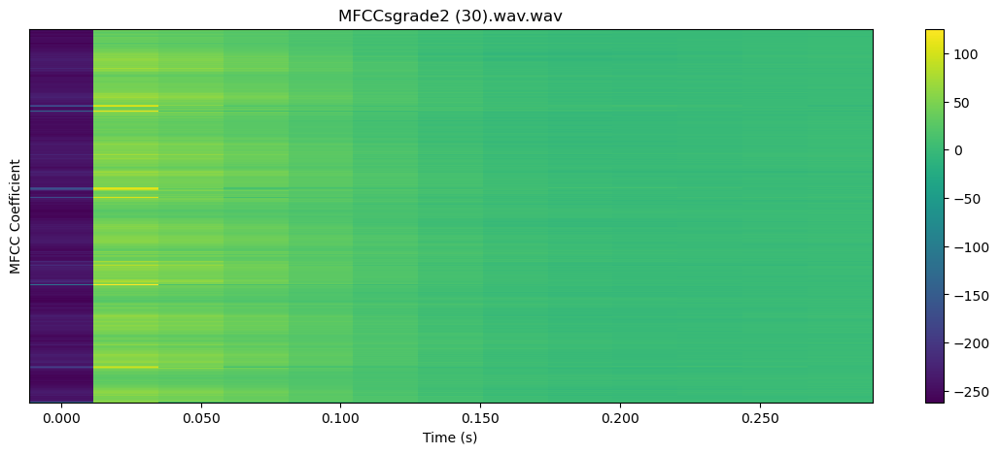

 43%|████▎     | 60/141 [01:57<02:08,  1.59s/it]

22050


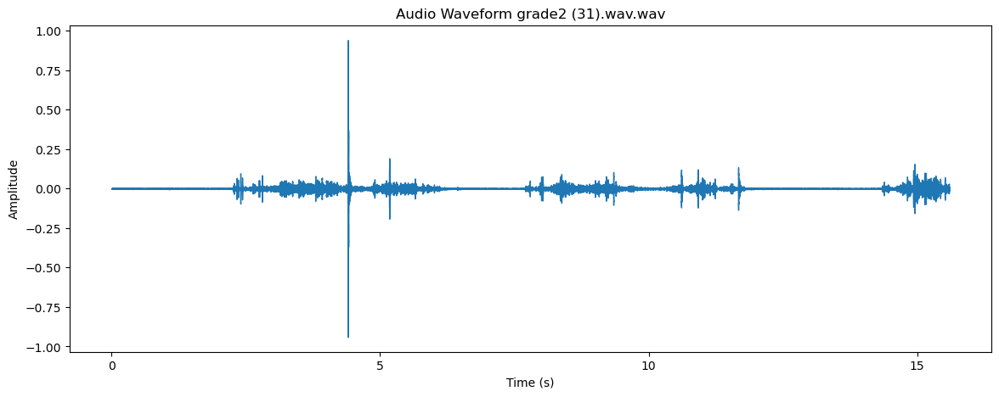

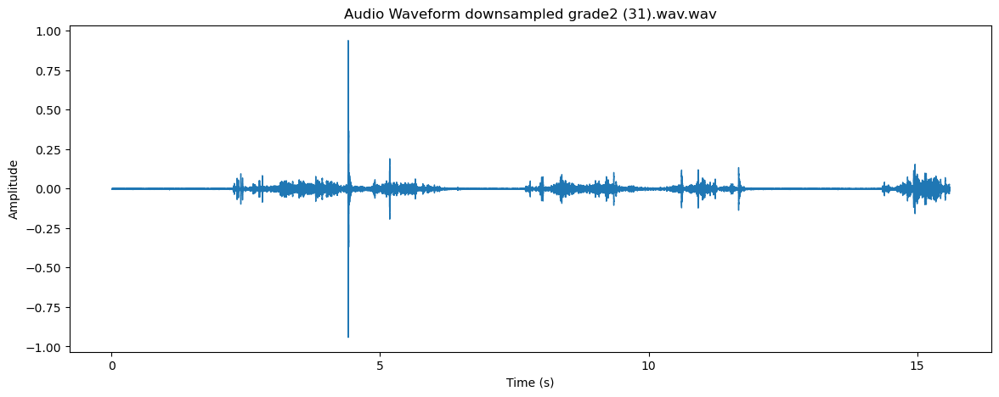

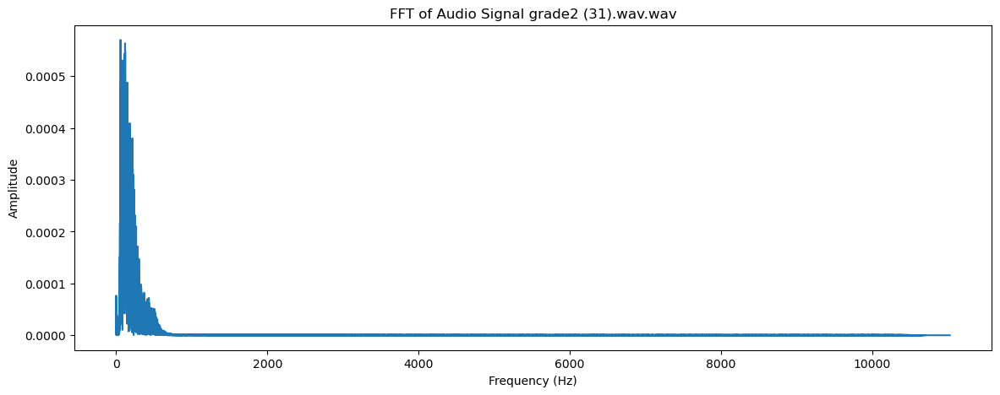

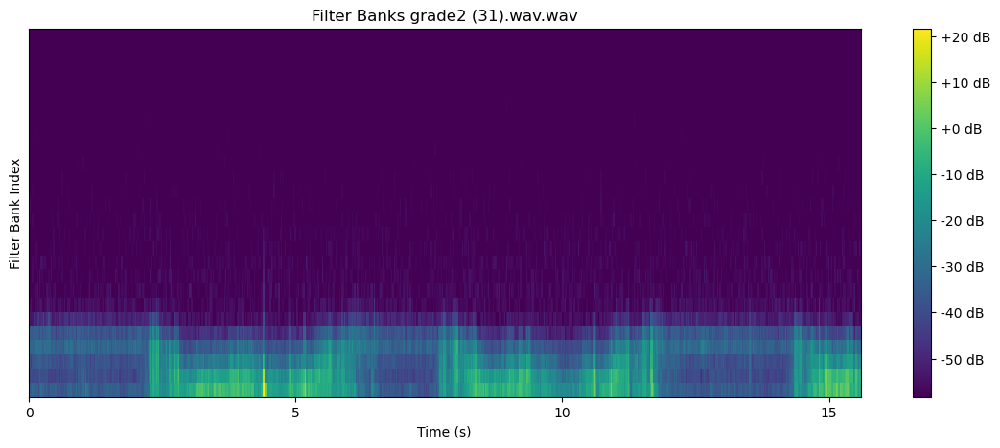

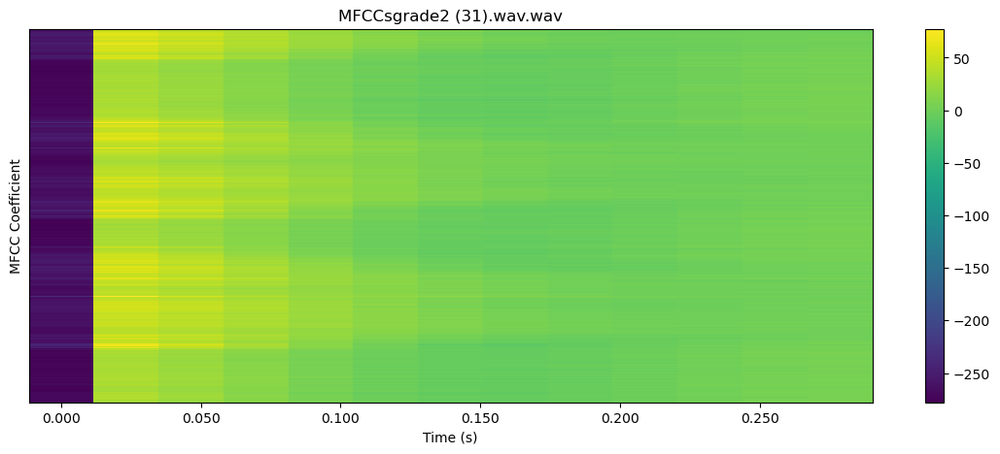

 43%|████▎     | 61/141 [01:59<02:22,  1.78s/it]

22050


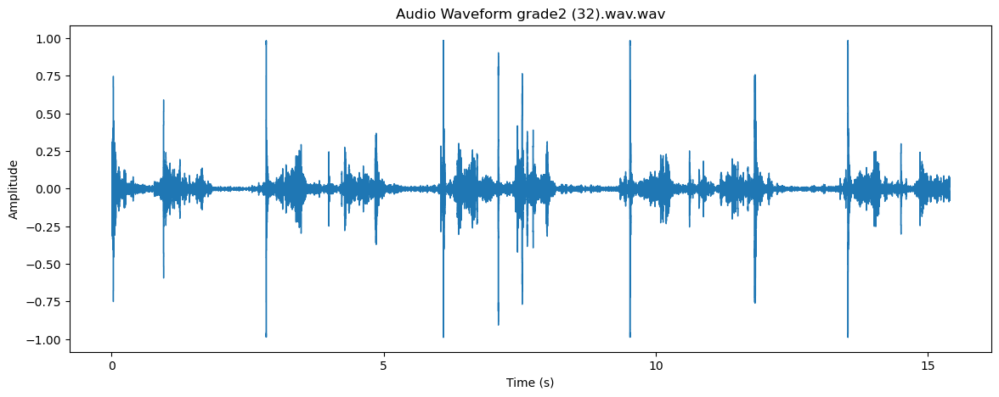

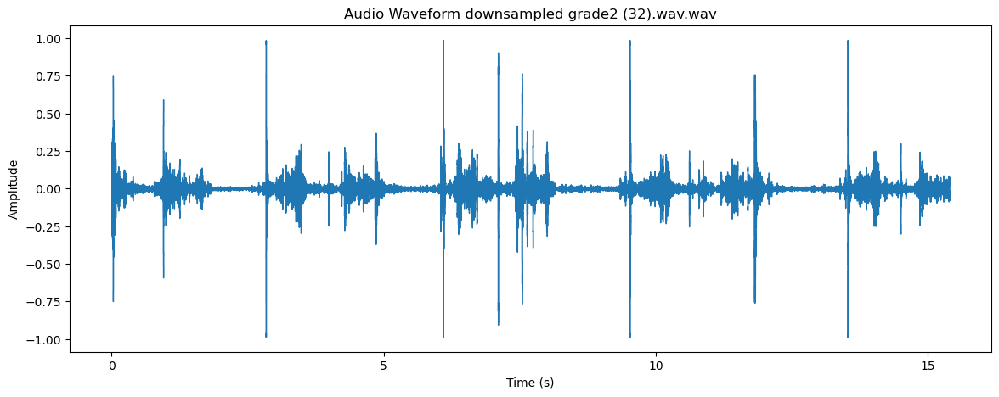

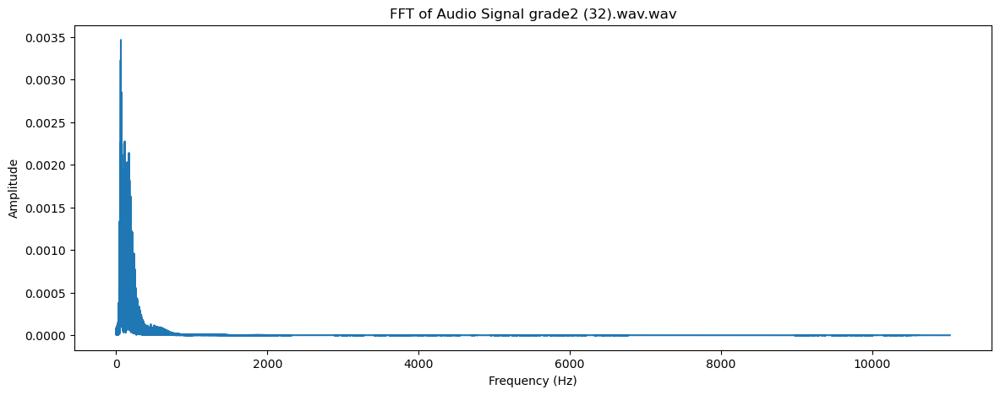

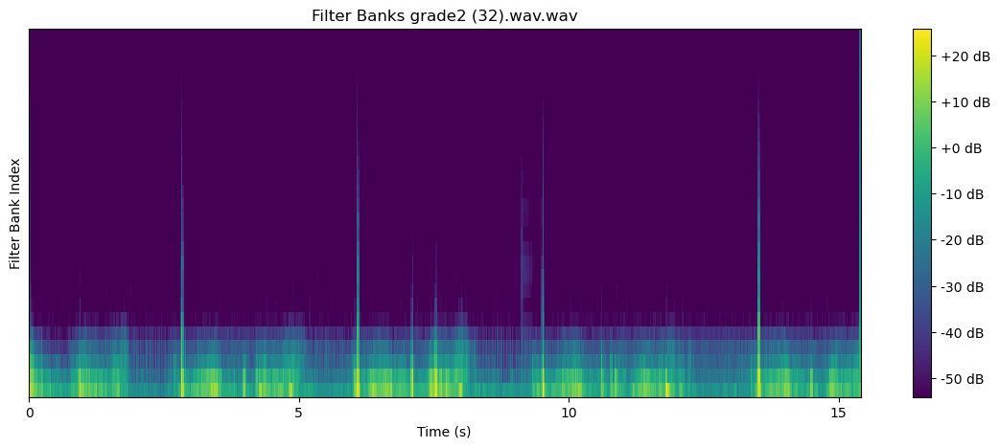

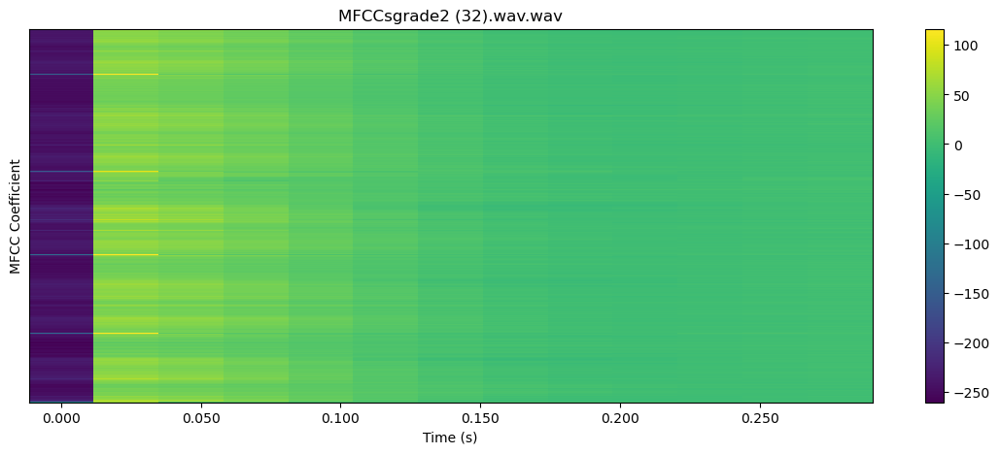

 44%|████▍     | 62/141 [02:03<03:14,  2.46s/it]

22050


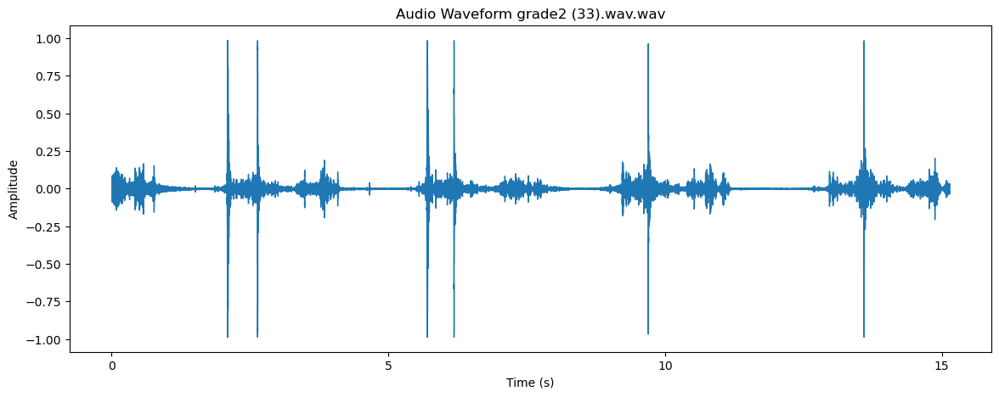

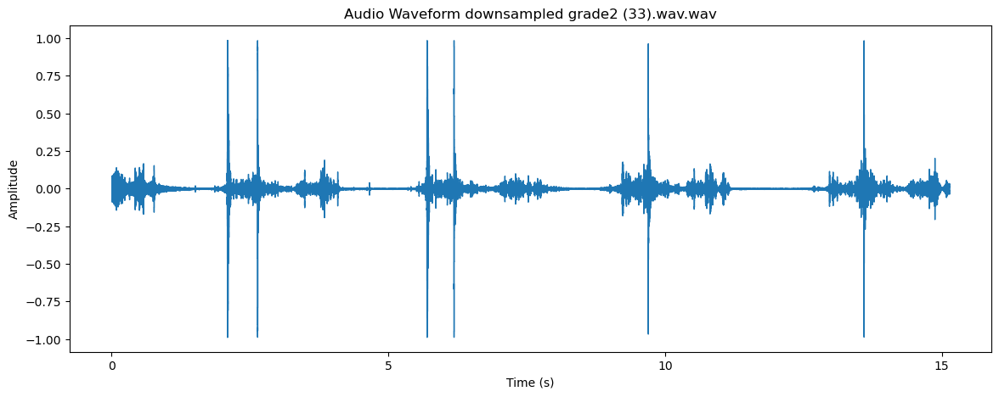

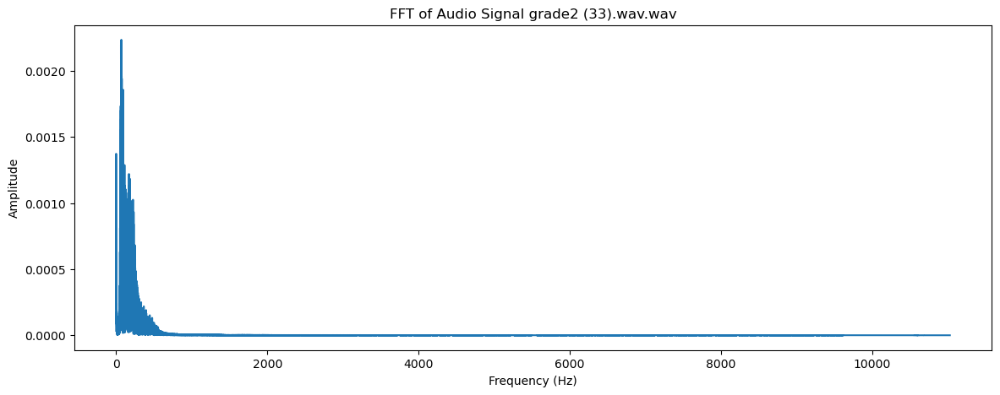

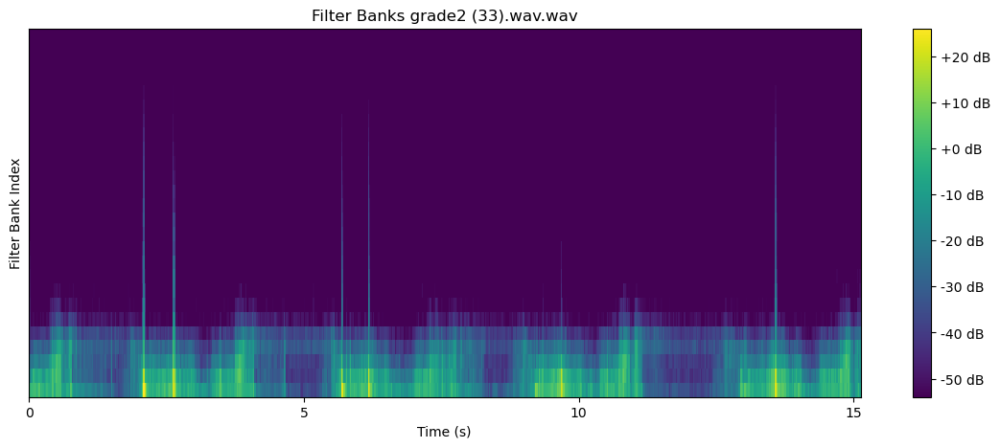

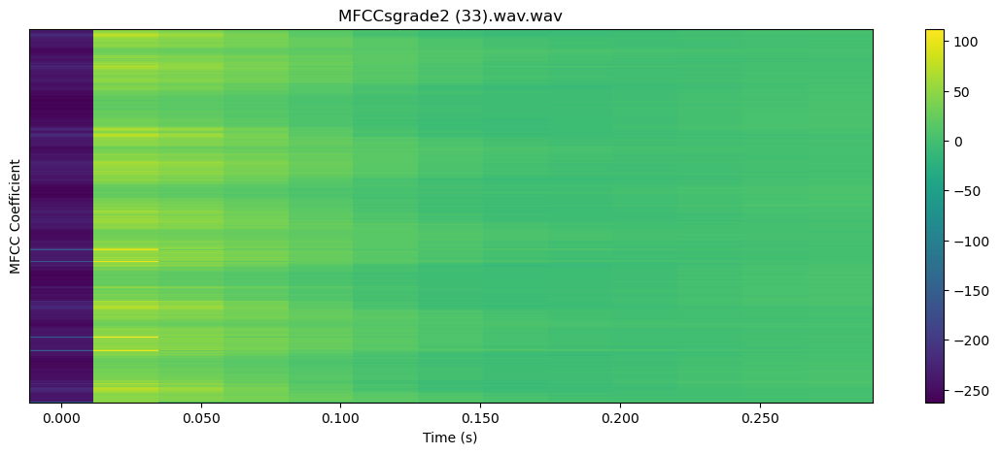

 45%|████▍     | 63/141 [02:06<03:07,  2.41s/it]

22050


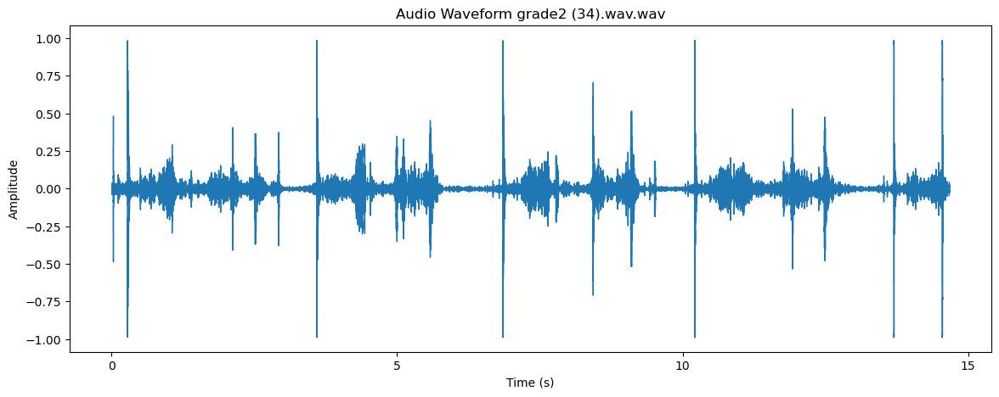

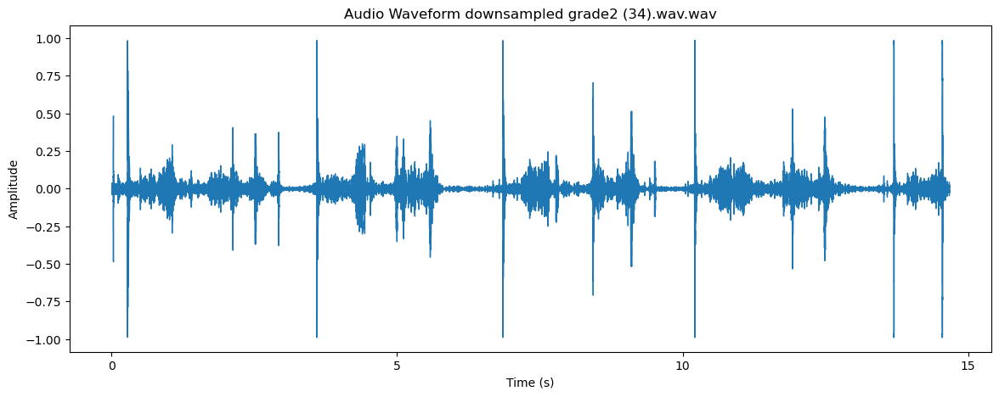

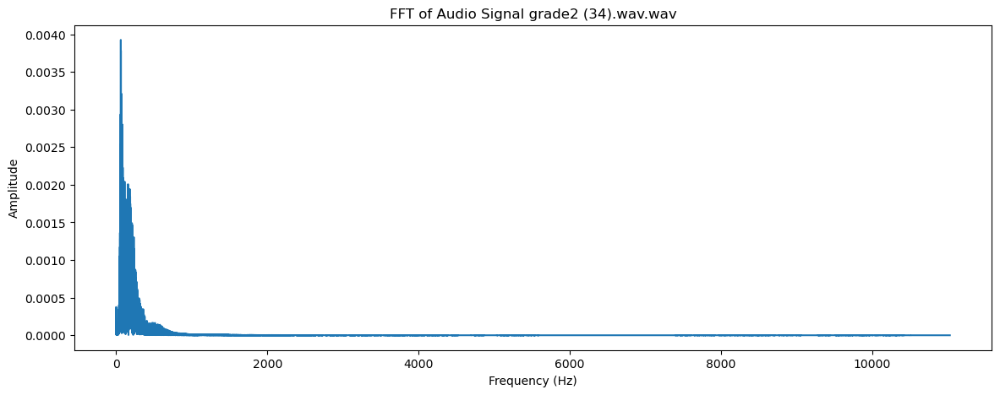

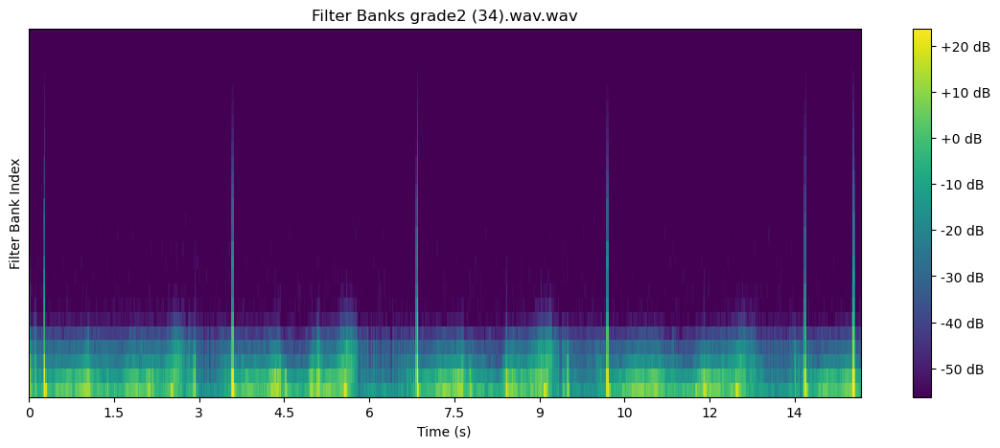

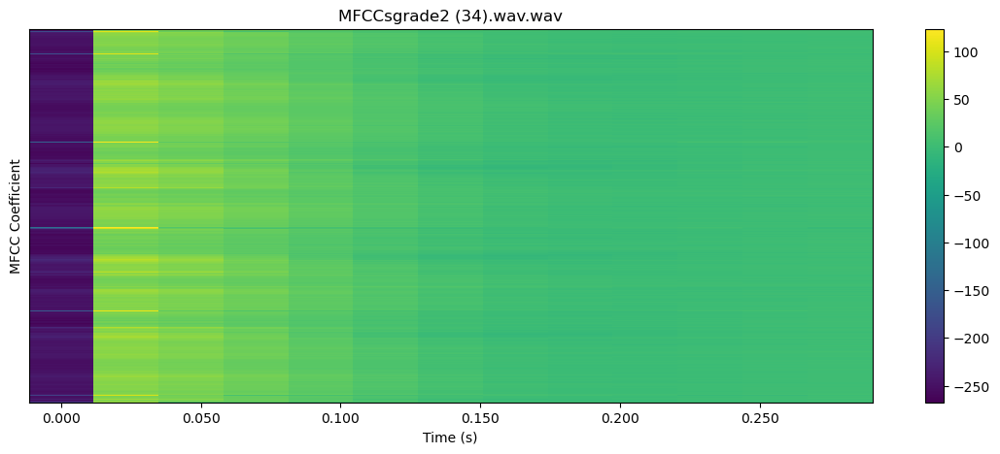

 45%|████▌     | 64/141 [02:07<02:51,  2.22s/it]

22050


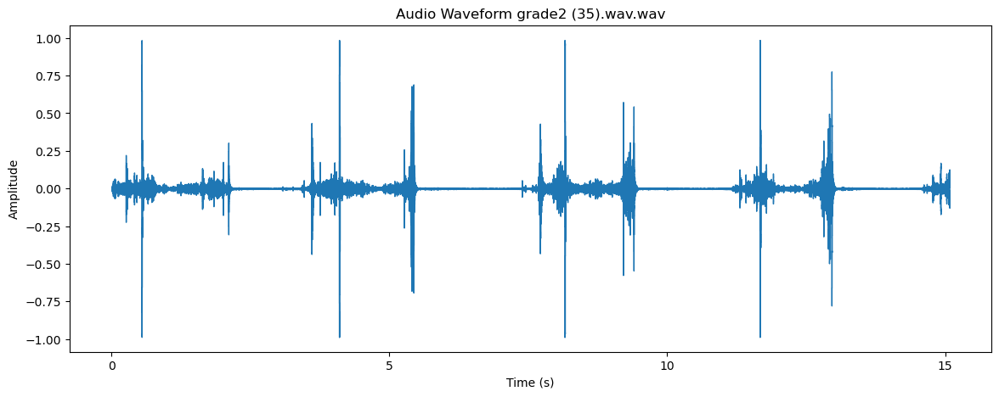

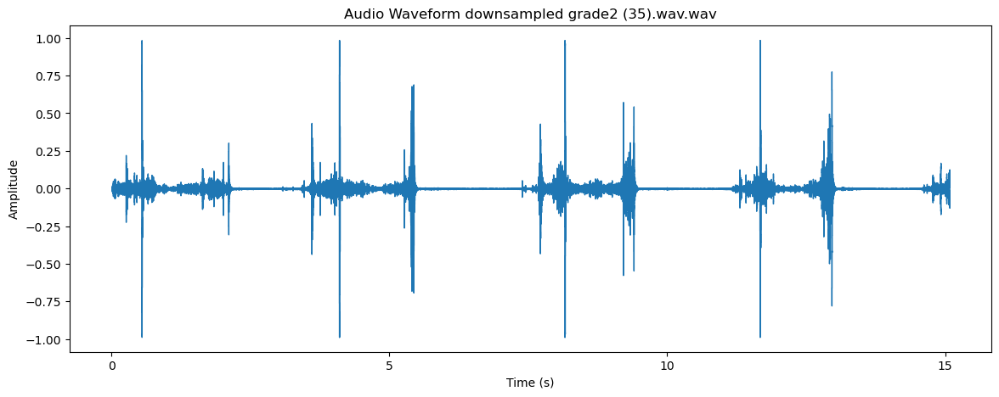

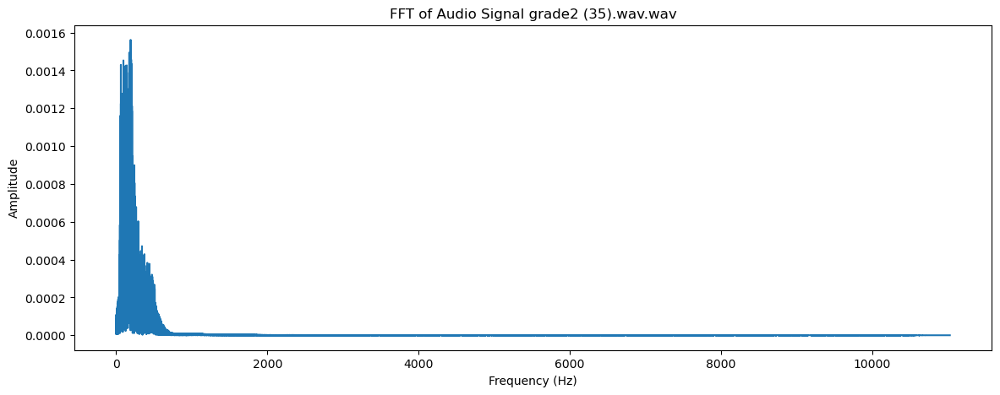

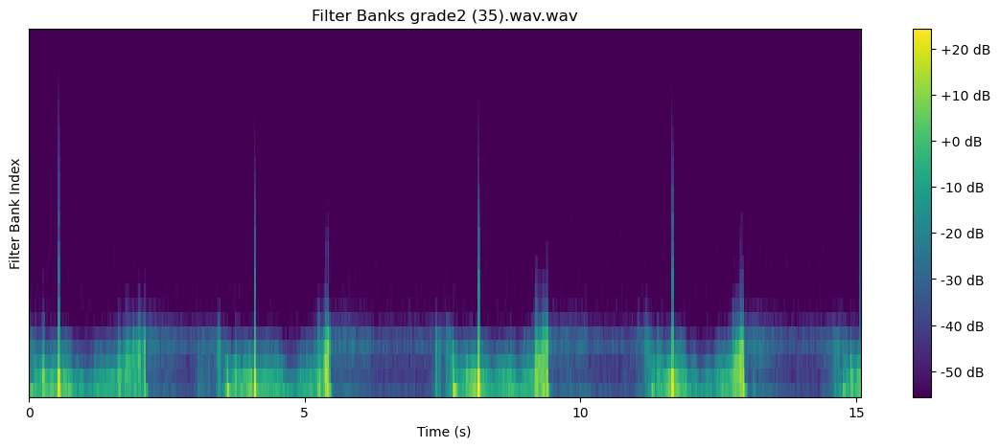

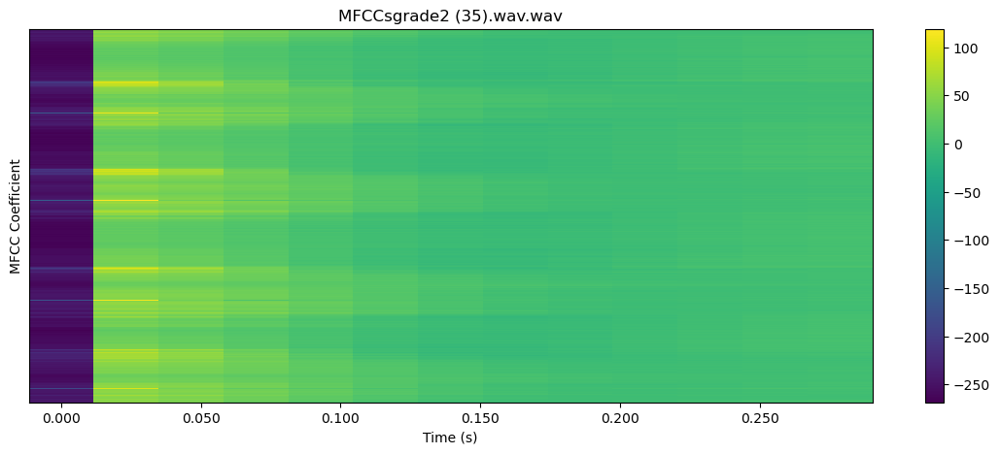

 46%|████▌     | 65/141 [02:09<02:30,  1.98s/it]

22050


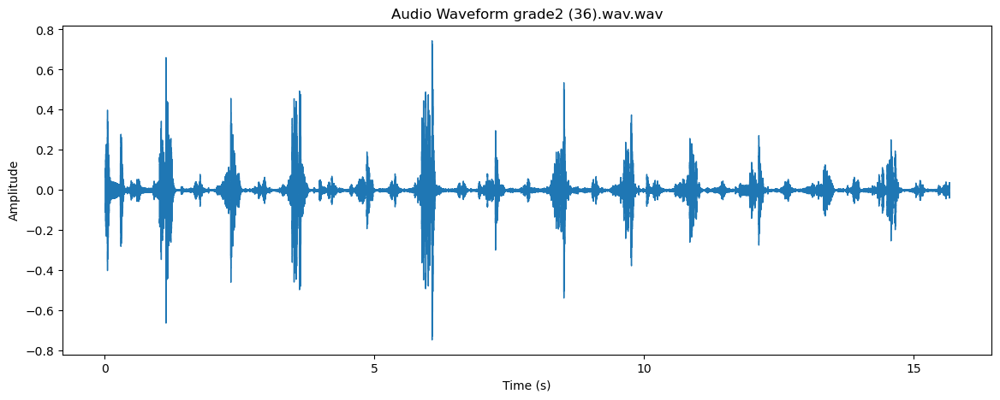

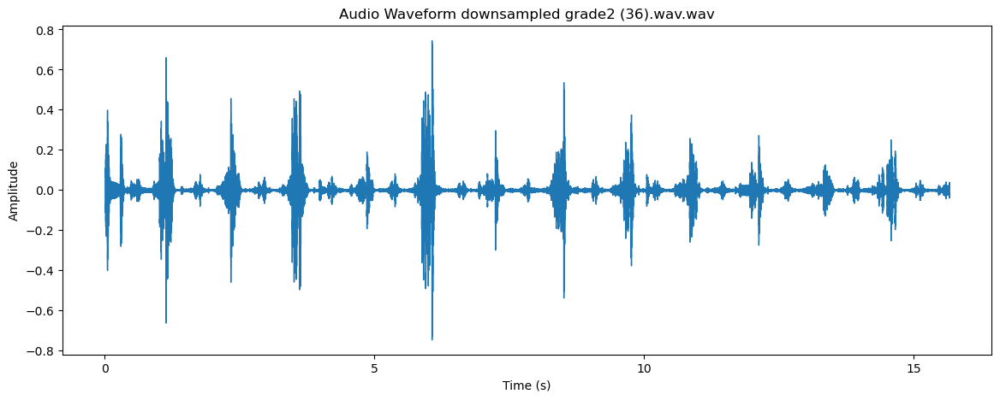

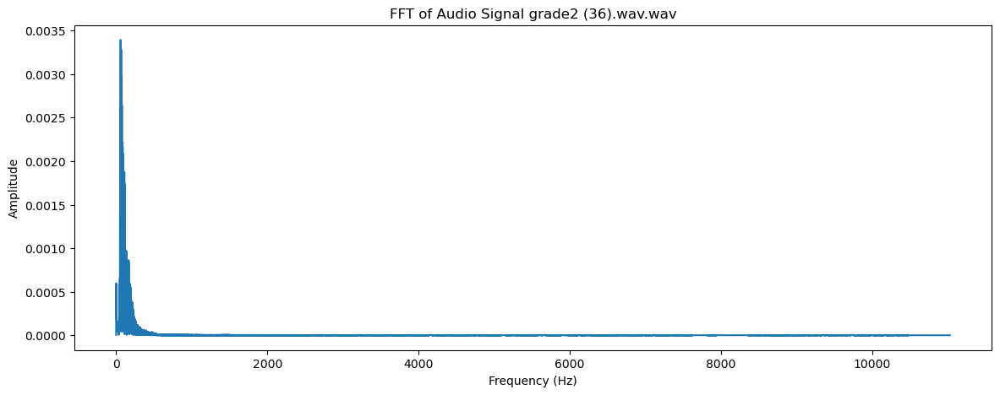

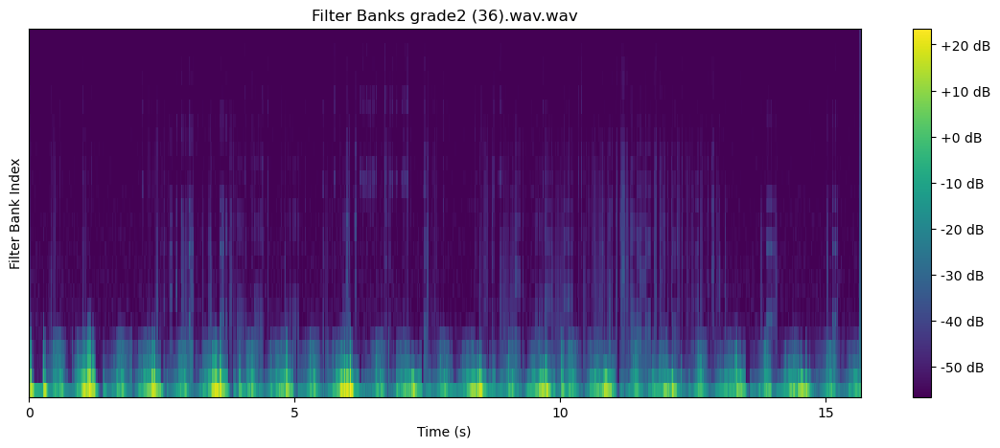

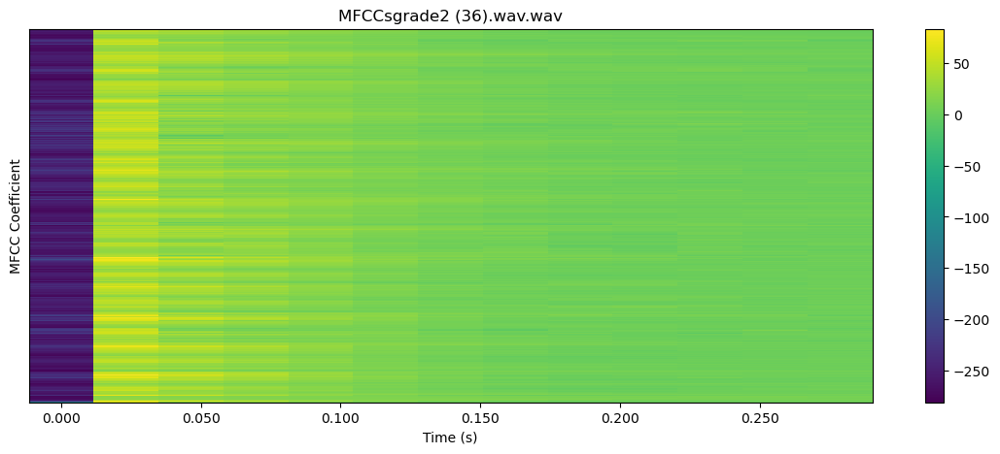

 47%|████▋     | 66/141 [02:10<02:16,  1.81s/it]

22050


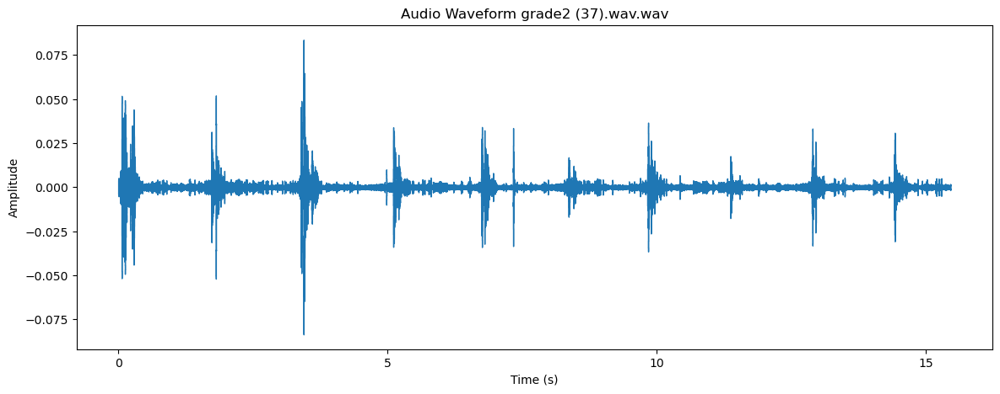

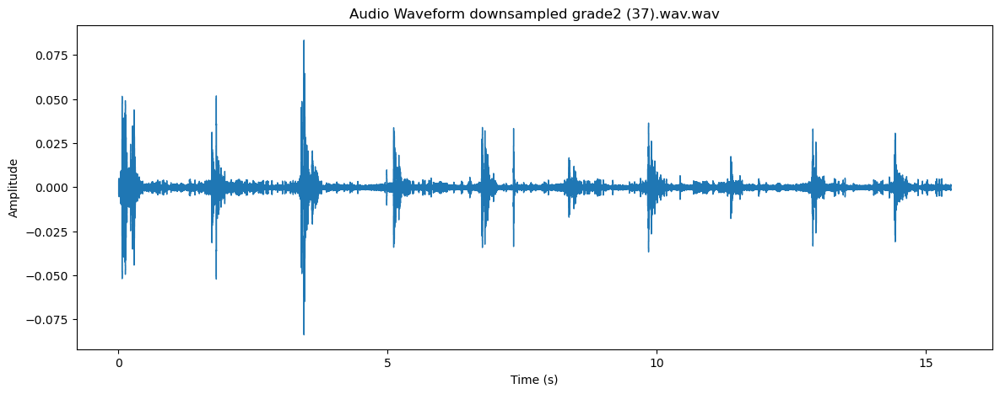

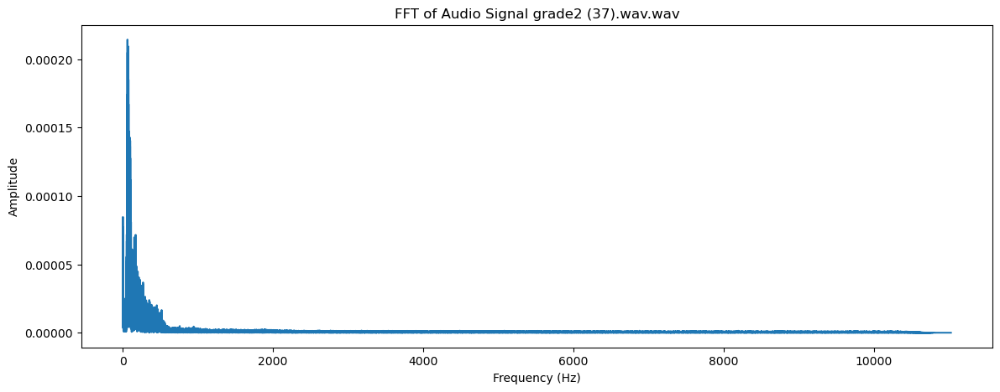

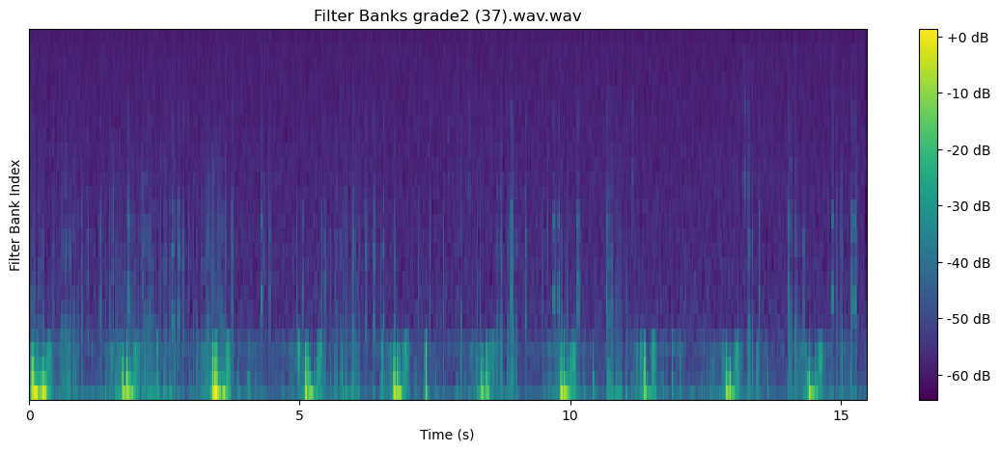

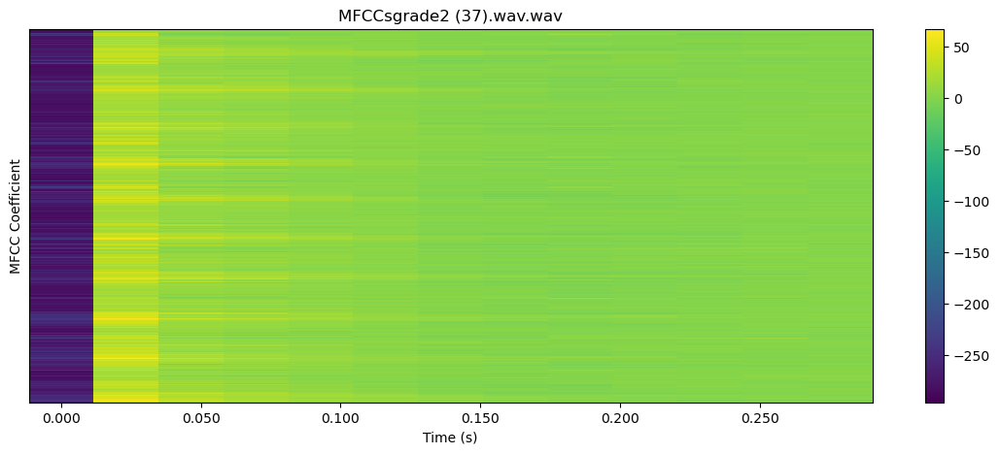

 48%|████▊     | 67/141 [02:12<02:04,  1.69s/it]

22050


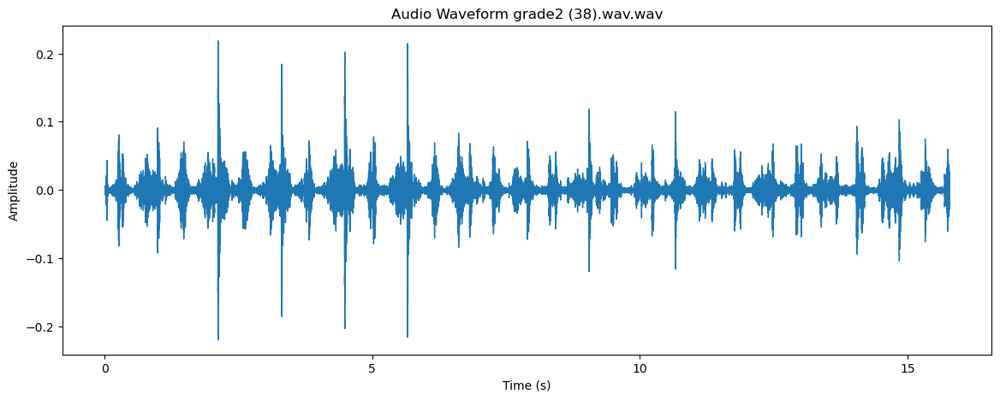

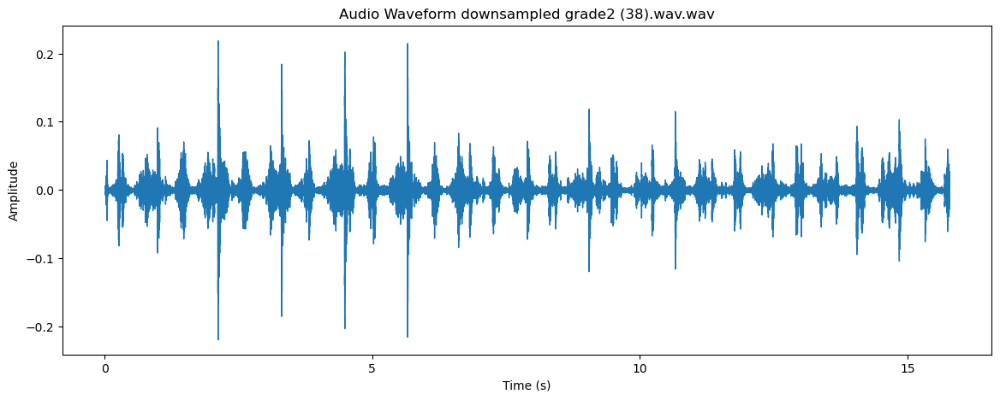

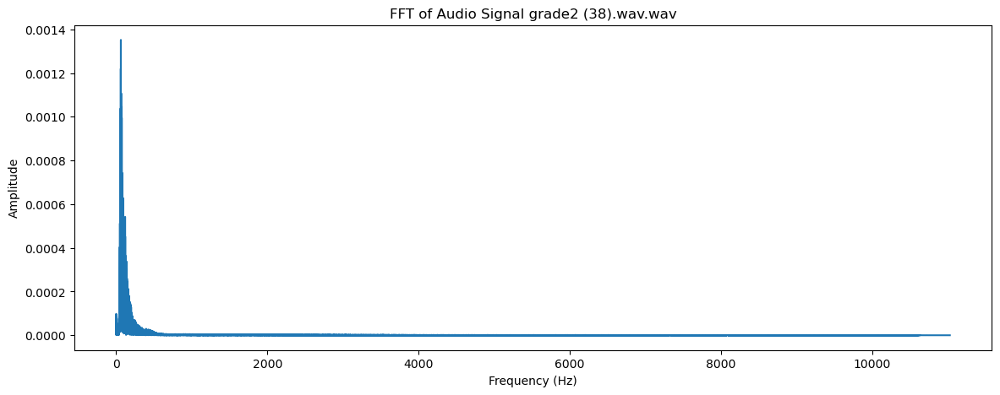

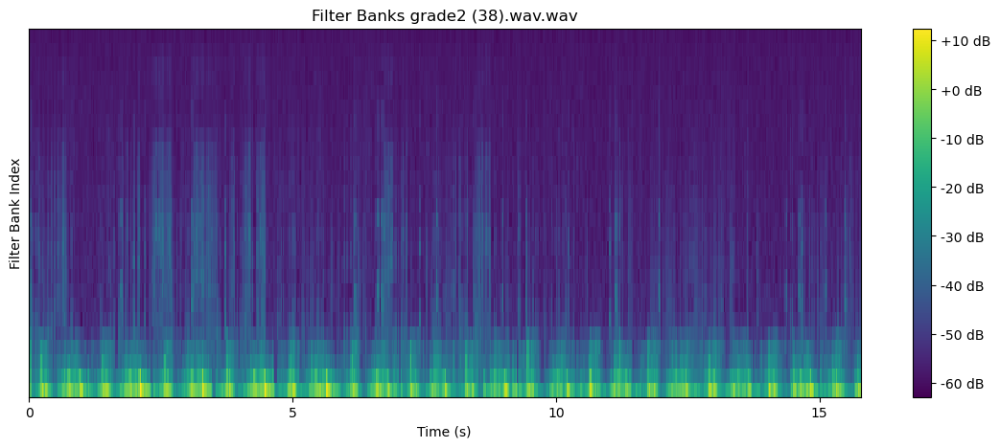

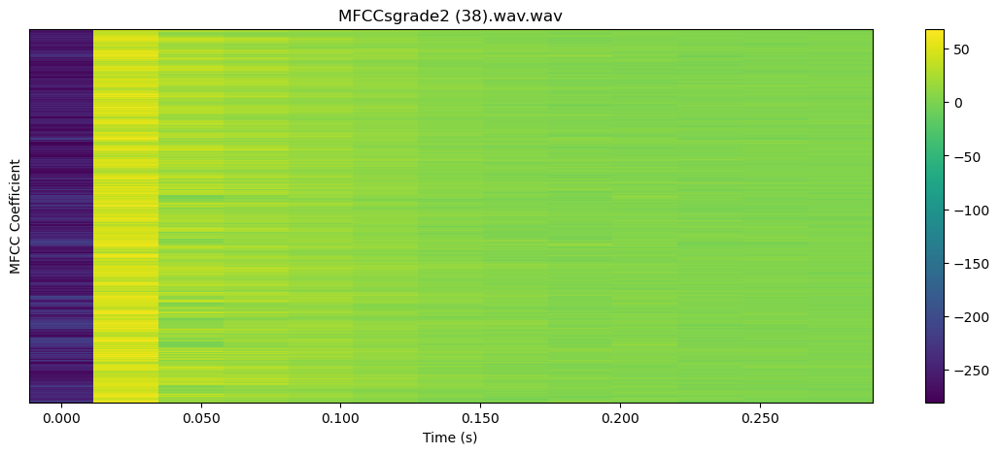

 48%|████▊     | 68/141 [02:13<02:01,  1.67s/it]

22050


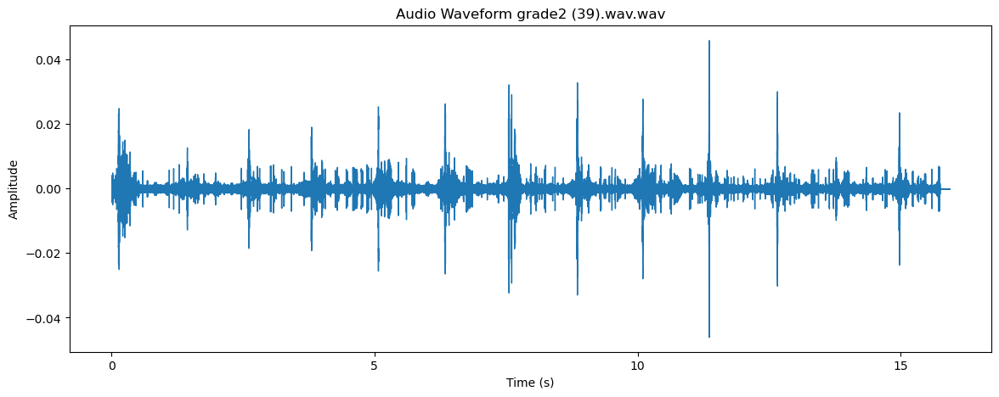

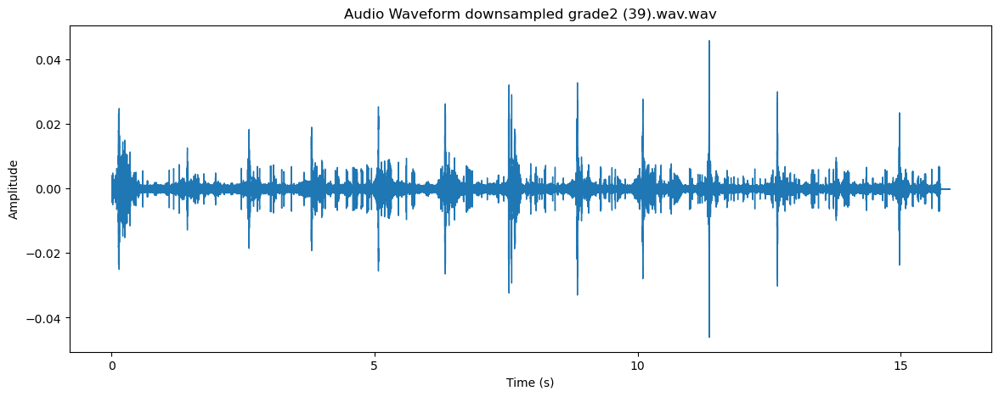

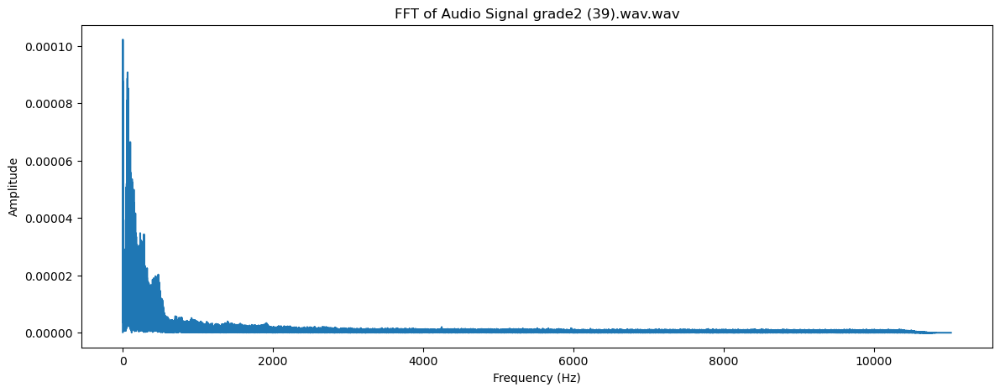

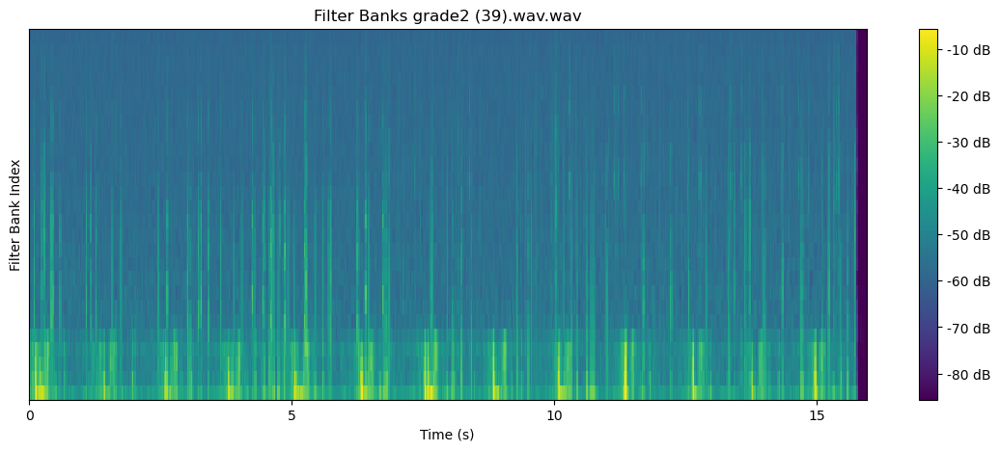

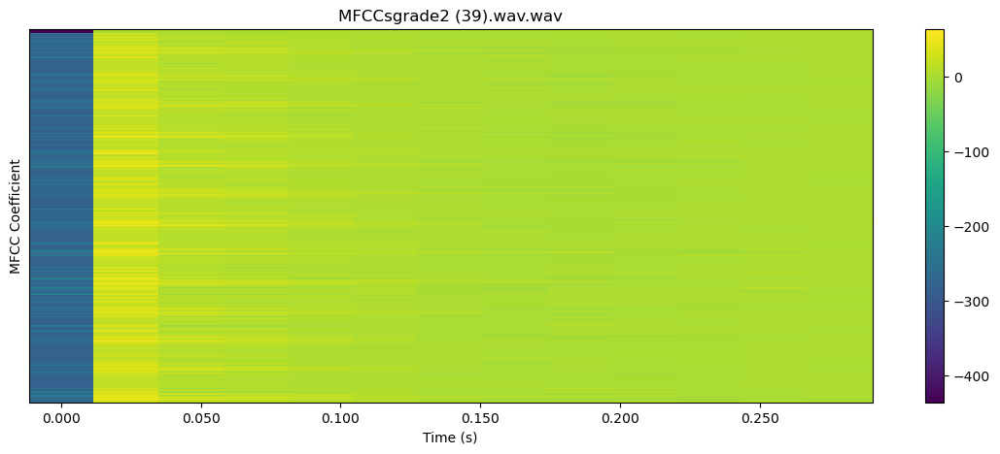

 49%|████▉     | 69/141 [02:16<02:30,  2.09s/it]

22050


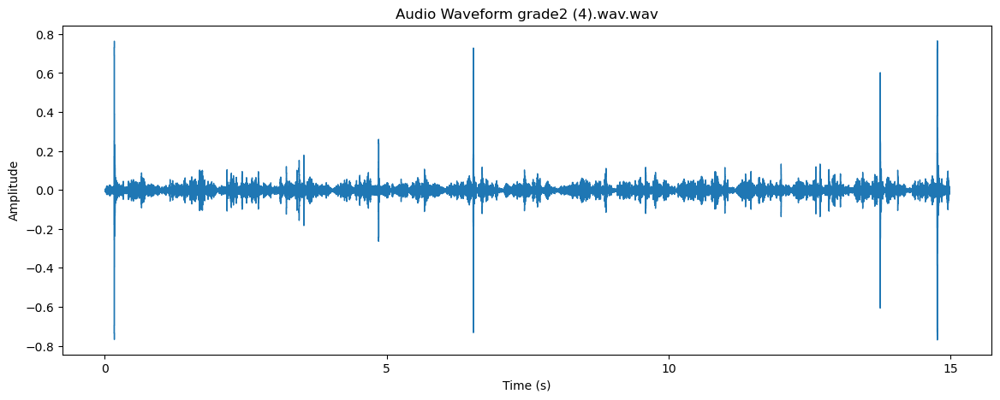

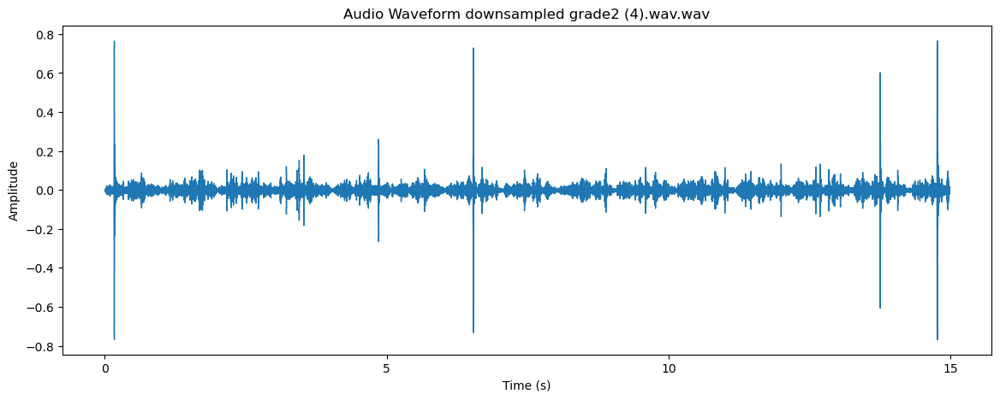

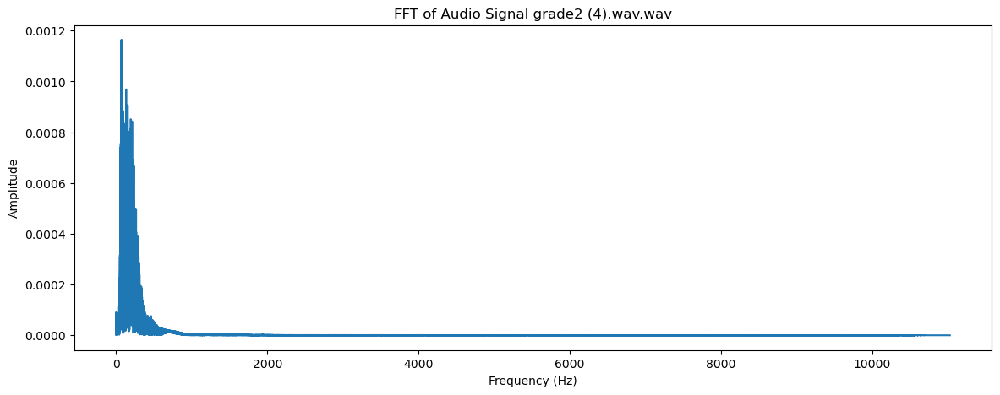

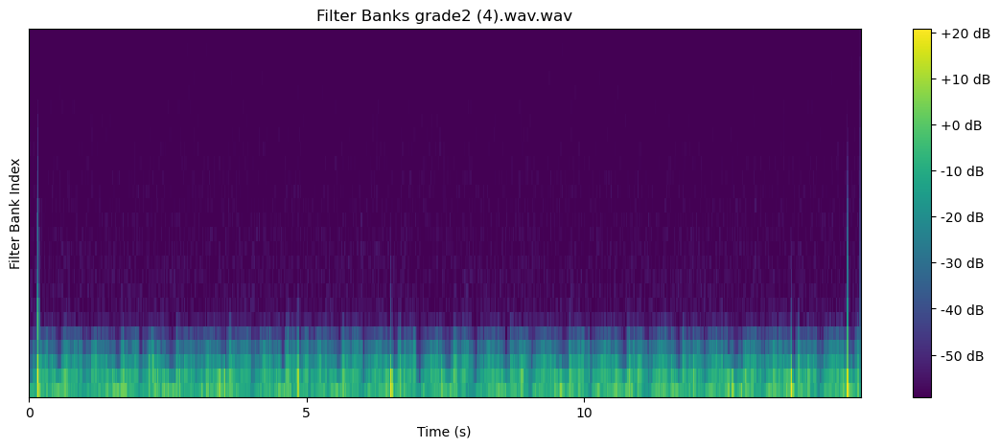

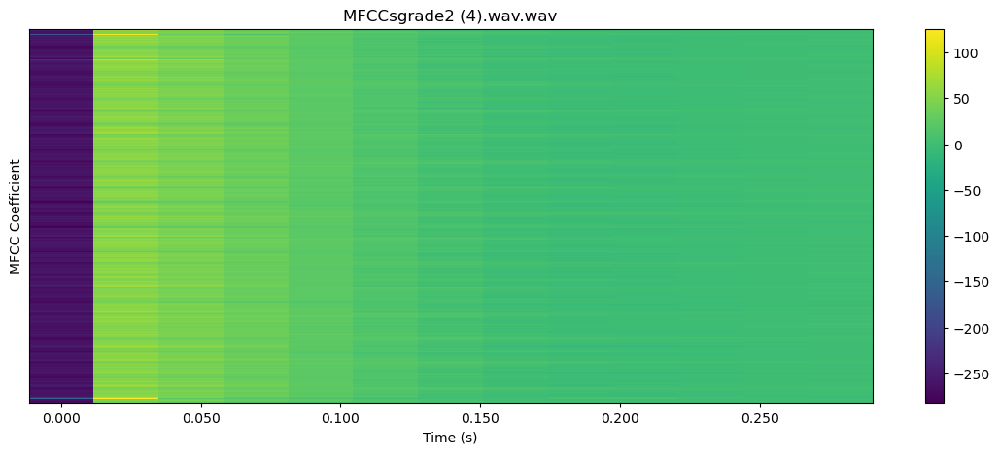

 50%|████▉     | 70/141 [02:19<02:41,  2.28s/it]

22050


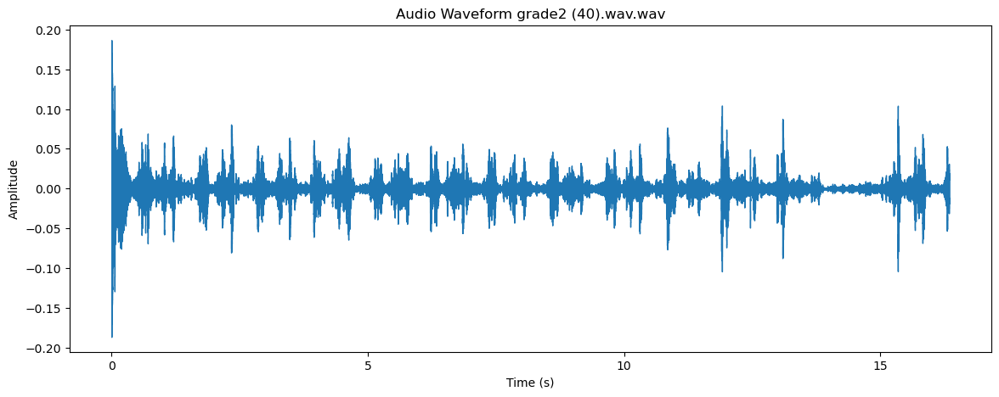

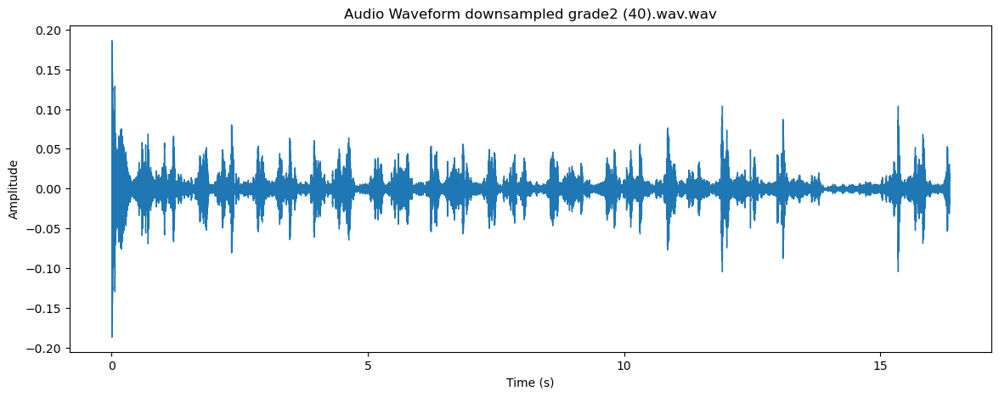

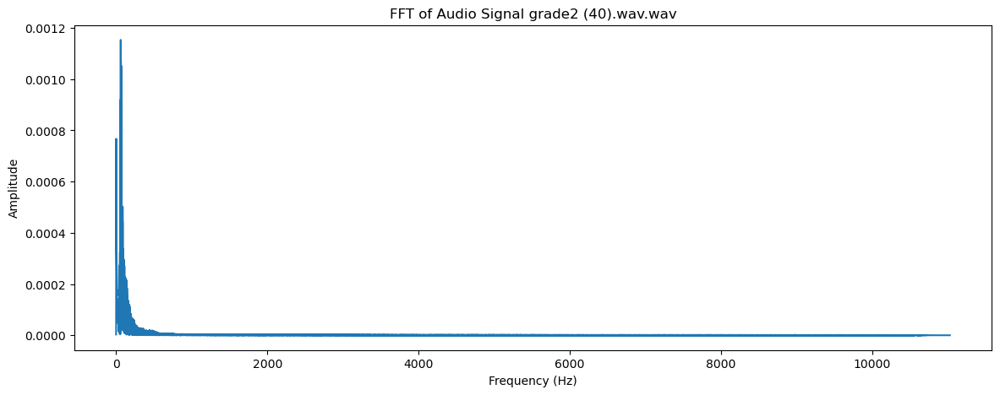

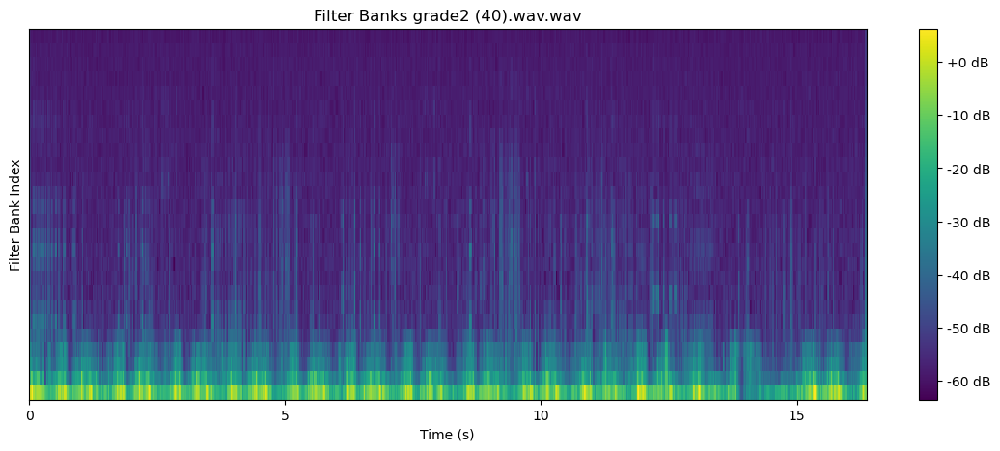

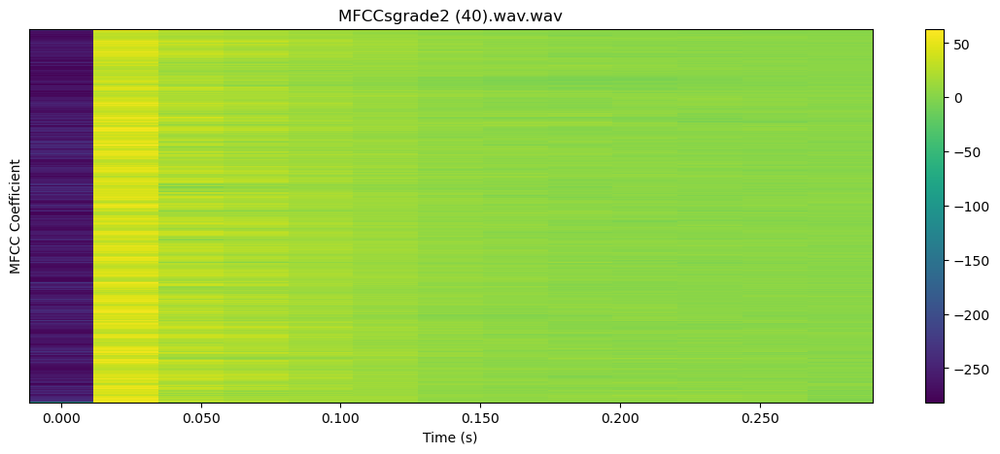

 50%|█████     | 71/141 [02:22<03:01,  2.59s/it]

22050


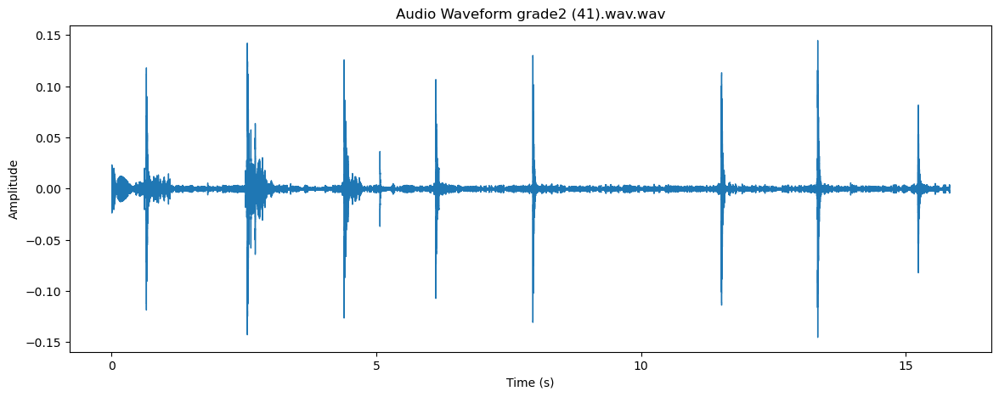

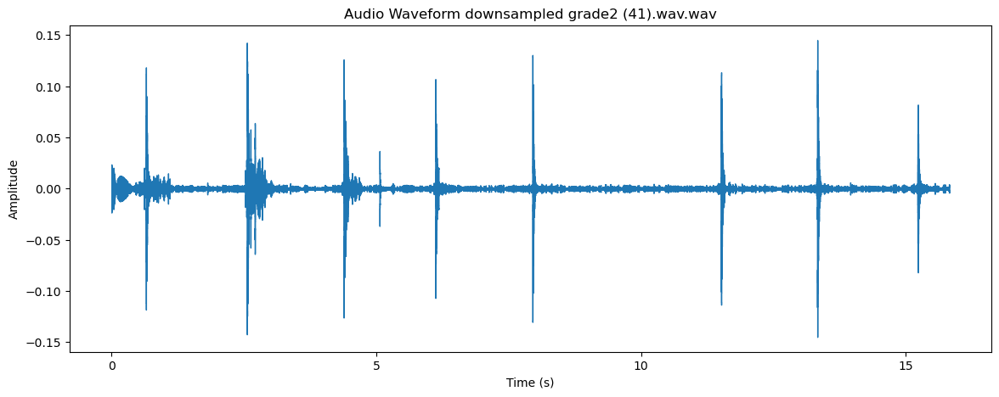

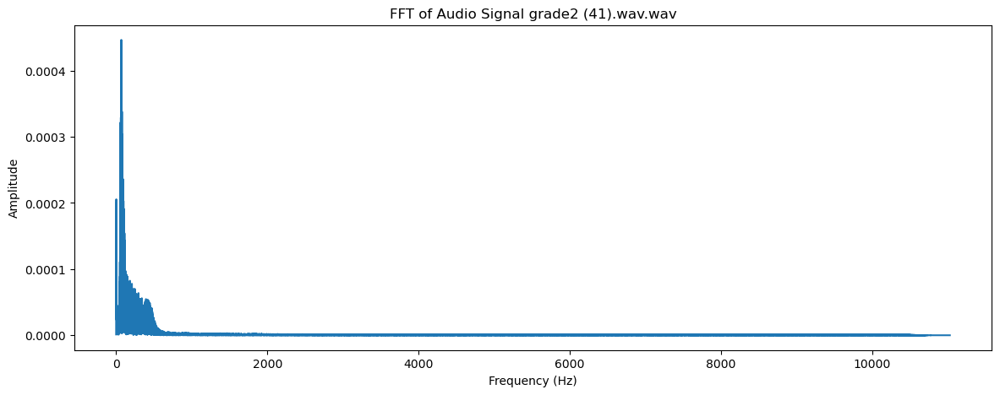

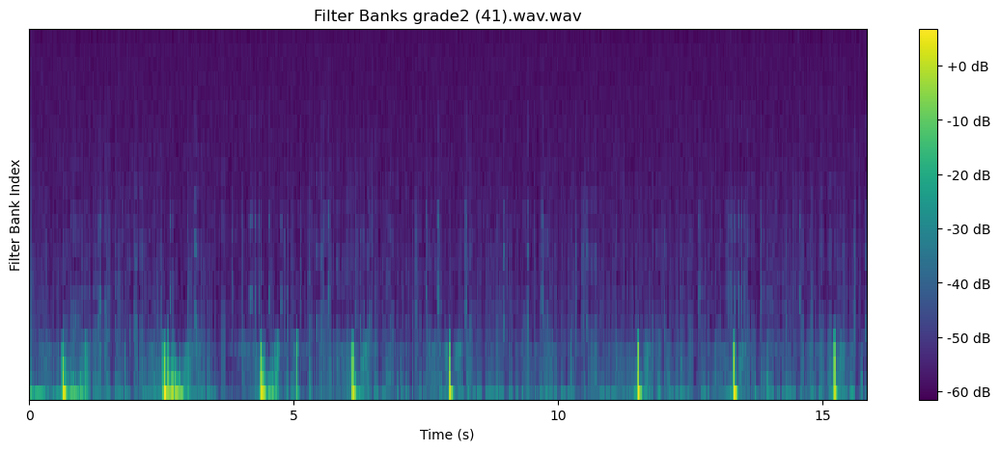

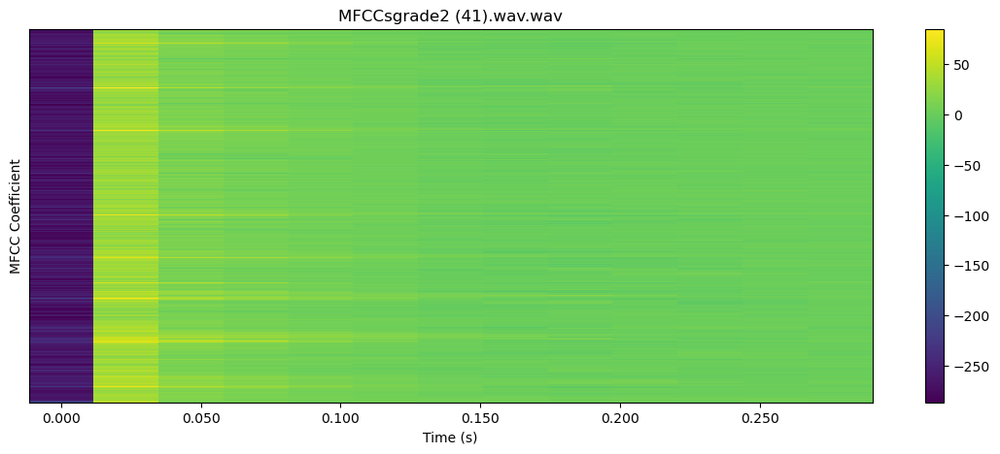

 51%|█████     | 72/141 [02:24<02:44,  2.38s/it]

22050


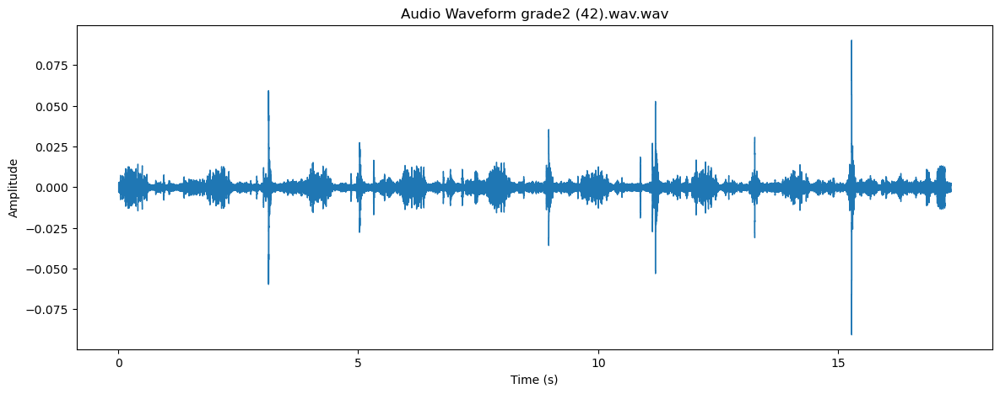

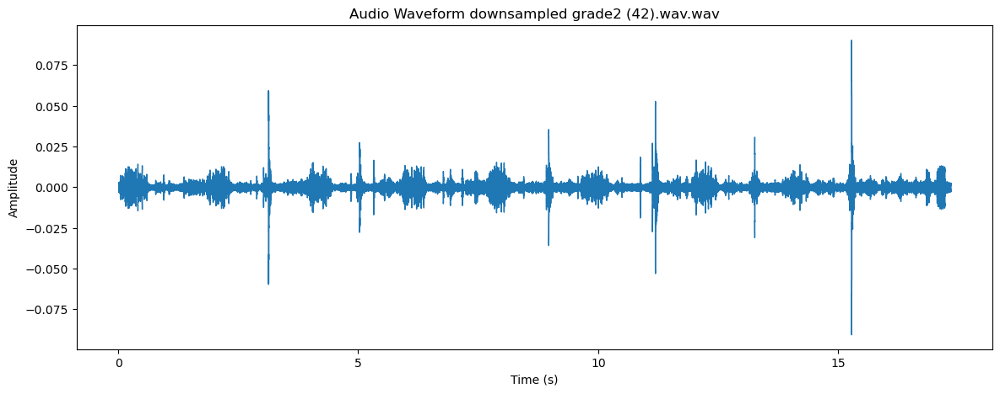

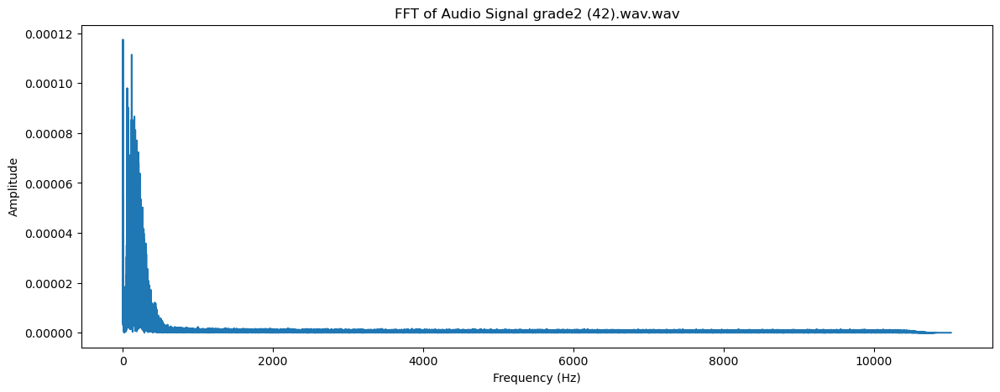

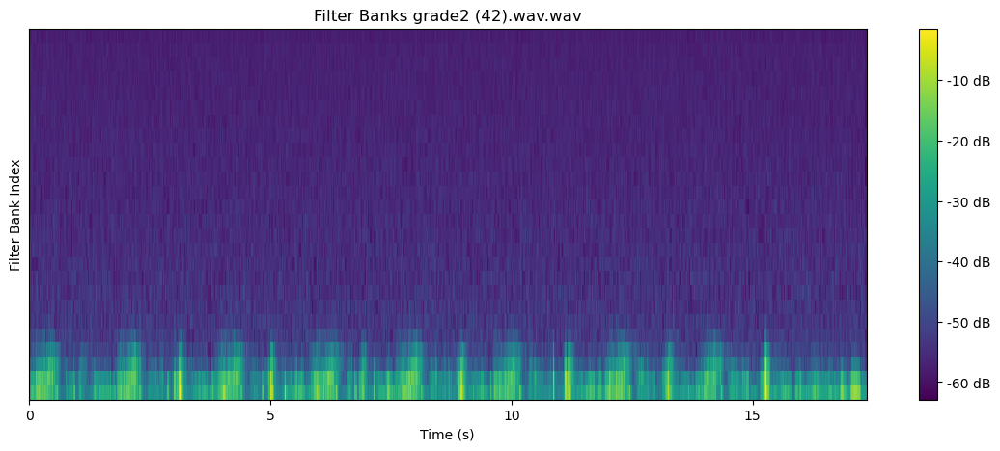

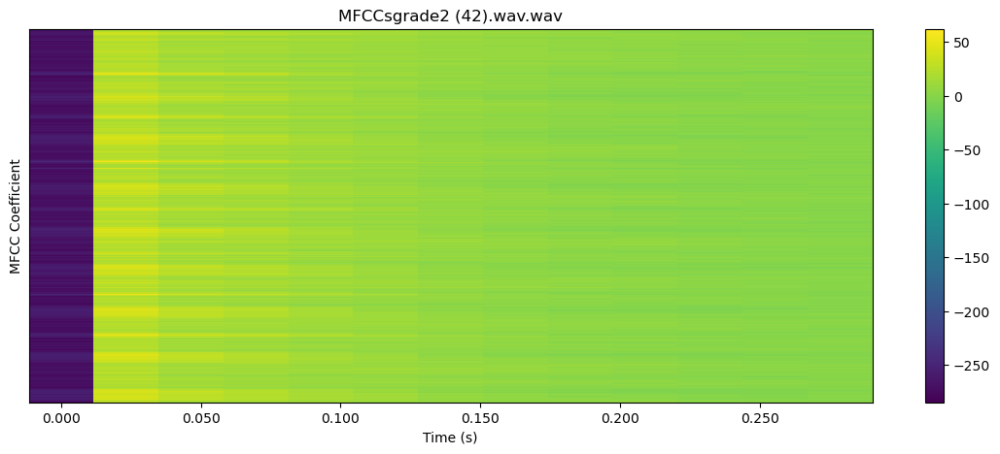

 52%|█████▏    | 73/141 [02:27<02:39,  2.35s/it]

22050


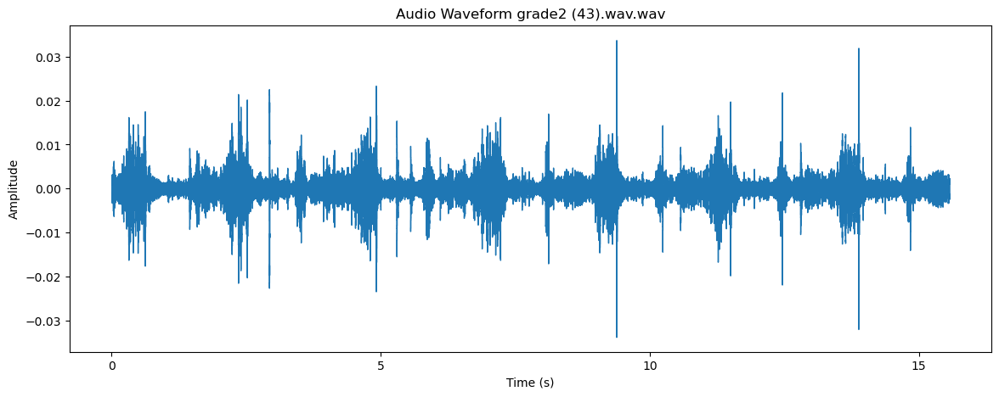

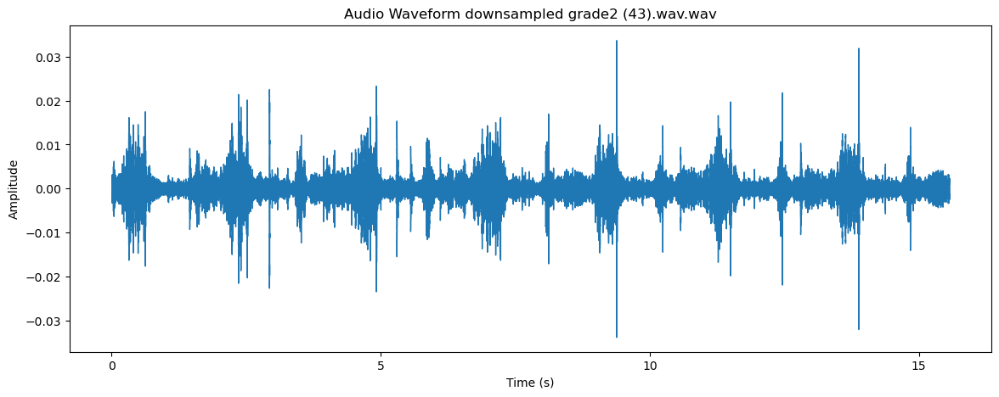

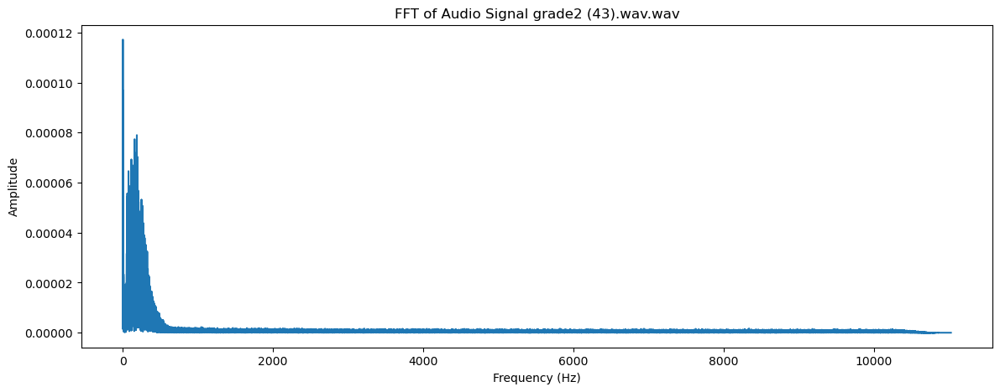

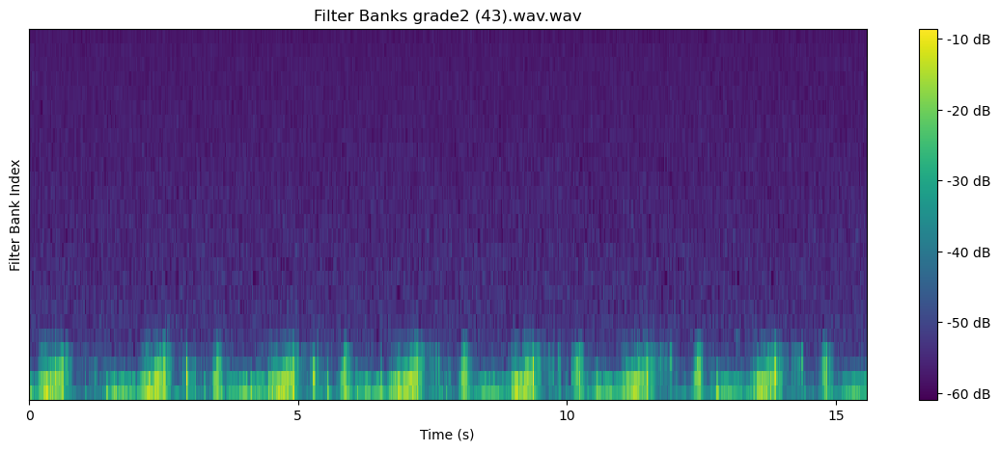

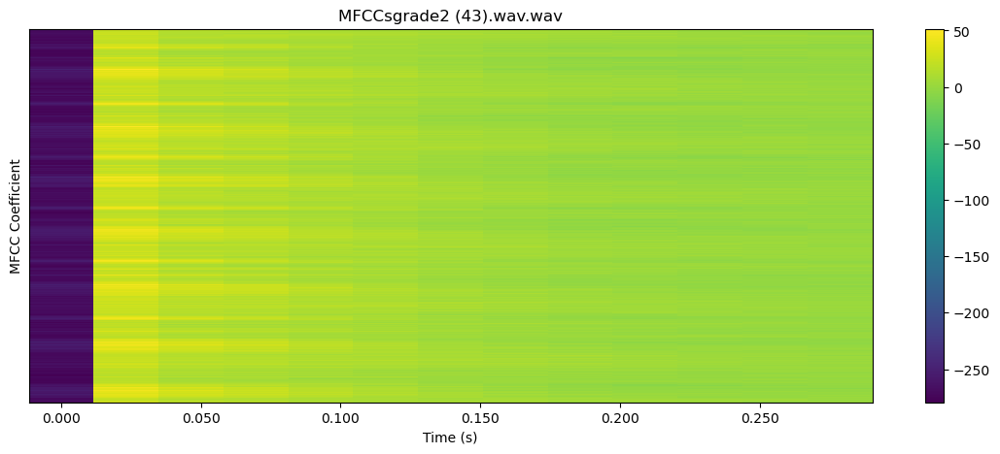

 52%|█████▏    | 74/141 [02:28<02:24,  2.16s/it]

22050


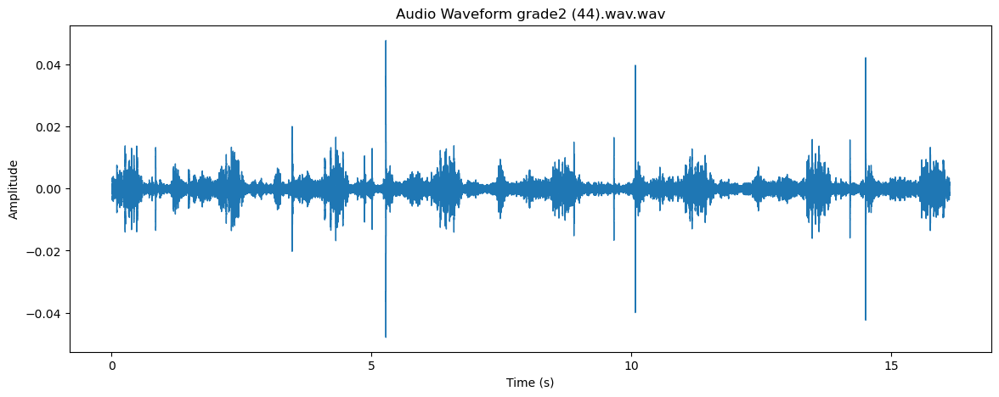

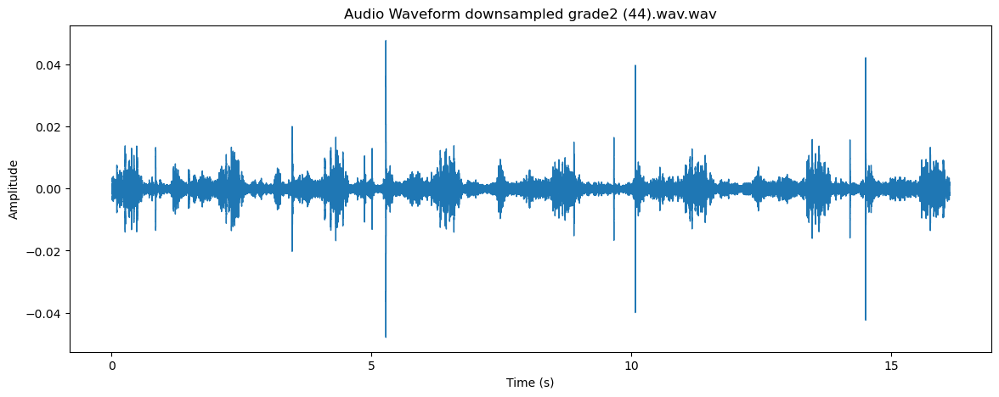

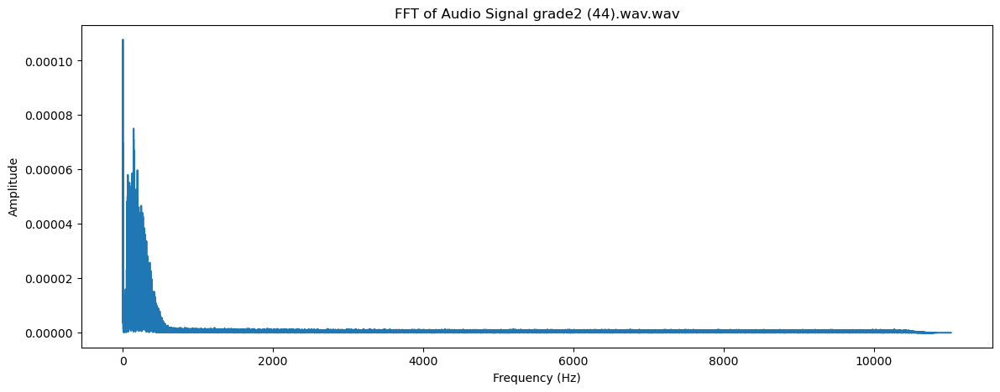

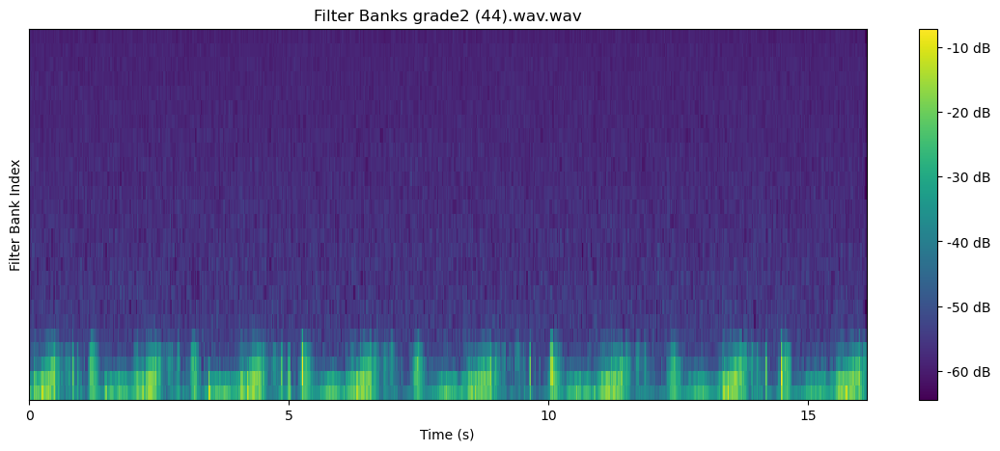

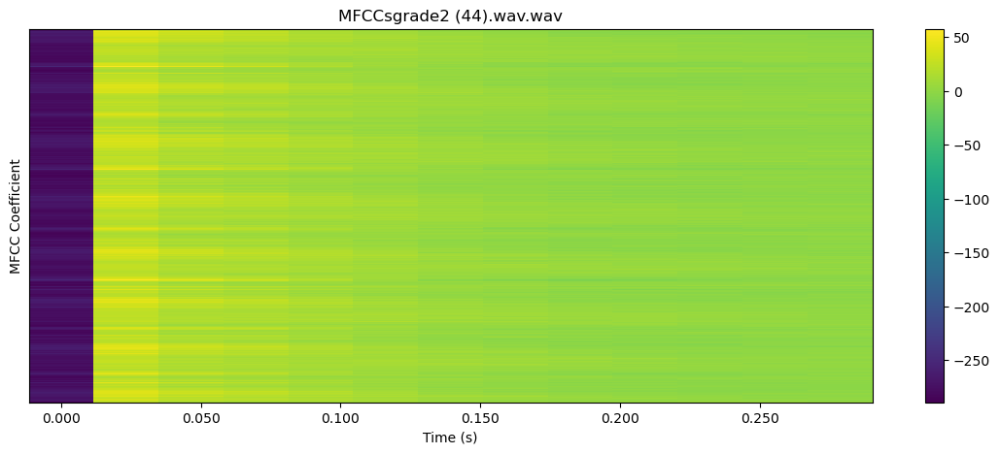

 53%|█████▎    | 75/141 [02:31<02:33,  2.33s/it]

22050


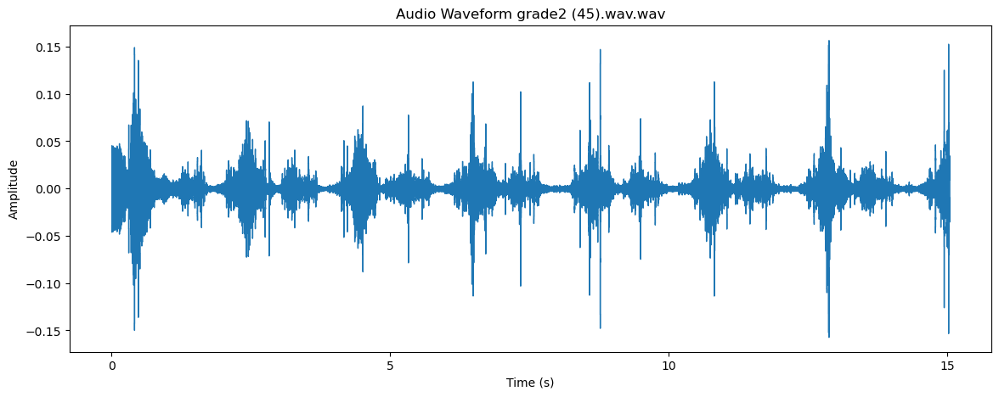

 53%|█████▎    | 75/141 [02:32<02:14,  2.04s/it]


KeyboardInterrupt: 

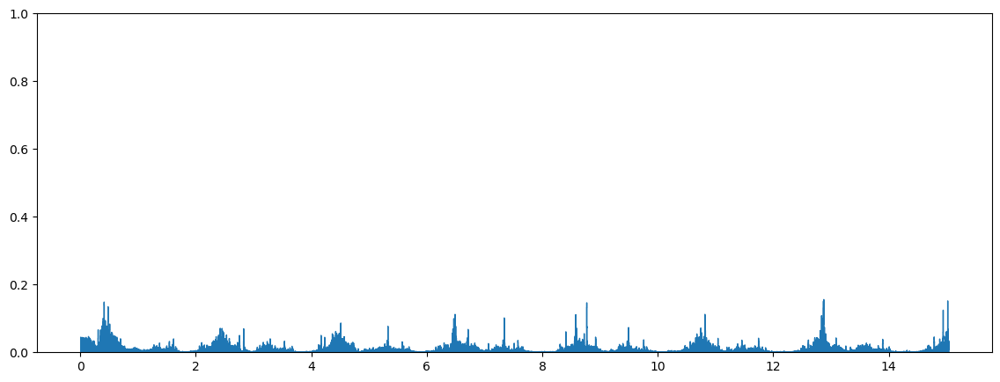

In [28]:
directory_path = 'wavfiles'

for file in tqdm(os.listdir(directory_path)):
    audio, sr = librosa.load('wavfiles/'+file, sr=22050)
    target_sr=22050
    librosa.resample(audio, orig_sr=sr, target_sr=target_sr)
    print(sr)

    def calc_fft(y , rate):
        n = len(y)

        freq = np.fft.rfftfreq( n , d = 1/rate )## calculates the frequencies corresponding to each bin in a Real-valued Fast Fourier Transform (RFFT).
        Y = abs(np.fft.rfft(y)/n)  ##magnitude (of a complex number) , /n is done to scale/normalise the length
        return (Y , freq)
    Y , freq = calc_fft(audio , sr)

    # Calculate filter banks
    filter_banks = librosa.feature.melspectrogram(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mels=26)

    # Convert filter banks to log scale
    log_filter_banks = librosa.power_to_db(filter_banks)

    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_fft=1200, hop_length=512, n_mfcc=13, n_mels=26)

    # Transpose for better visualization
    mfccs = mfccs.T
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(audio, sr=sr)
    plt.title('Audio Waveform downsampled '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()

    plt.figure(figsize=(14, 5))
    plt.plot(freq, Y)
    plt.title('FFT of Audio Signal '+file+'.wav')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')
    plt.show()


    plt.figure(figsize=(14, 5))
    librosa.display.specshow(log_filter_banks, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Filter Banks '+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('Filter Bank Index')
    plt.show()


    # Plot MFCCs
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(mfccs, sr=sr, hop_length=512, x_axis='time', cmap='viridis')
    plt.colorbar()
    plt.title('MFCCs'+file+'.wav')
    plt.xlabel('Time (s)')
    plt.ylabel('MFCC Coefficient')
    plt.show()


In [184]:
def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T
def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')
def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio, sr = librosa.load(audio_path, sr=target_sr)  # Load audio and sample rate
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=20).T
    mfccs = pad_or_truncate_mfccs(mfccs, target_length=141)  # Adjust target_length to match the expected input shape
    return mfccs.reshape(1, mfccs.shape[0], mfccs.shape[1], 1)  # Reshape for prediction
  # Reshape for prediction



directory_path = 'test'

for file in tqdm(os.listdir(directory_path)):
    # Predict the class
    audio_path = 'test/'+file  # Replace with the actual path
    mfccs_test = preprocess_audio(audio_path)
    prediction = model.predict(mfccs_test)
    predicted_class = np.argmax(prediction)  # Get the index of the predicted class

    # Map the index back to the class label (if applicable)
    class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
    predicted_label = class_mapping[predicted_class]

    print("Predicted class for "+file +":", predicted_class)
    print("Predicted label"+file +":", predicted_label)

  0%|          | 0/19 [00:00<?, ?it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▌         | 1/19 [00:00<00:02,  8.64it/s]

Predicted class for grade4.wav: 2
Predicted labelgrade4.wav: grade3
1/1 [==============================] - 0s 24ms/step


 11%|█         | 2/19 [00:00<00:02,  7.86it/s]

Predicted class for test (10).wav: 1
Predicted labeltest (10).wav: grade2
1/1 [==============================] - 0s 30ms/step
Predicted class for test (11).wav: 0
Predicted labeltest (11).wav: grade1
1/1 [==============================] - 0s 20ms/step


 21%|██        | 4/19 [00:00<00:01,  9.17it/s]

Predicted class for test (12).wav: 0
Predicted labeltest (12).wav: grade1
1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 5/19 [00:00<00:01,  9.18it/s]

Predicted class for test (13).wav: 0
Predicted labeltest (13).wav: grade1
1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 6/19 [00:00<00:01,  9.40it/s]

Predicted class for test (14).wav: 0
Predicted labeltest (14).wav: grade1
1/1 [==============================] - 0s 15ms/step


 37%|███▋      | 7/19 [00:00<00:01,  9.15it/s]

Predicted class for test (15).wav: 0
Predicted labeltest (15).wav: grade1
1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 8/19 [00:00<00:01,  8.94it/s]

Predicted class for test (16).wav: 2
Predicted labeltest (16).wav: grade3
1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 9/19 [00:01<00:01,  8.91it/s]

Predicted class for test (17).wav: 1
Predicted labeltest (17).wav: grade2
1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 10/19 [00:01<00:01,  7.68it/s]

Predicted class for test (2).wav: 1
Predicted labeltest (2).wav: grade2
1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 11/19 [00:01<00:01,  7.18it/s]

Predicted class for test (3).wav: 1
Predicted labeltest (3).wav: grade2
1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 12/19 [00:01<00:01,  6.97it/s]

Predicted class for test (4).wav: 1
Predicted labeltest (4).wav: grade2
1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 13/19 [00:01<00:00,  6.86it/s]

Predicted class for test (5).wav: 1
Predicted labeltest (5).wav: grade2
1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 14/19 [00:01<00:00,  6.98it/s]

Predicted class for test (6).wav: 1
Predicted labeltest (6).wav: grade2
1/1 [==============================] - 0s 14ms/step


 79%|███████▉  | 15/19 [00:01<00:00,  6.71it/s]

Predicted class for test (7).wav: 1
Predicted labeltest (7).wav: grade2
1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 16/19 [00:02<00:00,  6.69it/s]

Predicted class for test (8).wav: 1
Predicted labeltest (8).wav: grade2
1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 17/19 [00:02<00:00,  6.69it/s]

Predicted class for test (9).wav: 1
Predicted labeltest (9).wav: grade2
1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 18/19 [00:02<00:00,  6.46it/s]

Predicted class for test_1.wav: 1
Predicted labeltest_1.wav: grade2
1/1 [==============================] - 0s 28ms/step


100%|██████████| 19/19 [00:02<00:00,  7.33it/s]

Predicted class for test_online.wav: 1
Predicted labeltest_online.wav: grade2


In [187]:
directory_path = 'test'

# Initialize an empty DataFrame
test = pd.DataFrame(columns=['File', 'Predicted_Class'])

for file in tqdm(os.listdir(directory_path)):
        # Predict the class
        audio_path = os.path.join(directory_path, file)
        mfccs_test = preprocess_audio(audio_path)  # Assuming you have a function preprocess_audio
        prediction = model.predict(mfccs_test)
        predicted_class = np.argmax(prediction)

        # Map the index back to the class label (if applicable)
        class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
        predicted_label = class_mapping[predicted_class]

        # Append the result to the DataFrame
        test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

# Display the DataFrame
print(test)

  0%|          | 0/19 [00:00<?, ?it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  5%|▌         | 1/19 [00:00<00:02,  7.63it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 11%|█         | 2/19 [00:00<00:02,  6.50it/s]

1/1 [==============================] - 0s 34ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 16%|█▌        | 3/19 [00:00<00:02,  7.17it/s]

1/1 [==============================] - 0s 19ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 21%|██        | 4/19 [00:00<00:02,  7.44it/s]

1/1 [==============================] - 0s 20ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 26%|██▋       | 5/19 [00:00<00:01,  7.29it/s]

1/1 [==============================] - 0s 32ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 32%|███▏      | 6/19 [00:00<00:01,  7.32it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 37%|███▋      | 7/19 [00:00<00:01,  7.37it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 42%|████▏     | 8/19 [00:01<00:01,  7.12it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 47%|████▋     | 9/19 [00:01<00:01,  6.91it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 53%|█████▎    | 10/19 [00:01<00:01,  5.72it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 58%|█████▊    | 11/19 [00:01<00:01,  5.09it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 63%|██████▎   | 12/19 [00:01<00:01,  4.75it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 68%|██████▊   | 13/19 [00:02<00:01,  4.30it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 74%|███████▎  | 14/19 [00:02<00:01,  4.20it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 79%|███████▉  | 15/19 [00:02<00:01,  3.93it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 84%|████████▍ | 16/19 [00:03<00:00,  3.80it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 89%|████████▉ | 17/19 [00:03<00:00,  3.71it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 95%|█████████▍| 18/19 [00:03<00:00,  3.64it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1530403964.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test = test.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
100%|██████████| 19/19 [00:04<00:00,  4.74it/s]

               File Predicted_Class
0        grade4.wav          grade3
1     test (10).wav          grade2
2     test (11).wav          grade1
3     test (12).wav          grade1
4     test (13).wav          grade1
5     test (14).wav          grade1
6     test (15).wav          grade1
7     test (16).wav          grade3
8     test (17).wav          grade2
9      test (2).wav          grade2
10     test (3).wav          grade2
11     test (4).wav          grade2
12     test (5).wav          grade2
13     test (6).wav          grade2
14     test (7).wav          grade2
15     test (8).wav          grade2
16     test (9).wav          grade2
17       test_1.wav          grade2
18  test_online.wav          grade2


In [188]:
directory_path = 'wavfiles'

# Initialize an empty DataFrame
train = pd.DataFrame(columns=['File', 'Predicted_Class'])

for file in tqdm(os.listdir(directory_path)):
        # Predict the class
        audio_path = os.path.join(directory_path, file)
        mfccs_test = preprocess_audio(audio_path)  # Assuming you have a function preprocess_audio
        prediction = model.predict(mfccs_test)
        predicted_class = np.argmax(prediction)

        # Map the index back to the class label (if applicable)
        class_mapping = {0: 'grade1', 1: 'grade2', 2: 'grade3', 3: 'grade4'}  # Adjust accordingly
        predicted_label = class_mapping[predicted_class]

        # Append the result to the DataFrame
        train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)

# Display the DataFrame

  0%|          | 0/141 [00:00<?, ?it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  1%|          | 1/141 [00:00<00:18,  7.62it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  1%|▏         | 2/141 [00:00<00:19,  7.10it/s]

1/1 [==============================] - 0s 22ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  2%|▏         | 3/141 [00:00<00:19,  7.19it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  3%|▎         | 4/141 [00:00<00:18,  7.36it/s]

1/1 [==============================] - 0s 17ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  4%|▎         | 5/141 [00:00<00:19,  7.15it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  4%|▍         | 6/141 [00:00<00:17,  7.58it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  5%|▍         | 7/141 [00:00<00:18,  7.17it/s]

1/1 [==============================] - 0s 25ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  6%|▌         | 8/141 [00:01<00:19,  6.92it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  6%|▋         | 9/141 [00:01<00:19,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  7%|▋         | 10/141 [00:01<00:19,  6.62it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  8%|▊         | 11/141 [00:01<00:18,  6.99it/s]

1/1 [==============================] - 0s 17ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  9%|▊         | 12/141 [00:01<00:18,  7.16it/s]

1/1 [==============================] - 0s 22ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
  9%|▉         | 13/141 [00:01<00:18,  6.87it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 10%|▉         | 14/141 [00:01<00:17,  7.27it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 11%|█         | 15/141 [00:02<00:17,  7.22it/s]

1/1 [==============================] - 0s 24ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 11%|█▏        | 16/141 [00:02<00:17,  7.34it/s]

1/1 [==============================] - 0s 19ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 12%|█▏        | 17/141 [00:02<00:16,  7.37it/s]

1/1 [==============================] - 0s 22ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 13%|█▎        | 18/141 [00:02<00:17,  6.91it/s]

1/1 [==============================] - 0s 36ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 13%|█▎        | 19/141 [00:02<00:17,  6.98it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 14%|█▍        | 20/141 [00:02<00:17,  7.03it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 15%|█▍        | 21/141 [00:02<00:16,  7.42it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 16%|█▌        | 22/141 [00:03<00:15,  7.52it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 16%|█▋        | 23/141 [00:03<00:16,  7.36it/s]

1/1 [==============================] - 0s 17ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 17%|█▋        | 24/141 [00:03<00:16,  7.14it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 18%|█▊        | 25/141 [00:03<00:15,  7.47it/s]

1/1 [==============================] - 0s 35ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 18%|█▊        | 26/141 [00:03<00:15,  7.55it/s]

1/1 [==============================] - 0s 25ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 19%|█▉        | 27/141 [00:03<00:15,  7.36it/s]

1/1 [==============================] - 0s 19ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 20%|█▉        | 28/141 [00:03<00:14,  7.59it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 21%|██        | 29/141 [00:04<00:14,  7.63it/s]

1/1 [==============================] - 0s 41ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 21%|██▏       | 30/141 [00:04<00:15,  7.37it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 22%|██▏       | 31/141 [00:04<00:15,  7.29it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 23%|██▎       | 32/141 [00:04<00:15,  7.18it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 23%|██▎       | 33/141 [00:04<00:14,  7.40it/s]

1/1 [==============================] - 0s 17ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 24%|██▍       | 34/141 [00:04<00:14,  7.47it/s]

1/1 [==============================] - 0s 34ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 25%|██▍       | 35/141 [00:04<00:14,  7.47it/s]

1/1 [==============================] - 0s 30ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 26%|██▌       | 36/141 [00:04<00:13,  7.55it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 26%|██▌       | 37/141 [00:05<00:13,  7.48it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 27%|██▋       | 38/141 [00:05<00:13,  7.42it/s]

1/1 [==============================] - 0s 17ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 28%|██▊       | 39/141 [00:05<00:13,  7.66it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 28%|██▊       | 40/141 [00:05<00:13,  7.57it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 29%|██▉       | 41/141 [00:05<00:12,  7.71it/s]

1/1 [==============================] - 0s 17ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 30%|██▉       | 42/141 [00:05<00:12,  7.67it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 30%|███       | 43/141 [00:05<00:13,  7.29it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 31%|███       | 44/141 [00:06<00:13,  7.41it/s]

1/1 [==============================] - 0s 20ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 32%|███▏      | 45/141 [00:06<00:13,  7.24it/s]

1/1 [==============================] - 0s 14ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 33%|███▎      | 46/141 [00:06<00:13,  7.30it/s]

1/1 [==============================] - 0s 17ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 33%|███▎      | 47/141 [00:06<00:12,  7.59it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 34%|███▍      | 48/141 [00:06<00:12,  7.49it/s]

1/1 [==============================] - 0s 21ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 35%|███▍      | 49/141 [00:06<00:12,  7.50it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 35%|███▌      | 50/141 [00:06<00:12,  7.19it/s]

1/1 [==============================] - 0s 14ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 36%|███▌      | 51/141 [00:06<00:12,  7.09it/s]

1/1 [==============================] - 0s 15ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 37%|███▋      | 52/141 [00:07<00:12,  7.01it/s]

1/1 [==============================] - 0s 42ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 38%|███▊      | 53/141 [00:07<00:13,  6.60it/s]

1/1 [==============================] - 0s 32ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 38%|███▊      | 54/141 [00:07<00:13,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 39%|███▉      | 55/141 [00:07<00:12,  6.74it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 40%|███▉      | 56/141 [00:07<00:12,  6.79it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 40%|████      | 57/141 [00:07<00:12,  6.82it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 41%|████      | 58/141 [00:08<00:12,  6.55it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 42%|████▏     | 59/141 [00:08<00:14,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 43%|████▎     | 60/141 [00:08<00:15,  5.19it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 43%|████▎     | 61/141 [00:08<00:17,  4.58it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 44%|████▍     | 62/141 [00:09<00:19,  4.12it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 45%|████▍     | 63/141 [00:09<00:19,  3.91it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 45%|████▌     | 64/141 [00:09<00:20,  3.76it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 46%|████▌     | 65/141 [00:09<00:20,  3.73it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 47%|████▋     | 66/141 [00:10<00:20,  3.63it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 48%|████▊     | 67/141 [00:10<00:21,  3.51it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 48%|████▊     | 68/141 [00:10<00:21,  3.40it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 49%|████▉     | 69/141 [00:11<00:21,  3.32it/s]

1/1 [==============================] - 0s 44ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 50%|████▉     | 70/141 [00:11<00:21,  3.28it/s]

1/1 [==============================] - 0s 55ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 50%|█████     | 71/141 [00:11<00:21,  3.30it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 51%|█████     | 72/141 [00:12<00:20,  3.31it/s]

1/1 [==============================] - 0s 59ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 52%|█████▏    | 73/141 [00:12<00:20,  3.25it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 52%|█████▏    | 74/141 [00:12<00:20,  3.33it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 53%|█████▎    | 75/141 [00:13<00:19,  3.31it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 54%|█████▍    | 76/141 [00:13<00:18,  3.45it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 55%|█████▍    | 77/141 [00:13<00:18,  3.49it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 55%|█████▌    | 78/141 [00:13<00:17,  3.55it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 56%|█████▌    | 79/141 [00:14<00:18,  3.41it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 57%|█████▋    | 80/141 [00:14<00:18,  3.34it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 57%|█████▋    | 81/141 [00:14<00:18,  3.22it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 58%|█████▊    | 82/141 [00:15<00:18,  3.26it/s]

1/1 [==============================] - 0s 64ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 59%|█████▉    | 83/141 [00:15<00:18,  3.07it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 60%|█████▉    | 84/141 [00:15<00:18,  3.01it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 60%|██████    | 85/141 [00:16<00:18,  3.01it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 61%|██████    | 86/141 [00:16<00:18,  2.96it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 62%|██████▏   | 87/141 [00:16<00:18,  2.94it/s]

1/1 [==============================] - 0s 83ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 62%|██████▏   | 88/141 [00:17<00:18,  2.90it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 63%|██████▎   | 89/141 [00:17<00:18,  2.89it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 64%|██████▍   | 90/141 [00:17<00:17,  2.88it/s]

1/1 [==============================] - 0s 54ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 65%|██████▍   | 91/141 [00:18<00:17,  2.93it/s]

1/1 [==============================] - 0s 72ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 65%|██████▌   | 92/141 [00:18<00:16,  2.91it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 66%|██████▌   | 93/141 [00:18<00:16,  2.98it/s]

1/1 [==============================] - 0s 84ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 67%|██████▋   | 94/141 [00:19<00:15,  2.97it/s]

1/1 [==============================] - 0s 73ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 67%|██████▋   | 95/141 [00:19<00:15,  2.89it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 68%|██████▊   | 96/141 [00:19<00:15,  2.89it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 69%|██████▉   | 97/141 [00:20<00:15,  2.88it/s]

1/1 [==============================] - 0s 66ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 70%|██████▉   | 98/141 [00:20<00:14,  2.87it/s]

1/1 [==============================] - 0s 51ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 70%|███████   | 99/141 [00:20<00:14,  3.00it/s]

1/1 [==============================] - 0s 56ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 71%|███████   | 100/141 [00:21<00:13,  3.11it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 72%|███████▏  | 101/141 [00:21<00:12,  3.23it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 72%|███████▏  | 102/141 [00:21<00:11,  3.36it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 73%|███████▎  | 103/141 [00:22<00:11,  3.45it/s]

1/1 [==============================] - 0s 38ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 74%|███████▍  | 104/141 [00:22<00:10,  3.48it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 74%|███████▍  | 105/141 [00:22<00:10,  3.55it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 75%|███████▌  | 106/141 [00:22<00:09,  3.54it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 76%|███████▌  | 107/141 [00:23<00:09,  3.60it/s]

1/1 [==============================] - 0s 63ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 77%|███████▋  | 108/141 [00:23<00:08,  3.73it/s]

1/1 [==============================] - 0s 32ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 77%|███████▋  | 109/141 [00:23<00:08,  3.67it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 78%|███████▊  | 110/141 [00:23<00:08,  3.75it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 79%|███████▊  | 111/141 [00:24<00:07,  3.75it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 79%|███████▉  | 112/141 [00:24<00:07,  3.68it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 80%|████████  | 113/141 [00:24<00:07,  3.70it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 81%|████████  | 114/141 [00:25<00:07,  3.65it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 82%|████████▏ | 115/141 [00:25<00:07,  3.68it/s]

1/1 [==============================] - 0s 29ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 82%|████████▏ | 116/141 [00:25<00:06,  3.77it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 83%|████████▎ | 117/141 [00:25<00:06,  3.71it/s]

1/1 [==============================] - 0s 43ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 84%|████████▎ | 118/141 [00:26<00:05,  3.85it/s]

1/1 [==============================] - 0s 46ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 84%|████████▍ | 119/141 [00:26<00:05,  3.98it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 85%|████████▌ | 120/141 [00:26<00:05,  3.90it/s]

1/1 [==============================] - 0s 49ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 86%|████████▌ | 121/141 [00:26<00:05,  3.72it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 87%|████████▋ | 122/141 [00:27<00:04,  3.84it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 87%|████████▋ | 123/141 [00:27<00:04,  3.84it/s]

1/1 [==============================] - 0s 40ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 88%|████████▊ | 124/141 [00:27<00:04,  3.81it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 89%|████████▊ | 125/141 [00:27<00:04,  3.86it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 89%|████████▉ | 126/141 [00:28<00:03,  3.83it/s]

1/1 [==============================] - 0s 58ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 90%|█████████ | 127/141 [00:28<00:03,  3.88it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 91%|█████████ | 128/141 [00:28<00:03,  3.91it/s]

1/1 [==============================] - 0s 60ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 91%|█████████▏| 129/141 [00:28<00:03,  3.93it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 92%|█████████▏| 130/141 [00:29<00:02,  3.97it/s]

1/1 [==============================] - 0s 48ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 93%|█████████▎| 131/141 [00:29<00:02,  3.98it/s]

1/1 [==============================] - 0s 33ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 94%|█████████▎| 132/141 [00:29<00:02,  3.97it/s]

1/1 [==============================] - 0s 31ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 94%|█████████▍| 133/141 [00:29<00:01,  4.05it/s]

1/1 [==============================] - 0s 50ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 95%|█████████▌| 134/141 [00:30<00:01,  3.90it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 96%|█████████▌| 135/141 [00:30<00:01,  3.64it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 96%|█████████▋| 136/141 [00:30<00:01,  3.48it/s]

1/1 [==============================] - 0s 67ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 97%|█████████▋| 137/141 [00:31<00:01,  3.34it/s]

1/1 [==============================] - 0s 53ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 98%|█████████▊| 138/141 [00:31<00:00,  3.31it/s]

1/1 [==============================] - 0s 62ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 99%|█████████▊| 139/141 [00:31<00:00,  3.34it/s]

1/1 [==============================] - 0s 47ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
 99%|█████████▉| 140/141 [00:32<00:00,  3.37it/s]

1/1 [==============================] - 0s 52ms/step


C:\Users\KIIT\AppData\Local\Temp\ipykernel_3652\1342481196.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train = train.append({'File': file, 'Predicted_Class': predicted_label}, ignore_index=True)
100%|██████████| 141/141 [00:32<00:00,  4.36it/s]

               File Predicted_Class
0        grade4.wav          grade3
1     test (10).wav          grade2
2     test (11).wav          grade1
3     test (12).wav          grade1
4     test (13).wav          grade1
5     test (14).wav          grade1
6     test (15).wav          grade1
7     test (16).wav          grade3
8     test (17).wav          grade2
9      test (2).wav          grade2
10     test (3).wav          grade2
11     test (4).wav          grade2
12     test (5).wav          grade2
13     test (6).wav          grade2
14     test (7).wav          grade2
15     test (8).wav          grade2
16     test (9).wav          grade2
17       test_1.wav          grade2
18  test_online.wav          grade2


In [189]:
print(test)
print(train)

               File Predicted_Class
0        grade4.wav          grade3
1     test (10).wav          grade2
2     test (11).wav          grade1
3     test (12).wav          grade1
4     test (13).wav          grade1
5     test (14).wav          grade1
6     test (15).wav          grade1
7     test (16).wav          grade3
8     test (17).wav          grade2
9      test (2).wav          grade2
10     test (3).wav          grade2
11     test (4).wav          grade2
12     test (5).wav          grade2
13     test (6).wav          grade2
14     test (7).wav          grade2
15     test (8).wav          grade2
16     test (9).wav          grade2
17       test_1.wav          grade2
18  test_online.wav          grade2
                File Predicted_Class
0     grade1 (1).wav          grade1
1    grade1 (10).wav          grade1
2    grade1 (11).wav          grade1
3    grade1 (12).wav          grade1
4    grade1 (13).wav          grade1
..               ...             ...
136   grade4 (4).wav 

In [192]:
test = test.to_csv('test_audio_validation.csv', index =False)
train = train.to_csv('train_audio_validation.csv', index =False)

AttributeError: 'NoneType' object has no attribute 'to_csv'

In [193]:
predicted_train = pd.read_csv('traing_audio_validation.csv')
predicted_test = pd.read_csv('test_audio_validation.csv')

In [201]:
training = pd.read_csv('training.csv')
test = pd.read_csv('test.csv')


y_predicted_train = predicted_train.iloc[:,-1].values
y_true_train = training.iloc[:,-1].values
y_predicted_test = predicted_test.iloc[:,-1].values
y_true_test = test.iloc[:,-1].values

In [205]:
y_predicted_test

array(['grade3', 'grade2', 'grade1', 'grade1', 'grade1', 'grade1',
       'grade1', 'grade3', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2'], dtype=object)

In [204]:
y_true_train

array(['grade1', 'grade1', 'grade1', 'grade1', 'grade1', 'grade1',
       'grade1', 'grade1', 'grade1', 'grade1', 'grade1', 'grade1',
       'grade1', 'grade1', 'grade1', 'grade1', 'grade1', 'grade1',
       'grade1', 'grade1', 'grade1', 'grade1', 'grade1', 'grade1',
       'grade1', 'grade1', 'grade1', 'grade1', 'grade1', 'grade1',
       'grade1', 'grade1', 'grade1', 'grade1', 'grade1', 'grade1',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grade2',
       'grade2', 'grade2', 'grade2', 'grade2', 'grade2', 'grad

In [207]:
from sklearn.metrics import confusion_matrix , ConfusionMatrixDisplay 
cm_train=  confusion_matrix(y_true_train, y_predicted_train)
print(cm_train)

[[32  4  0  0]
 [ 2 58  0  0]
 [ 1  0 36  0]
 [ 0  4  0  4]]


In [136]:
classes

['grade1', 'grade2', 'grade3', 'grade4']

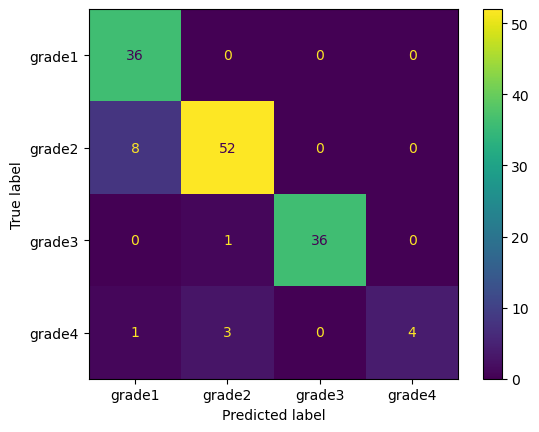

In [208]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)
disp.plot()
plt.show()

In [224]:
x = training['fname'].values
y = training['label'].values

from sklearn.model_selection import train_test_split
x_train, x_test , y_train , y_test = train_test_split(x , y ,test_size = 0.2 ,random_state  =  0)

        
def downsample_audio(audio_path, target_sr=22050):
    y, sr = librosa.load(audio_path)
    return librosa.resample(y, orig_sr=sr, target_sr=target_sr)

def extract_mfcc_features(audio, sr, n_mfcc=20):
    mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=n_mfcc)
    return mfccs.T

def preprocess_audio(audio_path, target_sr=22050, n_mfcc=20):
    audio = downsample_audio(audio_path, target_sr)
    sr = target_sr
    mfccs = extract_mfcc_features(audio, sr, n_mfcc)
    return mfccs.reshape(mfccs.shape[0], mfccs.shape[1], 1)

def pad_or_truncate_mfccs(mfccs, target_length):
    if len(mfccs) > target_length:
        return mfccs[:target_length, :]
    else:
        return np.pad(mfccs, ((0, target_length - len(mfccs)), (0, 0)), mode='constant')

# truncating or adding 0
classes = list(np.unique(training.label))

classes

X = []  # Store MFCC features
Y = []  # Store class labels


for index, row in training.iterrows():
        audio_path = row['fname']
        class_label = row['label']
        audio_path = 'wavfiles/' + audio_path
        mfccs = preprocess_audio(audio_path)
        mfccs = pad_or_truncate_mfccs(mfccs, target_length=141)  # Adjust target_length as needed
        X.append(mfccs)
        Y.append(class_label)
    

X = np.array(X)
Y = np.array(Y)
print(Y)



#convering grade to numbers 0 1 2 3 
class_mapping = {'grade1': 0, 'grade2': 1, 'grade3': 2 ,'grade4': 3 }
Y = [class_mapping[label] for label in Y]



Y = to_categorical(Y)  # One-hot encode labels

Y
# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.2, random_state=42)
Y.shape

Y.shape



['grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1' 'grade1'
 'grade1' 'grade1' 'grade1' 'grade1' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2' 'grade2'
 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grade3'
 'grade3' 'grade3' 'grade3' 'grade3' 'grade3' 'grad

(141, 4)

In [225]:
X_val

array([[[[-3.02134491e+02],
         [ 1.21019363e+02],
         [ 1.41027184e+01],
         ...,
         [ 4.03459692e+00],
         [ 1.49302289e-01],
         [ 4.46558952e+00]],

        [[-3.61325958e+02],
         [ 1.21582581e+02],
         [ 2.53045883e+01],
         ...,
         [ 2.47901034e+00],
         [ 3.26991051e-01],
         [ 3.33230209e+00]],

        [[-4.61480377e+02],
         [ 8.82911682e+01],
         [ 7.97897644e+01],
         ...,
         [-5.39353669e-01],
         [-1.70353270e+00],
         [-2.33387733e+00]],

        ...,

        [[-4.86214722e+02],
         [ 5.49399719e+01],
         [ 5.10342636e+01],
         ...,
         [ 3.47192287e+00],
         [ 2.12721038e+00],
         [ 7.01838315e-01]],

        [[-4.79246216e+02],
         [ 6.42454071e+01],
         [ 5.87752914e+01],
         ...,
         [-1.31337166e-01],
         [-1.07196403e+00],
         [-1.94612670e+00]],

        [[-4.78200714e+02],
         [ 6.56055145e+01],
         [

In [226]:
from tensorflow.keras import regularizers

num_classes = 4
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(mfccs.shape[0], mfccs.shape[1], 1)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.MaxPooling2D((2, 2)))

model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(64, activation='relu' , kernel_regularizer=regularizers.l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))
model.summary()
# Output layer for 4 classes

model.compile(loss='categorical_crossentropy', optimizer = 'adam', metrics=['accuracy'])

history = model.fit(X_train, y_train, epochs=200, batch_size=32, validation_data=(X_val, y_val))


Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_34 (Conv2D)          (None, 139, 18, 32)       320       
                                                                 
 batch_normalization_42 (Ba  (None, 139, 18, 32)       128       
 tchNormalization)                                               
                                                                 
 dropout_42 (Dropout)        (None, 139, 18, 32)       0         
                                                                 
 max_pooling2d_34 (MaxPooli  (None, 69, 9, 32)         0         
 ng2D)                                                           
                                                                 
 conv2d_35 (Conv2D)          (None, 67, 7, 64)         18496     
                                                                 
 batch_normalization_43 (Ba  (None, 67, 7, 64)       

4/4 [==============================] - 1s 153ms/step - loss: 0.5506 - accuracy: 0.9643 - val_loss: 1.7209 - val_accuracy: 0.6207
Epoch 42/200
4/4 [==============================] - 1s 143ms/step - loss: 0.5775 - accuracy: 0.9643 - val_loss: 1.5879 - val_accuracy: 0.6207
Epoch 43/200
4/4 [==============================] - 1s 129ms/step - loss: 0.5502 - accuracy: 0.9464 - val_loss: 1.4331 - val_accuracy: 0.6552
Epoch 44/200
4/4 [==============================] - 1s 142ms/step - loss: 0.5632 - accuracy: 0.9554 - val_loss: 1.3656 - val_accuracy: 0.6552
Epoch 45/200
4/4 [==============================] - 1s 140ms/step - loss: 0.5383 - accuracy: 0.9464 - val_loss: 1.2993 - val_accuracy: 0.6897
Epoch 46/200
4/4 [==============================] - 1s 143ms/step - loss: 0.5191 - accuracy: 0.9643 - val_loss: 1.2702 - val_accuracy: 0.6897
Epoch 47/200
4/4 [==============================] - 1s 136ms/step - loss: 0.5101 - accuracy: 0.9732 - val_loss: 1.2233 - val_accuracy: 0.6897
Epoch 48/200
4/4 [=

Epoch 99/200
4/4 [==============================] - 1s 126ms/step - loss: 0.2856 - accuracy: 0.9464 - val_loss: 1.3940 - val_accuracy: 0.7586
Epoch 100/200
4/4 [==============================] - 1s 128ms/step - loss: 0.2755 - accuracy: 0.9732 - val_loss: 1.4873 - val_accuracy: 0.7586
Epoch 101/200
4/4 [==============================] - 1s 135ms/step - loss: 0.2618 - accuracy: 0.9554 - val_loss: 1.5690 - val_accuracy: 0.6897
Epoch 102/200
4/4 [==============================] - 1s 130ms/step - loss: 0.2557 - accuracy: 0.9554 - val_loss: 1.5815 - val_accuracy: 0.6897
Epoch 103/200
4/4 [==============================] - 0s 123ms/step - loss: 0.2743 - accuracy: 0.9464 - val_loss: 1.6245 - val_accuracy: 0.6552
Epoch 104/200
4/4 [==============================] - 0s 125ms/step - loss: 0.2811 - accuracy: 0.9554 - val_loss: 1.6790 - val_accuracy: 0.6207
Epoch 105/200
4/4 [==============================] - 1s 124ms/step - loss: 0.2494 - accuracy: 0.9554 - val_loss: 1.7161 - val_accuracy: 0.5862


4/4 [==============================] - 0s 116ms/step - loss: 0.2417 - accuracy: 0.9554 - val_loss: 1.3763 - val_accuracy: 0.6897
Epoch 157/200
4/4 [==============================] - 0s 112ms/step - loss: 0.1899 - accuracy: 0.9643 - val_loss: 1.3820 - val_accuracy: 0.6552
Epoch 158/200
4/4 [==============================] - 0s 106ms/step - loss: 0.1948 - accuracy: 0.9732 - val_loss: 1.3774 - val_accuracy: 0.6552
Epoch 159/200
4/4 [==============================] - 0s 108ms/step - loss: 0.2223 - accuracy: 0.9643 - val_loss: 1.2628 - val_accuracy: 0.6552
Epoch 160/200
4/4 [==============================] - 0s 120ms/step - loss: 0.2325 - accuracy: 0.9643 - val_loss: 1.1908 - val_accuracy: 0.6897
Epoch 161/200
4/4 [==============================] - 0s 109ms/step - loss: 0.2102 - accuracy: 0.9732 - val_loss: 1.1863 - val_accuracy: 0.6897
Epoch 162/200
4/4 [==============================] - 0s 119ms/step - loss: 0.1968 - accuracy: 0.9643 - val_loss: 1.1546 - val_accuracy: 0.6897
Epoch 163/200

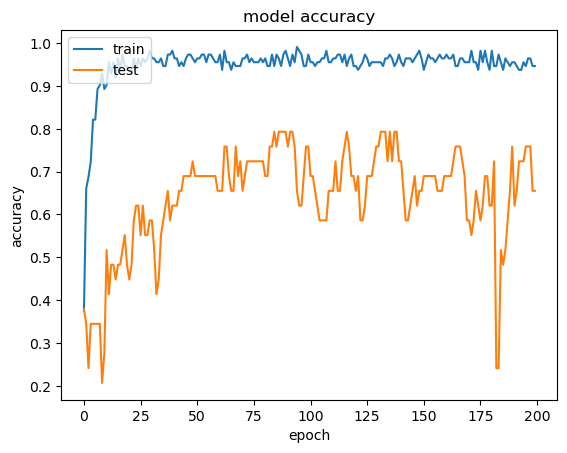

In [227]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

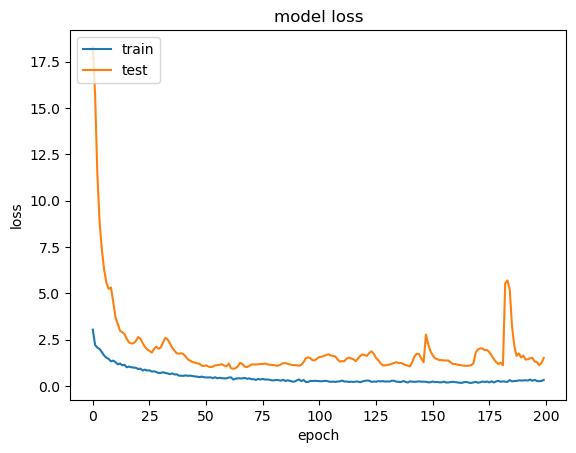

In [228]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [230]:
labels = np.array(classes)

In [232]:
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder

# Assuming y_test contains string labels
y_test = classes

# Use LabelEncoder to convert string labels to integers
label_encoder = LabelEncoder()
y_test_encoded = label_encoder.fit_transform(y_test)

# One-hot encode y_test_encoded
y_test_onehot = to_categorical(y_test_encoded, num_classes=len(label_encoder.classes_))

# Display the original and one-hot encoded labels
print("Original labels:", y_test)
print("Encoded labels:", y_test_encoded)
print("One-hot encoded labels:")
print(y_test_onehot)



Original labels: ['grade1', 'grade2', 'grade3', 'grade4']
Encoded labels: [0 1 2 3]
One-hot encoded labels:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


In [254]:

y_pred = predicted_train['Predicted_Class'].values
y_test_encoded = label_encoder.fit_transform(y_pred)
y_pred = y_test_encoded
y_pred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 3, 1, 3, 1, 1, 3, 1, 3])

In [257]:
training

,index,fname,label
0,0,grade1 (1).wav,grade1
1,1,grade1 (2).wav,grade1
2,2,grade1 (3).wav,grade1
3,3,grade1 (4).wav,grade1
4,4,grade1 (5).wav,grade1
...,...,...,...
136,136,grade4 (4).wav,grade4
137,137,grade4 (5).wav,grade4
138,138,grade4 (6).wav,grade4
139,139,grade4 (7).wav,grade4


In [259]:
y_true = training['label'].values
y_true_encoded = label_encoder.fit_transform(y_true)
y_true = y_true_encoded
y_true

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 3, 3, 3, 3, 3, 3, 3, 3])

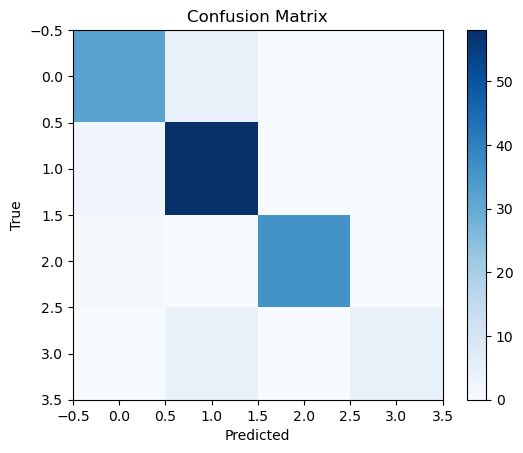

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.89      0.90        36
           1       0.88      0.97      0.92        60
           2       1.00      0.97      0.99        37
           3       1.00      0.50      0.67         8

    accuracy                           0.92       141
   macro avg       0.95      0.83      0.87       141
weighted avg       0.93      0.92      0.92       141

Weighted F1 Score: 0.9185481097993773


In [260]:
from sklearn.metrics import f1_score, confusion_matrix, classification_report






# Calculate F1 score
f1 = f1_score(y_true, y_pred, average='weighted')

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_true, y_pred))

# Print F1 score
print("Weighted F1 Score:", f1)

In [268]:
X_train

array([[[[-3.44916779e+02],
         [ 1.20849670e+02],
         [ 2.90913849e+01],
         ...,
         [ 3.10516310e+00],
         [ 3.68634081e+00],
         [ 2.54430771e+00]],

        [[-3.85543488e+02],
         [ 1.14219116e+02],
         [ 5.64424591e+01],
         ...,
         [-1.47866935e-01],
         [ 2.62742788e-01],
         [ 2.44927675e-01]],

        [[-4.32303894e+02],
         [ 8.13811646e+01],
         [ 7.53269653e+01],
         ...,
         [ 1.67679477e+00],
         [ 9.62981105e-01],
         [-3.70560586e-02]],

        ...,

        [[-4.42522552e+02],
         [ 6.73203201e+01],
         [ 6.23916168e+01],
         ...,
         [-1.09672689e+00],
         [-1.63001943e+00],
         [-2.23483348e+00]],

        [[-4.40304688e+02],
         [ 7.03260345e+01],
         [ 6.50312958e+01],
         ...,
         [-1.45806265e+00],
         [-2.49330235e+00],
         [-3.40490913e+00]],

        [[-4.34181946e+02],
         [ 7.83649750e+01],
         [

In [274]:
from sklearn.metrics import roc_auc_score
train_roc_auc_per_class = []
val_roc_auc_per_class = []
for epoch in range(200):
    print(epoch)
    y_train_probs = model.predict(X_train)
    y_val_probs = model.predict(X_val)

    # Compute ROC-AUC for each class
    for i in range(4):
        train_roc_auc = roc_auc_score(y_train[:, i], y_train_probs[:, i])
        val_roc_auc = roc_auc_score(y_val[:, i], y_val_probs[:, i])

        train_roc_auc_per_class.append(train_roc_auc)
        val_roc_auc_per_class.append(val_roc_auc)



0
1/1 [==============================] - 0s 16ms/step
1
1/1 [==============================] - 0s 17ms/step
2
1/1 [==============================] - 0s 30ms/step
3
1/1 [==============================] - 0s 28ms/step
4
1/1 [==============================] - 0s 23ms/step
5
1/1 [==============================] - 0s 25ms/step
6
1/1 [==============================] - 0s 22ms/step
7
1/1 [==============================] - 0s 24ms/step
8
1/1 [==============================] - 0s 13ms/step
9
1/1 [==============================] - 0s 34ms/step
10
1/1 [==============================] - 0s 34ms/step
11
1/1 [==============================] - 0s 17ms/step
12
1/1 [==============================] - 0s 33ms/step
13
1/1 [==============================] - 0s 32ms/step
14
1/1 [==============================] - 0s 23ms/step
15
1/1 [==============================] - 0s 24ms/step
16
1/1 [==============================] - 0s 23ms/step
17
1/1 [==============================] - 0s 23ms/step
18
1/1 [============

1/1 [==============================] - 0s 62ms/step
78
1/1 [==============================] - 0s 48ms/step
79
1/1 [==============================] - 0s 62ms/step
80
1/1 [==============================] - 0s 49ms/step
81
1/1 [==============================] - 0s 63ms/step
82
1/1 [==============================] - 0s 50ms/step
83
1/1 [==============================] - 0s 57ms/step
84
1/1 [==============================] - 0s 54ms/step
85
1/1 [==============================] - 0s 31ms/step
86
1/1 [==============================] - 0s 31ms/step
87
1/1 [==============================] - 0s 31ms/step
88
1/1 [==============================] - 0s 31ms/step
89
1/1 [==============================] - 0s 24ms/step
90
1/1 [==============================] - 0s 27ms/step
91
1/1 [==============================] - 0s 20ms/step
92
1/1 [==============================] - 0s 30ms/step
93
1/1 [==============================] - 0s 28ms/step
94
1/1 [==============================] - 0s 28ms/step
95
1/1 [=====

1/1 [==============================] - 0s 47ms/step
154
1/1 [==============================] - 0s 40ms/step
155
1/1 [==============================] - 0s 34ms/step
156
1/1 [==============================] - 0s 34ms/step
157
1/1 [==============================] - 0s 50ms/step
158
1/1 [==============================] - 0s 52ms/step
159
1/1 [==============================] - 0s 34ms/step
160
1/1 [==============================] - 0s 41ms/step
161
1/1 [==============================] - 0s 21ms/step
162
1/1 [==============================] - 0s 33ms/step
163
1/1 [==============================] - 0s 48ms/step
164
1/1 [==============================] - 0s 23ms/step
165
1/1 [==============================] - 0s 52ms/step
166
1/1 [==============================] - 0s 34ms/step
167
1/1 [==============================] - 0s 50ms/step
168
1/1 [==============================] - 0s 49ms/step
169
1/1 [==============================] - 0s 31ms/step
170
1/1 [==============================] - 0s 50ms/s

In [277]:
len(val_roc_auc_per_class)

800

AttributeError: 'dict' object has no attribute 'accuracy'

In [284]:
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

# Find the maximum accuracy achieved during training
max_train_accuracy = max(train_accuracy)
max_val_accuracy = max(val_accuracy)

print(f"Maximum Training Accuracy: {max_train_accuracy}")
print(f"Maximum Validation Accuracy: {max_val_accuracy}")

Maximum Training Accuracy: 0.9910714030265808
Maximum Validation Accuracy: 0.7931034564971924
